# Most Predictive Features for Ransomware Detection

We used several **Explainable AI (XAI)** methods to provide additional insights into the ransomware detection model. Each method has unique strengths, and using a combination can offer a comprehensive understanding of how the model makes predictions. 


In [1]:
import pandas as pd
import numpy as np
import json

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
import shap
import seaborn as sns
import shap
import lime
import lime.lime_tabular

In [3]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import learning_curve
#from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFE
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, 
    balanced_accuracy_score, roc_auc_score, classification_report, confusion_matrix, 
    RocCurveDisplay
)
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

# libraries
import os
import json
from tqdm import tqdm  # Import tqdm for the progress bar
import pickle
import time  # Import time to track duration

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [5]:
df_mlran_meta = pd.read_csv("mlran_dataset_metadata.csv")
print("Shape:", df_mlran_meta.shape)
display(df_mlran_meta.head())

Shape: (4880, 19)


,sample_id,sha256,sample_type,ransomware_family,family_label,ransomware_type,type_label,sha1,md5,extension,detections,source,timestamp,new_timestamp,old_timestamp,Year,first_submission_date,first_submission_date_converted,first_submission_date_year
0,10001,0068712434bda717df0d783b560b312854cb7dd4cf0789...,1,cryptolocker,3,crypto,2,77d6871f350be911b2b5c3e16cc2c222c1887779,12be6e7241d2503f31fae01046e88d68,exe,30/56,elderan,2014:10:10,2014-10-10,2014:10:10,2014,1413149304,2014-10-12,2014
1,10002,00735e4ad3e9a9a5b3551dce371248327e74ef3c25edca...,1,cryptowall,12,crypto,2,96fb7d2e3ad9fe434a66abb15b26dd4e40aa5d4b,aea8ab12edf294ddb2804d6618fdd247,exe,44/55,elderan,2015:04:02,2015-04-02,2015:04:02,2015,1428563179,2015-04-09,2015
2,10003,007a81ed76ca6d6e10584d90dee399b4ab98e59707688c...,1,cryptolocker,3,crypto,2,8ecc04ce43c0c77978fa83169819e37a92110318,d5d010f8b2f145399a9638f457ff3990,exe,28/52,elderan,2014:01:29,2014-01-29,2014:01:29,2014,1401330145,2014-05-29,2014
3,10004,00bf847c9a53922a2b36348456ee0f1afff0eec705f221...,1,kovter,9,locker,1,0d9e3696c8516a89567ef712c612edacc3c3386b,d1510b299e8570afd352d20d516f6f48,exe,28/57,elderan,2015:08:09,2015-08-09,2015:08:09,2015,1439196631,2015-08-10,2015
4,10005,00d786974e609adf93b29e6e86f7439074149e6cceabf3...,1,matsnu,11,locker,1,b1e88afcd0ea38655005eb4a6247ce9355b518ba,bc5734bcc7e2d8e2e208ea483a09b158,zip,42/55,elderan,1992:06:19,1992-06-19,NaN,1992,1416574498,2014-11-21,2014


In [7]:
X_train_merge = pd.read_csv("data/MLRan_X_train_RFE.csv")
print("Shape:", X_train_merge.shape)
display(X_train_merge.head())

Shape: (3905, 487)


,sample_id,sample_type,family_label,type_label,5,8,18,32,33,34,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,10001,1,3,2,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,10002,1,12,2,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,1,0
2,10003,1,3,2,0,0,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
3,10004,1,9,1,1,0,1,1,0,1,...,0,0,0,0,0,0,0,0,1,0
4,10005,1,11,1,1,1,1,1,1,1,...,1,1,1,1,0,0,1,0,0,0


In [9]:
X_test_merge = pd.read_csv("data/MLRan_X_test_RFE.csv")
print("Shape:", X_test_merge.shape)
display(X_test_merge.head())

Shape: (975, 487)


,sample_id,sample_type,family_label,type_label,5,8,18,32,33,34,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,11027,1,8,1,1,1,1,1,1,1,...,1,0,1,1,0,0,0,0,1,1
1,11030,1,31,2,1,0,1,0,1,1,...,0,1,0,0,0,0,1,0,1,1
2,11033,1,8,1,1,1,1,1,1,1,...,1,0,1,1,0,0,0,0,1,1
3,11035,1,8,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,1,1
4,11036,1,3,2,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,1


In [11]:
X_train = X_train_merge.drop(columns=['sample_id', 'sample_type', 'family_label', 'type_label'])
X_train.head()

,5,8,18,32,33,34,35,37,41,43,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,1,1,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,1,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,1,1,0,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,0
4,1,1,1,1,1,1,1,1,0,1,...,1,1,1,1,0,0,1,0,0,0


In [13]:
X_train_columns = X_train.columns
print('Length of features:', len(X_train_columns))
print(X_train_columns[:10])

Length of features: 483
Index(['5', '8', '18', '32', '33', '34', '35', '37', '41', '43'], dtype='object')


## Feature group analysis

### Original feature group distribution

In [15]:

# Define the ranges with unique names to avoid conflicts
api_range = range(1, 314)
reg_range = range(314, 525819)
file_range = range(525819, 2604106)
dir_range = range(2604137, 2762260)
str_range = range(2762260, 6394379)
net_range = range(6394693, 6399507)
sys_range = range(6399507, 6416418)
drop_range = range(6416418, 6468069)
sig_range = range(6468069, 6468272)

# Define the ranges in a dictionary
ranges = {
    "api": api_range,
    "reg": reg_range,
    "file": file_range,
    "dir": dir_range,
    "str": str_range,
    "net": net_range,
    "sys": sys_range,
    "drop": drop_range,
    "sig": sig_range
}

# Calculate lengths of the ranges
data = {var: len(rng) for var, rng in ranges.items()}

# Sum all the ranges
total = sum(data.values())

# Create the DataFrame
df = pd.DataFrame({
    "Length": data.values(),
    "Percentage": [length / total * 100 for length in data.values()]
}, index=data.keys())

df

,Length,Percentage
api,313,0.004839
reg,525505,8.124784
file,2078287,32.132201
dir,158123,2.444725
str,3632119,56.155853
net,4814,0.074429
sys,16911,0.261459
drop,51651,0.798571
sig,203,0.003139


###  Feature group distribution after 1st stage FS using MI with threshold of 0.01

In [23]:
X_train_mi = pd.read_csv("data/MLRan_X_test_MI_01.csv")
print(X_train_mi.shape)
X_train_mi.head()

(975, 24163)


,sample_id,1,2,4,5,8,10,16,18,19,...,6468225,6468226,6468229,6468230,6468242,6468252,6468253,6468256,6468258,6468260
0,11027,0,0,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,1,0,0
1,11030,0,0,1,1,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,11033,0,0,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,1,0,0
3,11035,0,0,1,1,1,0,0,1,1,...,0,0,0,0,0,0,0,1,0,0
4,11036,0,0,1,1,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0


In [25]:
X_train_mi = X_train_mi.drop(columns=["sample_id"])

In [27]:
X_train_mi_columns = X_train_mi.columns
print('Length of features:', len(X_train_mi_columns))
print(X_train_mi_columns[:10])

Length of features: 24162
Index(['1', '2', '4', '5', '8', '10', '16', '18', '19', '23'], dtype='object')


In [29]:
# Convert the feature list to integers
features = [int(feature) for feature in X_train_mi_columns]

# Check each feature against the ranges and count occurrences
range_counts = {var: sum(1 for feature in features if feature in rng) for var, rng in ranges.items()}

# Total number of features
total_features = len(features)

# Calculate percentages
range_percentages = {var: (count / total_features) * 100 for var, count in range_counts.items()}

# Create a DataFrame to display the results
features_df = pd.DataFrame({
    "Feature Count": range_counts.values(),
    "Percentage": range_percentages.values()
}, index=range_counts.keys())
features_df

,Feature Count,Percentage
api,137,0.567006
reg,5369,22.220843
file,14044,58.124327
dir,820,3.393759
str,3347,13.852330
net,3,0.012416
sys,321,1.328532
drop,75,0.310405
sig,46,0.190382


###  Feature group distribution after 2nd stage FS using RFE

In [31]:
# Convert the feature list to integers
features = [int(feature) for feature in X_train_columns]

# Check each feature against the ranges and count occurrences
range_counts = {var: sum(1 for feature in features if feature in rng) for var, rng in ranges.items()}

# Total number of features
total_features = len(features)

# Calculate percentages
range_percentages = {var: (count / total_features) * 100 for var, count in range_counts.items()}

# Create a DataFrame to display the results
features_df = pd.DataFrame({
    "Feature Count": range_counts.values(),
    "Percentage": range_percentages.values()
}, index=range_counts.keys())
features_df

,Feature Count,Percentage
api,63,13.043478
reg,90,18.633540
file,16,3.312629
dir,10,2.070393
str,223,46.169772
net,0,0.000000
sys,38,7.867495
drop,23,4.761905
sig,20,4.140787


## Model training - logistic regression

In [33]:
# Define features and label
X_train = X_train_merge.drop(columns=["sample_id", "sample_type", "family_label", "type_label"])
y_train = X_train_merge["sample_type"]

X_test = X_test_merge.drop(columns=["sample_id", "sample_type", "family_label", "type_label"])
y_test = X_test_merge["sample_type"]

In [150]:
# Train logistic regression model - using best hyperparameters
model = LogisticRegression(max_iter=1000, random_state=42, C=1, penalty='l2', solver='liblinear')
model.fit(X_train, y_train)

LogisticRegression(C=1, max_iter=1000, random_state=42, solver='liblinear')

In [37]:
# Model evaluation
y_pred = model.predict(X_test)
print('%%%%%%%%%%%%%% classification report %%%%%%%%%%%%%%')
target_names = ['Goodware', 'Ransomware']
print(classification_report(y_test, y_pred, target_names=target_names)) 

# Print confusion matrix
print("%%%%%%%%%%%%%% Confusion Matrix %%%%%%%%%%%%%%")
display(pd.crosstab(np.array(y_test), y_pred, rownames=['True'], colnames=['Predicted'], margins=True))

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred, average='binary')  # For binary classification
precision = precision_score(y_test, y_pred, average='binary')
balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
auc_roc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])  # AUC-ROC from probabilities

# Display metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Balanced Accuracy: {balanced_accuracy:.4f}")
print(f"AUC-ROC: {auc_roc:.4f}")


%%%%%%%%%%%%%% classification report %%%%%%%%%%%%%%
              precision    recall  f1-score   support

    Goodware       0.99      0.98      0.98       510
  Ransomware       0.97      0.99      0.98       465

    accuracy                           0.98       975
   macro avg       0.98      0.98      0.98       975
weighted avg       0.98      0.98      0.98       975

%%%%%%%%%%%%%% Confusion Matrix %%%%%%%%%%%%%%


Predicted,0,1,All
True,,,
0,498,12,510
1,6,459,465
All,504,471,975


Accuracy: 0.9815
Recall: 0.9871
Precision: 0.9745
Balanced Accuracy: 0.9818
AUC-ROC: 0.9968


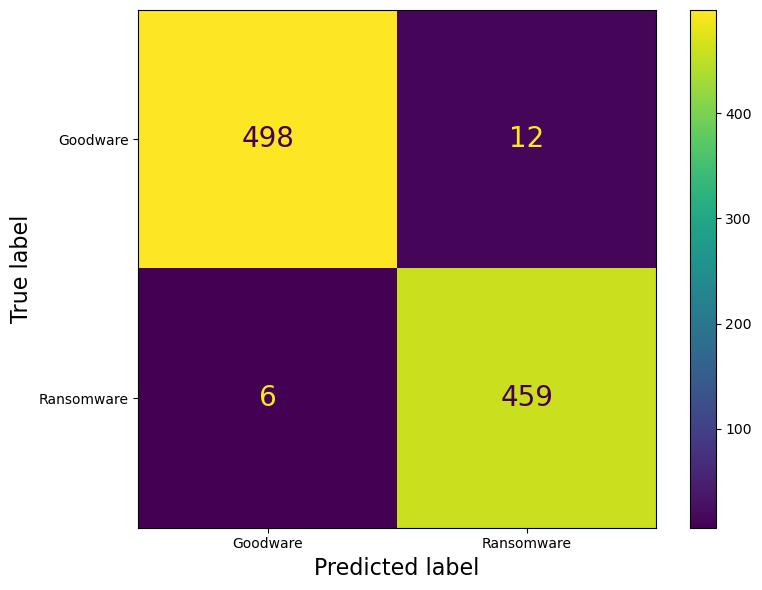

In [45]:
# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred, labels=[0, 1])

# Display the confusion matrix with custom labels
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Goodware', 'Ransomware'])

# Plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))  # Create a figure and axis
disp.plot(ax=ax)  # Plot on the given axis
# Increase font size of the numbers in the matrix

for texts in disp.text_:
    for text in np.ravel(texts):
        text.set_fontsize(20)

#plt.title("Confusion Matrix", fontsize=16)
plt.xlabel("Predicted label", fontsize=16)
plt.ylabel("True label", fontsize=16)
plt.tight_layout()

# Save the plot as a PDF
#plt.savefig('outputs/3_XAI/confusion_matrix_full.pdf', format='pdf', bbox_inches='tight')
plt.show()

## Misclassified samples

In [47]:
# Compare predictions with true labels to find misclassified indices

# if the arrays and dfs do not have the same index then we would need to uncomment the next 2 lines of code
#y_test_series = pd.Series(y_test).reset_index(drop=True)
#y_pred_series = pd.Series(y_pred).reset_index(drop=True)

misclassified_idx2 = np.where(y_pred != y_test)[0]  # Extract indices from the numpy array

# Create a DataFrame with the misclassified indices, predicted values, and true values
misclassified_samples = pd.DataFrame({
    'Index': misclassified_idx2,
    'actual_value': y_test.iloc[misclassified_idx2].values,  # Use .iloc for pandas Series
    'predicted_value': y_pred[misclassified_idx2],  # Use numpy indexing
    'X_test_Index': X_test.index[misclassified_idx2].values,  # Use .index for pandas DataFrame
    'X_test_merge_Index': X_test_merge.index[misclassified_idx2].values,
    'sample_id': X_test_merge.loc[misclassified_idx2, 'sample_id'],  # Use .loc to get 'sample_id'
})
misclassified_samples

,Index,actual_value,predicted_value,X_test_Index,X_test_merge_Index,sample_id
54,54,1,0,54,54,11136
59,59,1,0,59,59,11141
98,98,1,0,98,98,11304
148,148,1,0,148,148,11402
237,237,1,0,237,237,11726
289,289,1,0,289,289,11907
469,469,0,1,469,469,13020
473,473,0,1,473,473,13030
478,478,0,1,478,478,13046
483,483,0,1,483,483,13056


In [49]:
misclassified_samples.shape

(18, 6)

**Remark:** The model misclassified 18 samples. Six are ransomware samples that were misclassified as goodware, while 12 are goodware sample that were misclassified as ransomware.

In [52]:
df_mlran_meta = pd.read_csv("mlran_dataset_metadata.csv")
df_mlran_meta.head()

,sample_id,sha256,sample_type,ransomware_family,family_label,ransomware_type,type_label,sha1,md5,extension,detections,source,timestamp,new_timestamp,old_timestamp,Year,first_submission_date,first_submission_date_converted,first_submission_date_year
0,10001,0068712434bda717df0d783b560b312854cb7dd4cf0789...,1,cryptolocker,3,crypto,2,77d6871f350be911b2b5c3e16cc2c222c1887779,12be6e7241d2503f31fae01046e88d68,exe,30/56,elderan,2014:10:10,2014-10-10,2014:10:10,2014,1413149304,2014-10-12,2014
1,10002,00735e4ad3e9a9a5b3551dce371248327e74ef3c25edca...,1,cryptowall,12,crypto,2,96fb7d2e3ad9fe434a66abb15b26dd4e40aa5d4b,aea8ab12edf294ddb2804d6618fdd247,exe,44/55,elderan,2015:04:02,2015-04-02,2015:04:02,2015,1428563179,2015-04-09,2015
2,10003,007a81ed76ca6d6e10584d90dee399b4ab98e59707688c...,1,cryptolocker,3,crypto,2,8ecc04ce43c0c77978fa83169819e37a92110318,d5d010f8b2f145399a9638f457ff3990,exe,28/52,elderan,2014:01:29,2014-01-29,2014:01:29,2014,1401330145,2014-05-29,2014
3,10004,00bf847c9a53922a2b36348456ee0f1afff0eec705f221...,1,kovter,9,locker,1,0d9e3696c8516a89567ef712c612edacc3c3386b,d1510b299e8570afd352d20d516f6f48,exe,28/57,elderan,2015:08:09,2015-08-09,2015:08:09,2015,1439196631,2015-08-10,2015
4,10005,00d786974e609adf93b29e6e86f7439074149e6cceabf3...,1,matsnu,11,locker,1,b1e88afcd0ea38655005eb4a6247ce9355b518ba,bc5734bcc7e2d8e2e208ea483a09b158,zip,42/55,elderan,1992:06:19,1992-06-19,NaN,1992,1416574498,2014-11-21,2014


In [54]:
df_mlran_meta.shape

(4880, 19)

In [56]:
ransomware_misclassified = misclassified_samples[misclassified_samples.actual_value==1]
ransomware_misclassified

,Index,actual_value,predicted_value,X_test_Index,X_test_merge_Index,sample_id
54,54,1,0,54,54,11136
59,59,1,0,59,59,11141
98,98,1,0,98,98,11304
148,148,1,0,148,148,11402
237,237,1,0,237,237,11726
289,289,1,0,289,289,11907


In [58]:
ransomware_misclassified_sample_id = list(ransomware_misclassified.sample_id)
ransomware_misclassified_sample_id

[11136, 11141, 11304, 11402, 11726, 11907]

In [60]:
ran_mis_df = df_mlran_meta[df_mlran_meta["sample_id"].isin(ransomware_misclassified_sample_id)]
ran_mis_df

,sample_id,sha256,sample_type,ransomware_family,family_label,ransomware_type,type_label,sha1,md5,extension,detections,source,timestamp,new_timestamp,old_timestamp,Year,first_submission_date,first_submission_date_converted,first_submission_date_year
1090,11136,e490fdd45704b51a61e0568b4fbee40285dd3352a2a537...,1,shodi,6,crypto,2,dedf635fd88d2887b918f6e852e198ff805483c8,7c4d4d28433aa19b263e77da22807c92,exe,59/75,marauder,1077252166.0,2004-02-20,1077252166.0,2004,1635927154,2021-11-03,2021
1095,11141,04167bb2c4684f553f8eac5749b3ada46fb91c37c41ead...,1,shodi,6,crypto,2,65feb0eb7139b66737e7cfb412fac32d6511dbcc,b8180f5dbe6cc98e7fd345fc531b0b10,exe,59/76,marauder,1077252166.0,2004-02-20,1077252166.0,2004,1635897776,2021-11-03,2021
1254,11304,8fa8a18a96cfcdcdc7fbc17621a75e45b31dac45c20fa9...,1,shodi,6,crypto,2,0647bb0dd2e697537e32204b473cf876cf4f8ab6,61f412bf42980f3676777ee6b5c74bdd,exe,58/76,marauder,1077252166.0,2004-02-20,1077252166.0,2004,1635930232,2021-11-03,2021
1343,11402,5e10b46932bd76c17c78867ad2107cbf7bfc0172b324bf...,1,shodi,6,crypto,2,52cf37c28f237553f6c52bc015e459e9ddae4e5f,f4dd275bd434f0c66082aafbfffe6b3d,exe,56/76,marauder,1077252166.0,2004-02-20,1077252166.0,2004,1635926376,2021-11-03,2021
1617,11726,3c0dbda8a5500367c22ca224919bfc87d725d890756222...,1,clop,25,modern,4,08561f638b2a2ec2b0eb9871ee30b044e3085fab,3a0342417e8588ef7738352341e25830,html,32/76,curated,1339247989.0,2012-06-09,NaN,2012,1685711101,2023-06-02,2023
1781,11907,c1874e86e54a70b1917c708826975e45fa5c813f0ec30f...,1,delshad,51,crypto,2,2e3dacf58466b4b7a2c6d52b008f6e1b4c98911a,87b6fcfdaa0ab94d9cf4b7f3cbbc8b8b,exe,42/78,curated,1356914374.0,2012-12-31,1356914374.0,2012,1713395603,2024-04-17,2024


In [62]:
ran_mis_df.ransomware_family.value_counts()

ransomware_family
shodi      4
clop       1
delshad    1
Name: count, dtype: int64

In [64]:
ran_mis_df.ransomware_type.value_counts()

ransomware_type
crypto    5
modern    1
Name: count, dtype: int64

In [66]:
ran_mis_df.first_submission_date_year.value_counts()

first_submission_date_year
2021    4
2023    1
2024    1
Name: count, dtype: int64

In [68]:
goodware_misclassified = misclassified_samples[misclassified_samples.actual_value==0]
goodware_misclassified

,Index,actual_value,predicted_value,X_test_Index,X_test_merge_Index,sample_id
469,469,0,1,469,469,13020
473,473,0,1,473,473,13030
478,478,0,1,478,478,13046
483,483,0,1,483,483,13056
488,488,0,1,488,488,13069
497,497,0,1,497,497,13093
503,503,0,1,503,503,13118
530,530,0,1,530,530,13187
563,563,0,1,563,563,13292
572,572,0,1,572,572,13333


In [70]:
goodware_misclassified_sample_id = list(goodware_misclassified.sample_id)
goodware_misclassified_sample_id

[13020,
 13030,
 13046,
 13056,
 13069,
 13093,
 13118,
 13187,
 13292,
 13333,
 15187,
 15373]

In [72]:
good_mis_df = df_mlran_meta[df_mlran_meta["sample_id"].isin(goodware_misclassified_sample_id)]
good_mis_df

,sample_id,sha256,sample_type,ransomware_family,family_label,ransomware_type,type_label,sha1,md5,extension,detections,source,timestamp,new_timestamp,old_timestamp,Year,first_submission_date,first_submission_date_converted,first_submission_date_year
2349,13020,9c68a989f89c233bb4e191e4a8c2f6aef79d4b272a00b8...,0,goodware,0,goodware,0,a18dece5b4d1c8fd00205683d1521fec4b5ea8e2,6317d7ad4b64f7964f41ee6cb8f848be,exe,0/78,software_informer_most_popular,708992537.0,1992-06-19,2502360546.0,1992,1710358555,2024-03-13,2024
2359,13030,a75d1b9bcfa0d40c1b51606288441431d7354fad578689...,0,goodware,0,goodware,0,81159a4d2f457cfd2c07fb3bdd56b163bc208828,62012407d2ad4b9d18b5624c98dc355f,exe,0/78,software_informer_most_popular,1698375556.0,2023-10-27,1698375556.0,2023,1709882761,2024-03-08,2024
2373,13046,a639a39bf1c7b5e27b3487f14a8d99f81d5e7334580e91...,0,goodware,0,goodware,0,ab603bfb318ea47a3aadd2482f8070dc0c1dfd86,3d1299ef2998b60d60d0b0676916ab32,exe,0/78,software_informer_most_popular,1679925063.0,2023-03-27,1679925063.0,2023,1701806450,2023-12-05,2023
2382,13056,eb1d06564e6c45eaded036b1317983191e34bbcc7c72b7...,0,goodware,0,goodware,0,be104506047451f49c59b8211f44efcfebd80ed6,4d1523d6e89d3215d0efec84b6afdeac,exe,0/77,software_informer_most_popular,1684170518.0,2023-05-15,1684170518.0,2023,1712316326,2024-04-05,2024
2394,13069,2752de74add856b8c8e0db9fedd2c2e12fa5c47226feca...,0,goodware,0,goodware,0,6c69624c90e1c00b530ca16784dbea147a4b623e,15491b2fb2cfead3b949b49fe3742472,exe,0/77,software_informer_most_popular,1632607007.0,2021-09-25,1632607007.0,2021,1686768466,2023-06-14,2023
2414,13093,bcc3a36bc42f158592781030d77605a115b30533a1bb4a...,0,goodware,0,goodware,0,27d9cd45d1fd2209359ba251f9736357791fc086,287324f9050e8f19527e1d9a4910901f,exe,0/78,software_informer_most_popular,1576457453.0,2019-12-16,1576457453.0,2019,1709236305,2024-02-29,2024
2438,13118,b02c8357925a5e3aca5168f129f91ea724a51cf4849759...,0,goodware,0,goodware,0,e660ec017ca8b320e3bd41ddcd005331aa9ff991,5c951663b8da622761e08be1ce29706b,exe,0/77,software_informer_most_popular,1511042438.0,2017-11-18,1511042438.0,2017,1717688345,2024-06-06,2024
2504,13187,7ade57cf4c2b2af928cd1ce70163b43b54c70e05bcb748...,0,goodware,0,goodware,0,72b033a1aa46cdc5994d92cb6d363059332c9f79,3e0f81a0254482ab7965fef44d1e8b4c,exe,0/78,software_informer_most_popular,1717705320.0,2024-06-06,1717705320.0,2024,1718343775,2024-06-14,2024
2605,13292,f6dfae75fd23c0446ec1721994cf2530c66bd763664231...,0,goodware,0,goodware,0,5ec9063e4380f642d2a551da76fd4d3f00fd4c96,fd093f3100a56b710c50d41667da7e2b,exe,0/78,software_informer_most_popular,1694597101.0,2023-09-13,1694597101.0,2023,1694695866,2023-09-14,2023
2645,13333,fcc36ed44f93af5ee2f01c06a9c2ae1a5d28dce44fee96...,0,goodware,0,goodware,0,9fdde5d46d8652717870ceb0dd047b4fe23f89b3,c52d8e47b886ddd66b0fbf32c6b4c8b0,exe,0/78,software_informer_most_popular,1702520616.0,2023-12-14,1702520616.0,2023,1703067110,2023-12-20,2023


In [74]:
good_mis_df.first_submission_date_year.value_counts()

first_submission_date_year
2024    7
2023    4
2022    1
Name: count, dtype: int64

In [76]:
good_mis_df.source.value_counts()

source
software_informer_most_popular    10
software_informer_education        1
software_informer_business         1
Name: count, dtype: int64

In [78]:
goodware_desc = pd.read_csv("goodware_samples_description.csv")
goodware_desc.head()

,sample_id,filename,md5,title,description,type,href,size,download_link,last_checked
0,13001,dropbox_1.4.17.exe,8d7f98d5b2f8ccc2a49b4867f272f0c2,Dropbox,"Upload and manage data, and share files and fo...",most_popular,https://dropbox.informer.com/,17 MB,https://dropbox.informer.com/download/?ca523cb,"May 24, 2024."
1,13002,npp.5.9.8.installer.exe,6997bdec840b3d2bfaf4c52368a20432,Notepad++,Edit text files and program codes with syntax ...,most_popular,https://notepad17.software.informer.com/,5.4 MB,https://notepad17.software.informer.com/downlo...,"November 18, 2023."
2,13003,fdm_x64_setup.exe,dcf5ac41204864216b005ba522938ca7,Free Download Manager,A powerful modern download accelerator and org...,most_popular,https://free-download-manager.software.informe...,38.2 MB,https://free-download-manager.software.informe...,"May 24, 2024."
3,13004,eset_smart_security_live_installer.exe,6b4d1e3b2f1d03b53f6240b5f87462df,ESET Smart Security,"A security solution for keeping your family, d...",most_popular,https://eset-smart-security.informer.com/,2.9 MB,https://eset-smart-security.informer.com/downl...,"May 16, 2024."
4,13005,fsviewersetup32.exe,86790cda8224f8bd67f527d43cb85727,FastStone Image Viewer,"Manage, view, edit and convert your images in ...",most_popular,https://faststone-image-viewer.software.inform...,3.4 MB,https://faststone-image-viewer.software.inform...,"May 22, 2024."


In [80]:
good_mis_des_df = goodware_desc[goodware_desc["sample_id"].isin(goodware_misclassified_sample_id)]
good_mis_des_df

,sample_id,filename,md5,title,description,type,href,size,download_link,last_checked
19,13020,pdfcreator-5_2_1-setup.exe,6317d7ad4b64f7964f41ee6cb8f848be,PDFCreator,Convert any printable document to PDF and othe...,most_popular,https://pdfcreator.informer.com/,42.2 MB,https://pdfcreator.informer.com/download/?ca36...,"June 4, 2024."
29,13030,zoominstallerfull.exe,62012407d2ad4b9d18b5624c98dc355f,Zoom,Simplify video conferencing and messaging acro...,most_popular,https://zoom1.software.informer.com/,78.8 MB,https://zoom1.software.informer.com/download/?...,"March 15, 2024."
43,13046,bt-23.10.0-64uwd-win10-win11.exe,3d1299ef2998b60d60d0b0676916ab32,Intel Wireless Bluetooth,NaN,most_popular,https://intel-wireless-bluetooth.software.info...,58.2 MB,https://intel-wireless-bluetooth.software.info...,"July 7, 2024."
52,13056,webadvisorinstaller.exe,4d1523d6e89d3215d0efec84b6afdeac,McAfee WebAdvisor,McAfee WebAdvisor protects you from the most c...,most_popular,https://mcafee-webadvisor.software.informer.com/,52.9 MB,https://mcafee-webadvisor.software.informer.co...,"June 27, 2024."
64,13069,teamspeak3-client-win64-3.6.0.exe,15491b2fb2cfead3b949b49fe3742472,TeamSpeak,Talk to other users using the voice-over-IP pr...,most_popular,https://teamspeak.informer.com/,107 MB,https://teamspeak.informer.com/download/?ca34a6cf,"September 23, 2023."
84,13093,avast_secure_browser_setup.exe,287324f9050e8f19527e1d9a4910901f,Avast Secure Browser,NaN,most_popular,https://avast-secure-browser.software.informer...,5.7 MB,https://avast-secure-browser.software.informer...,"May 29, 2024."
108,13118,garminexpress.exe,5c951663b8da622761e08be1ce29706b,Garmin Express,"Set up, register, and update your Garmin devic...",most_popular,https://garmin-express.software.informer.com/,129 MB,https://garmin-express.software.informer.com/d...,"June 7, 2024."
174,13187,install_valorant.exe,3e0f81a0254482ab7965fef44d1e8b4c,VALORANT,NaN,most_popular,https://valorant.software.informer.com/,68.3 MB,https://valorant.software.informer.com/downloa...,"June 14, 2024."
275,13292,cgsetup_en_xvp2dbyyylgne3pwwlpx.exe,fd093f3100a56b710c50d41667da7e2b,CyberGhost VPN,Access blocked websites using proxy servers ar...,most_popular,https://cyberghost-vpn.informer.com/,127 KB,https://cyberghost-vpn.informer.com/download/?...,"September 24, 2023."
315,13333,razercortexinstaller.exe,c52d8e47b886ddd66b0fbf32c6b4c8b0,Razer Game Booster,Razer Game Booster configures and optimizes yo...,most_popular,https://razer-game-booster.software.informer.com/,7.5 MB,https://razer-game-booster.software.informer.c...,"May 29, 2024."


In [82]:
good_mis_des_df.shape

(12, 10)

In [84]:
list(good_mis_des_df.filename)

['pdfcreator-5_2_1-setup.exe',
 'zoominstallerfull.exe',
 'bt-23.10.0-64uwd-win10-win11.exe',
 'webadvisorinstaller.exe',
 'teamspeak3-client-win64-3.6.0.exe',
 'avast_secure_browser_setup.exe',
 'garminexpress.exe',
 'install_valorant.exe',
 'cgsetup_en_xvp2dbyyylgne3pwwlpx.exe',
 'razercortexinstaller.exe',
 'basic-miktex-24.1-x64.exe',
 'scapple-installer.exe']

## Feature analysis of misclassified samples

For feature analysis of misclassified samples, we aim to:

- Examine how the values of these columns (features) differ between misclassified samples and correctly classified samples.
- Identify if any features show consistent patterns (e.g., significantly higher or lower values) for misclassified samples compared to correctly classified ones.

In [86]:
# Separate correctly and incorrectly classified samples
correctly_classified_indices = X_test.index[y_pred == y_test]
misclassified_indices = X_test.index[y_pred != y_test]

# Extract the respective feature sets
correctly_classified_features = X_test.loc[correctly_classified_indices]
misclassified_features = X_test.loc[misclassified_indices]

In [88]:
len(correctly_classified_indices)

957

In [90]:
len(misclassified_indices)

18

In [92]:
print(correctly_classified_features.shape)
display(correctly_classified_features.head())

(957, 483)


,5,8,18,32,33,34,35,37,41,43,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
1,1,0,1,0,1,1,1,0,1,1,...,0,1,0,0,0,0,1,0,1,1
2,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
3,1,1,1,1,1,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,1
4,1,1,1,0,0,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,1


In [94]:
print(correctly_classified_features.shape)
display(correctly_classified_features.head())

(957, 483)


,5,8,18,32,33,34,35,37,41,43,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
1,1,0,1,0,1,1,1,0,1,1,...,0,1,0,0,0,0,1,0,1,1
2,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
3,1,1,1,1,1,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,1
4,1,1,1,0,0,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
print(misclassified_features.shape)
display(misclassified_features.head())

A kernel density estimate (KDE) plot is a method for visualizing the distribution of observations in a dataset, analogous to a histogram. KDE represents the data using a continuous probability density curve in one or more dimensions.
https://seaborn.pydata.org/generated/seaborn.kdeplot.html

In [96]:
import os
import matplotlib.pyplot as plt
import seaborn as sns

# Create a folder to save the plots
output_folder = "feature_distributions"
os.makedirs(output_folder, exist_ok=True)

# Compare distributions for each feature and save the plots
for feature in X_test.columns:
    plt.figure(figsize=(10, 6))
    sns.kdeplot(
        correctly_classified_features[feature], 
        label='Correctly Classified', 
        fill=True,  # Use fill instead of shade
        color='blue'
    )
    sns.kdeplot(
        misclassified_features[feature], 
        label='Misclassified', 
        fill=True,  # Use fill instead of shade
        color='red'
    )
    plt.title(f'Distribution Comparison for Feature {feature}')
    plt.xlabel(f'Feature {feature}')
    plt.ylabel('Density')
    plt.legend()
    
    # Save the plot to the folder
    file_path = os.path.join(output_folder, f'feature_{feature}_distribution.png')
    plt.savefig(file_path)
    plt.close()  # Close the plot to free memory

print(f"All plots have been saved in the folder: {output_folder}")

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is de

All plots have been saved in the folder: feature_distributions


/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/1512907701.py:18: UserWarning: Dataset has 0 variance; skipping dens

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


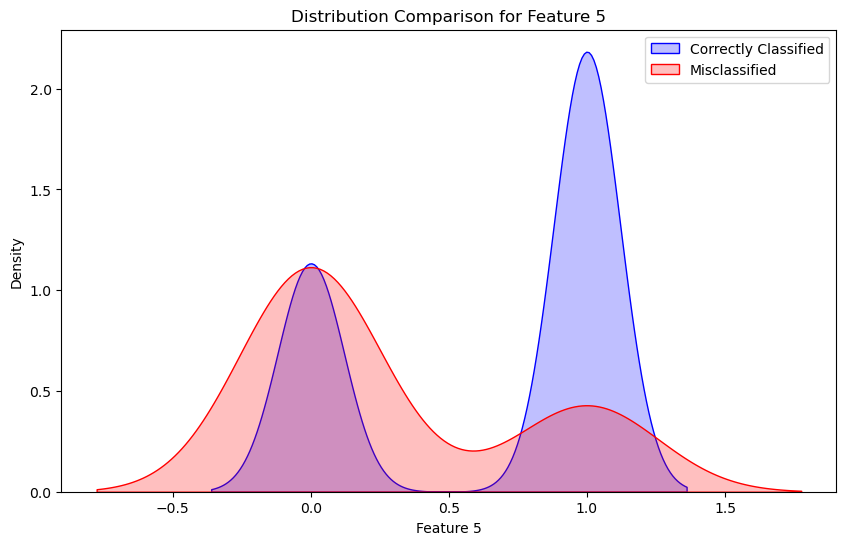

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


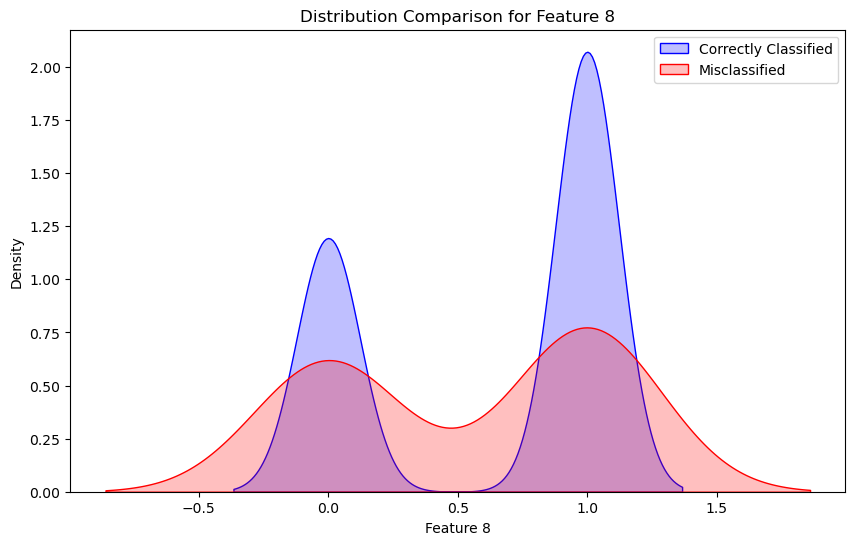

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


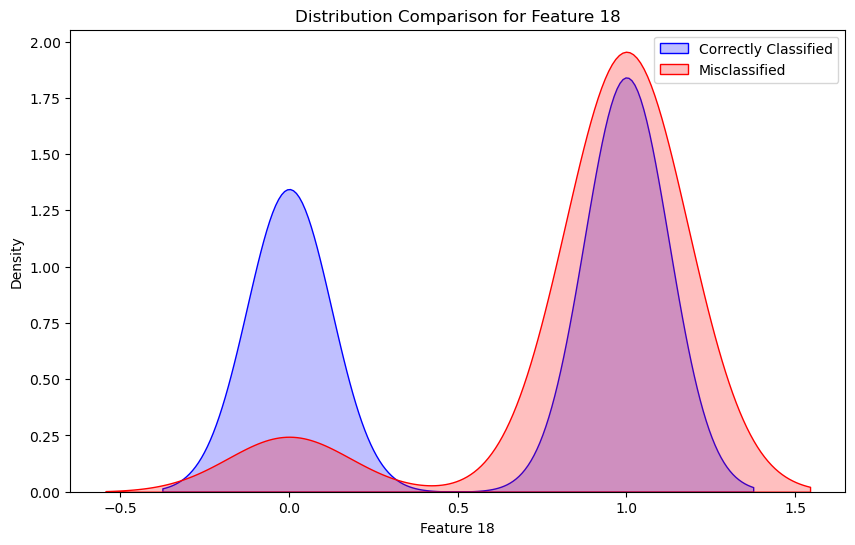

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


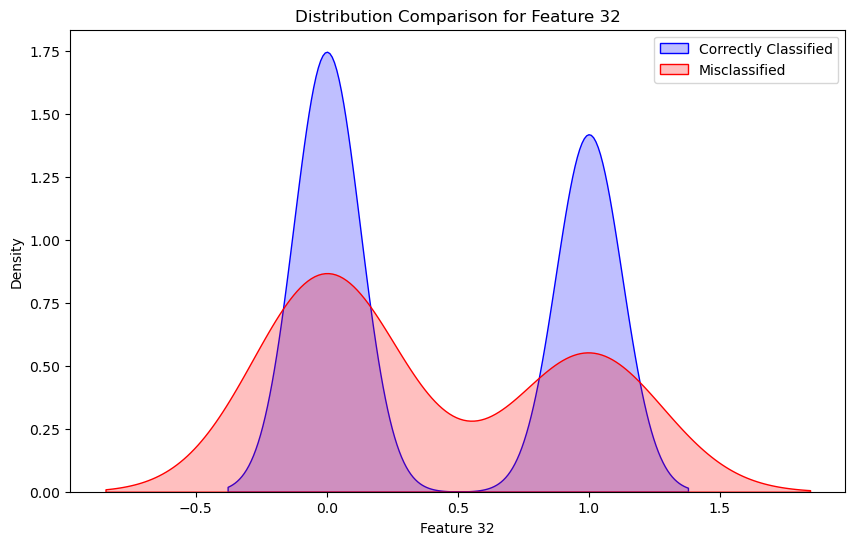

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


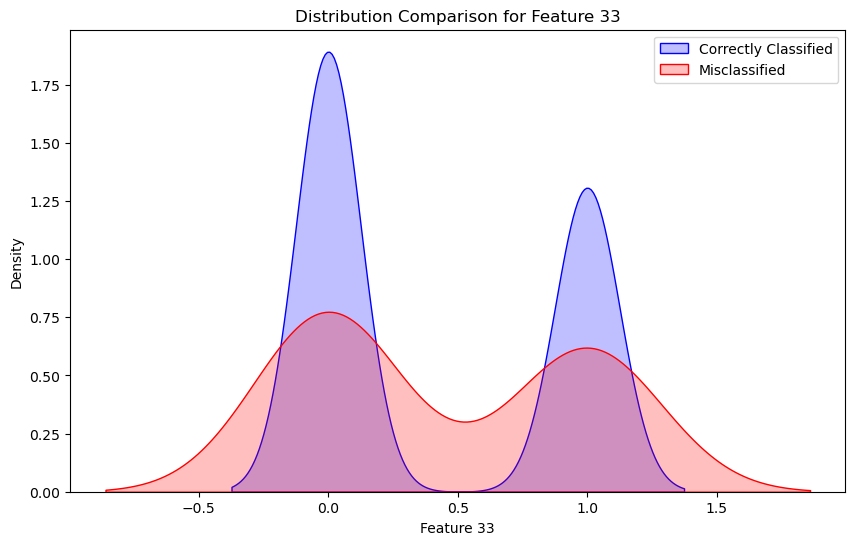

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


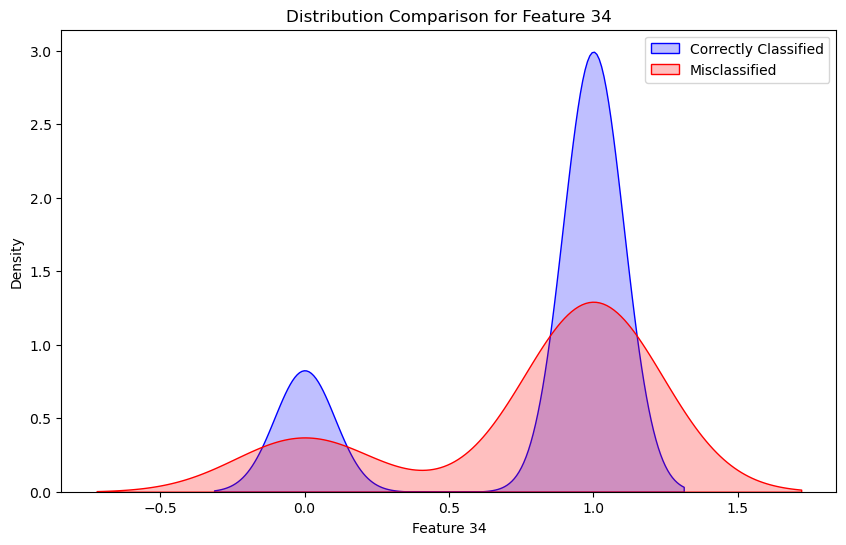

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


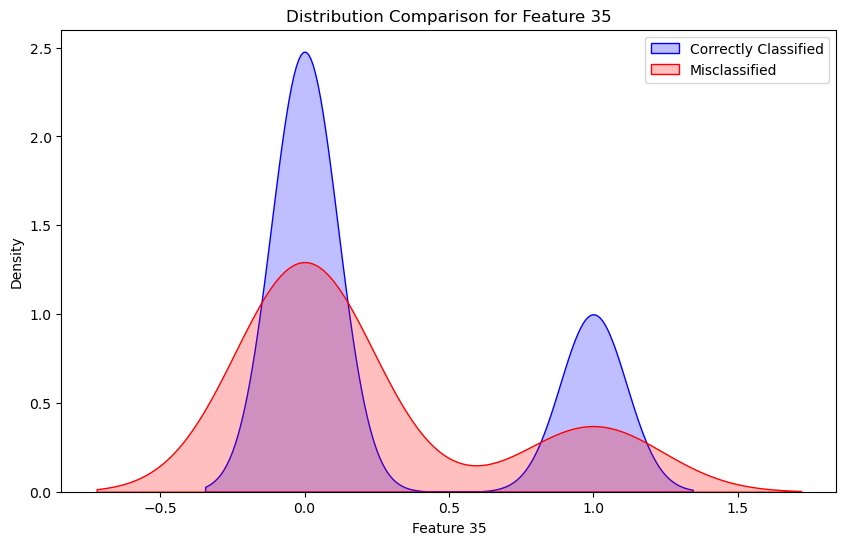

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


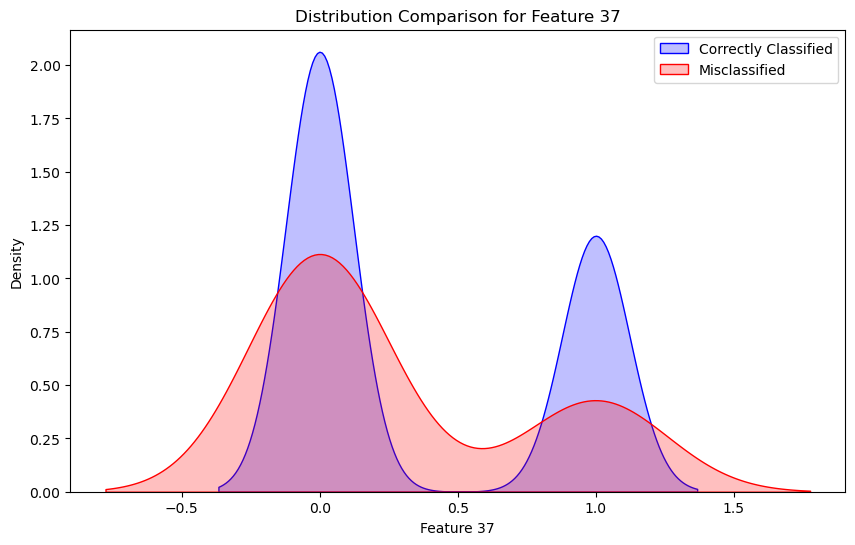

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


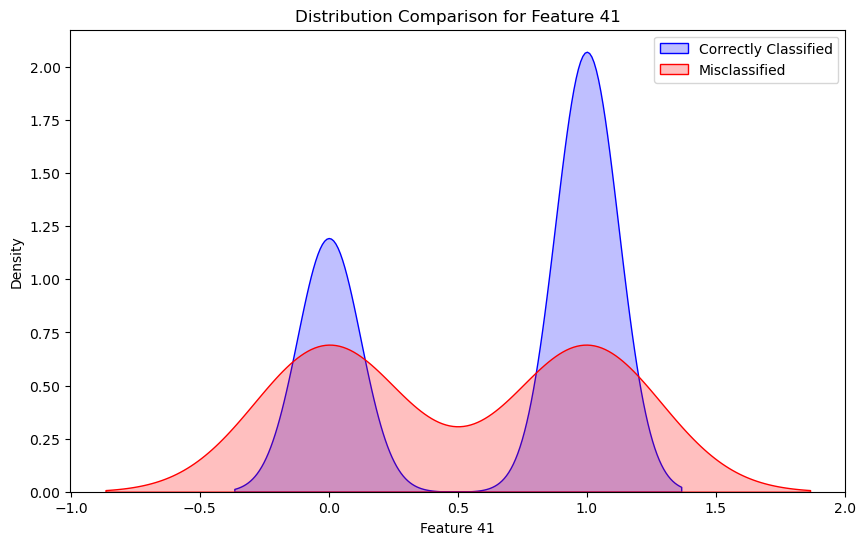

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


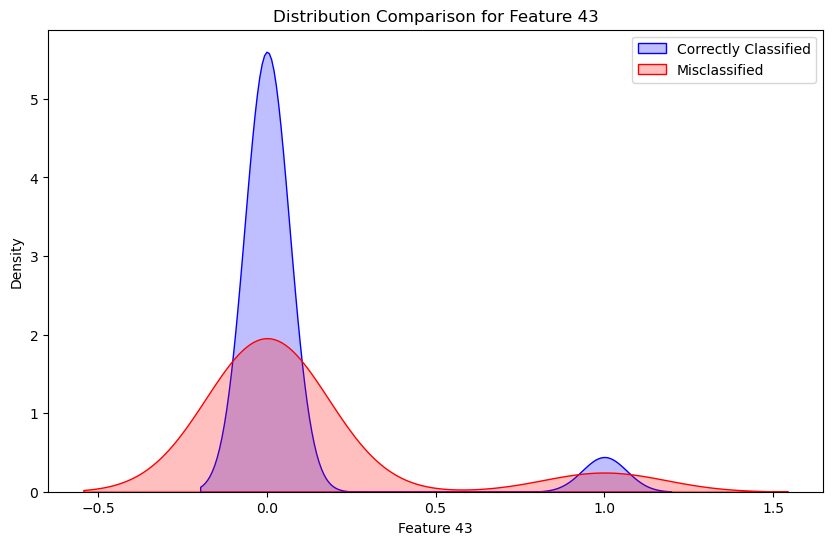

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


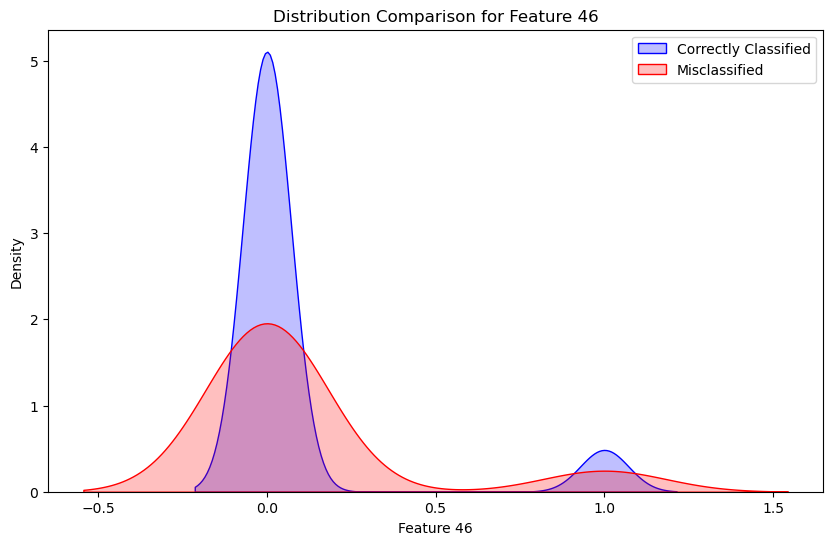

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


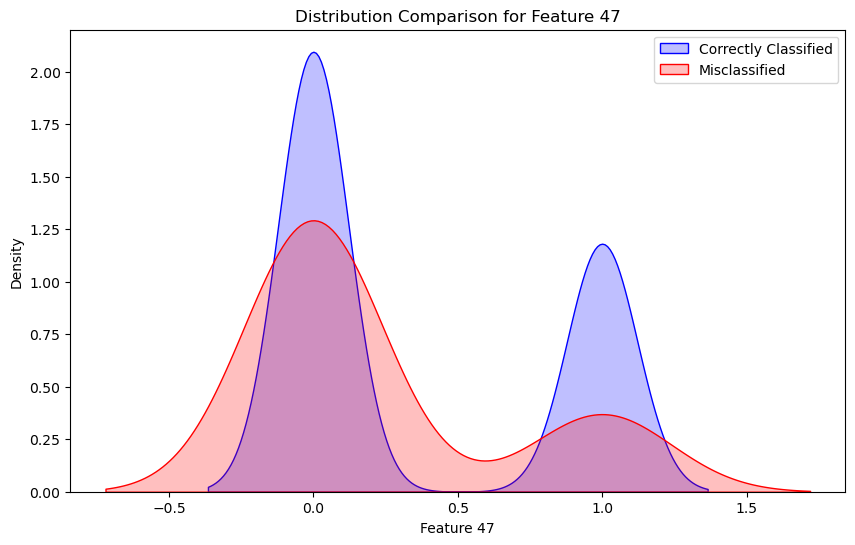

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


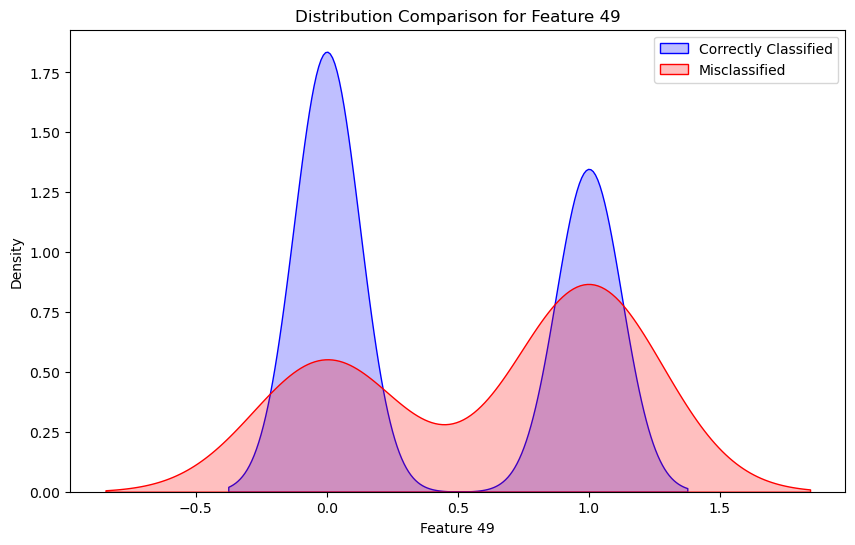

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


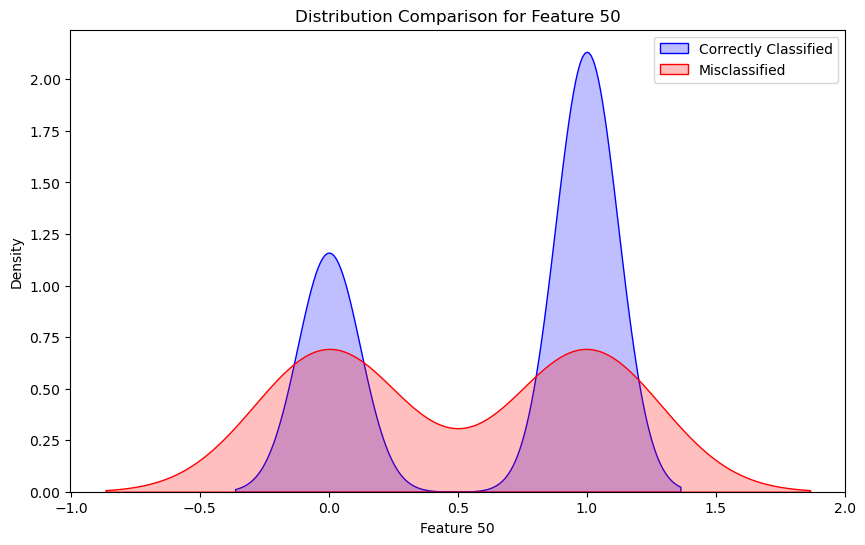

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


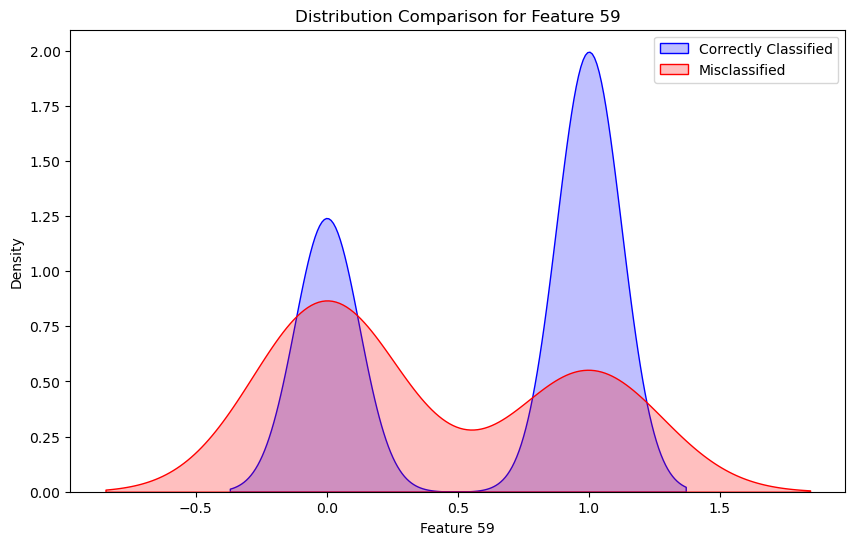

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


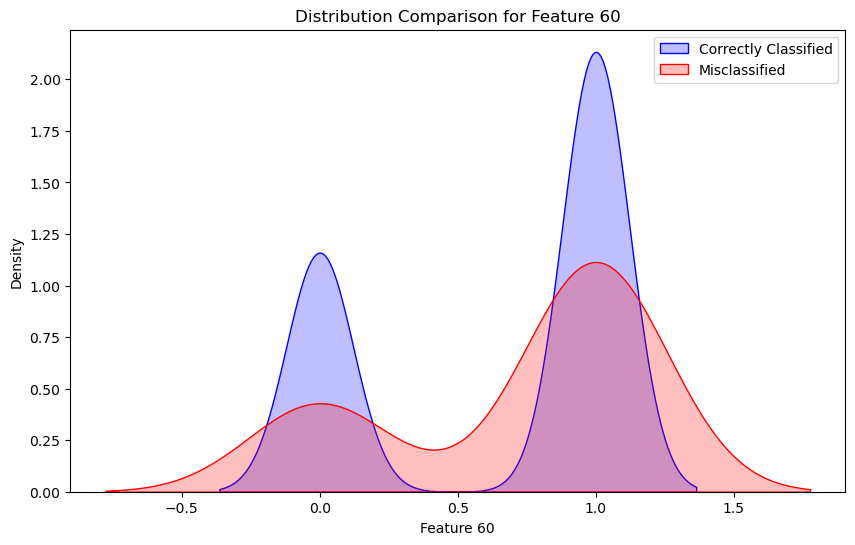

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


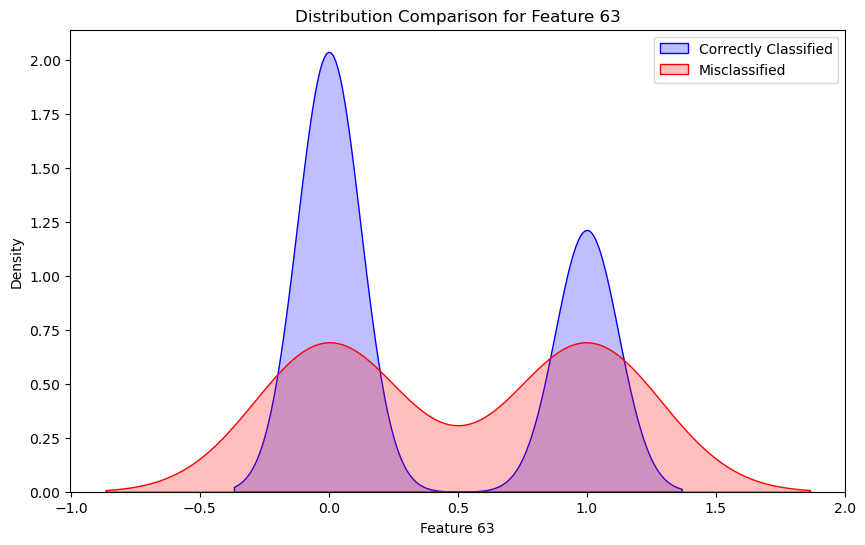

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


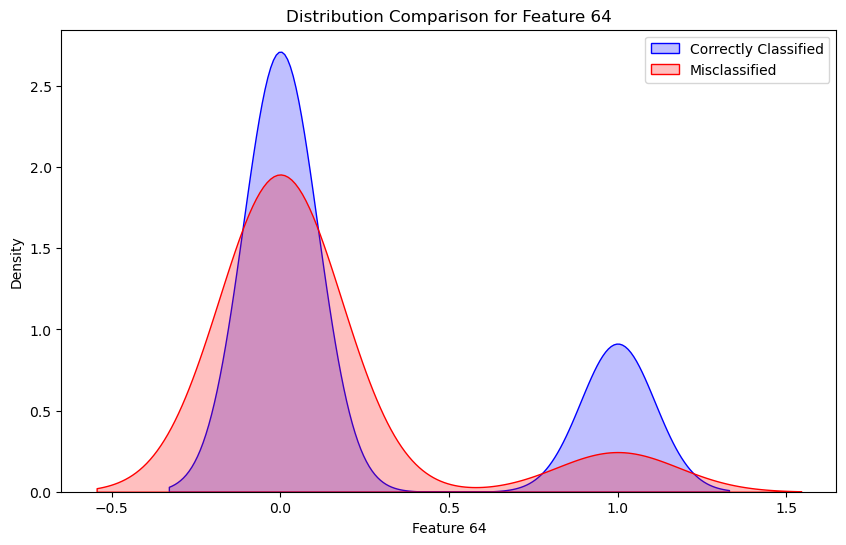

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


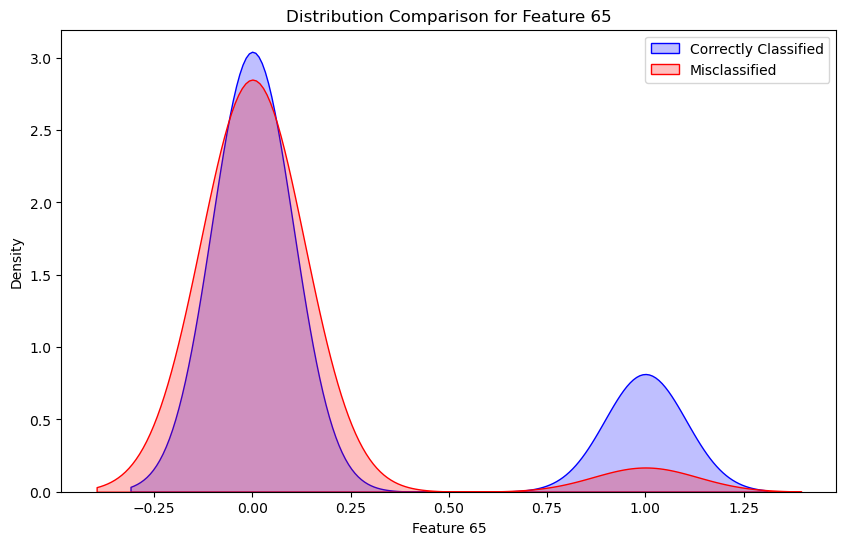

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


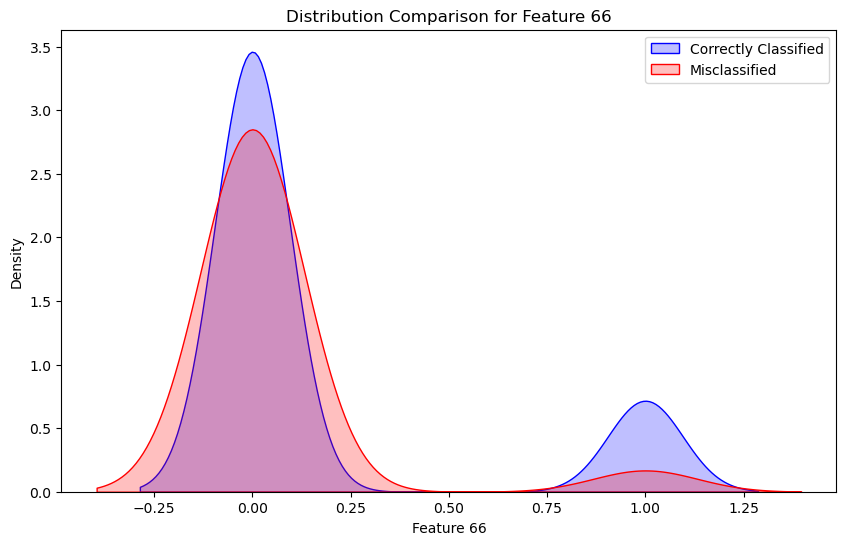

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


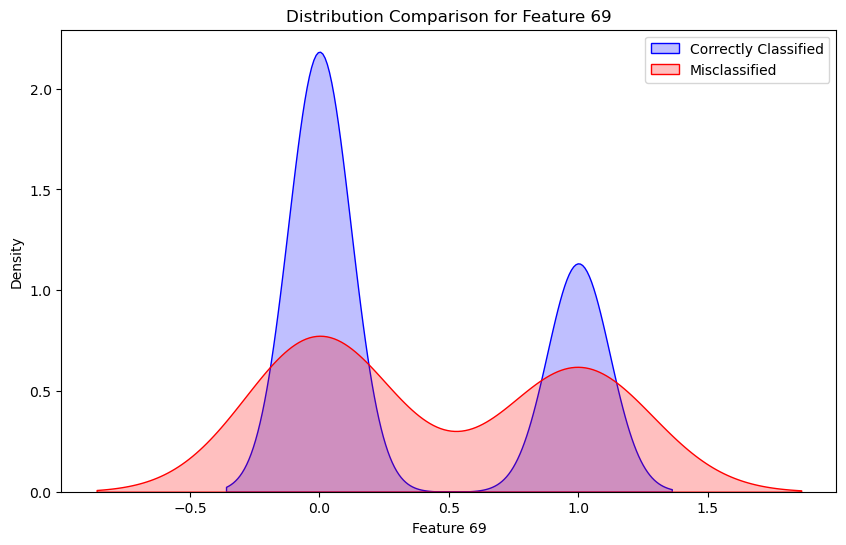

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


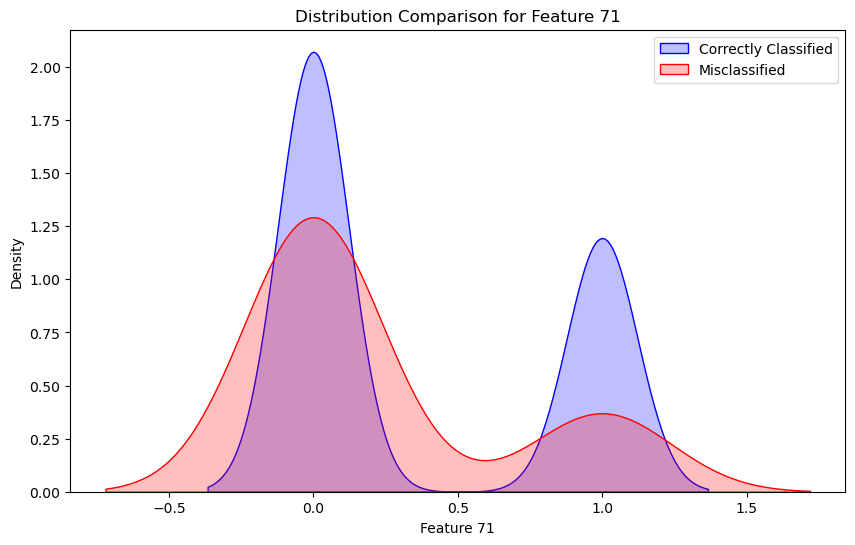

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


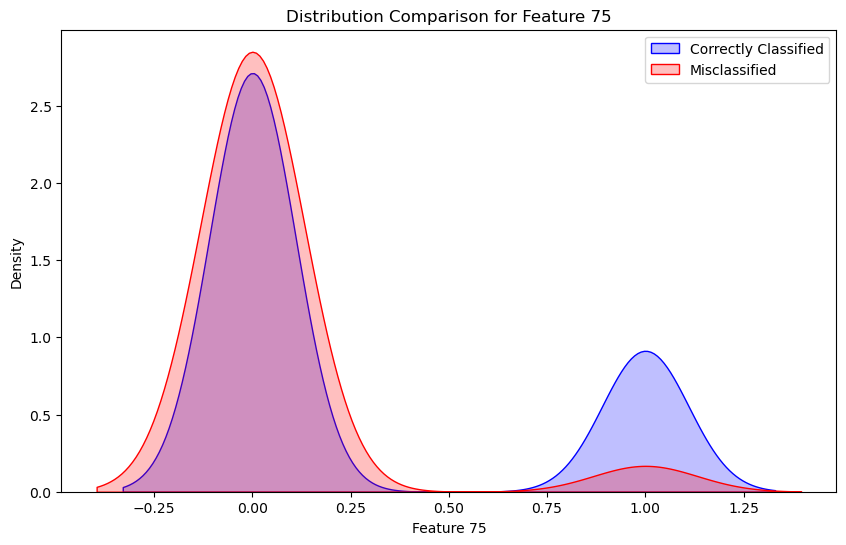

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


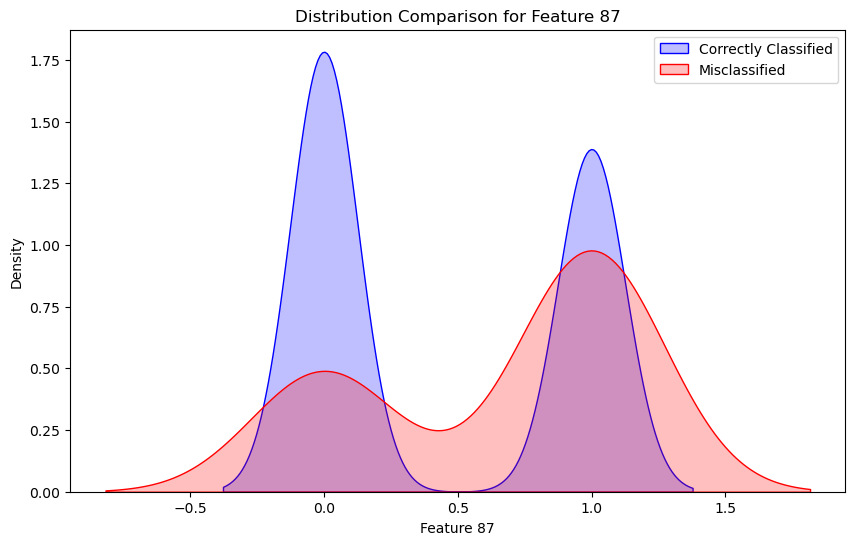

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


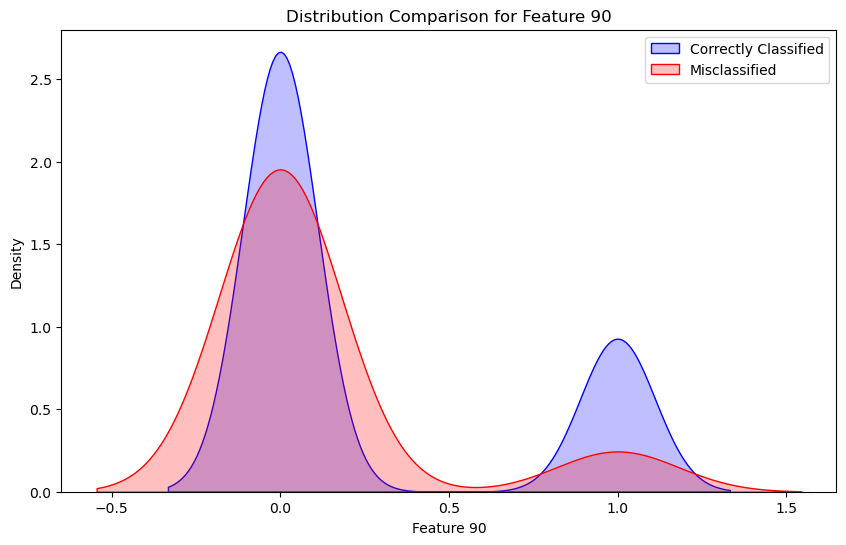

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


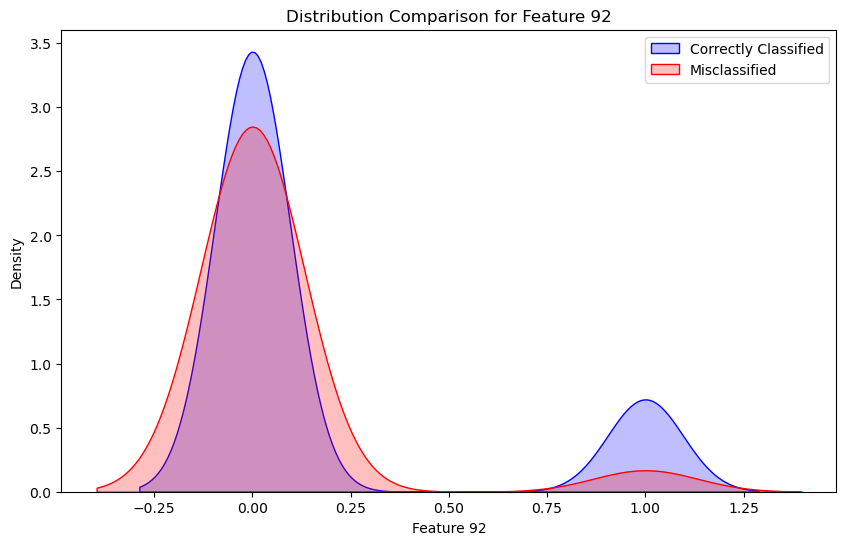

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


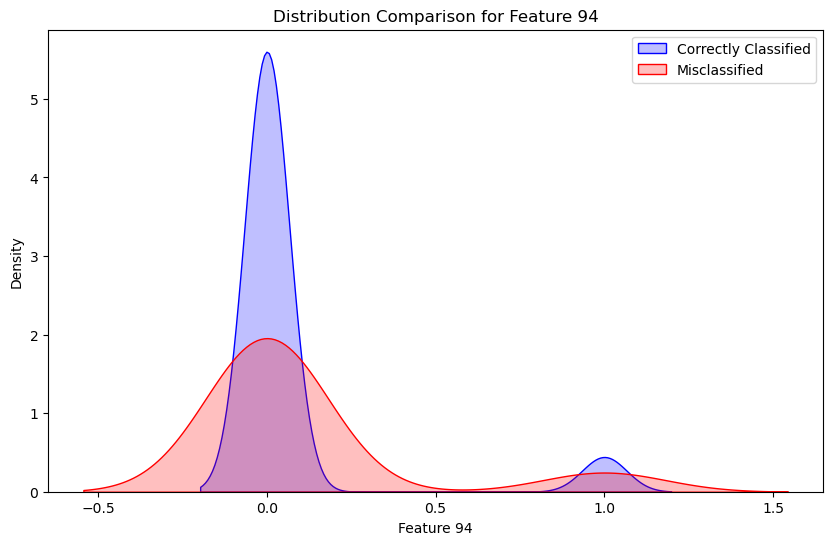

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


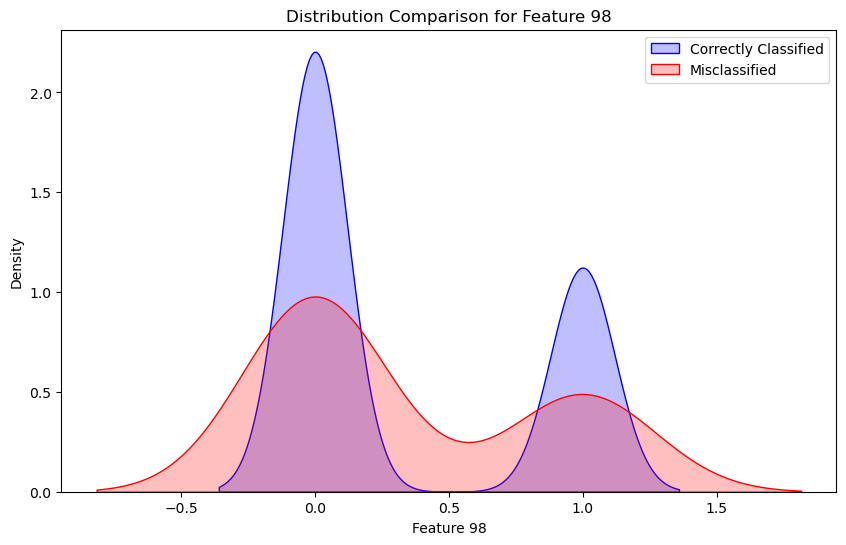

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


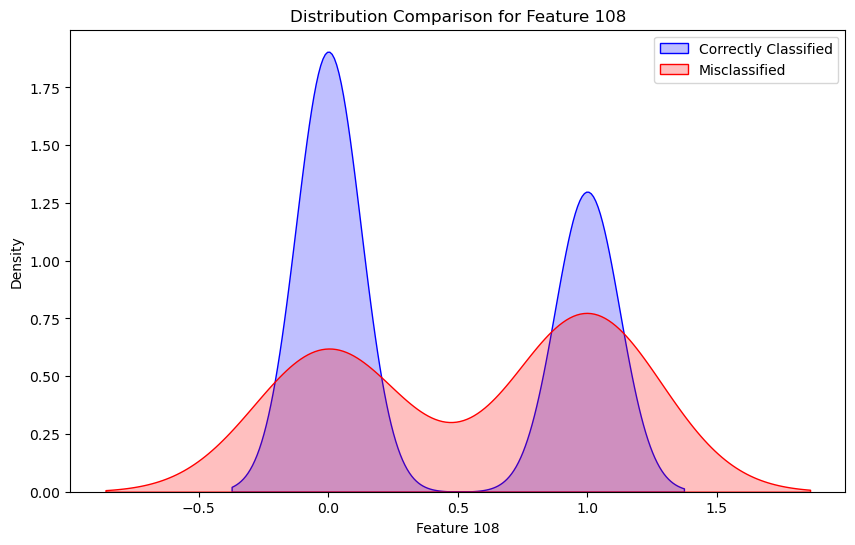

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


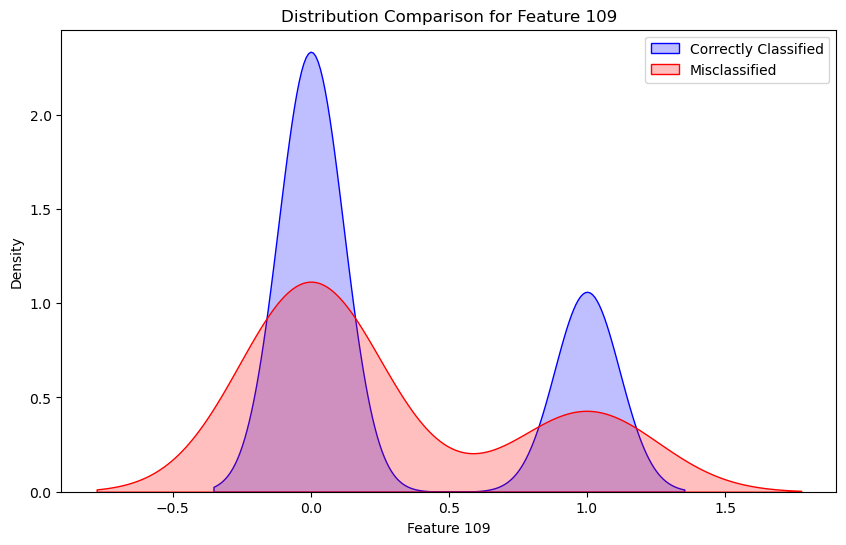

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


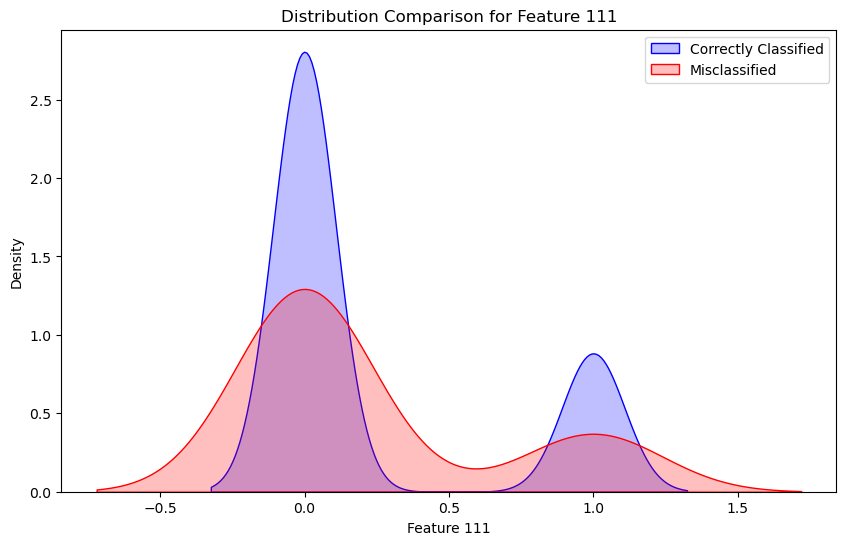

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


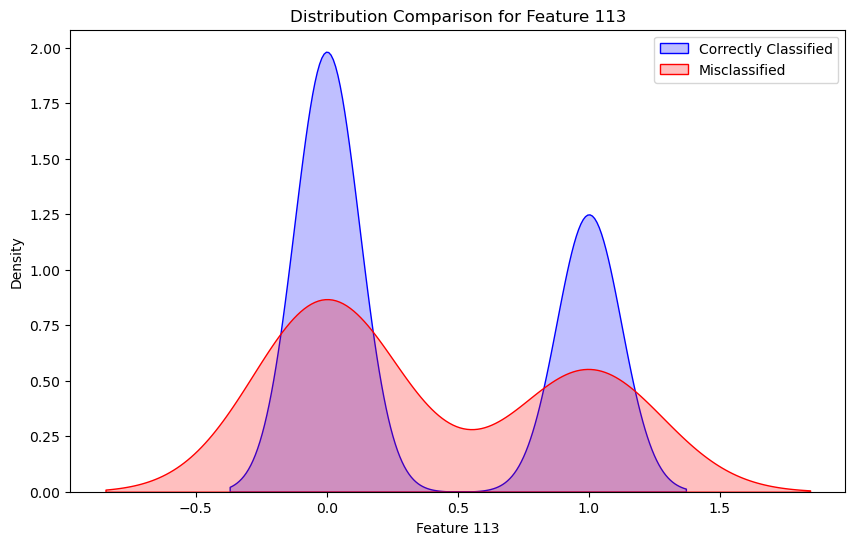

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


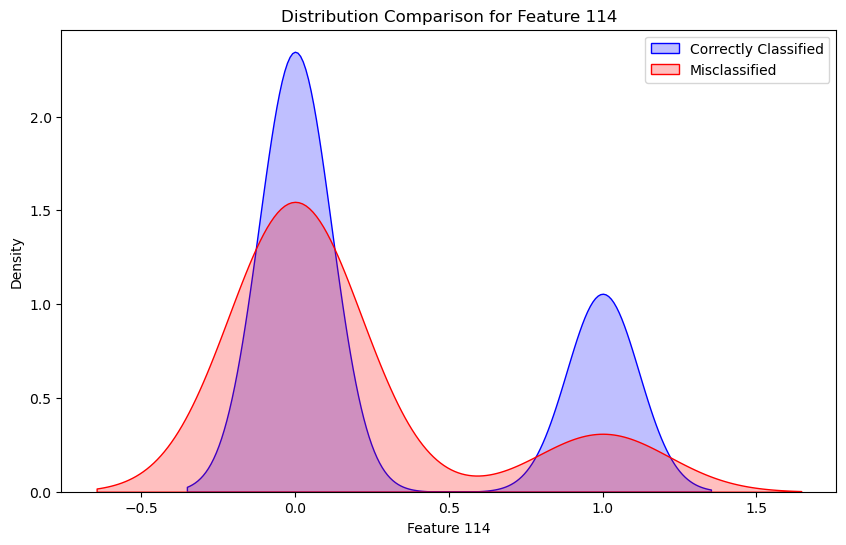

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


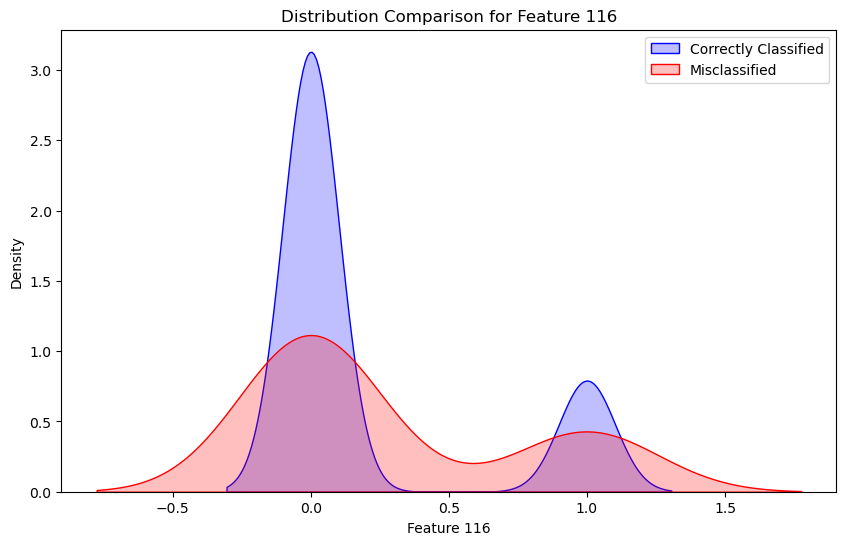

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


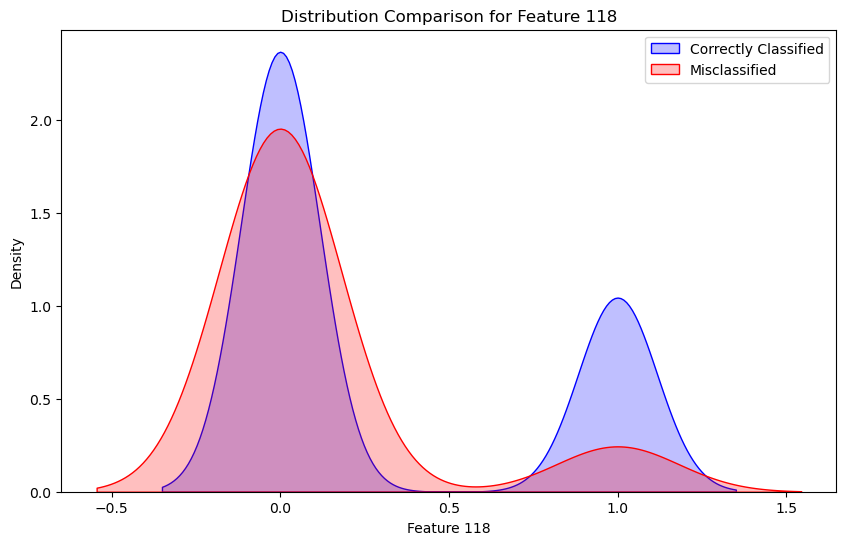

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


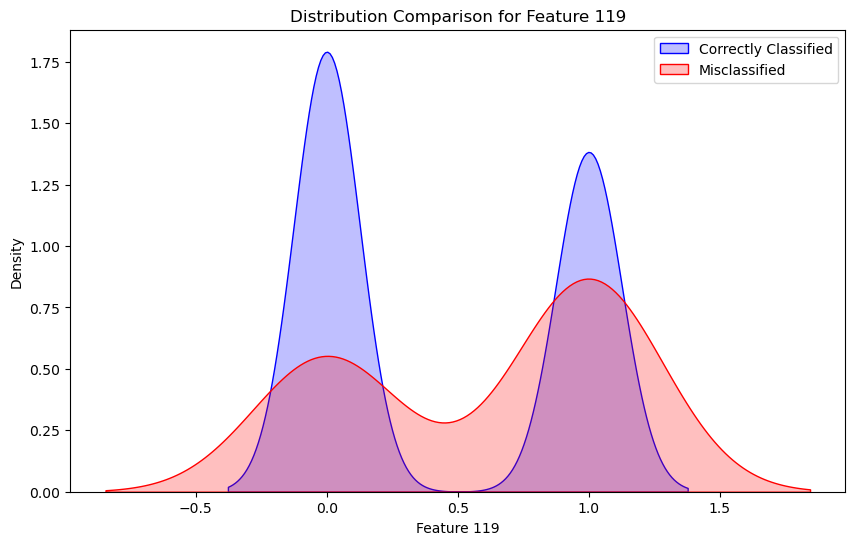

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


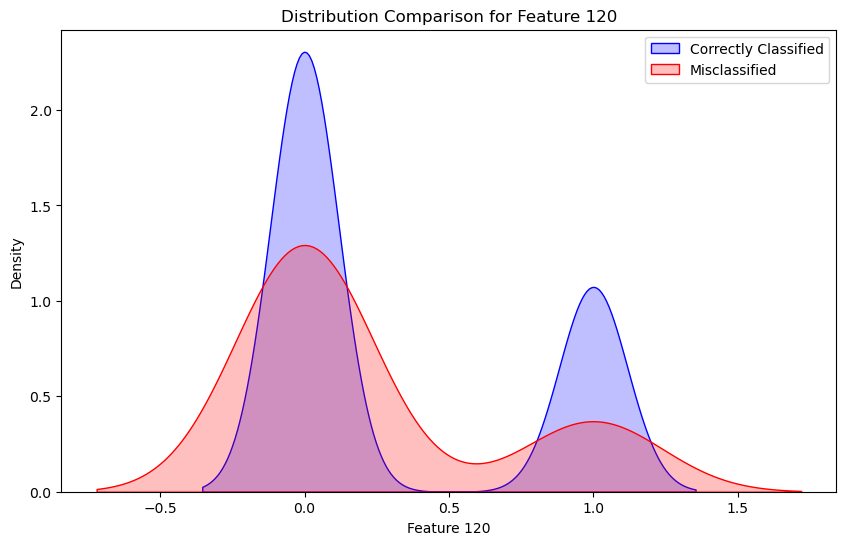

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


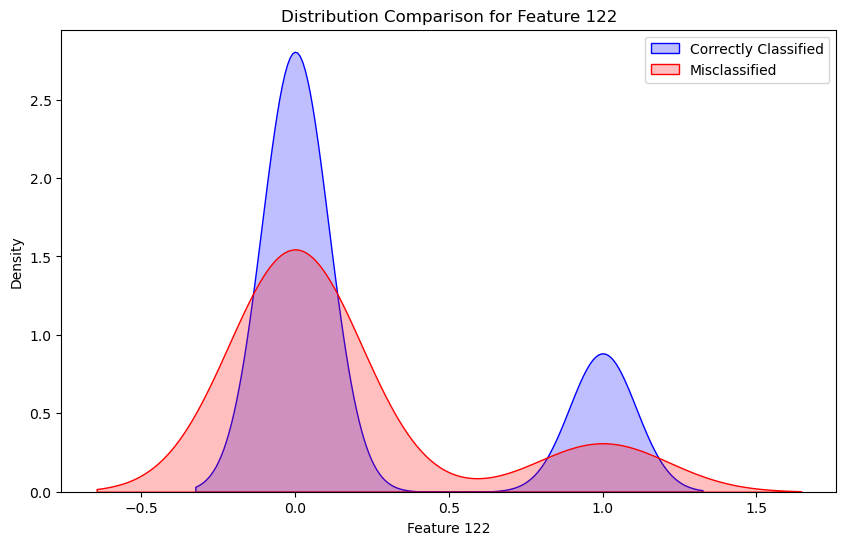

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


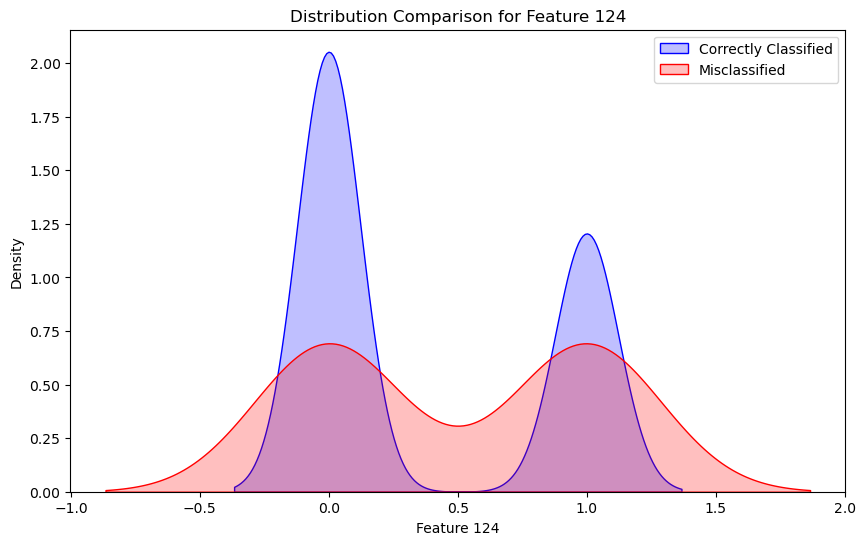

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


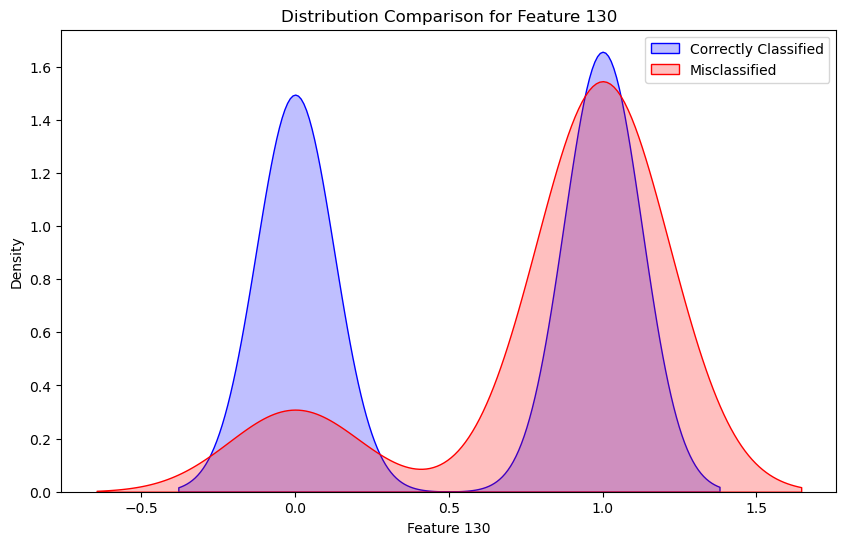

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


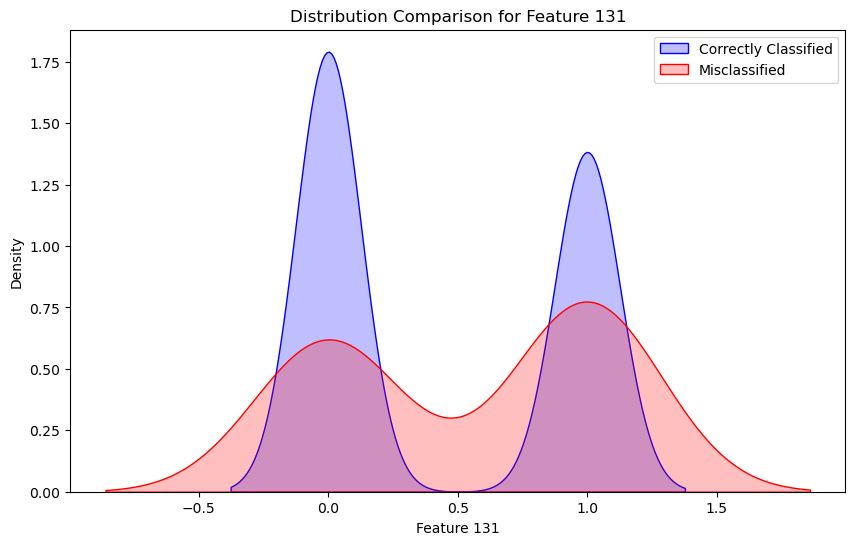

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


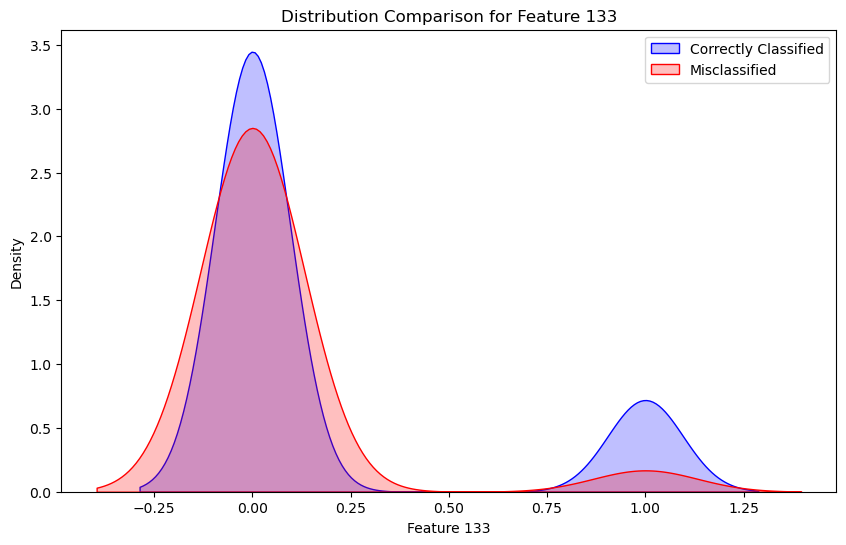

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


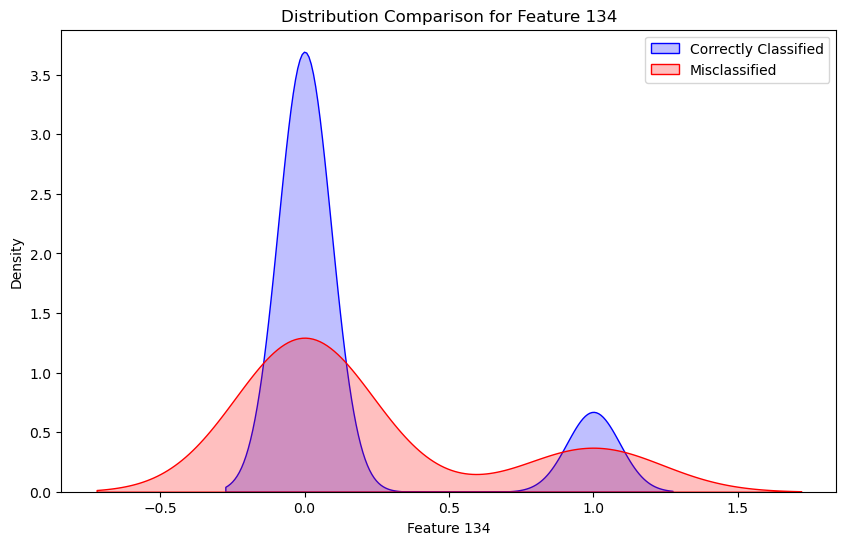

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


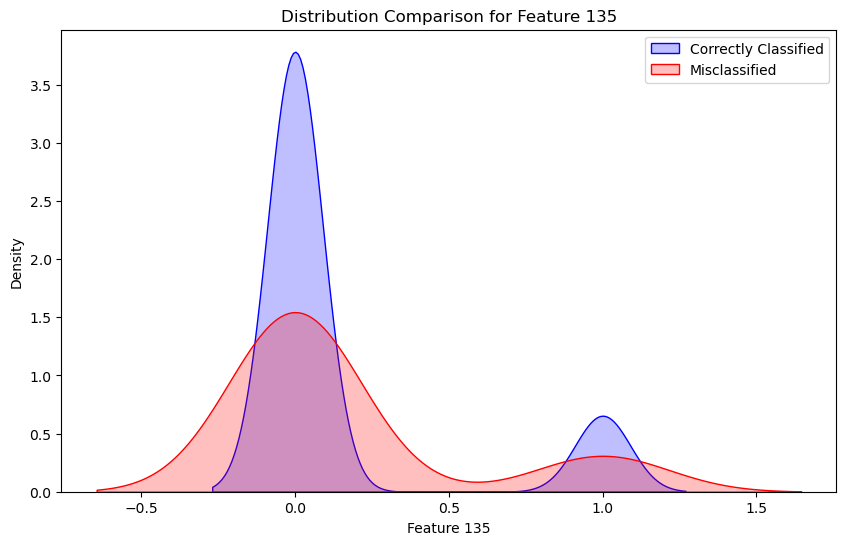

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


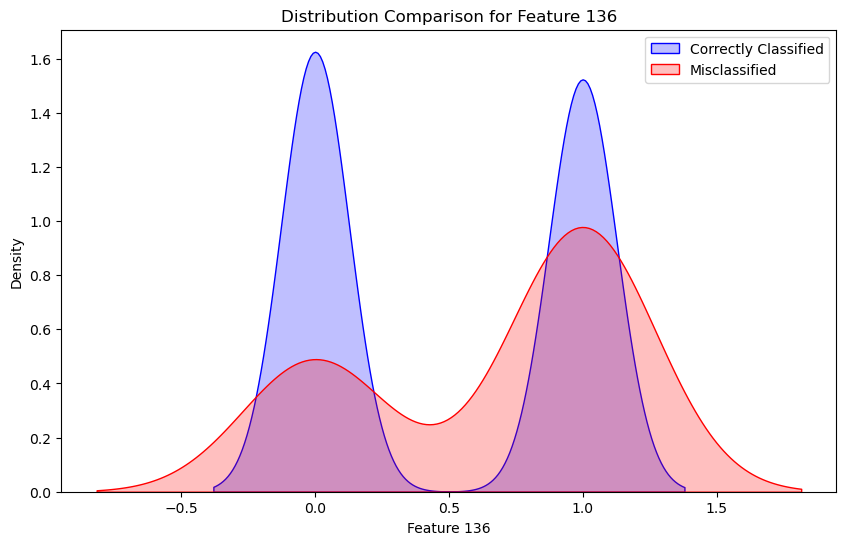

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


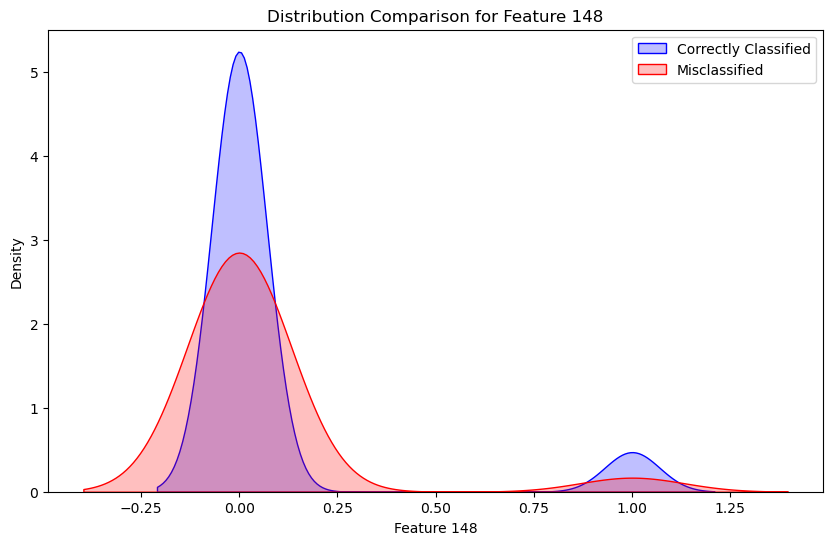

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


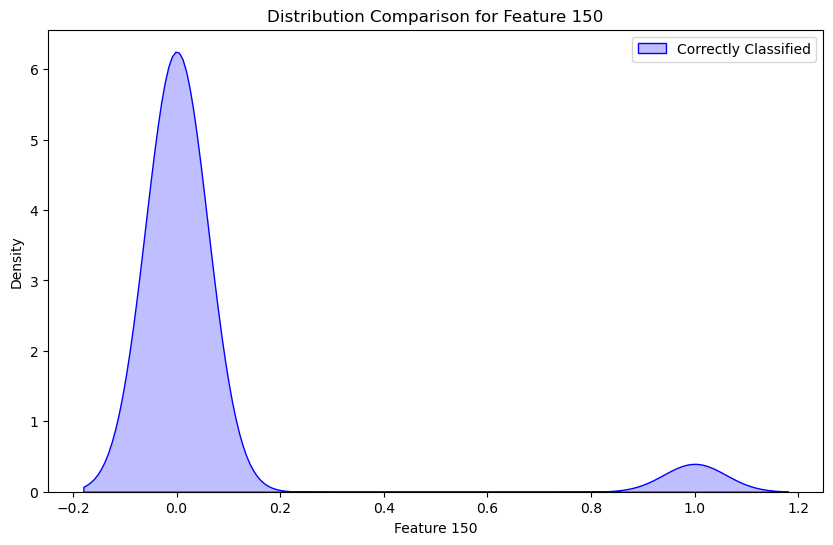

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


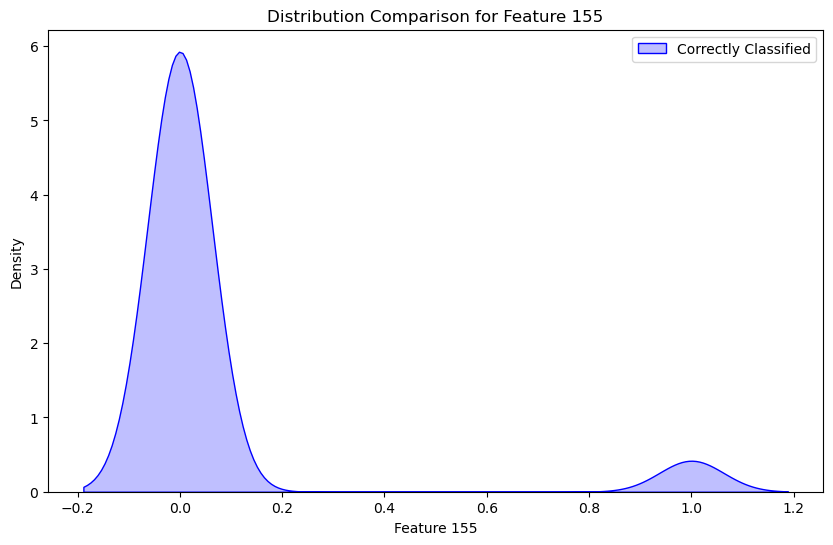

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


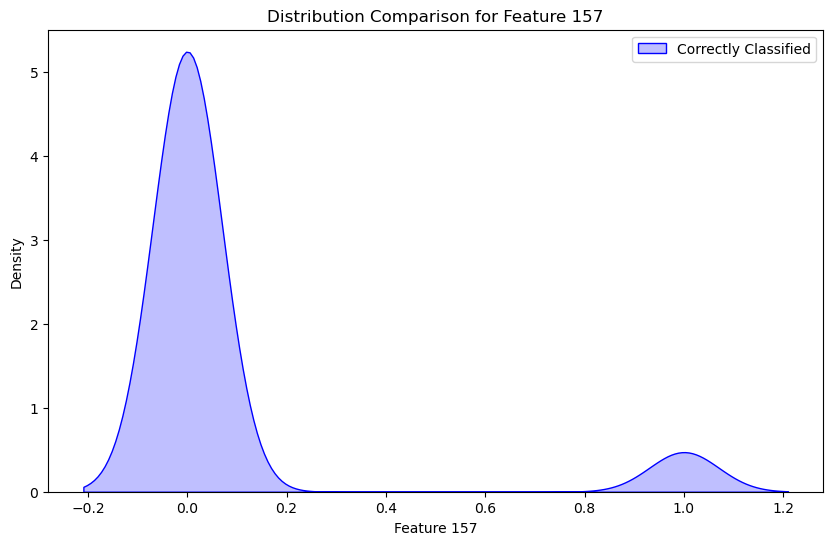

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


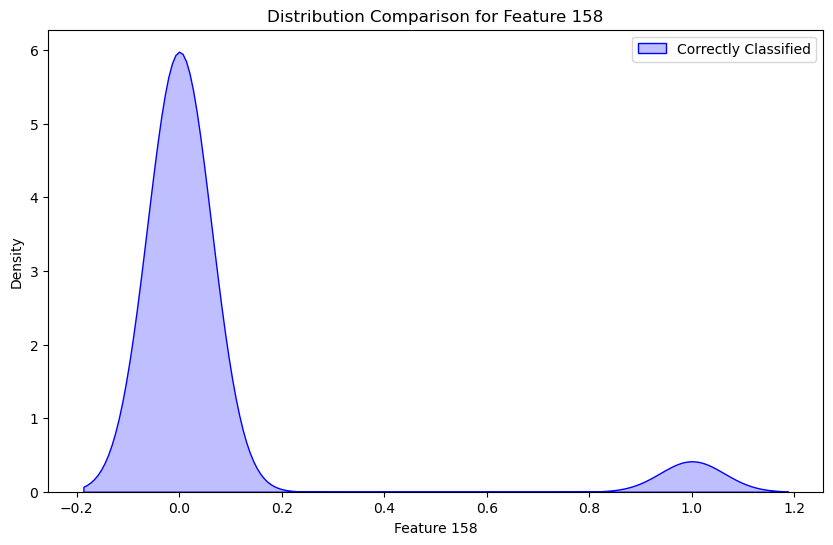

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


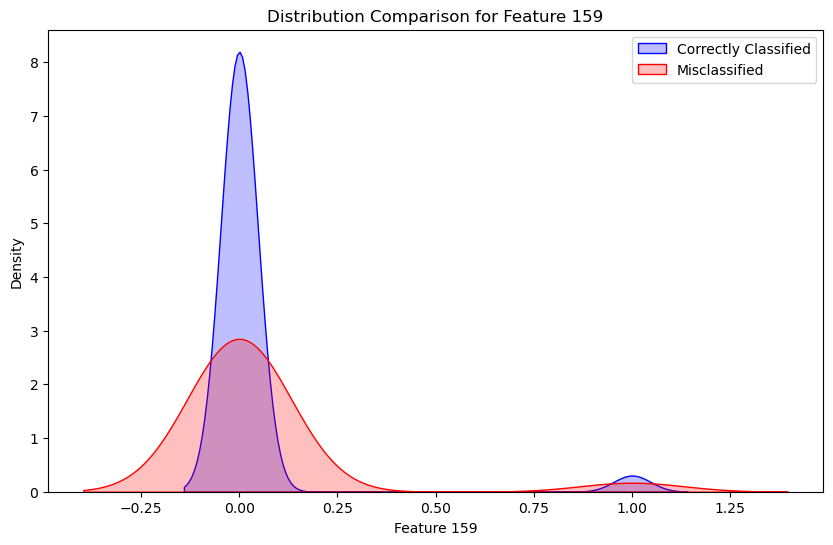

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


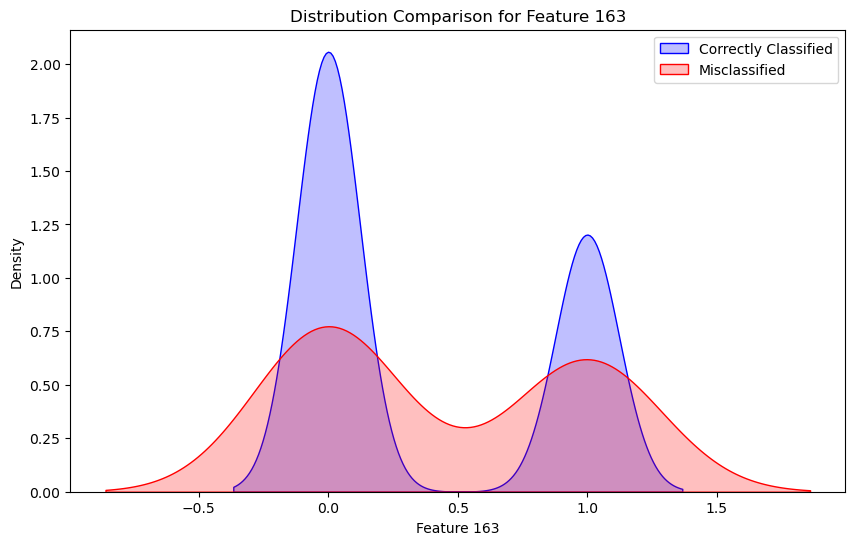

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


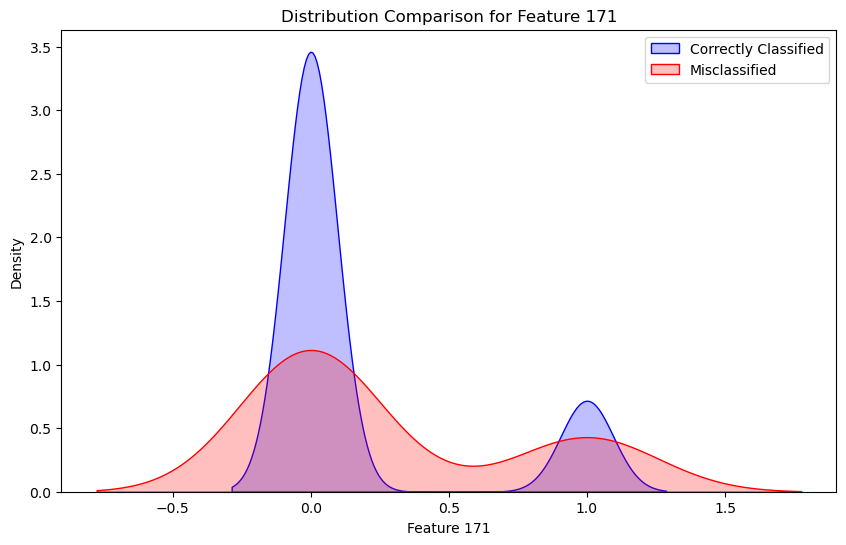

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


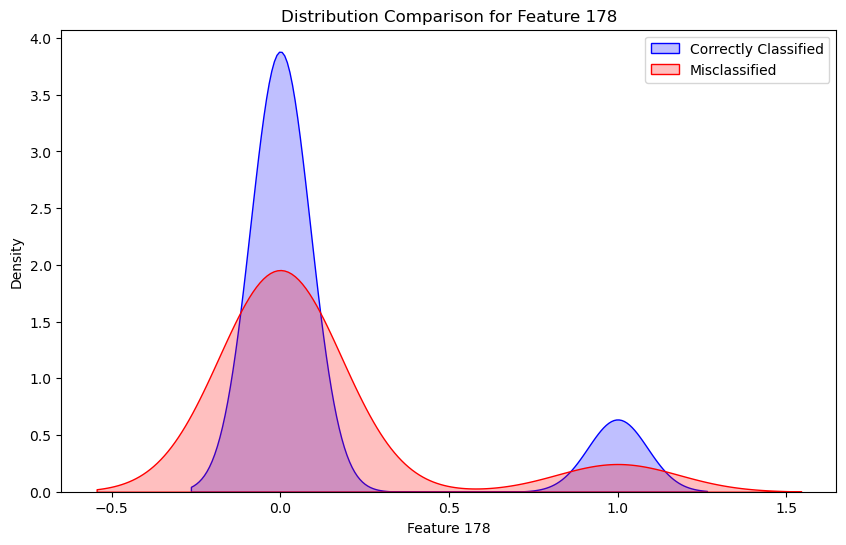

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


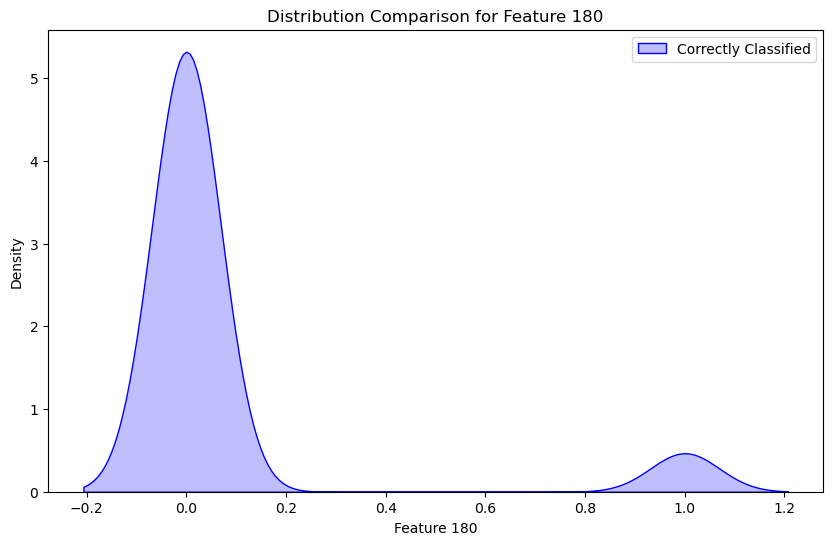

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


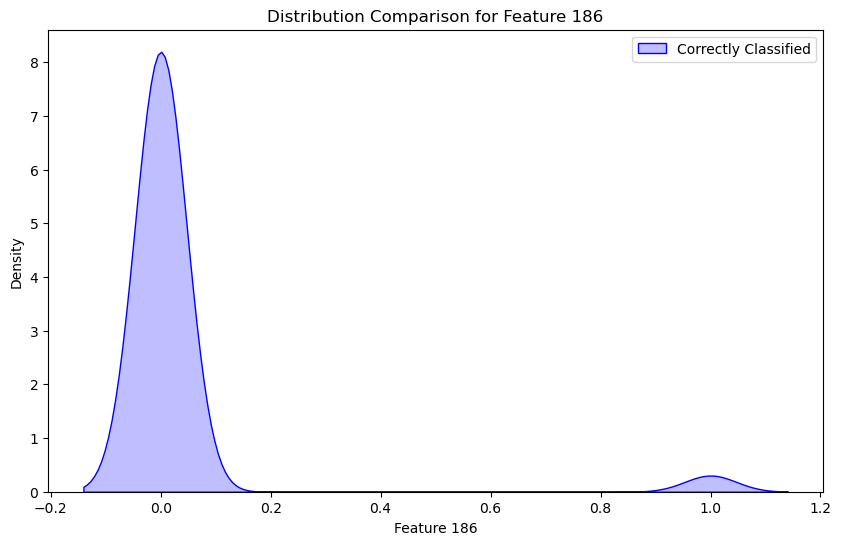

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


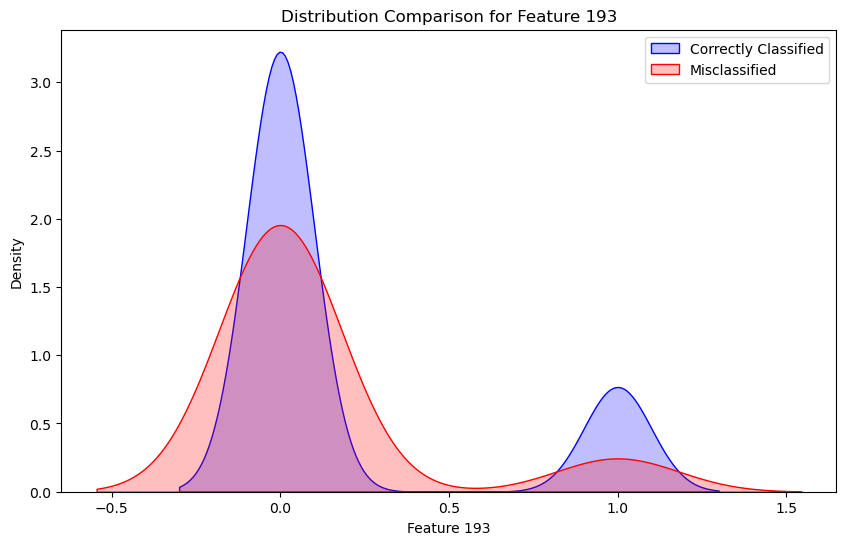

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


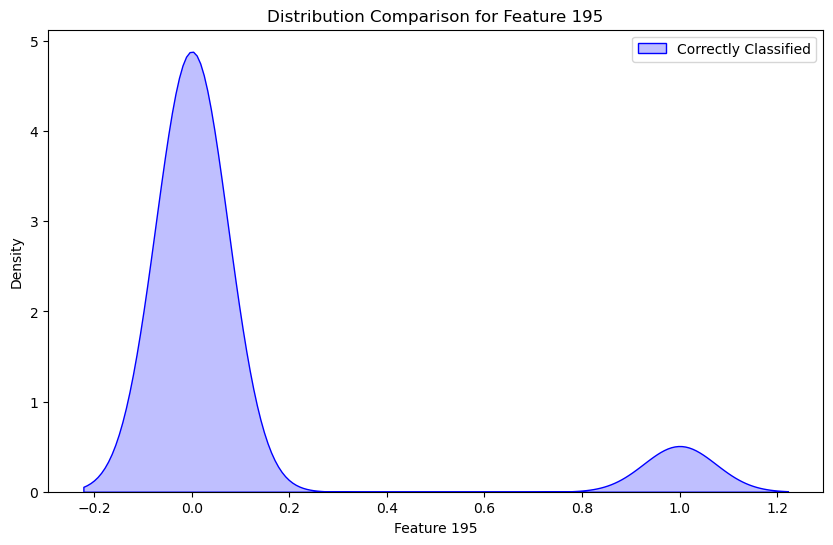

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


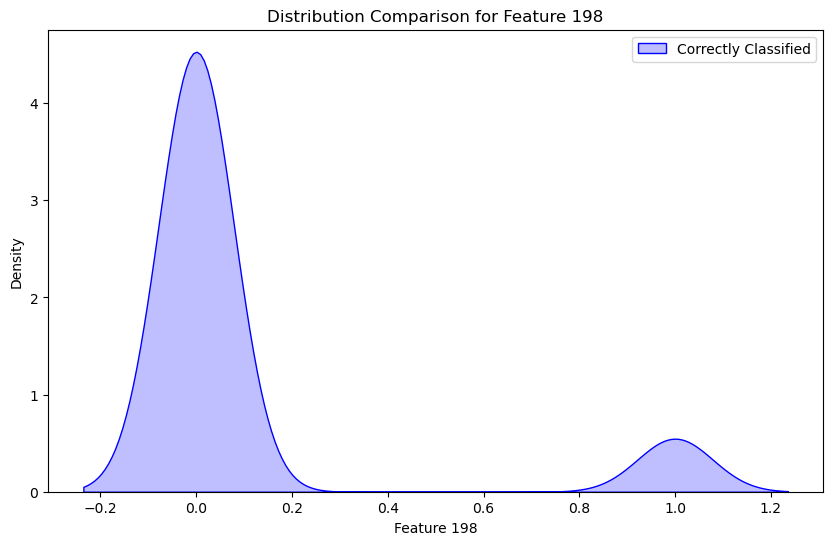

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


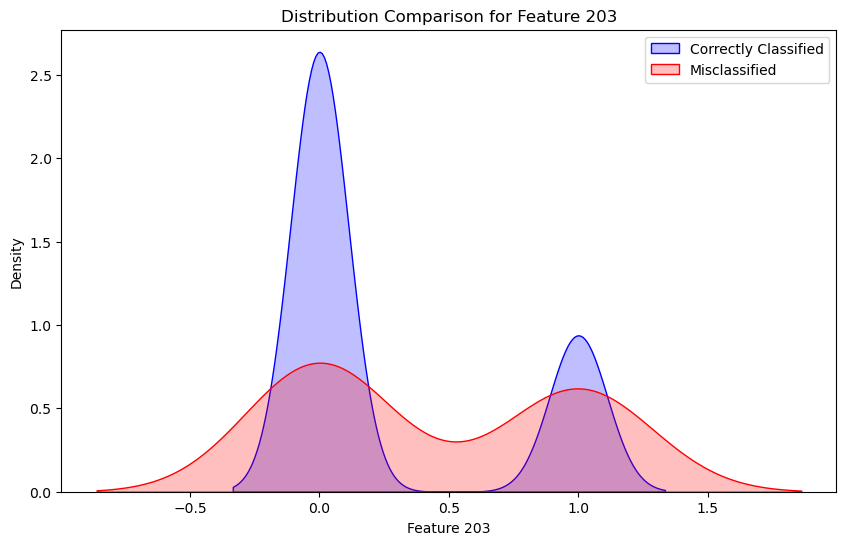

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


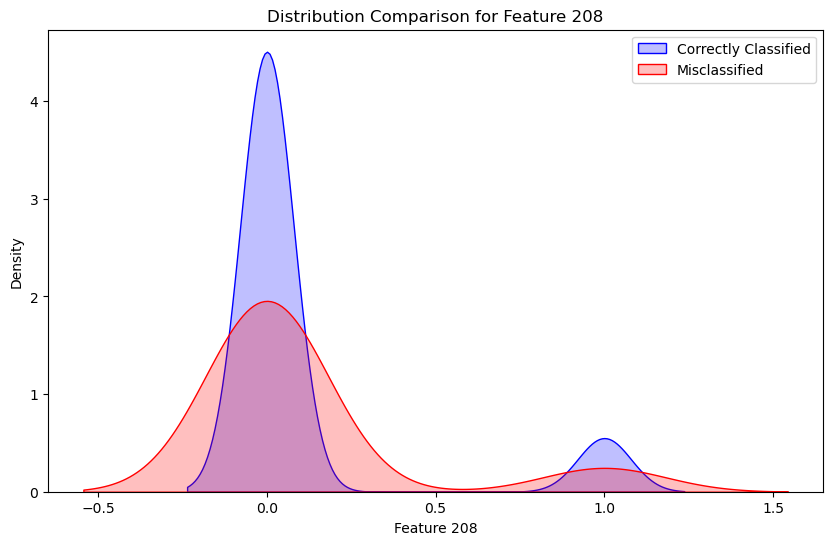

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


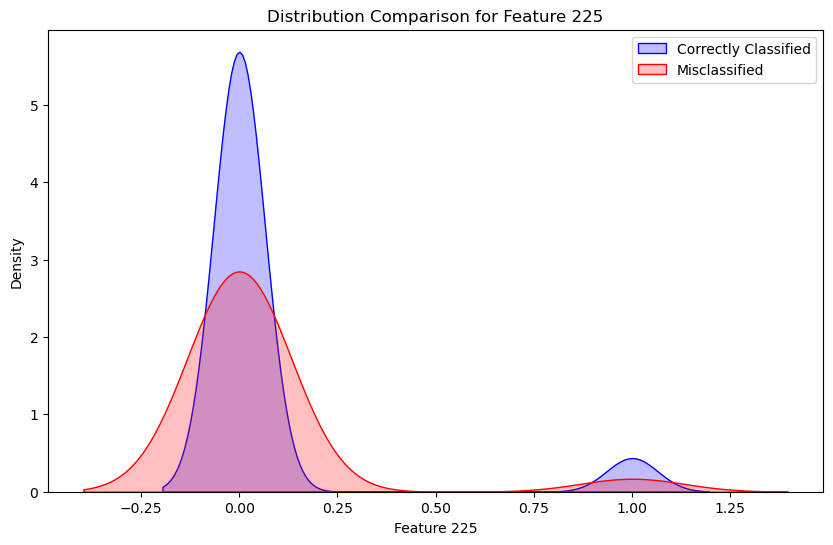

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


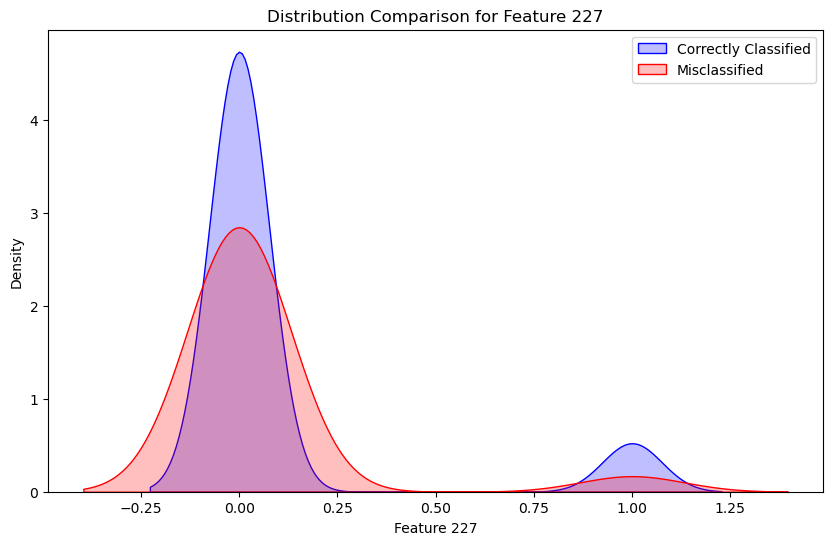

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


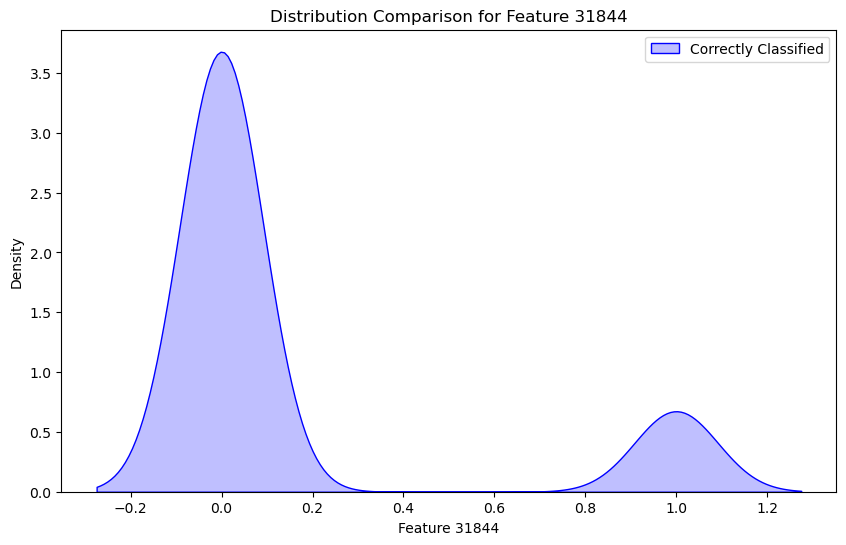

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


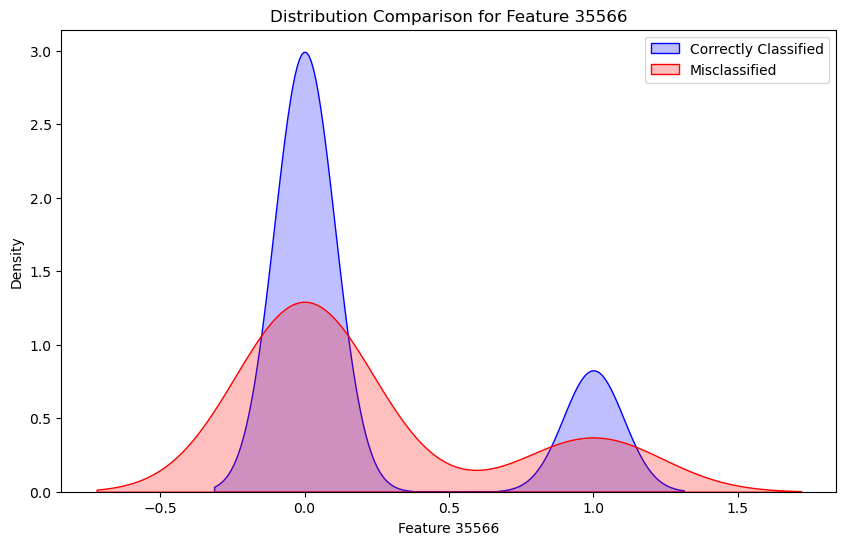

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


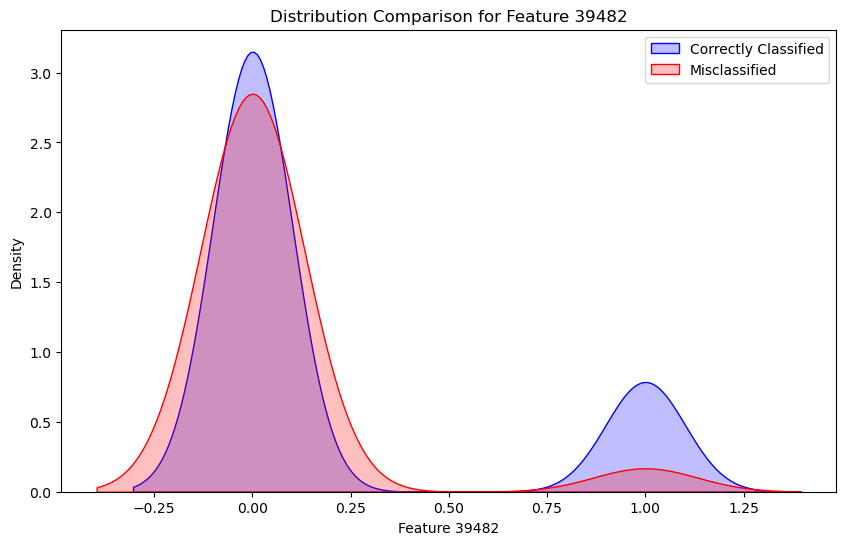

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


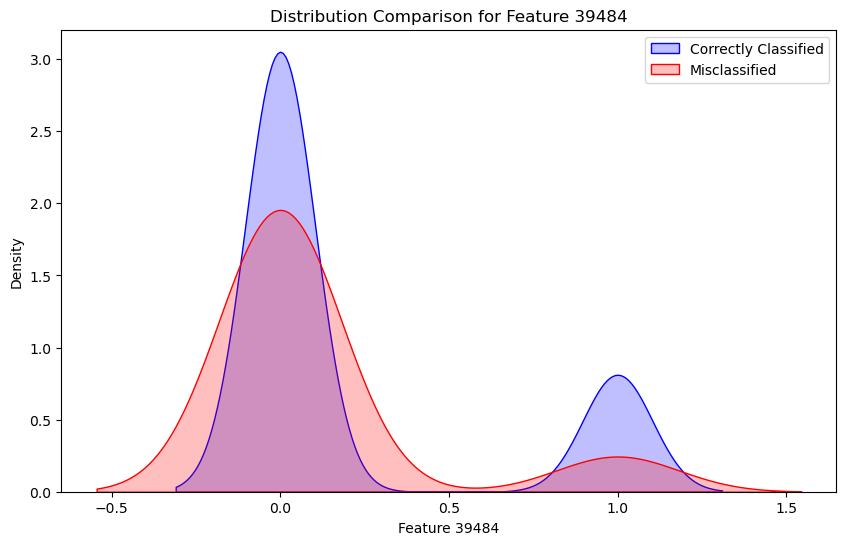

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


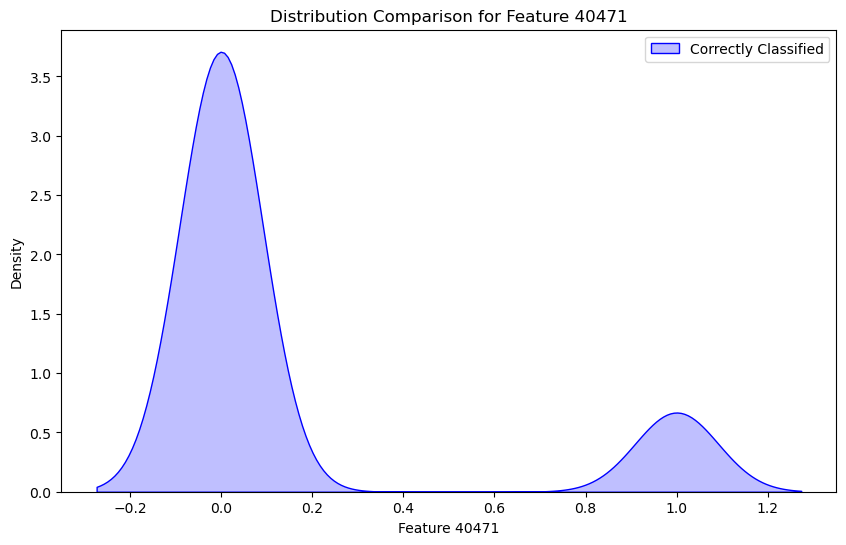

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


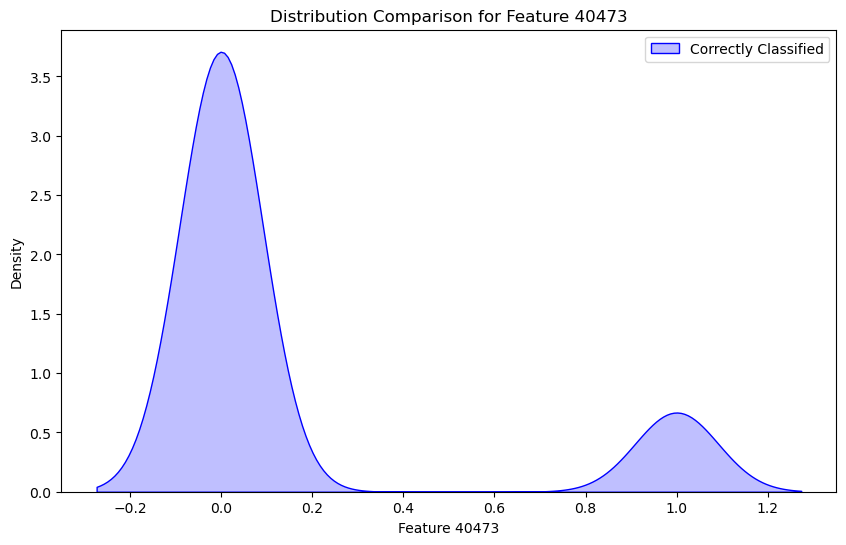

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


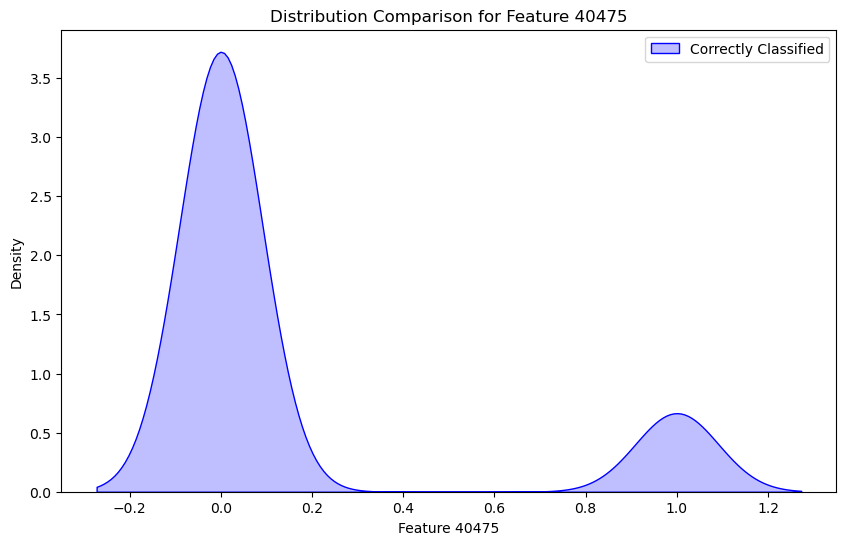

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


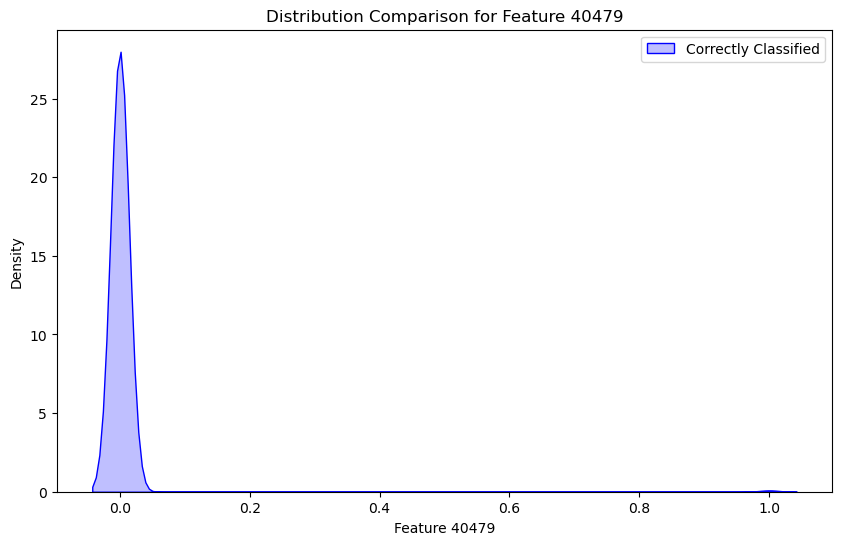

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


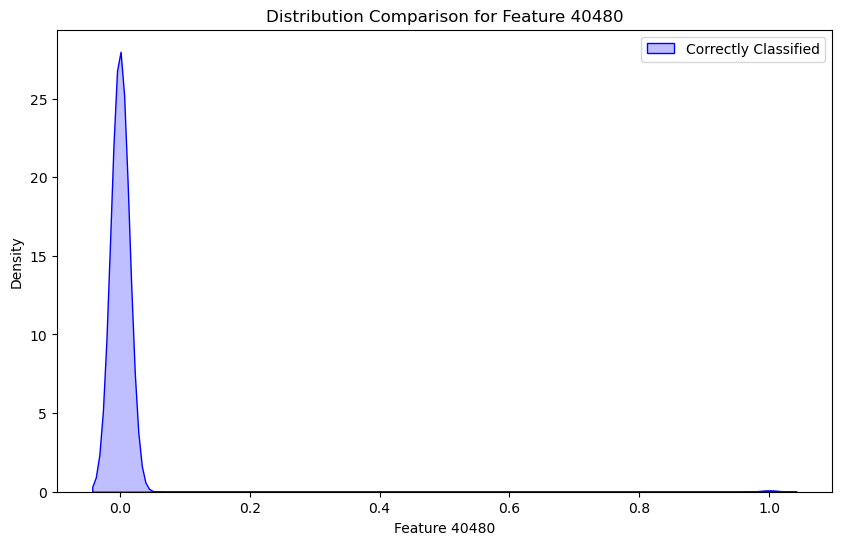

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


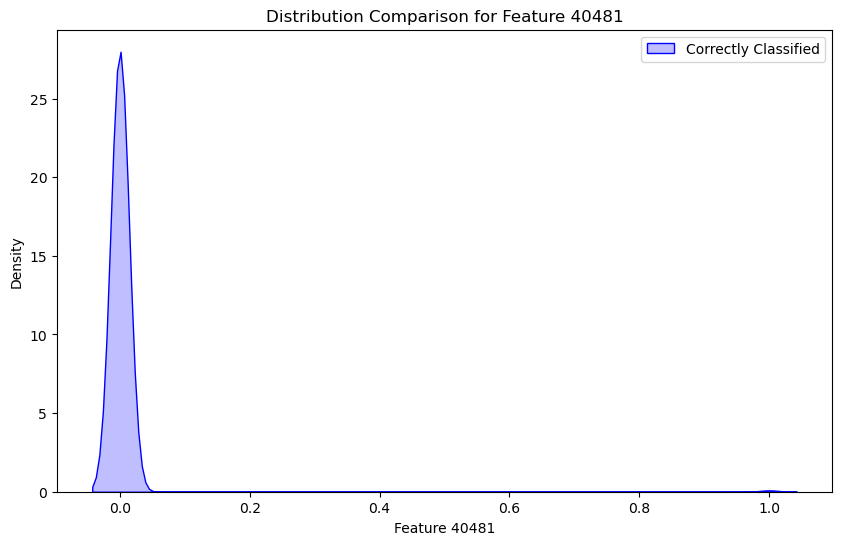

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


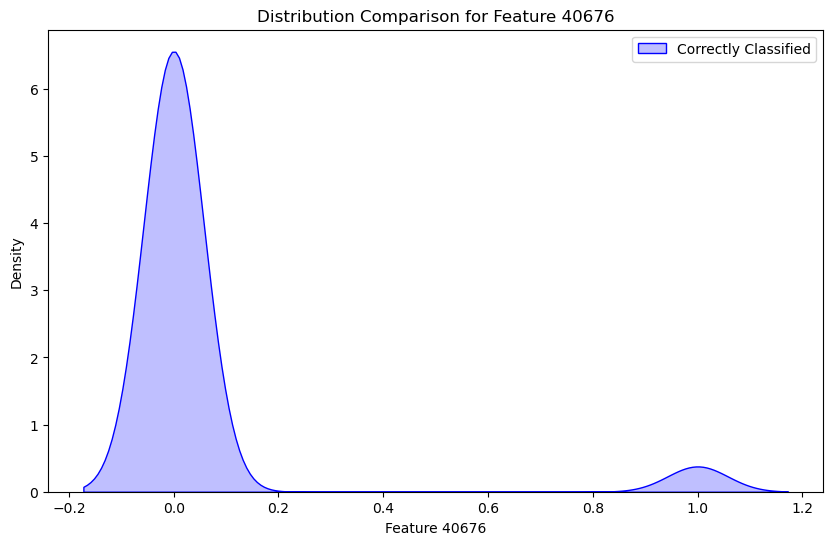

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


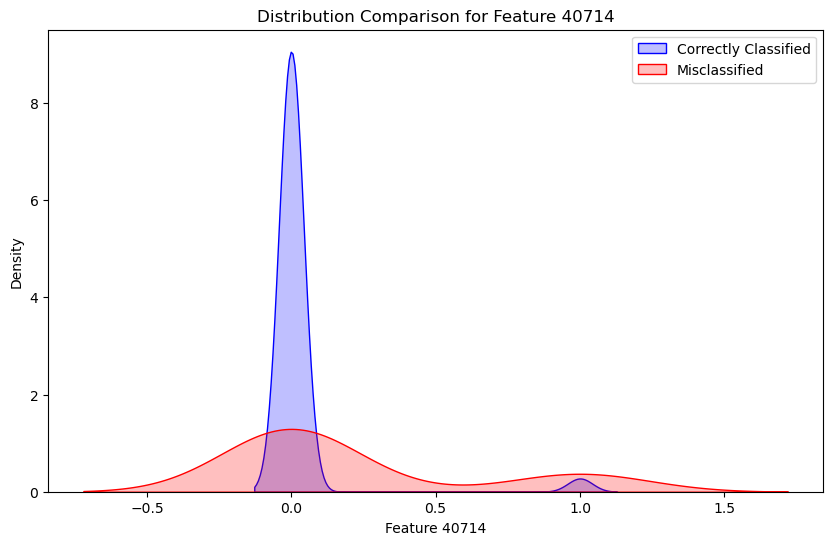

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


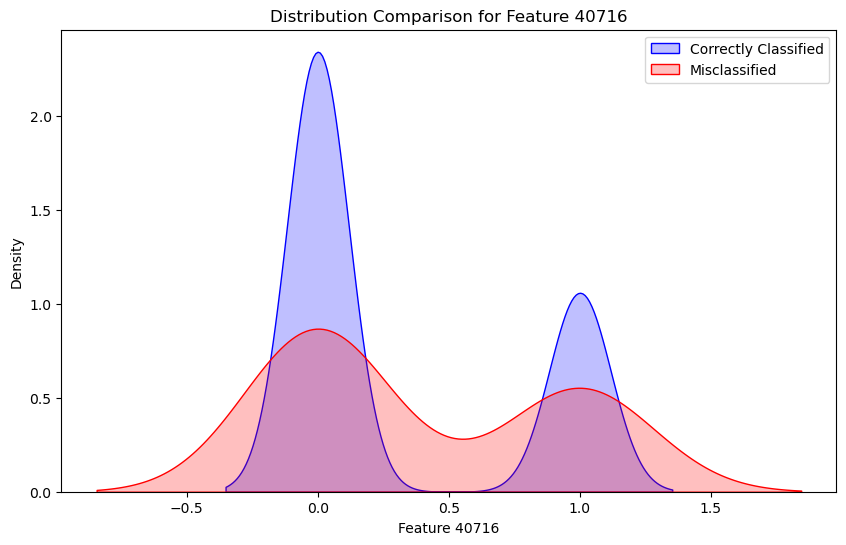

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


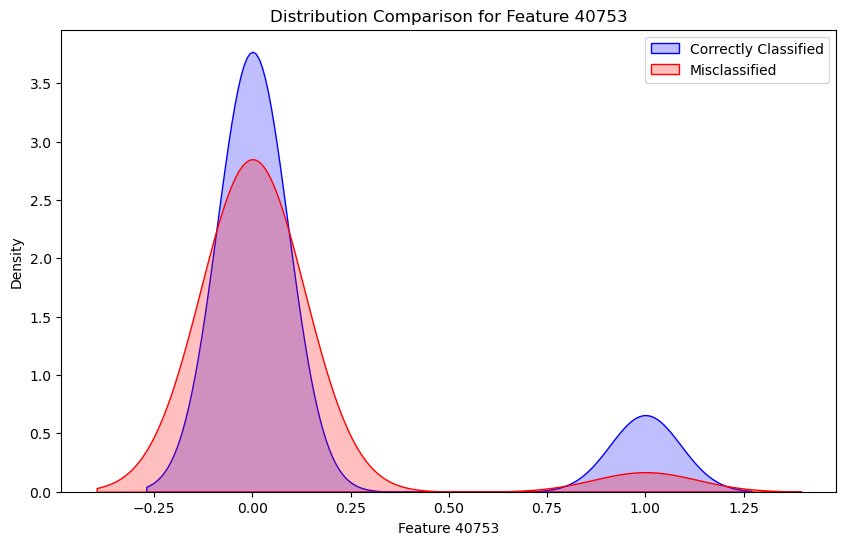

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


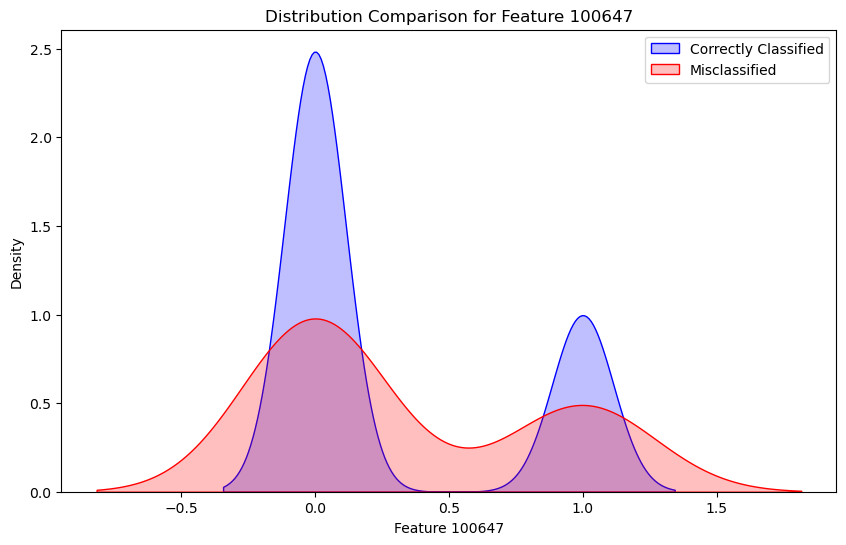

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


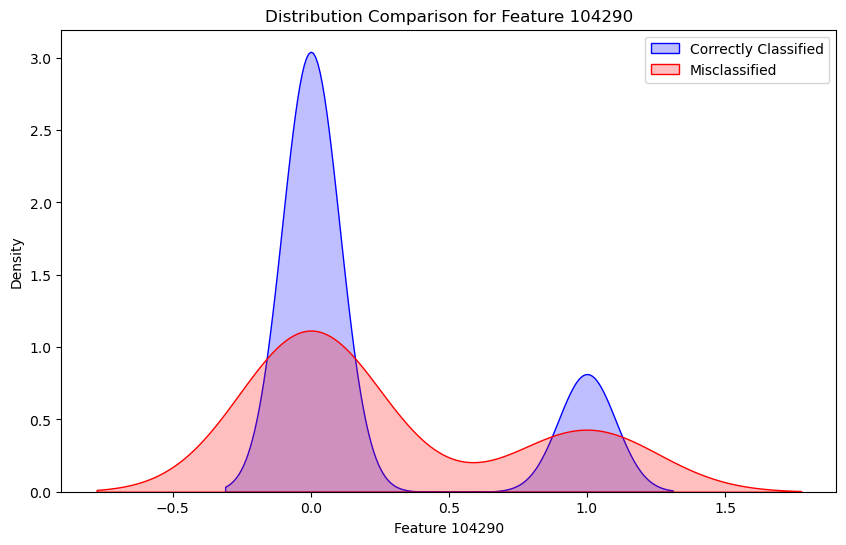

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


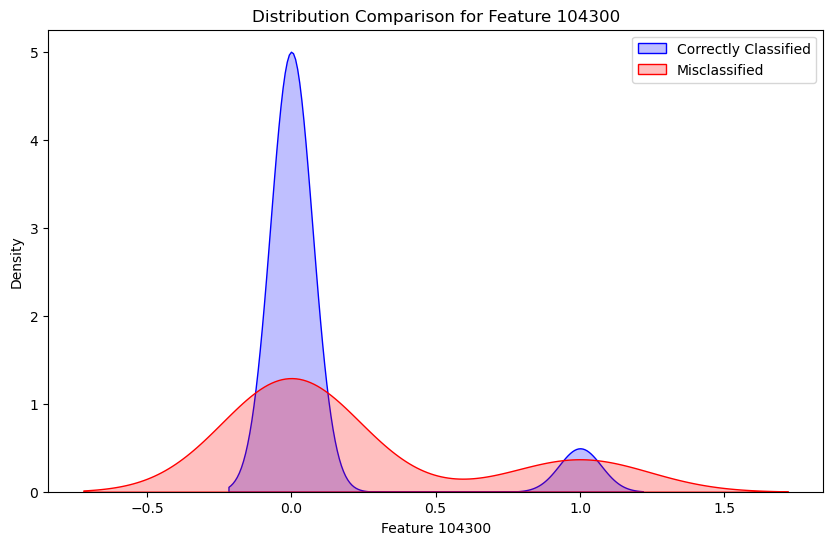

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


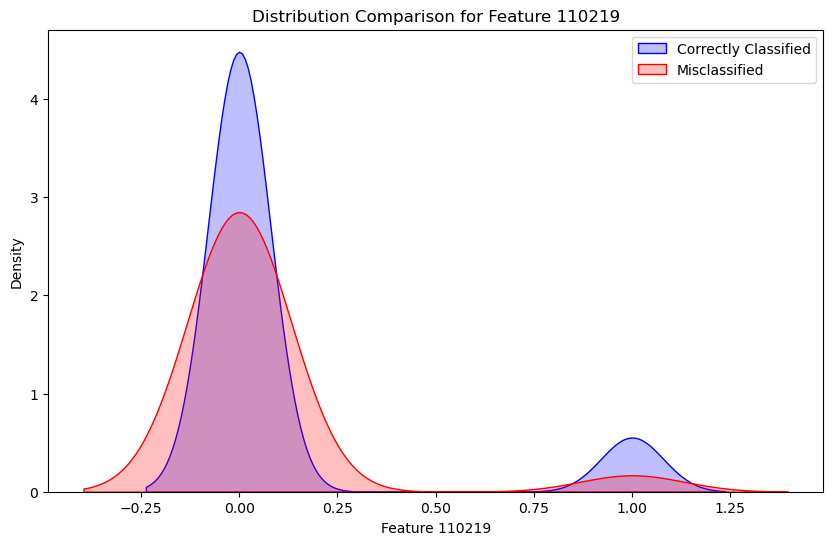

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


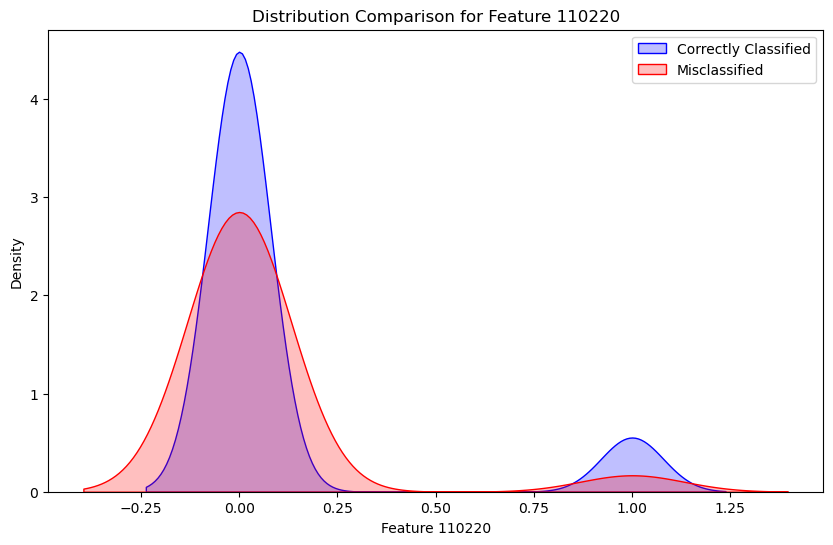

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


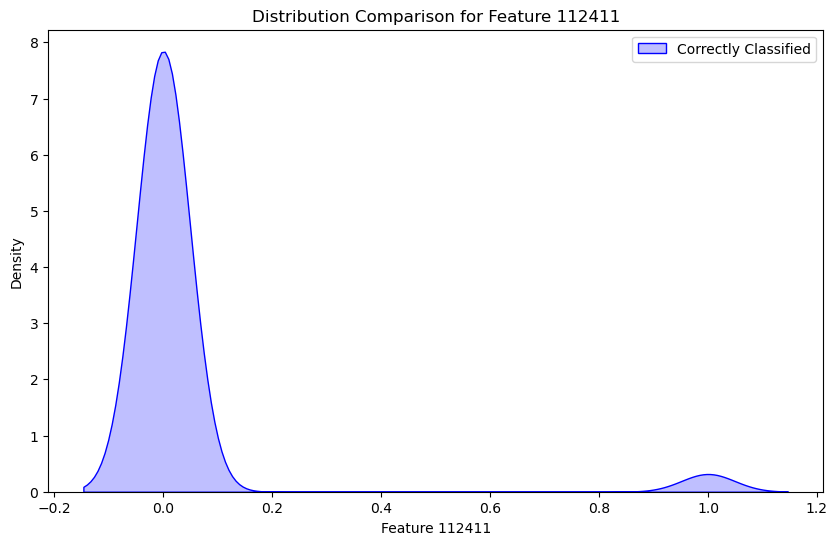

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


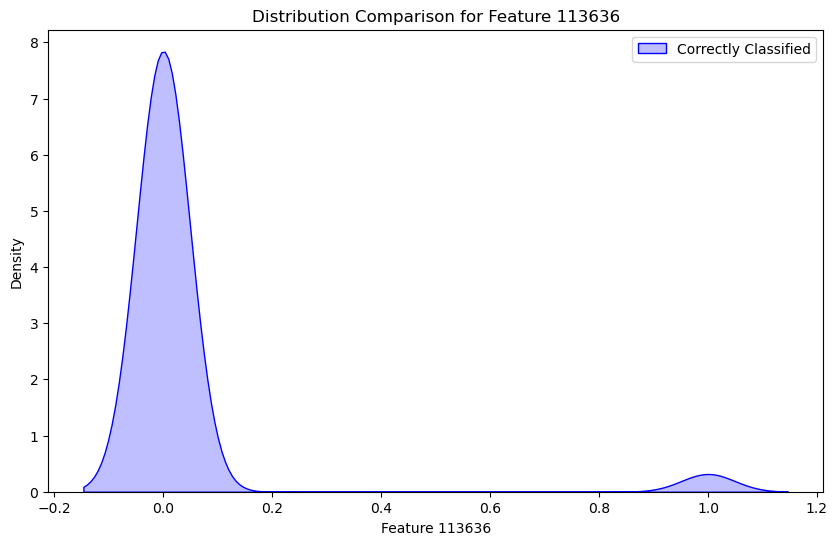

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


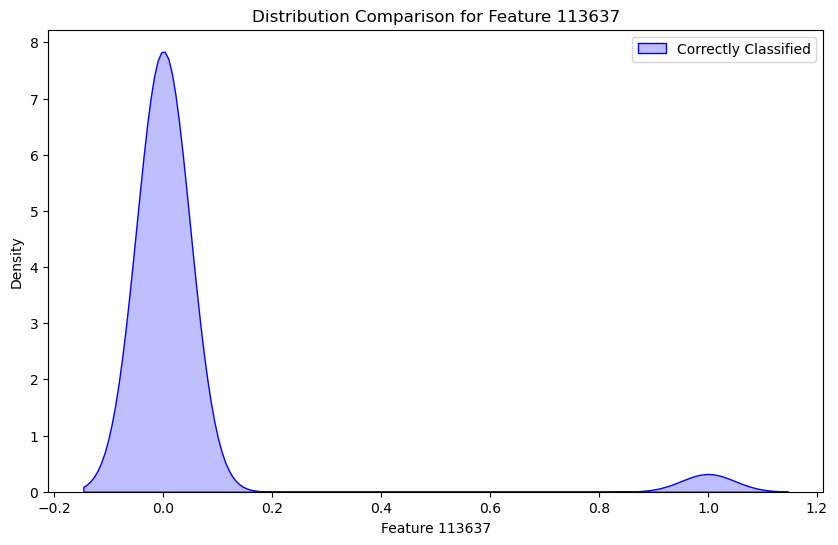

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


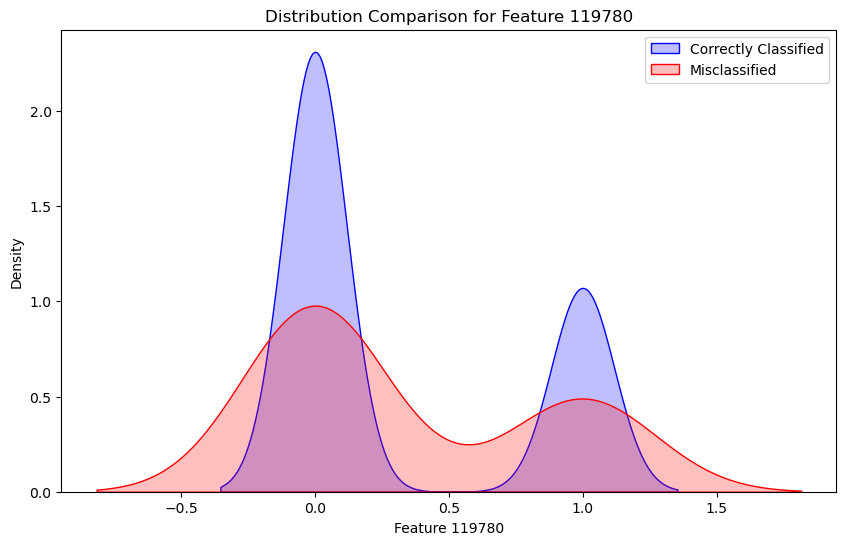

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


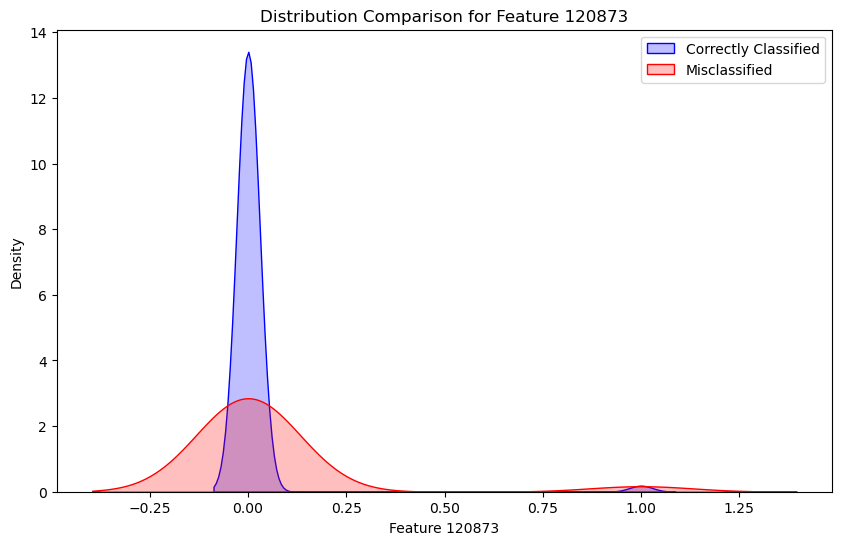

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


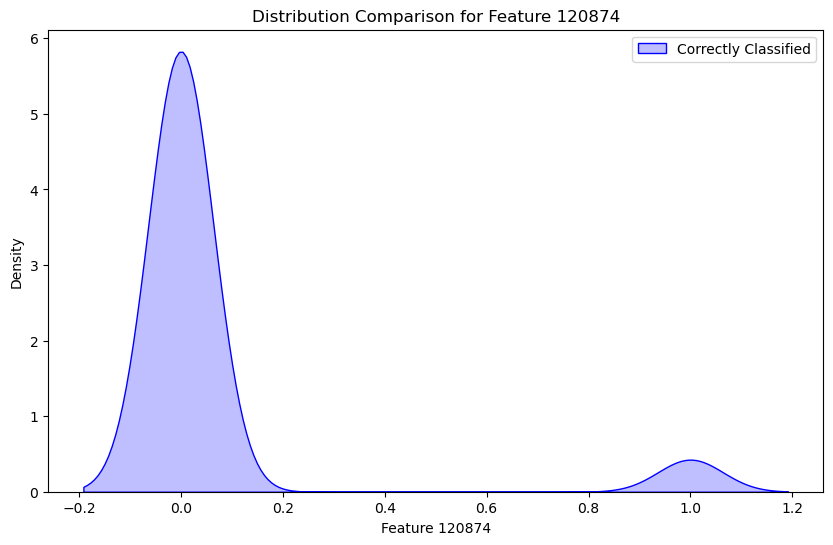

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


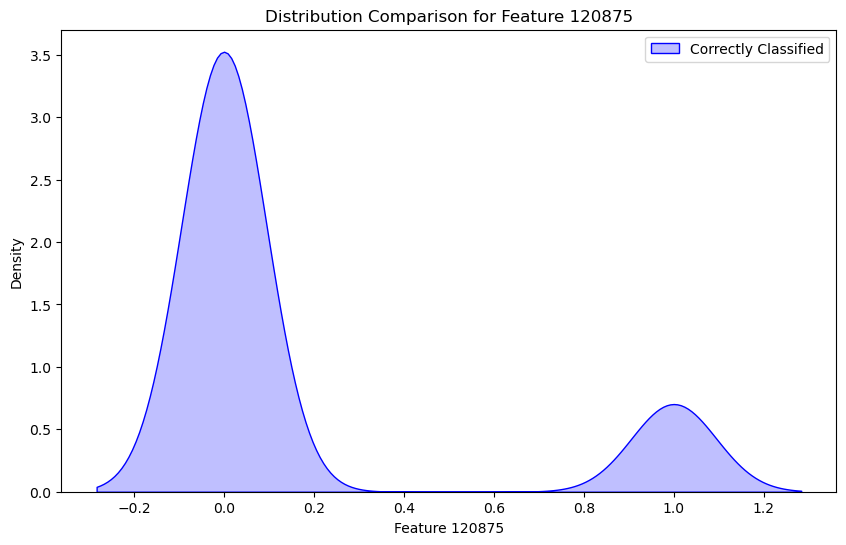

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


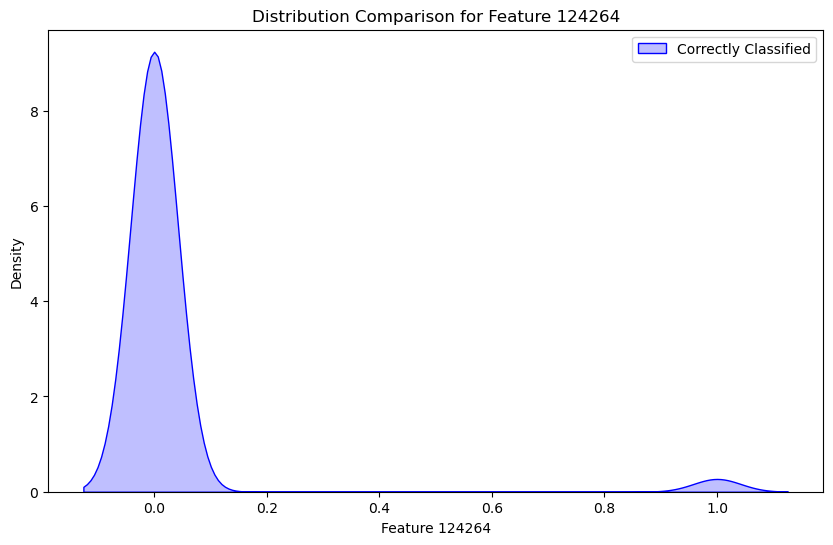

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


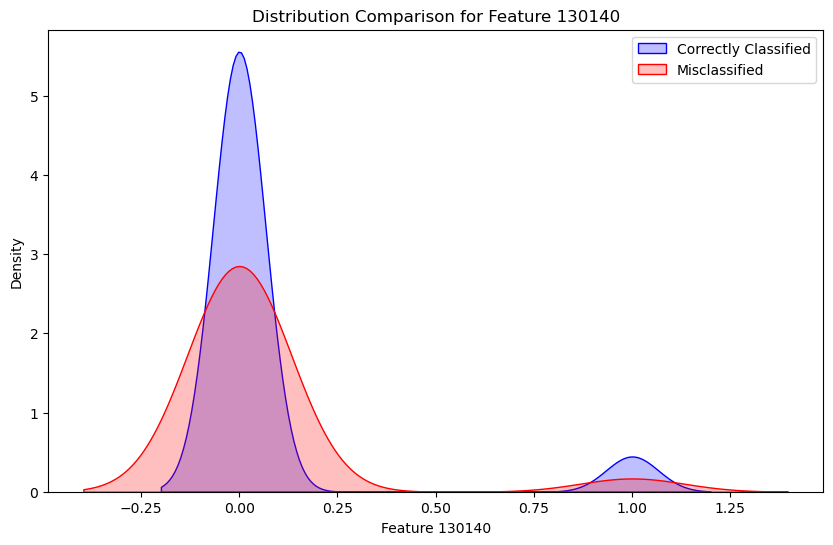

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


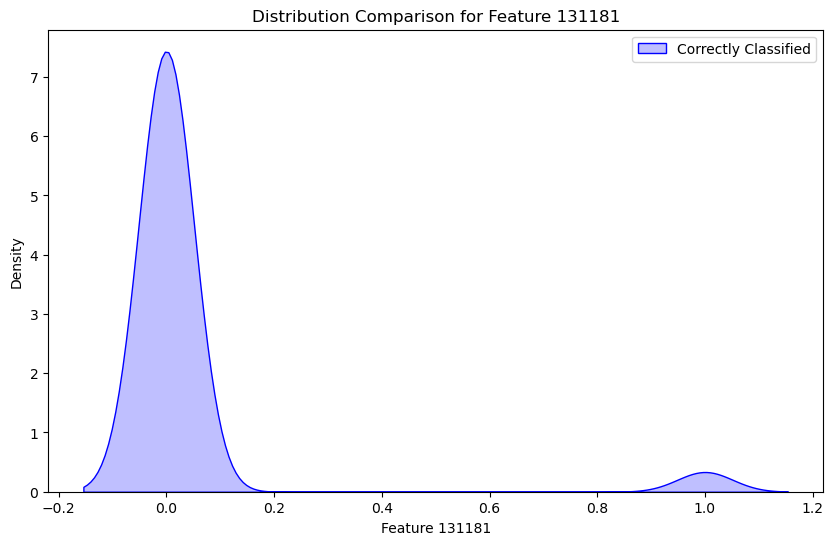

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


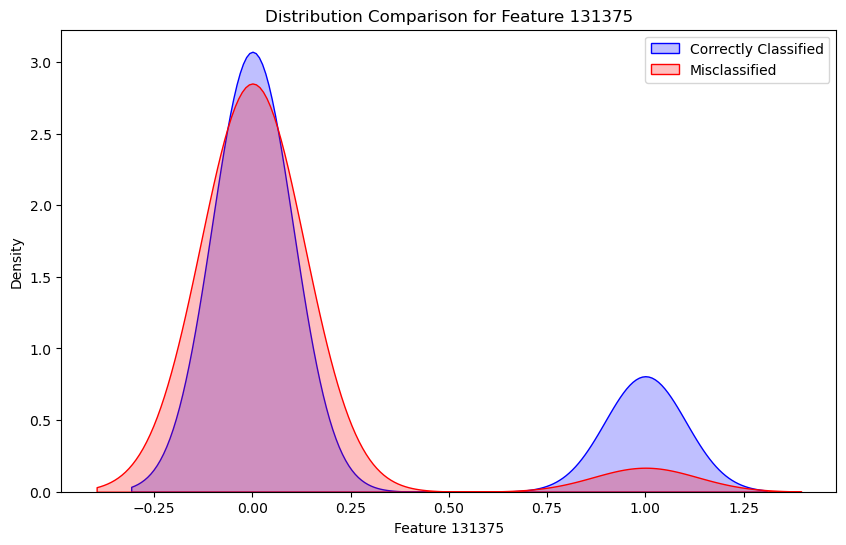

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


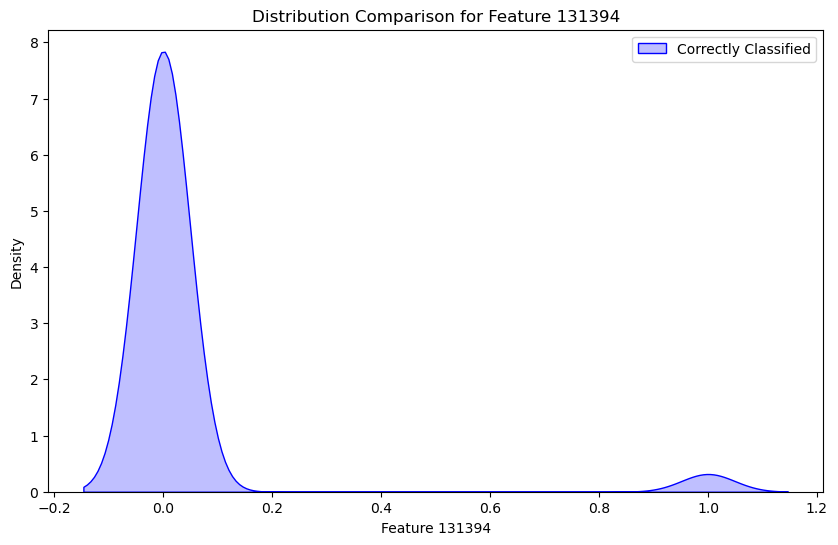

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


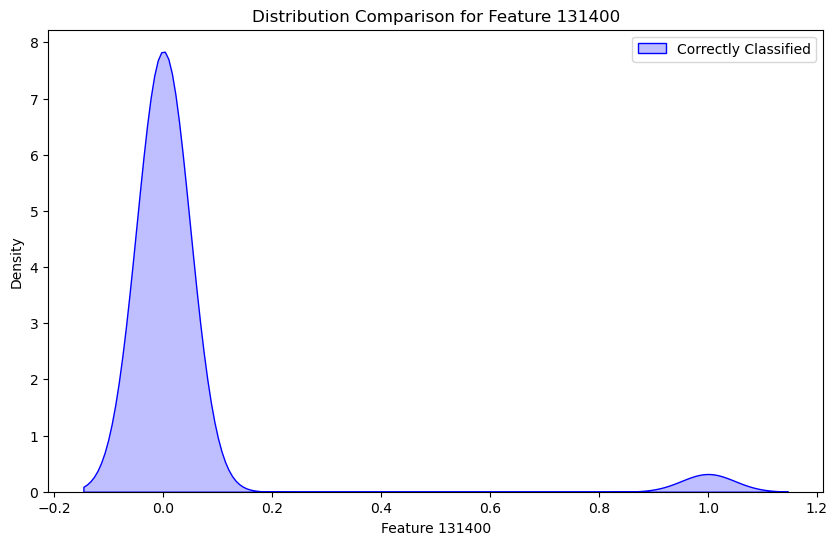

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


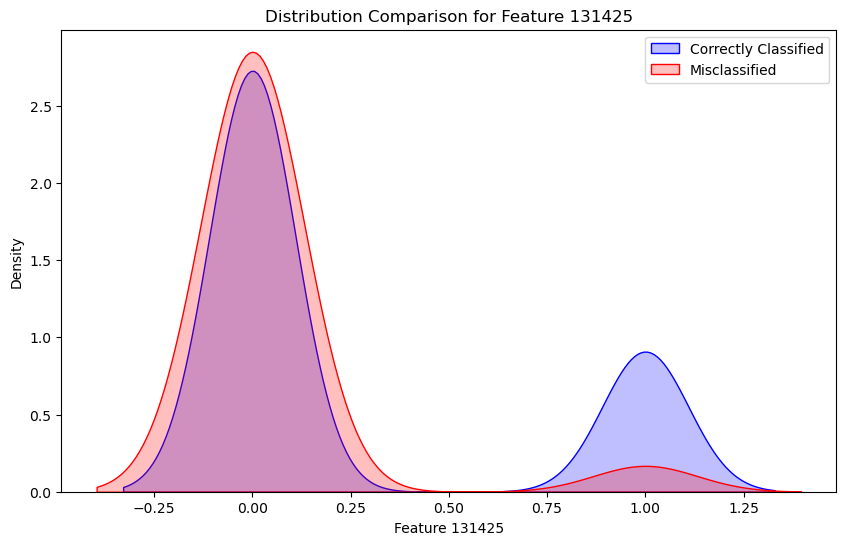

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


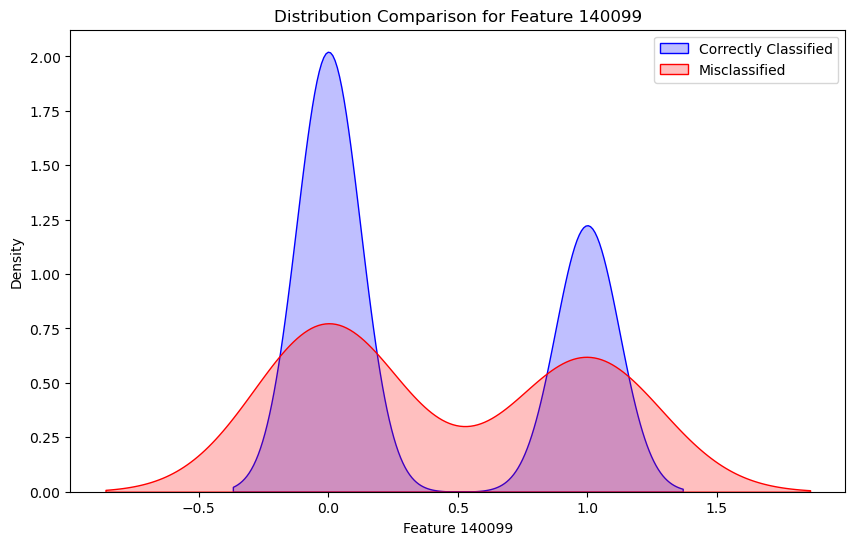

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


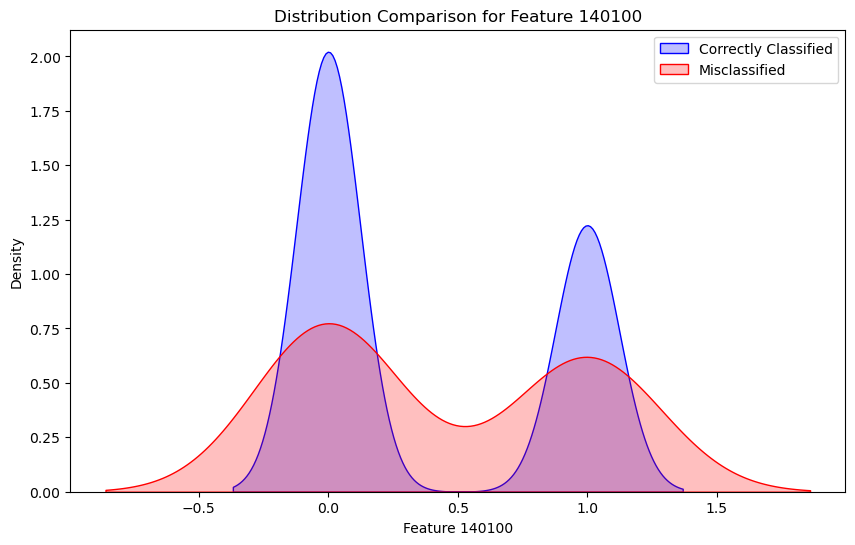

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


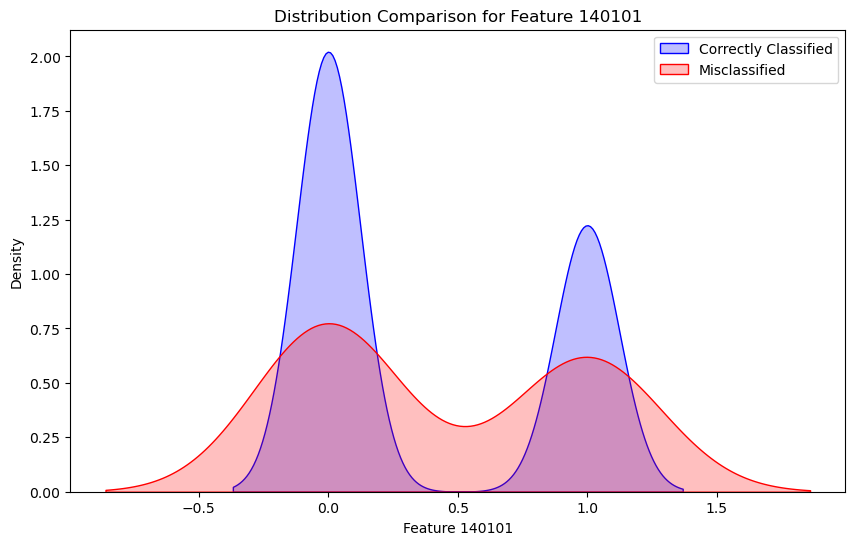

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


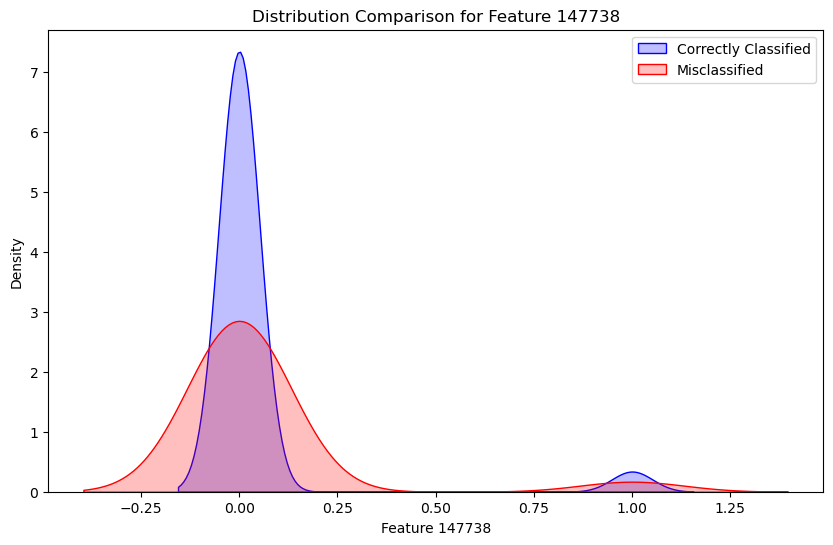

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


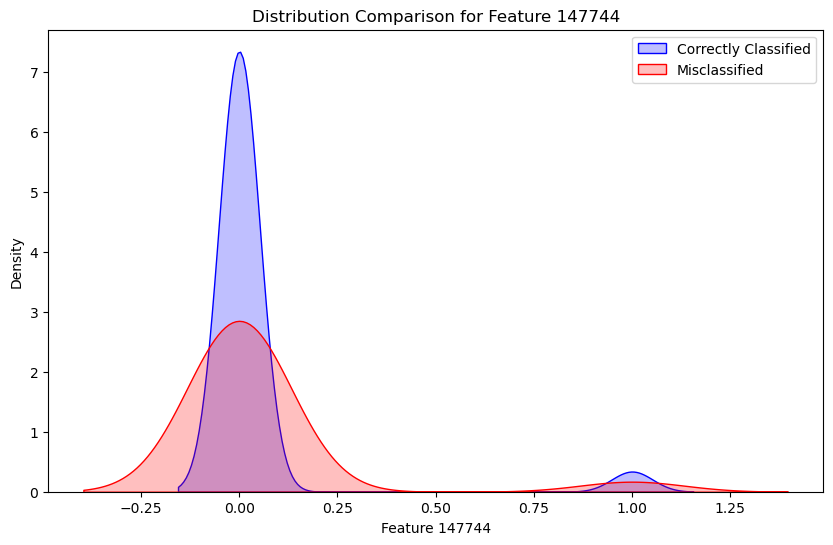

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


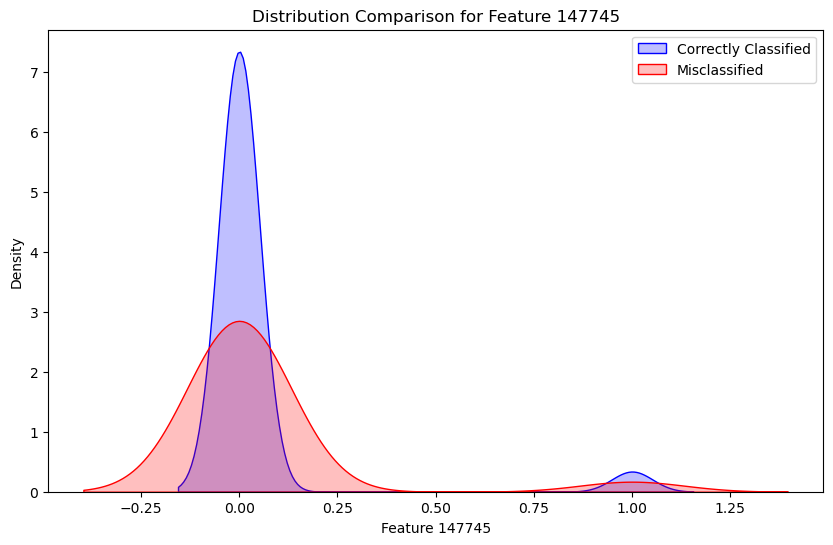

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


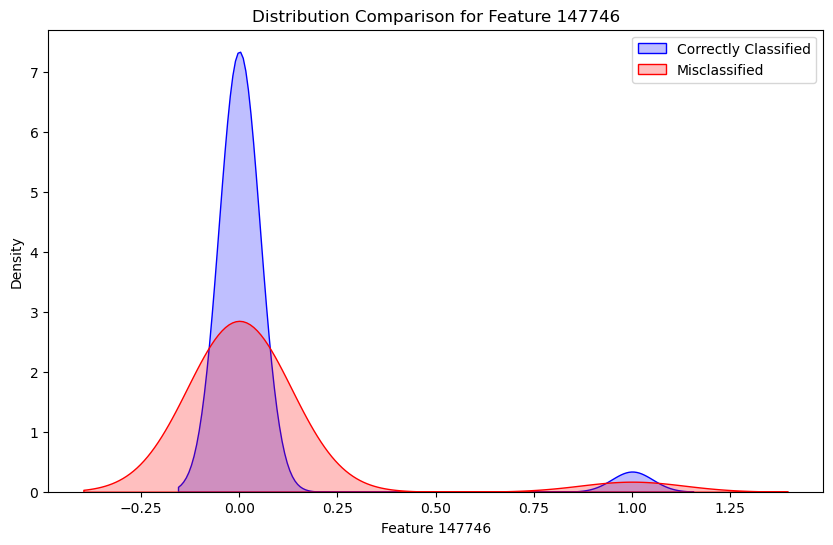

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


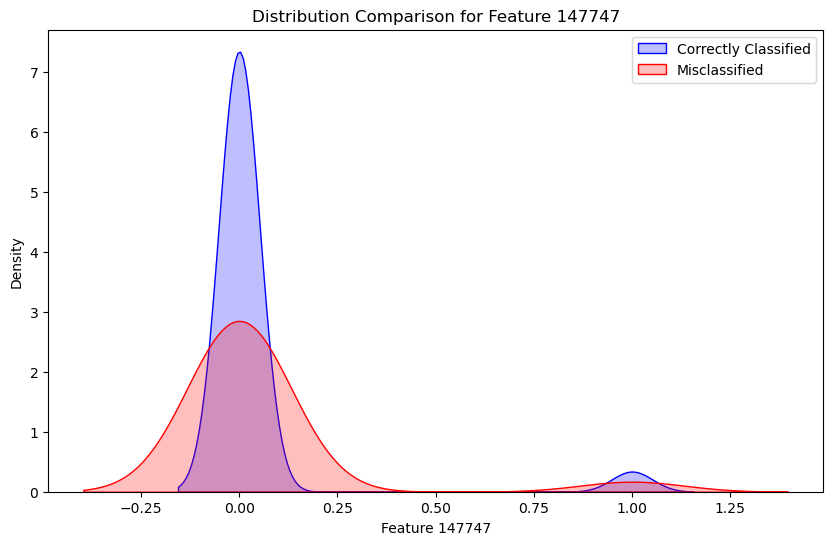

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


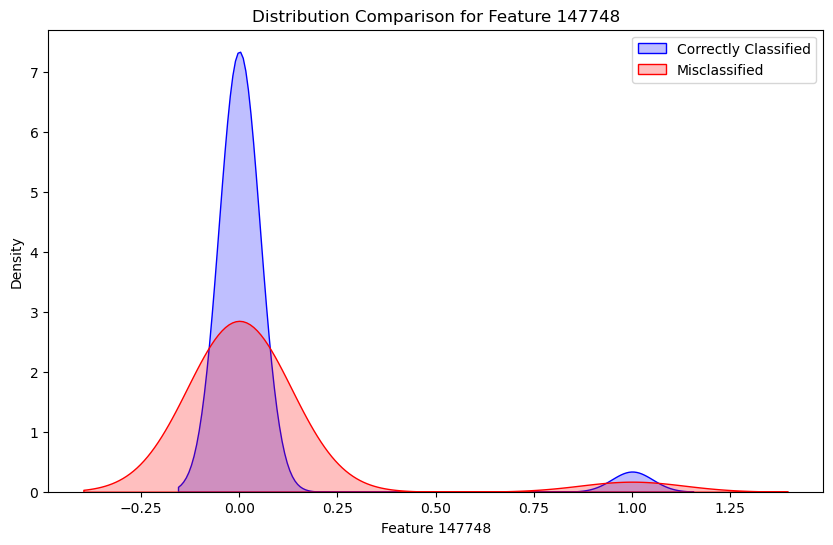

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


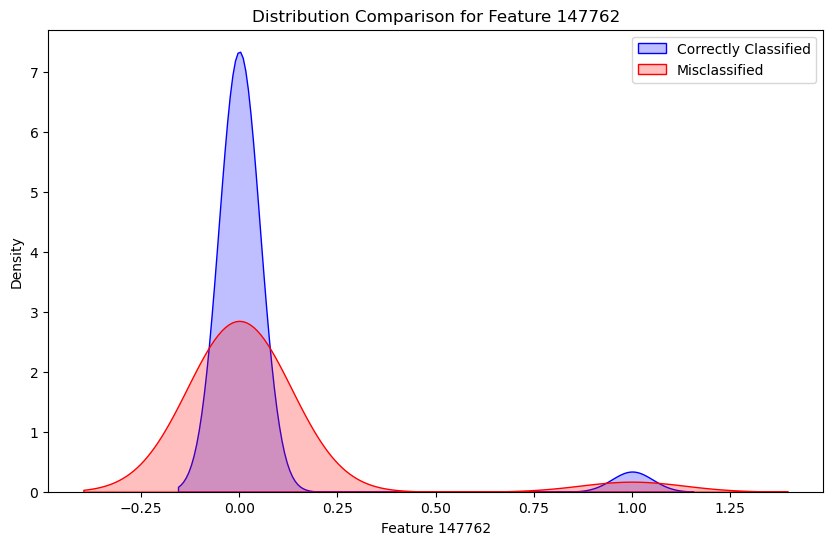

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


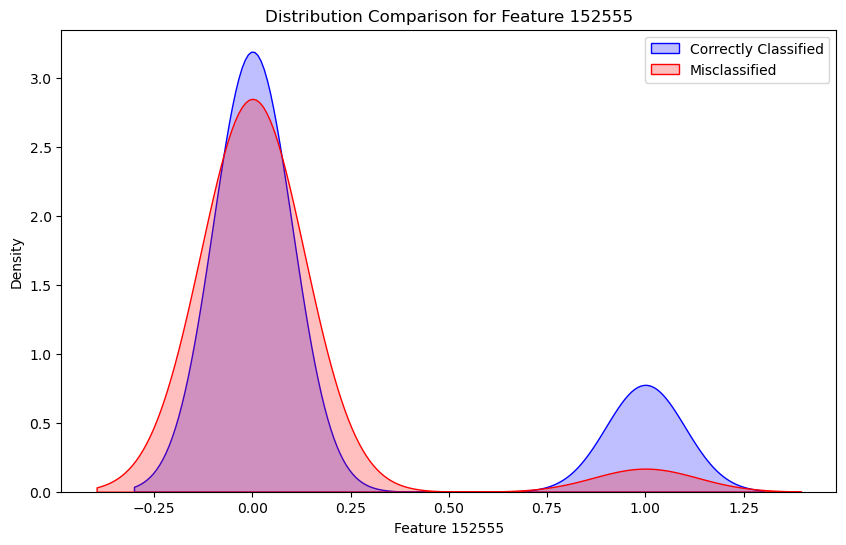

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


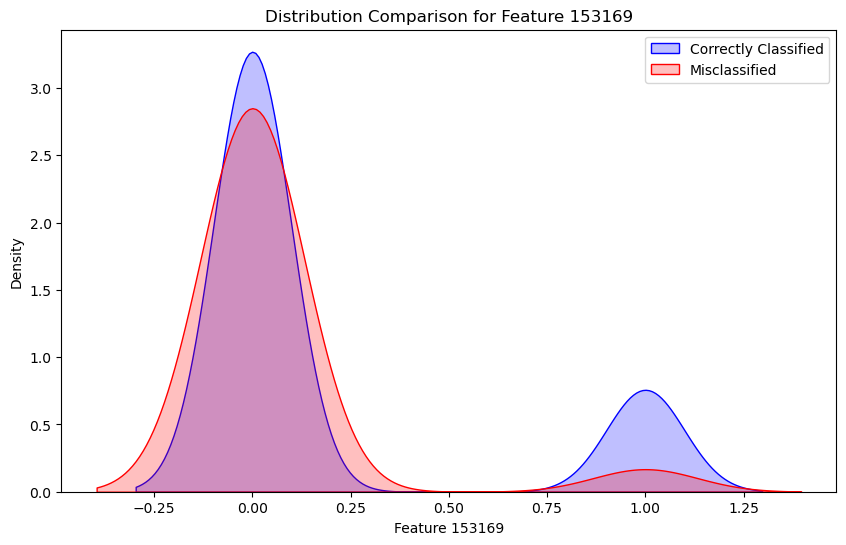

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


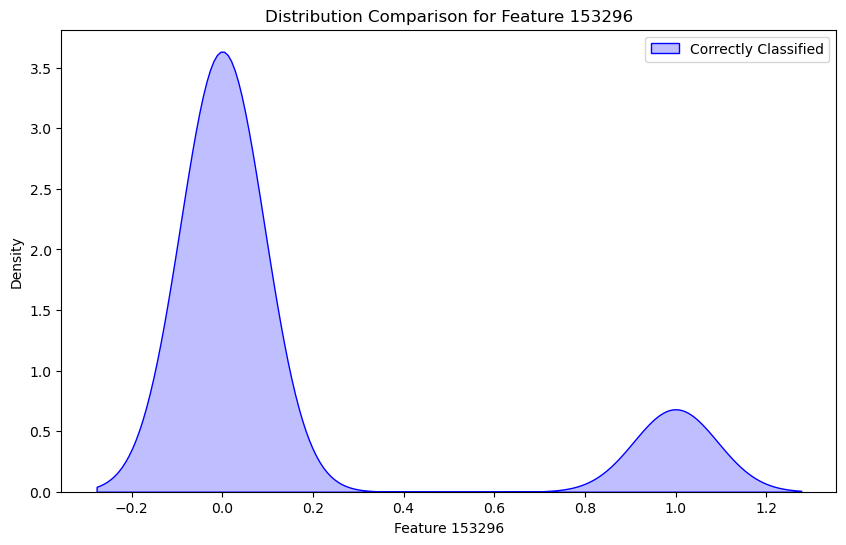

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


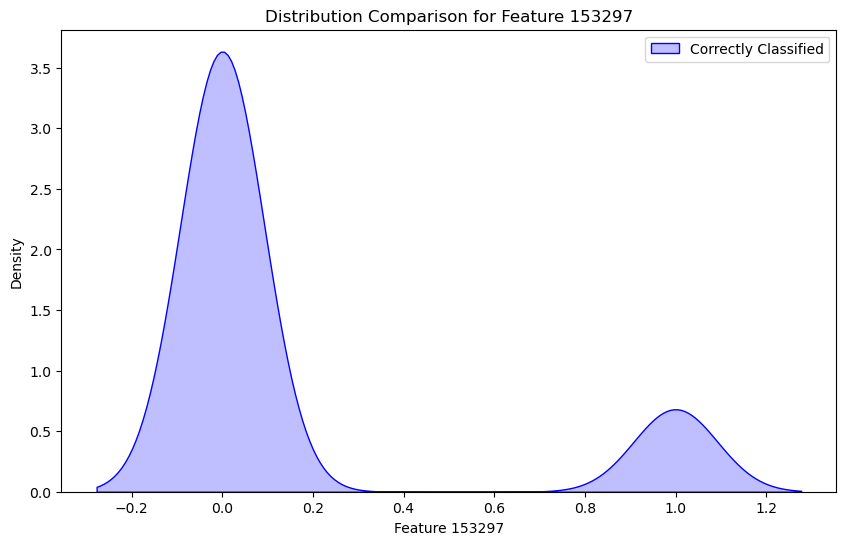

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


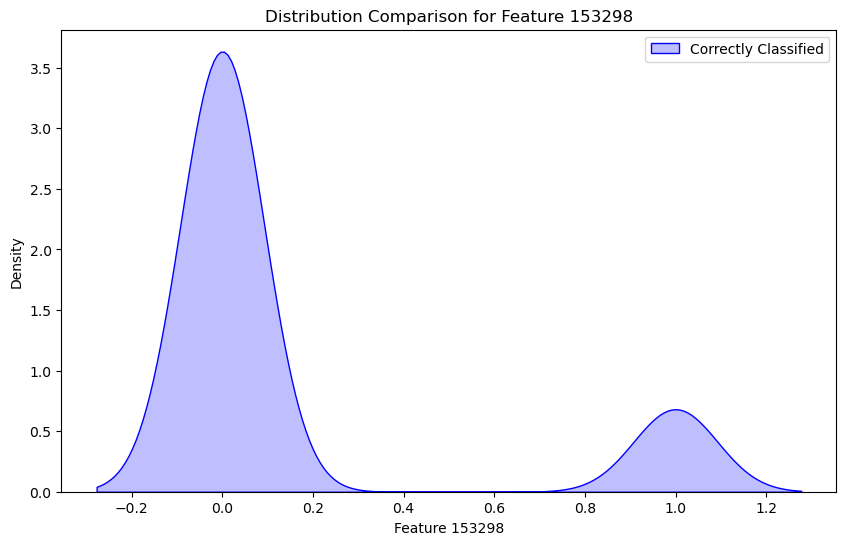

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


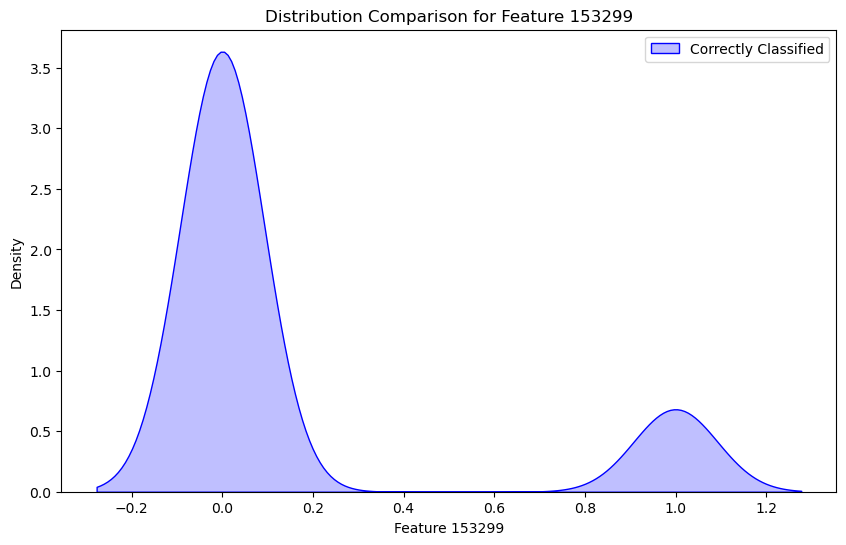

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


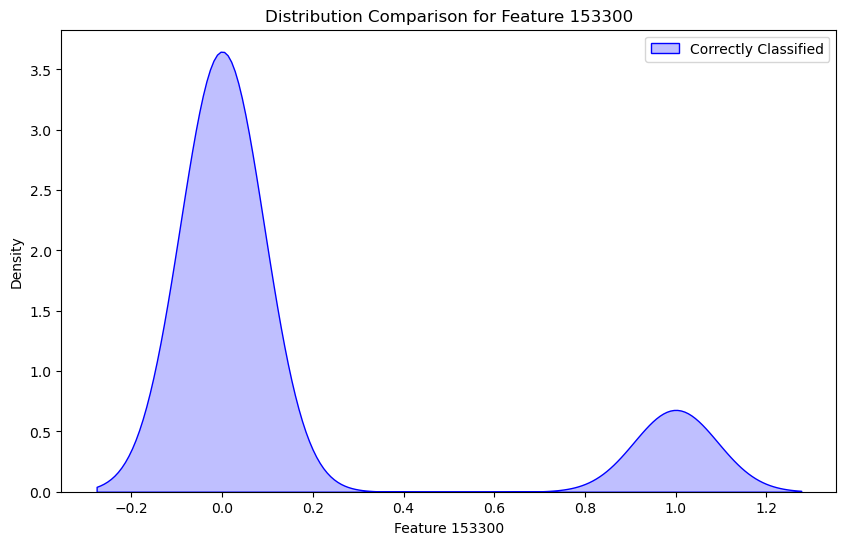

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


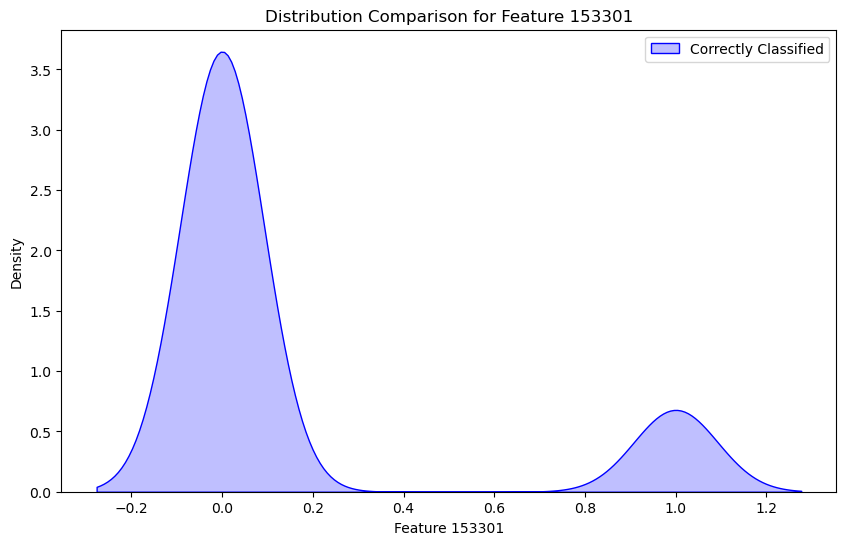

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


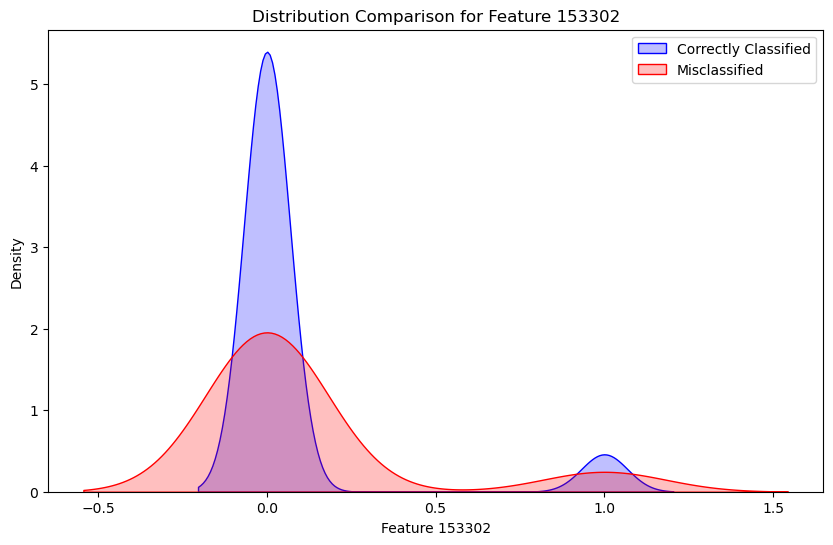

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


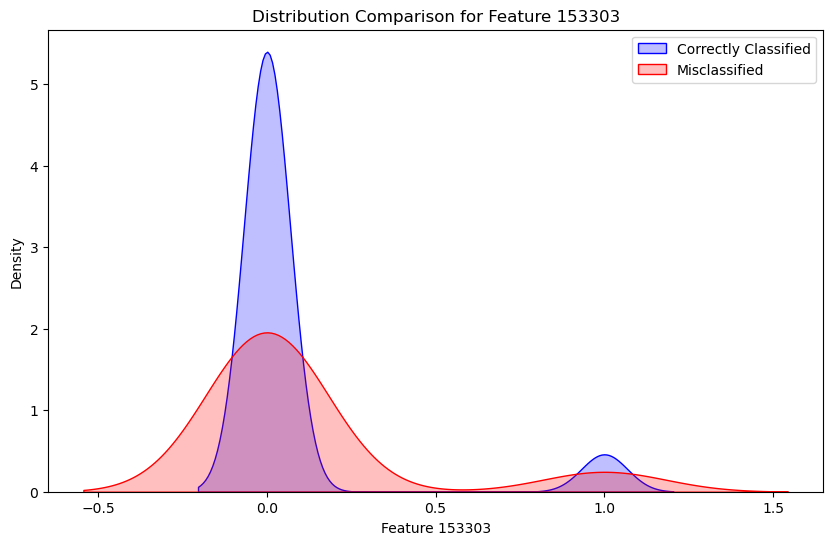

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


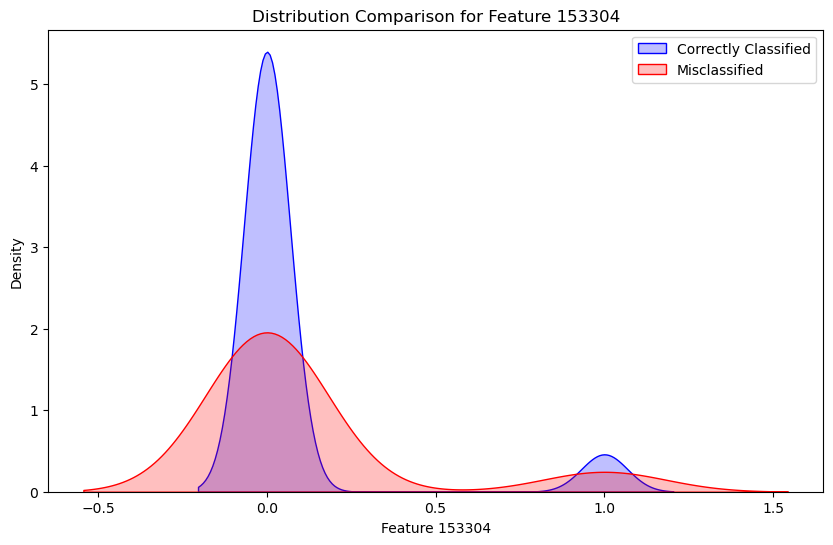

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


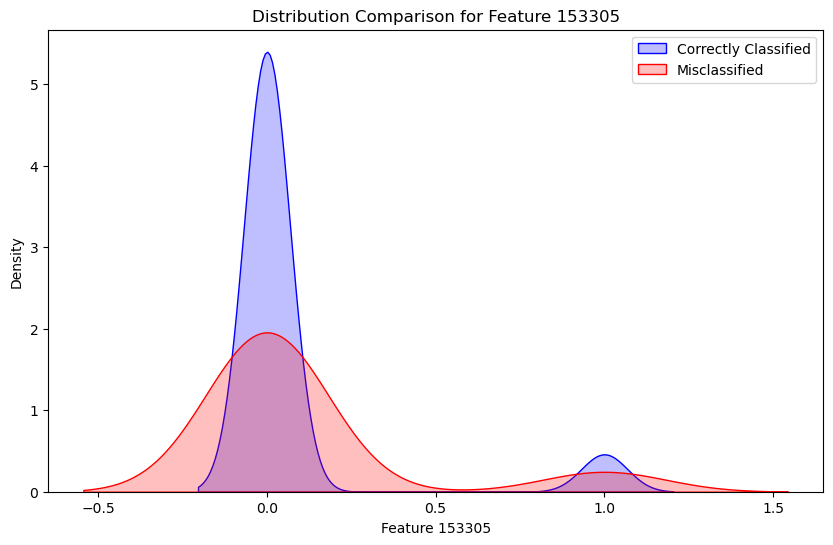

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


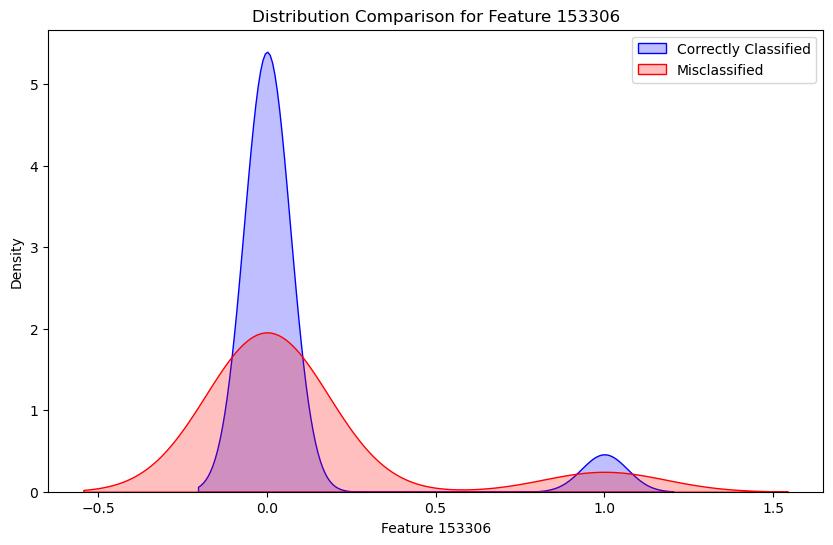

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


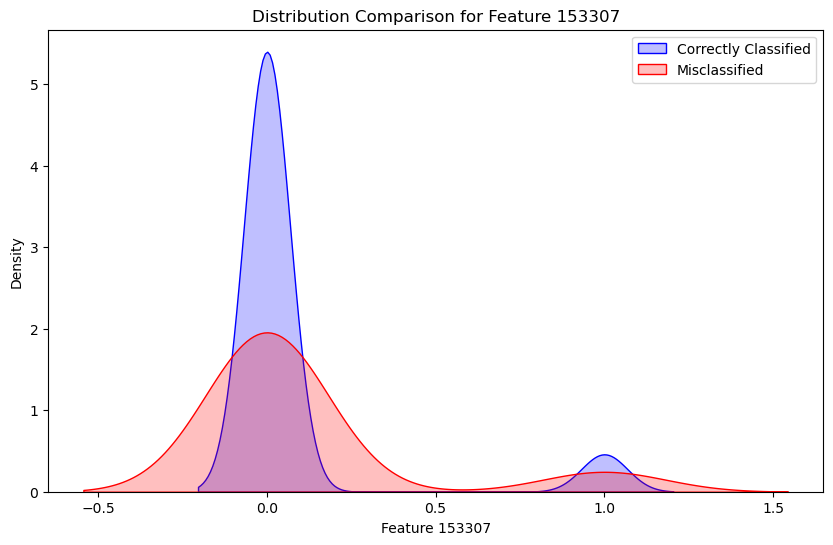

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


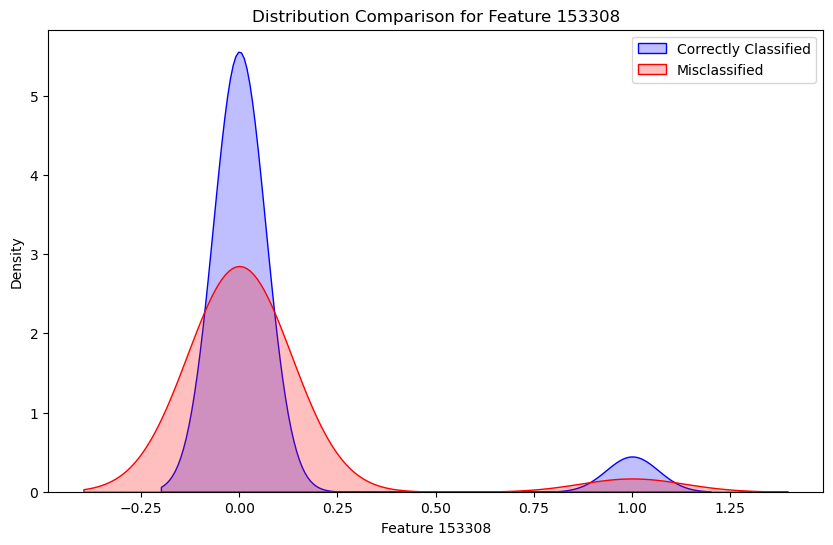

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


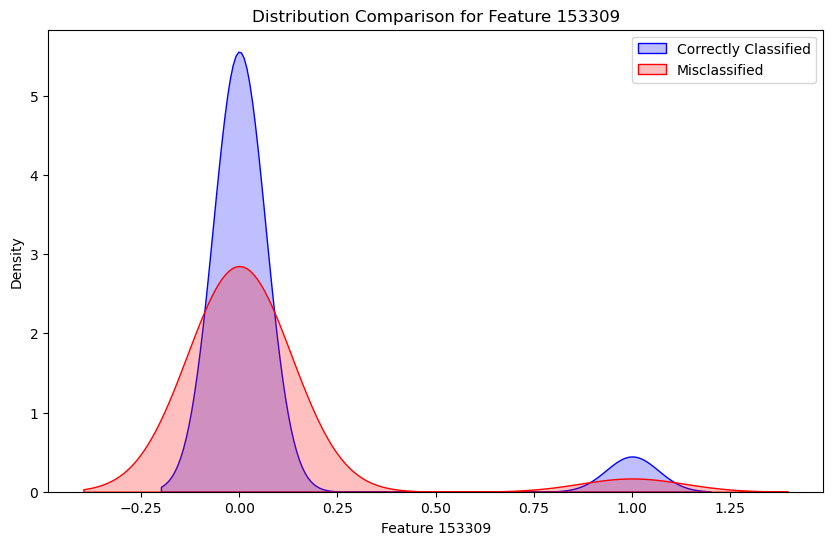

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


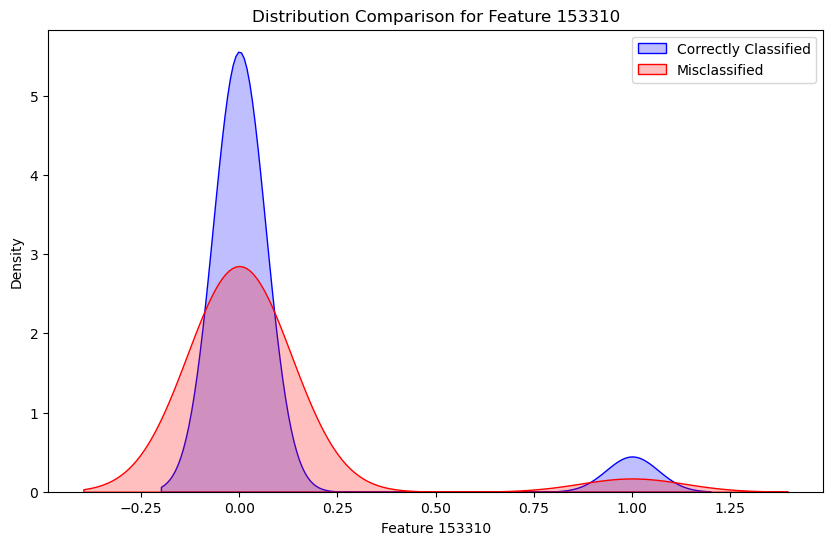

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


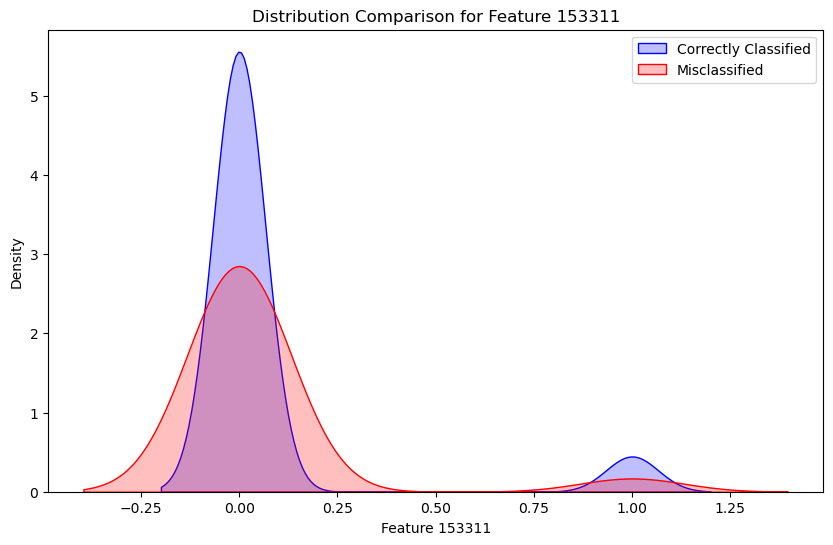

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


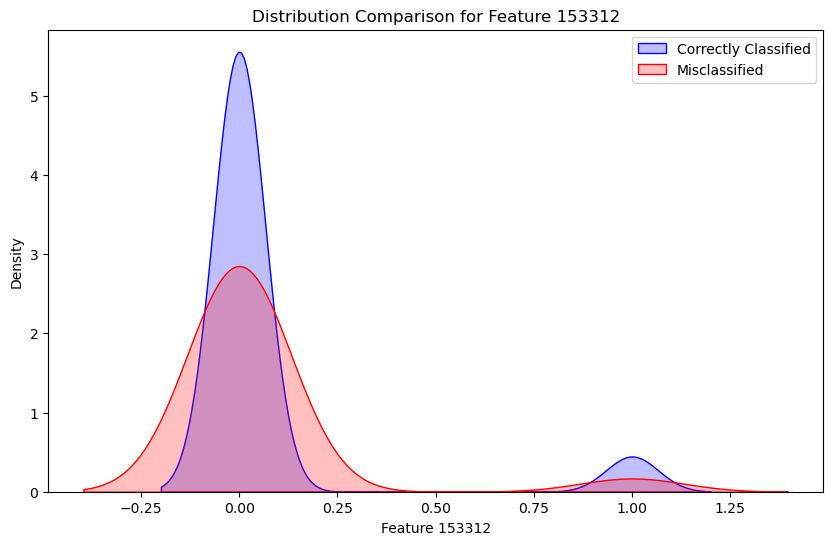

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


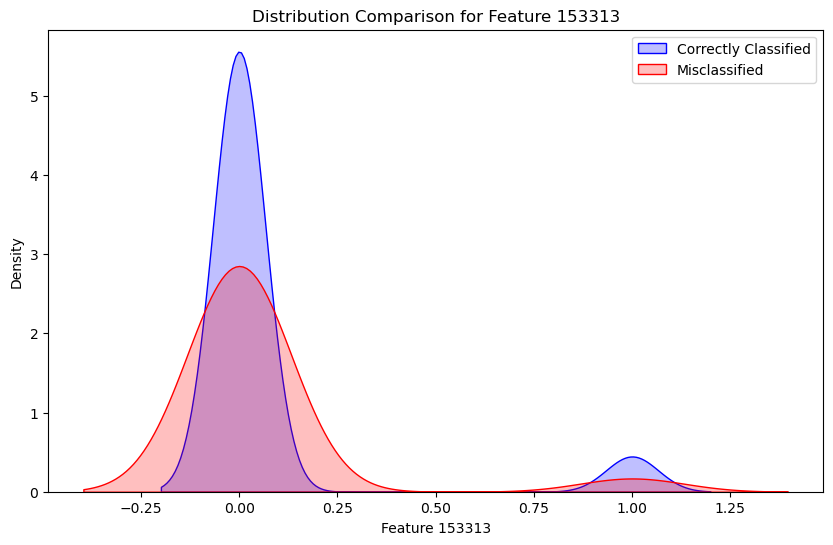

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


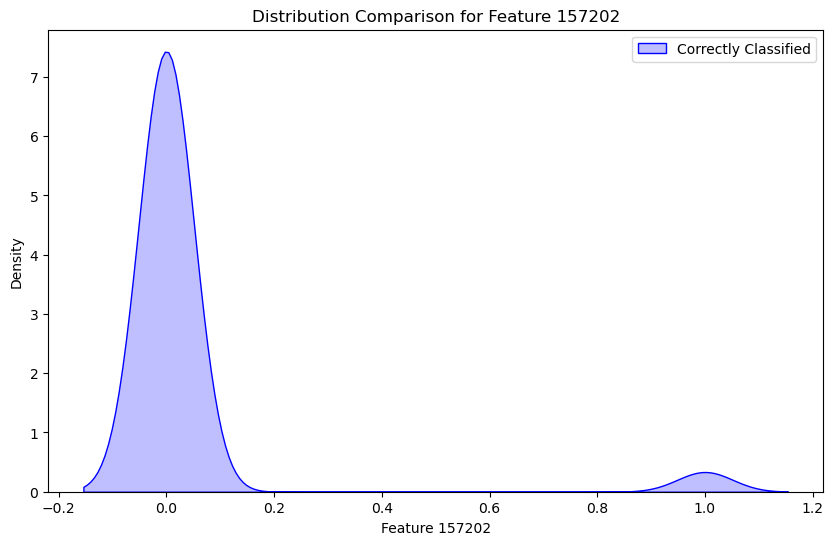

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


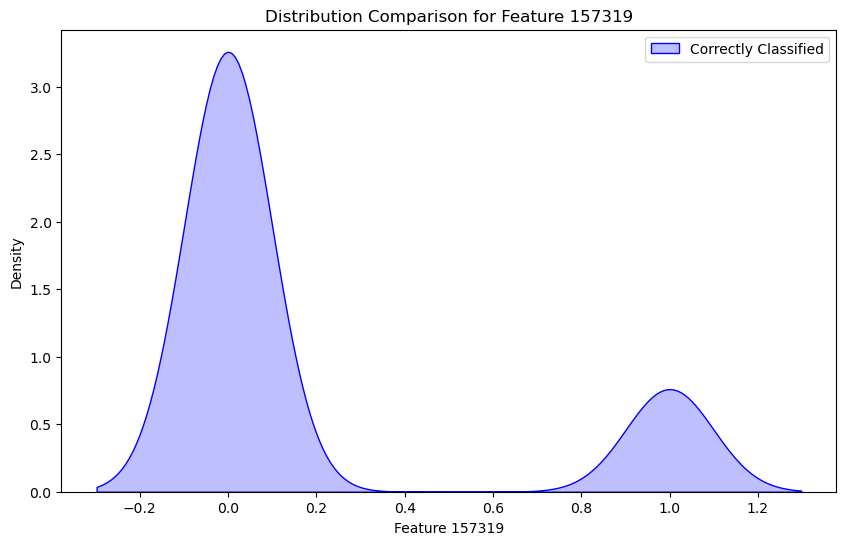

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


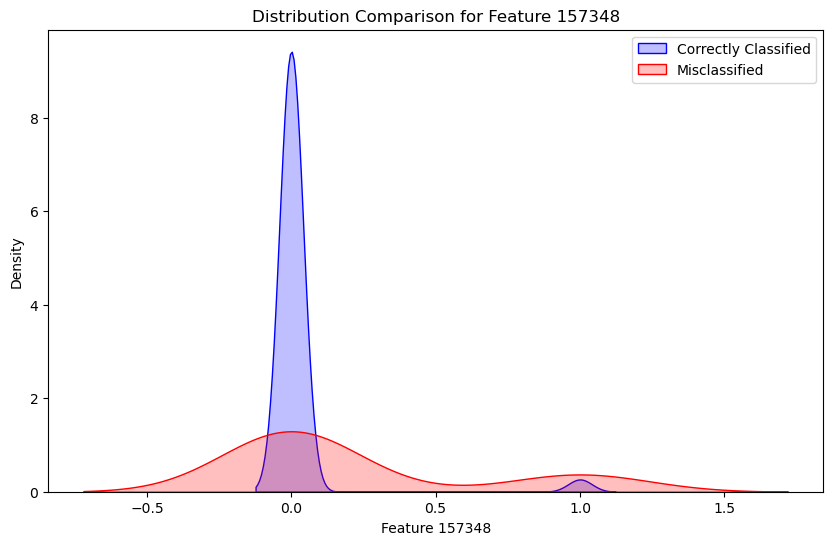

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


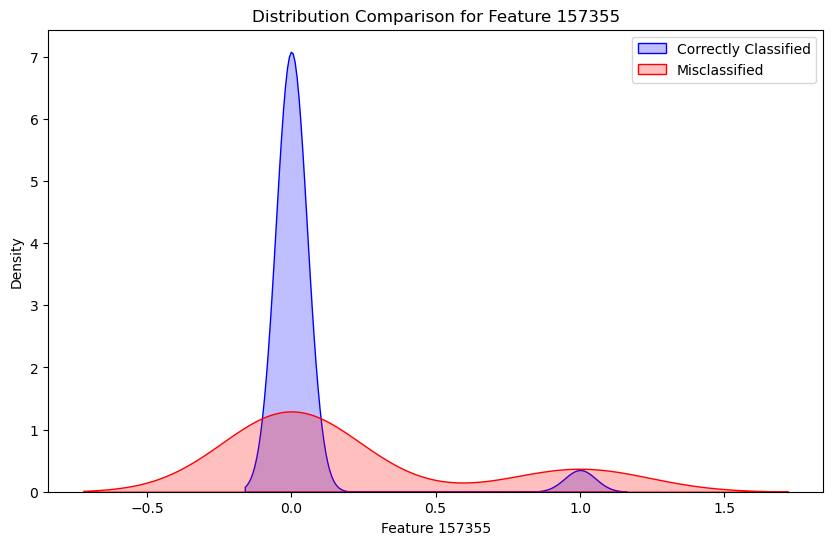

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


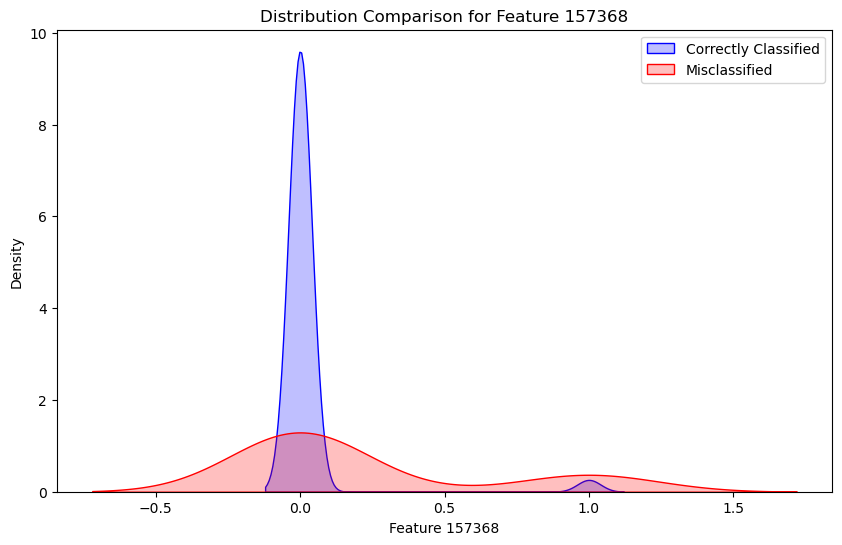

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


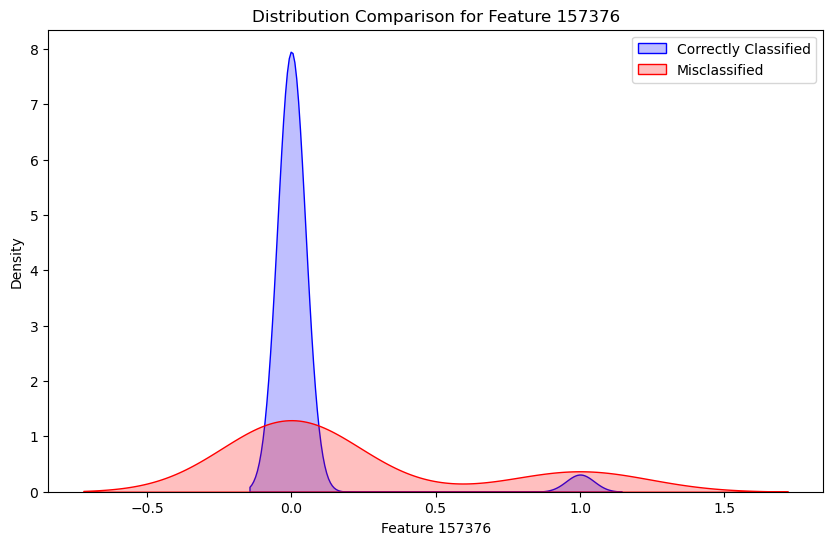

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


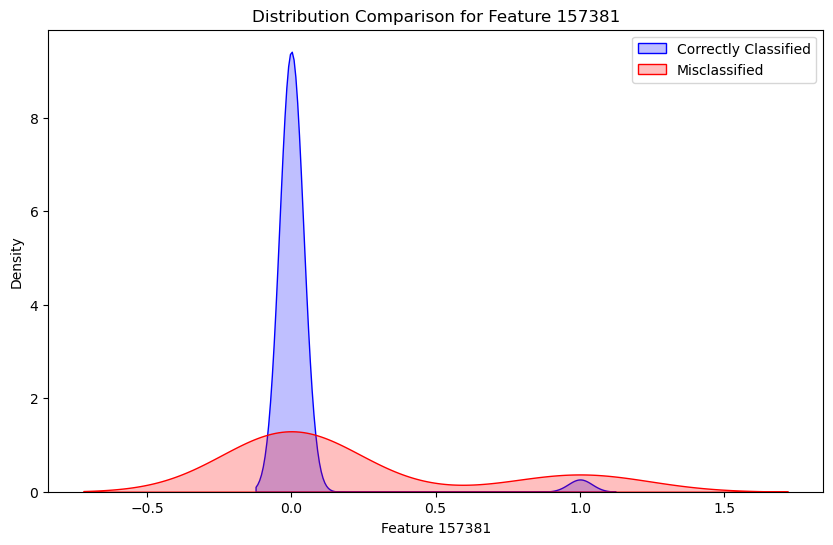

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


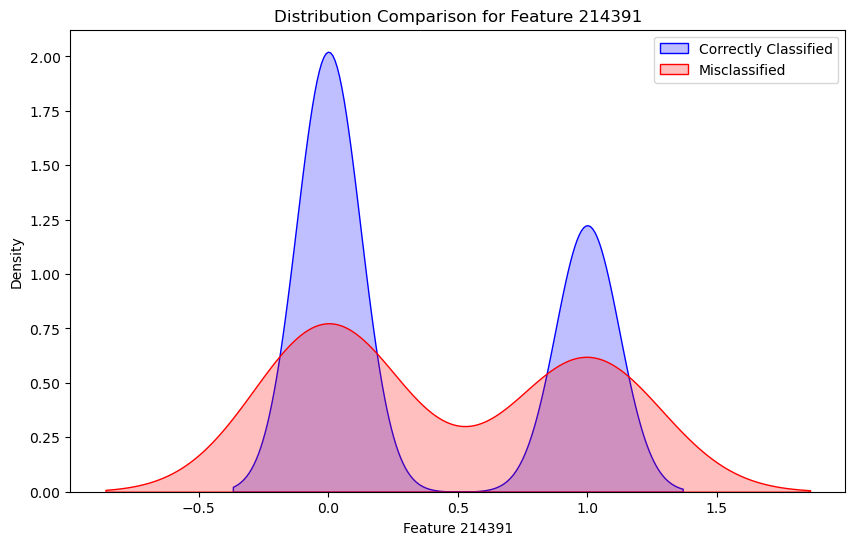

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


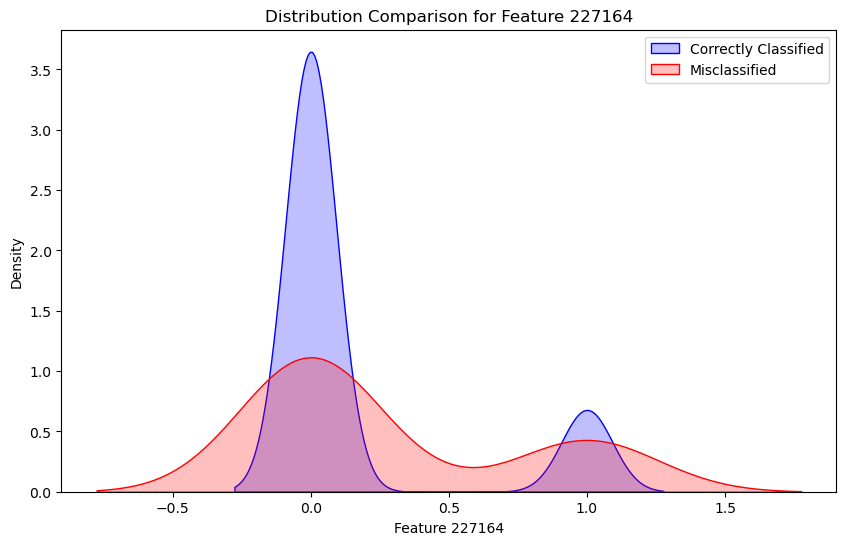

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


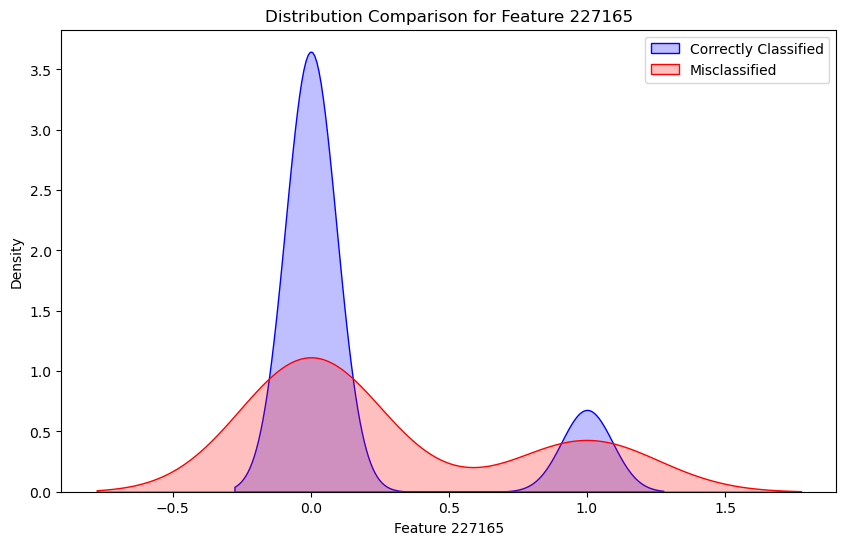

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


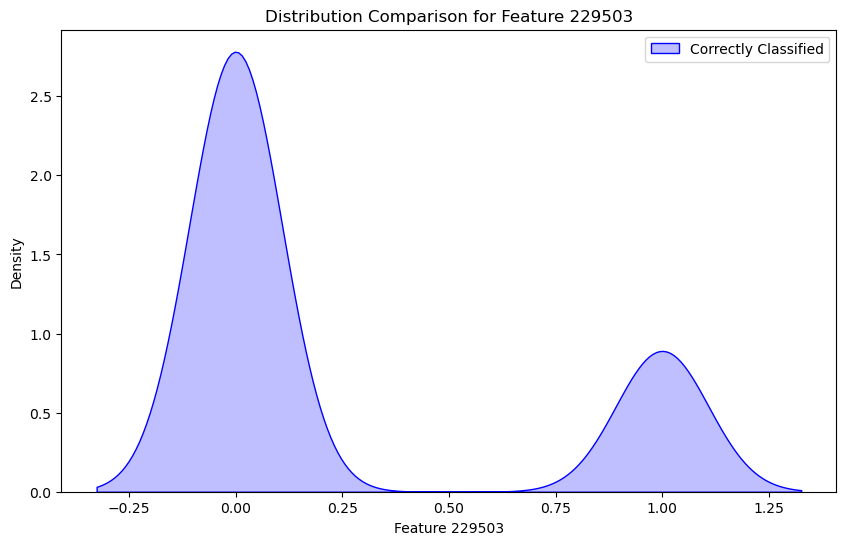

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


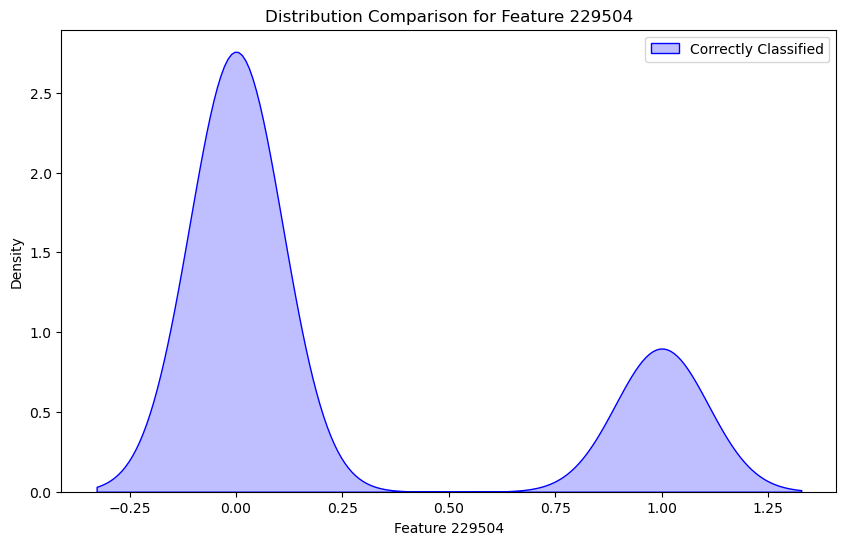

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


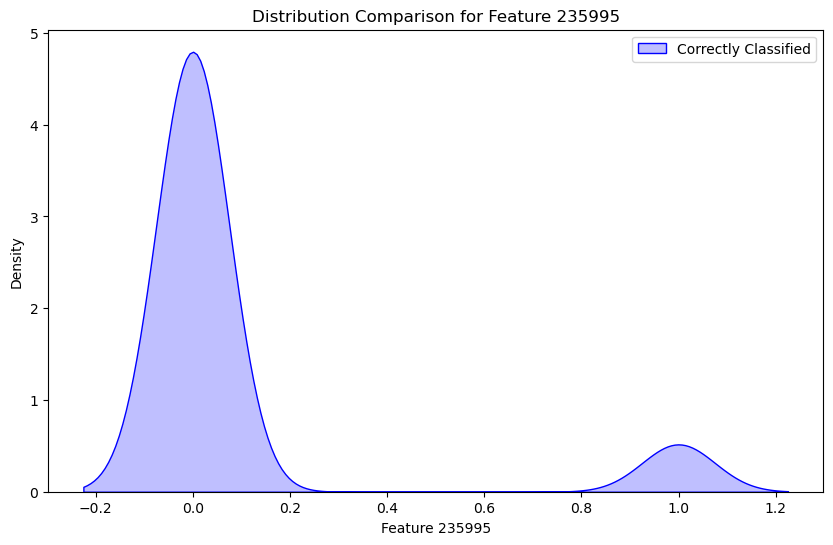

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


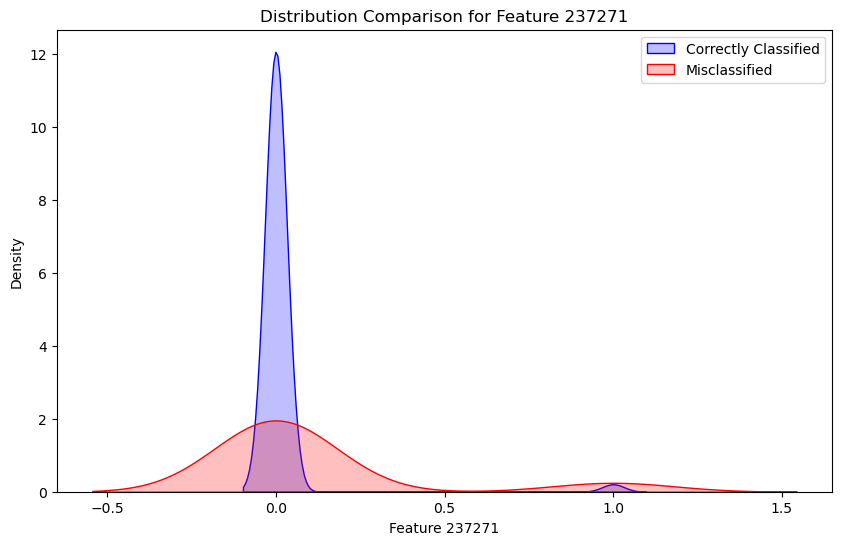

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


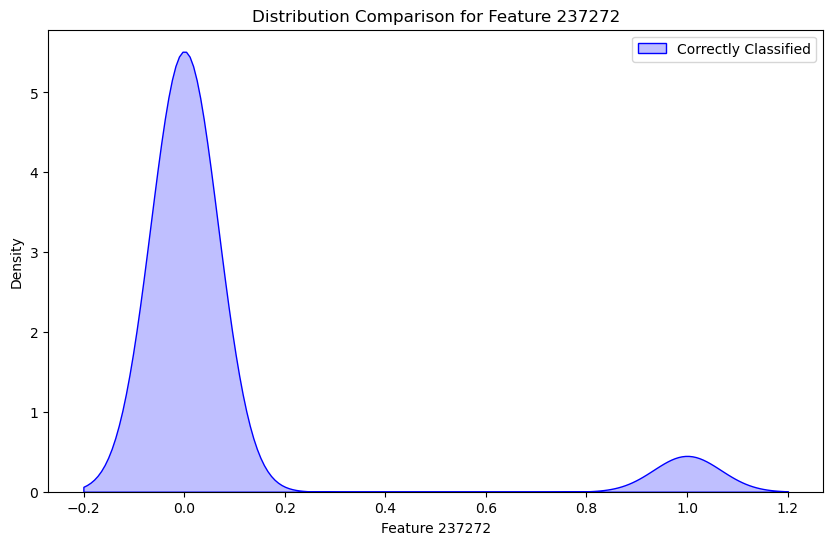

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


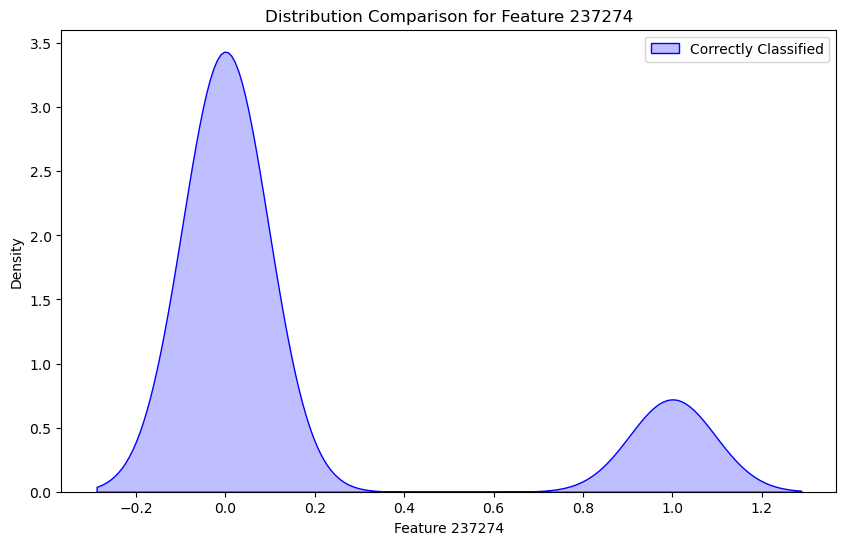

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


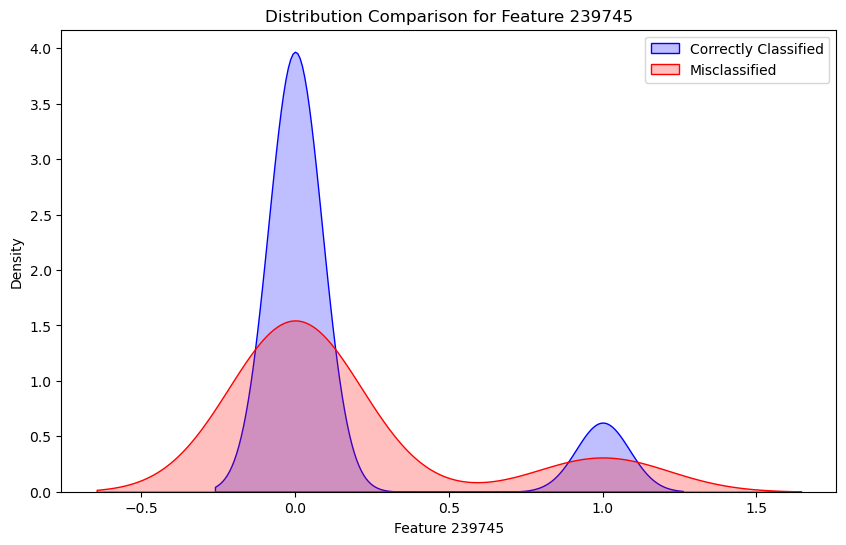

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


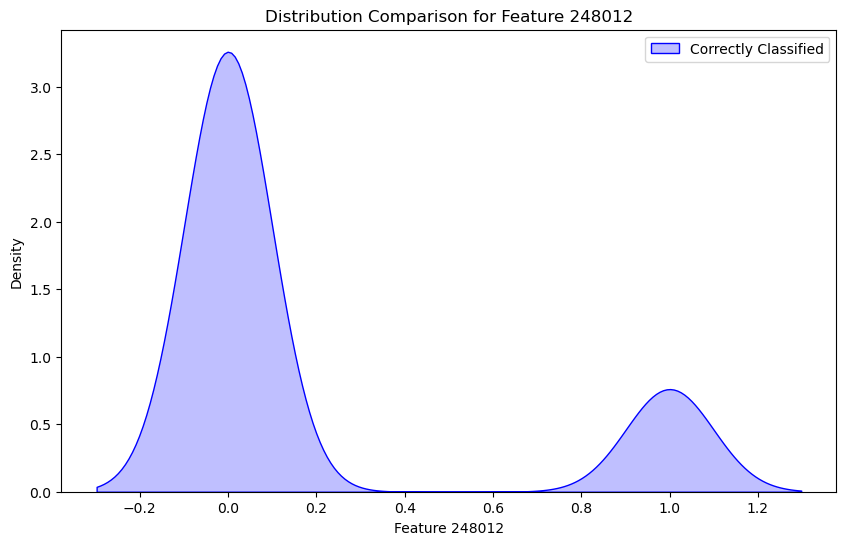

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


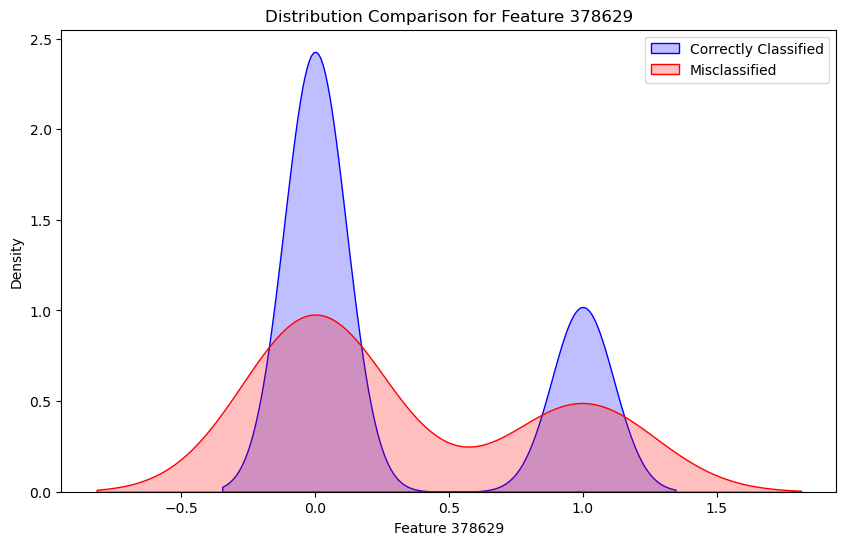

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


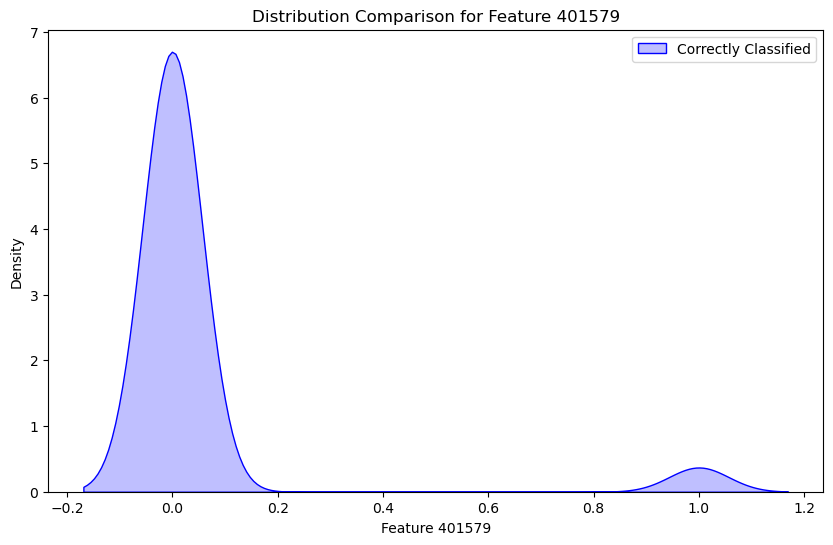

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


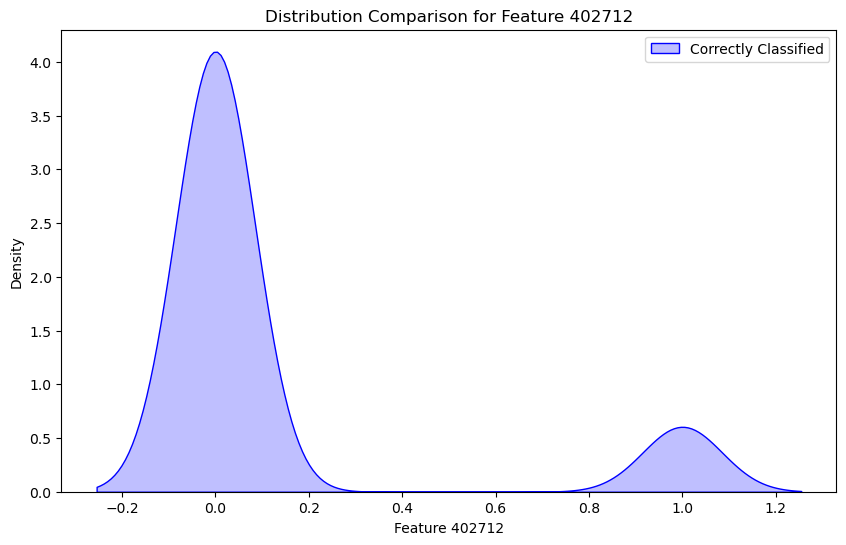

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


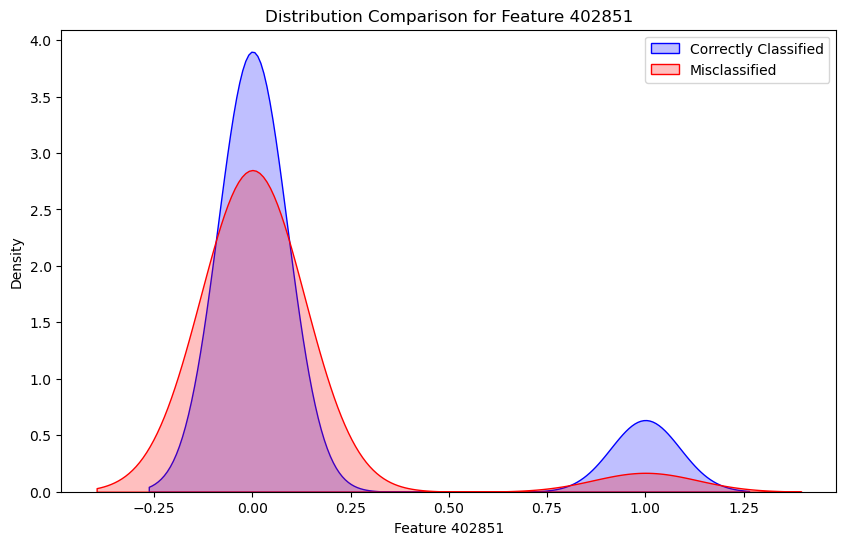

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


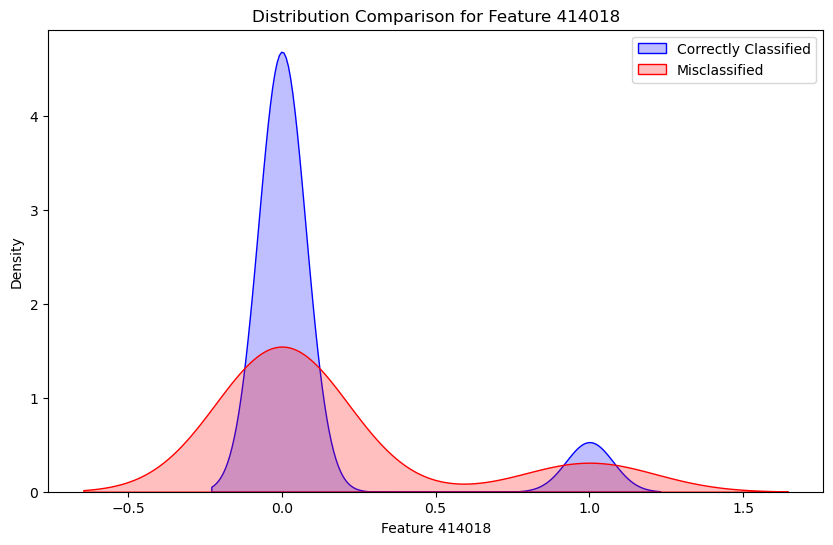

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


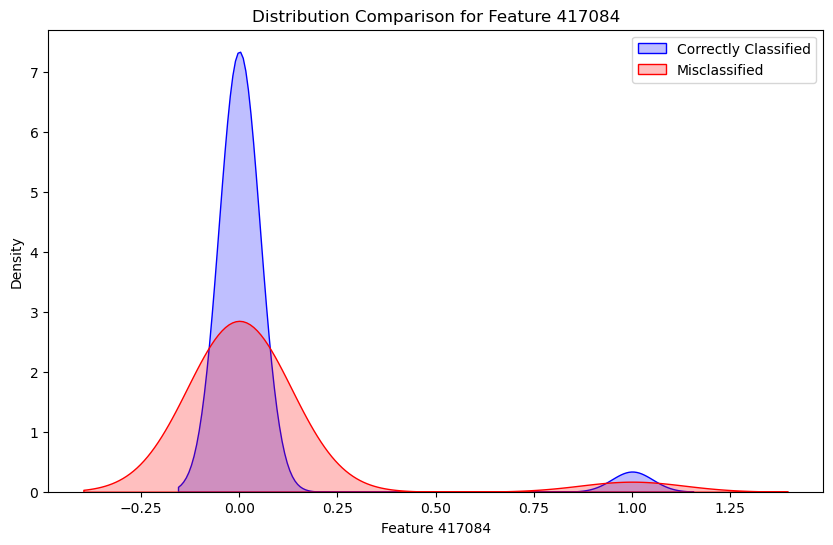

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


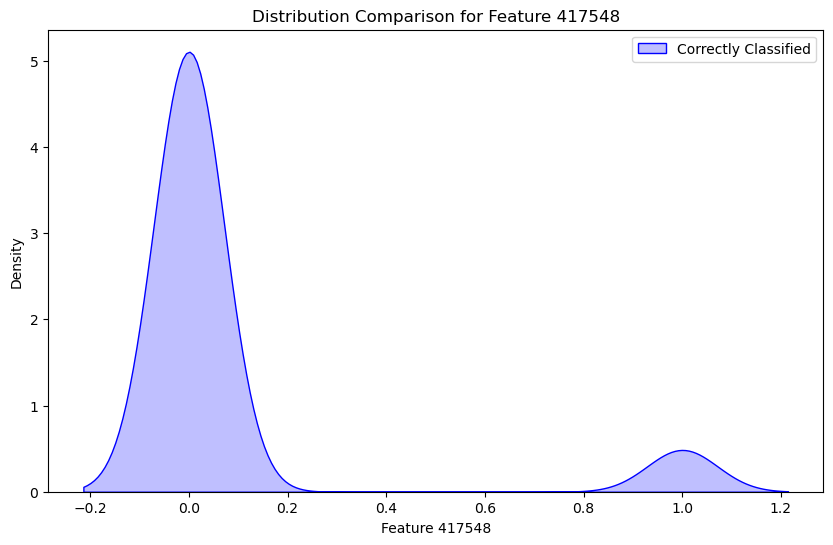

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


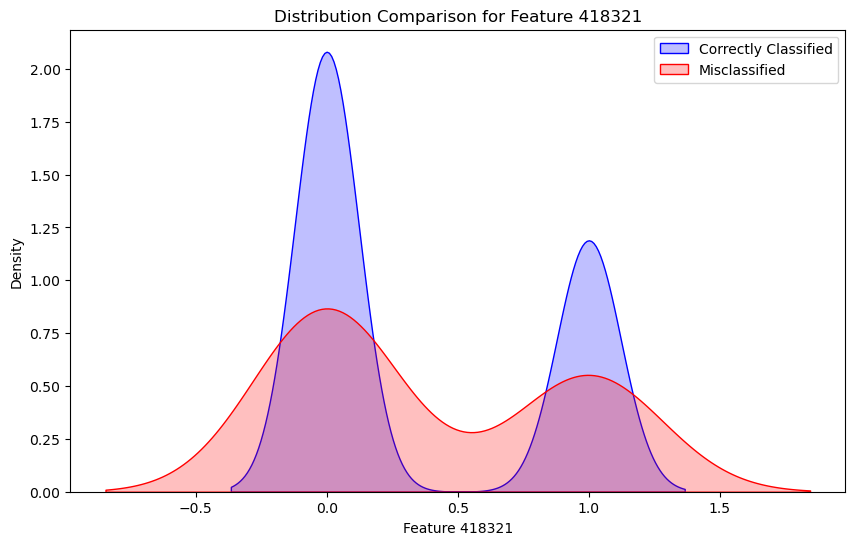

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


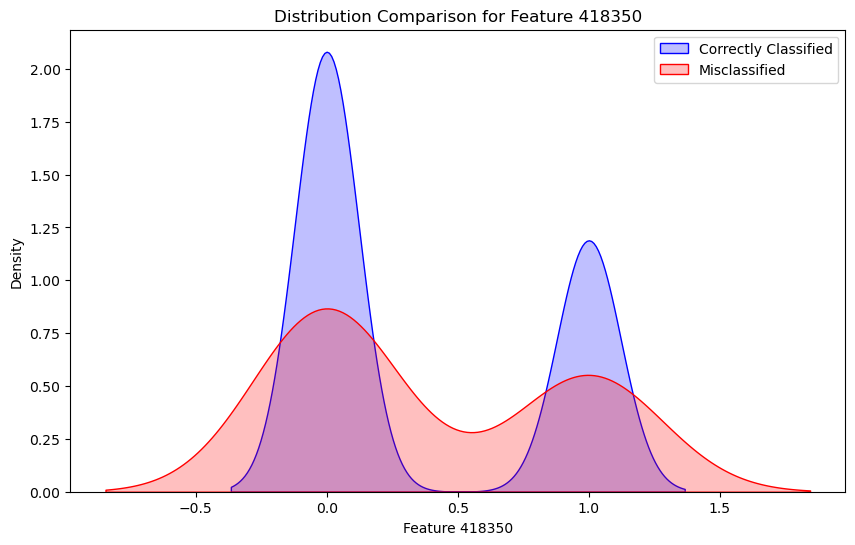

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


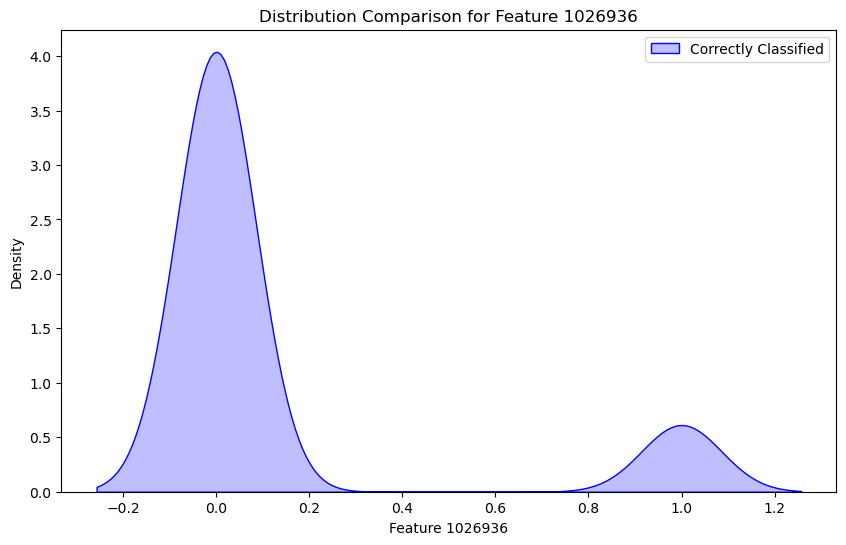

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


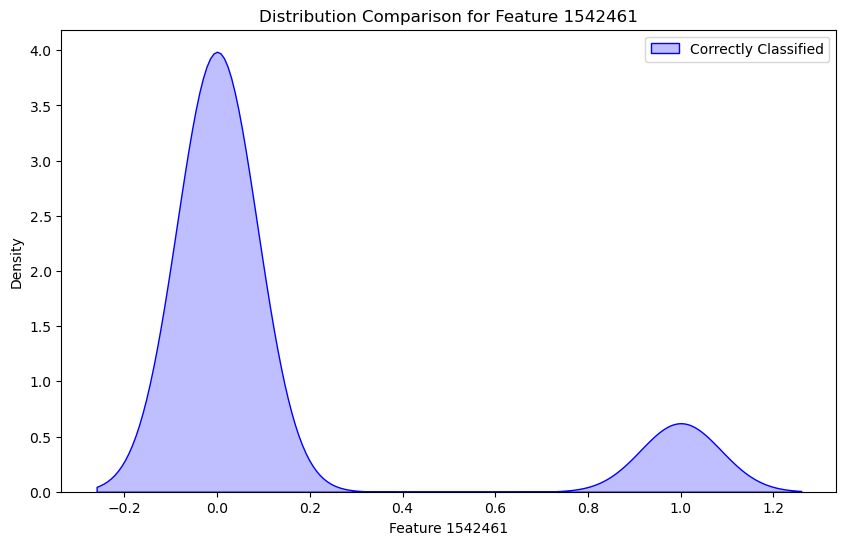

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


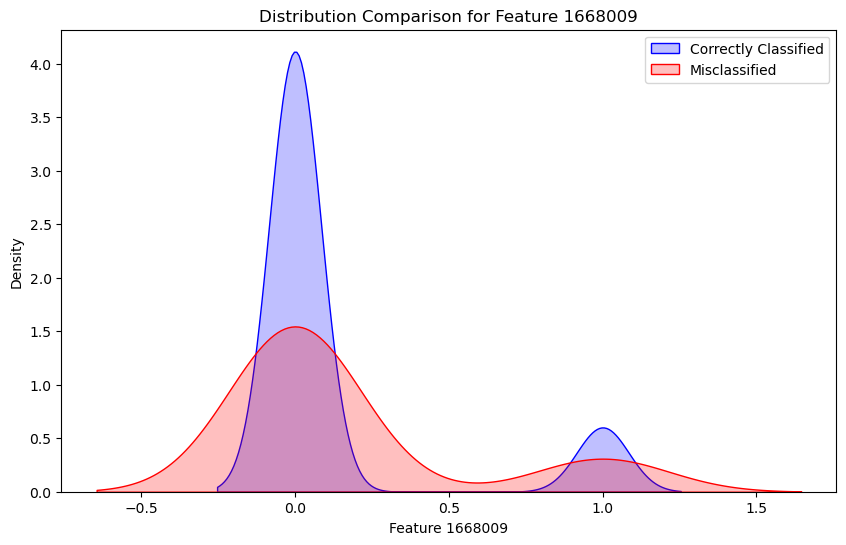

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


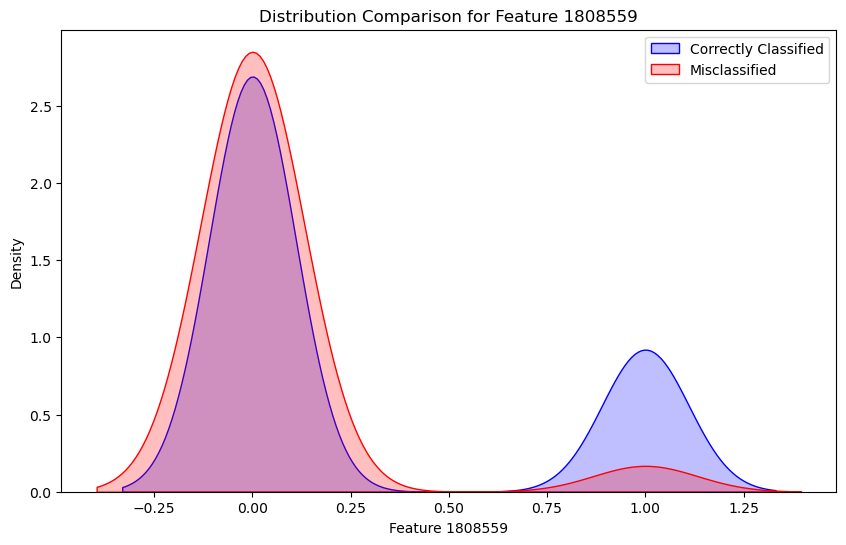

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


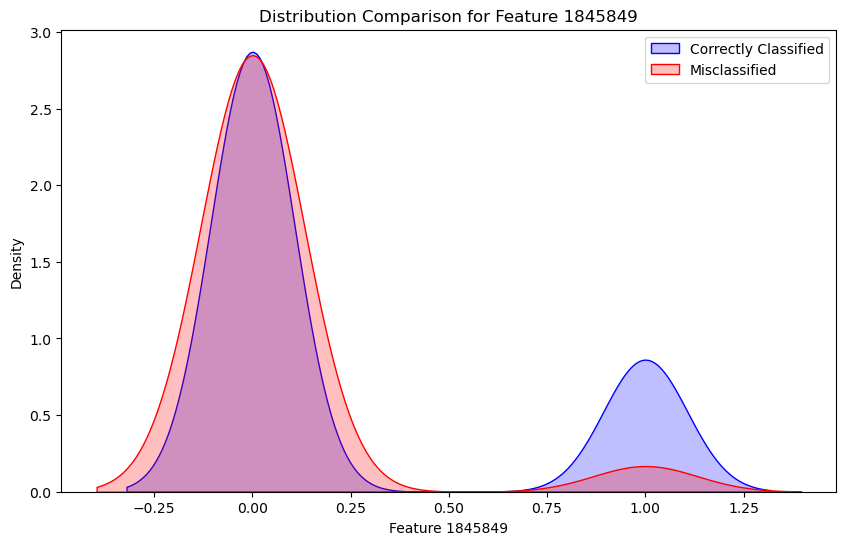

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


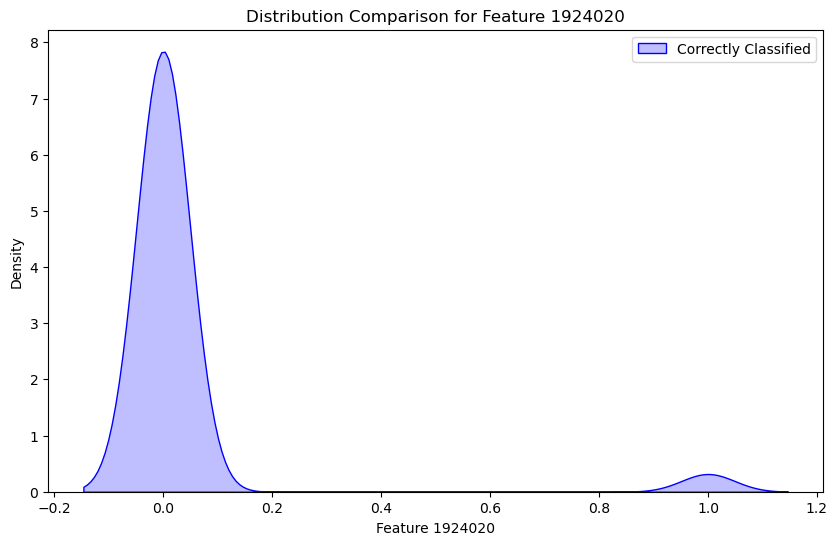

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


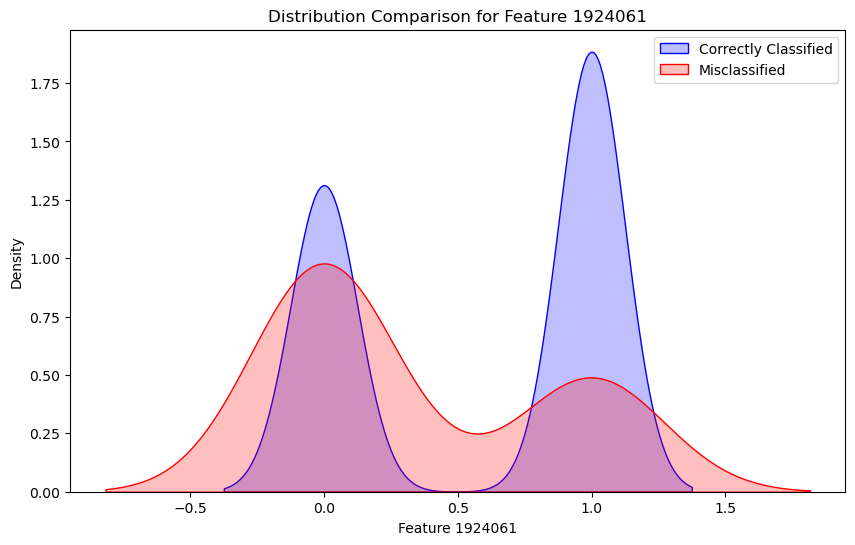

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


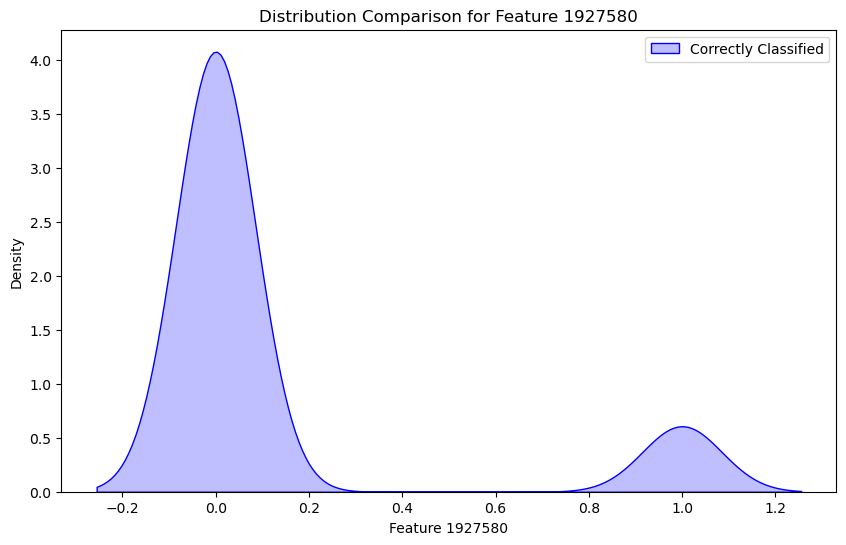

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


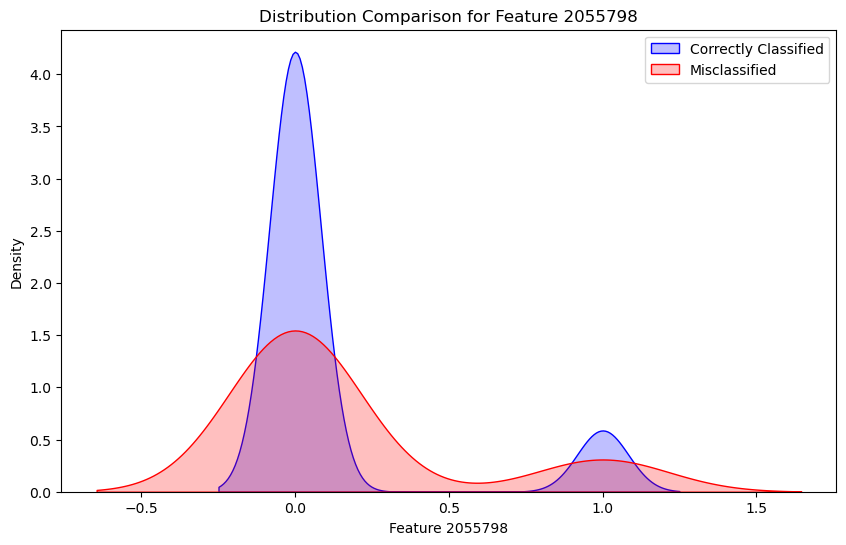

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


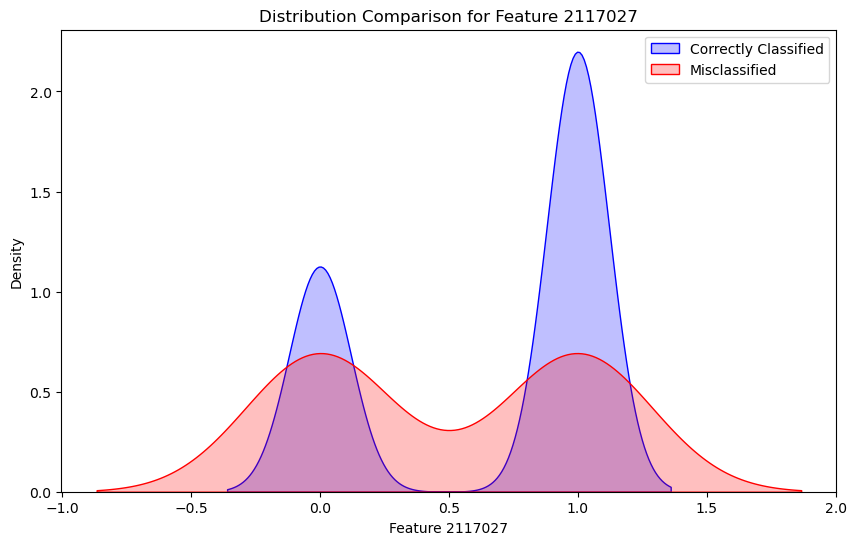

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


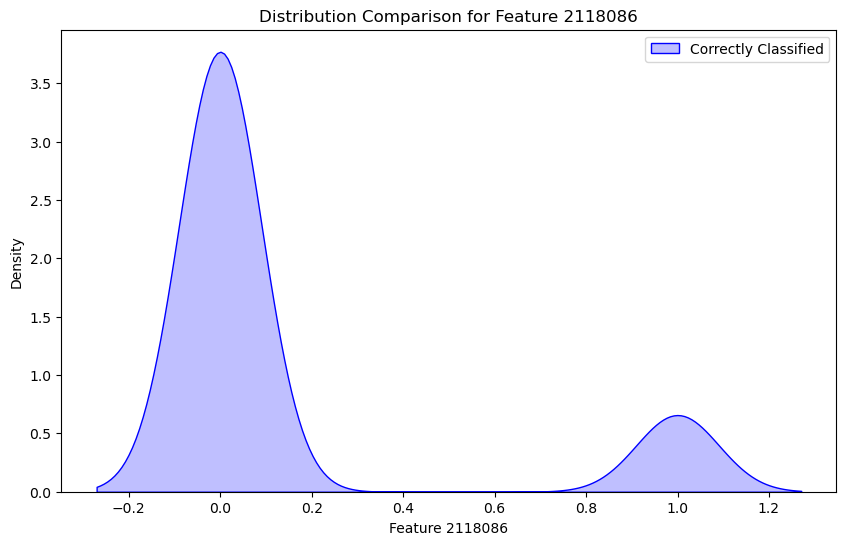

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


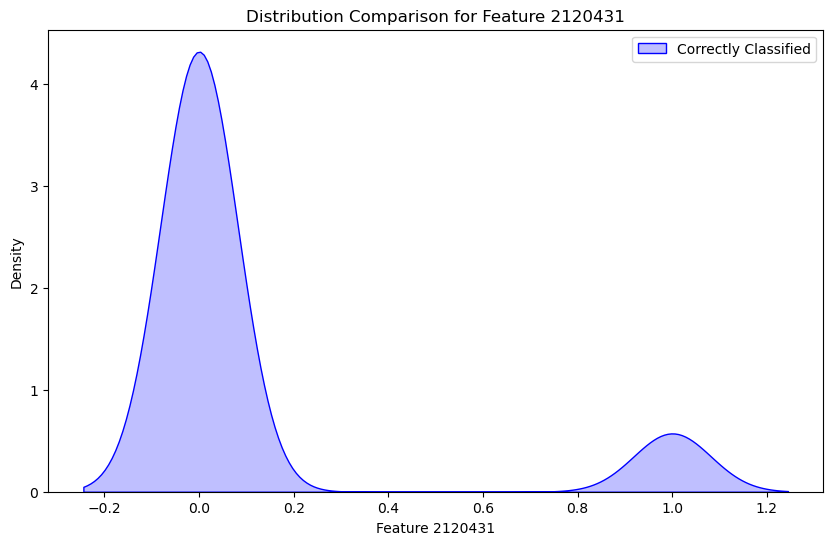

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


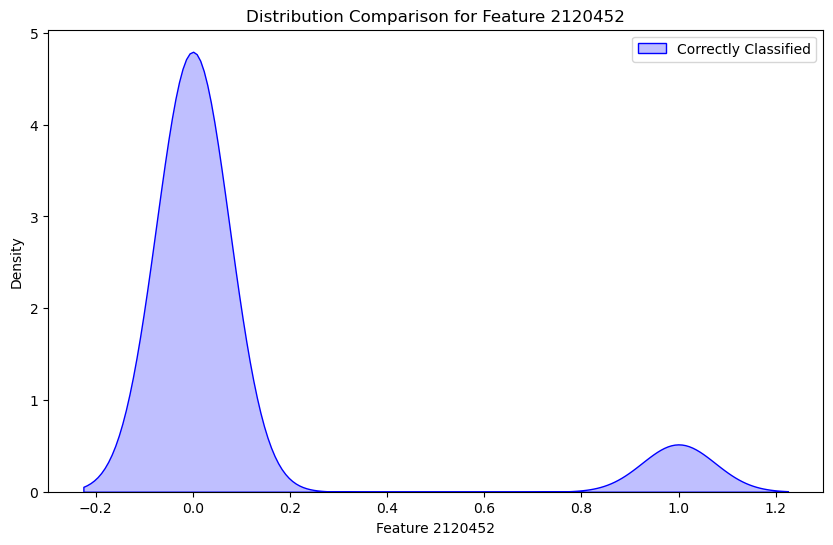

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


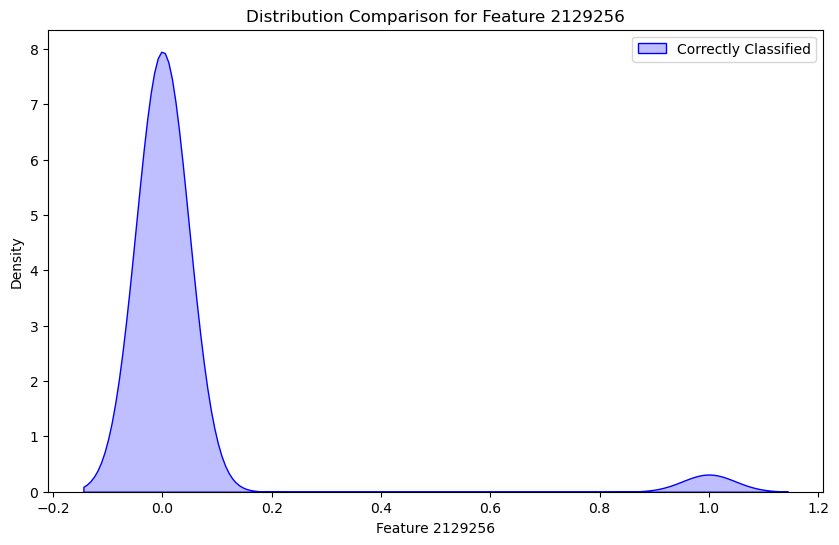

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


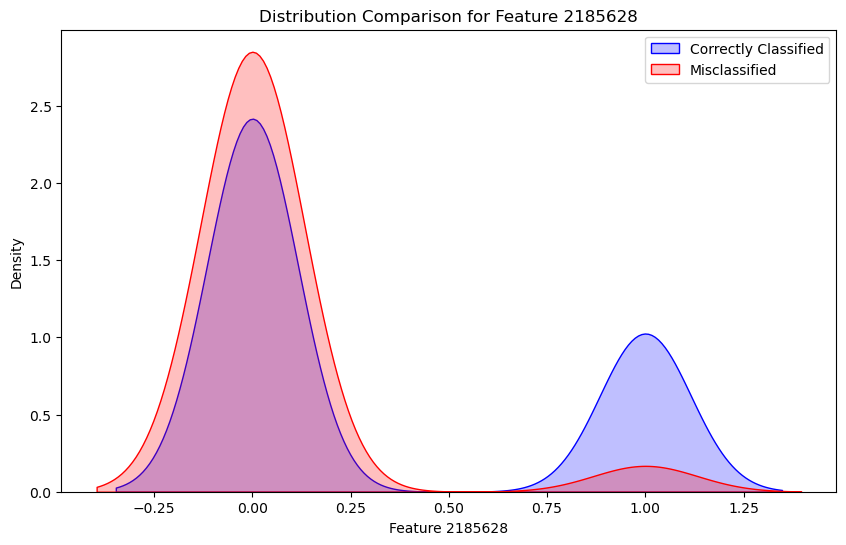

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


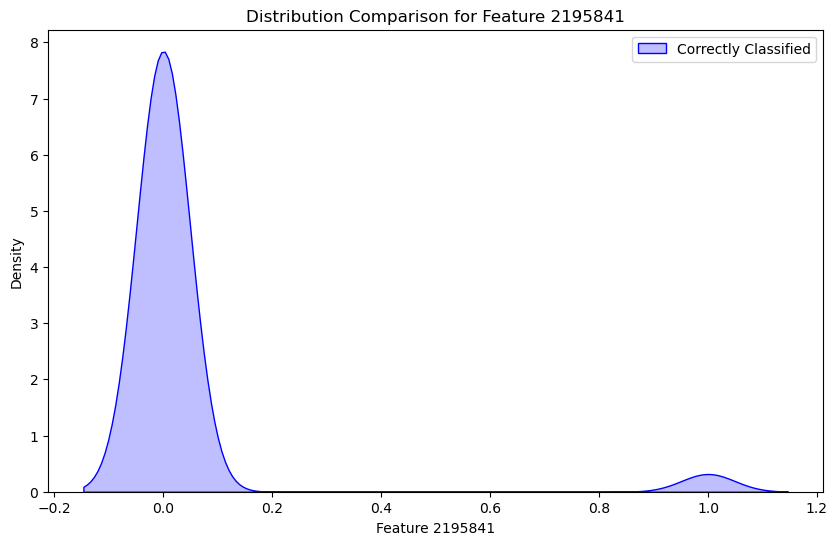

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


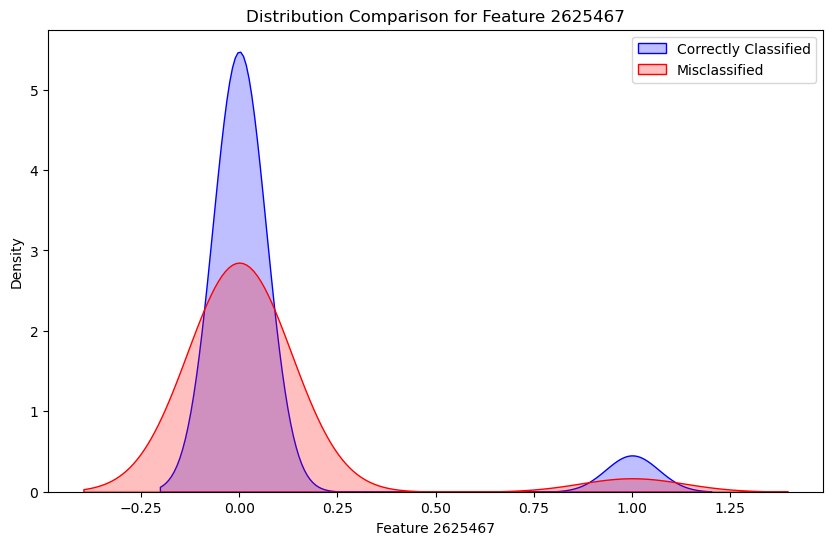

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


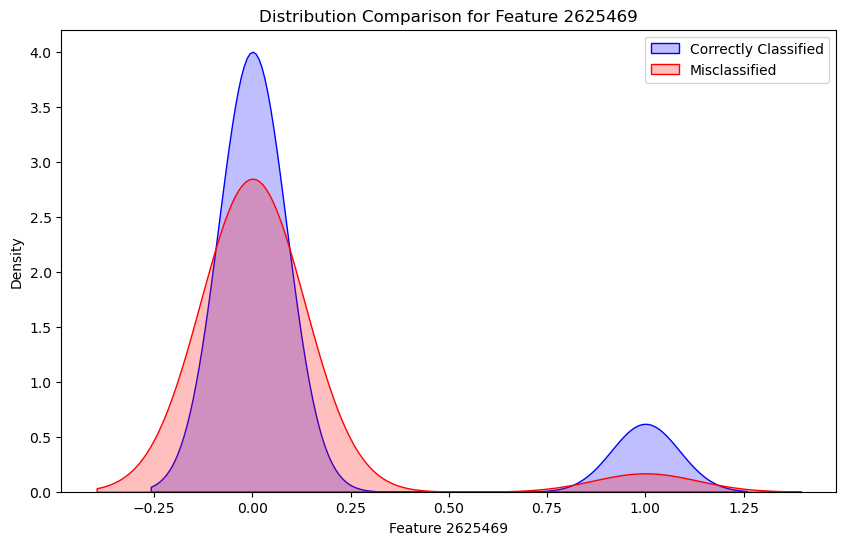

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


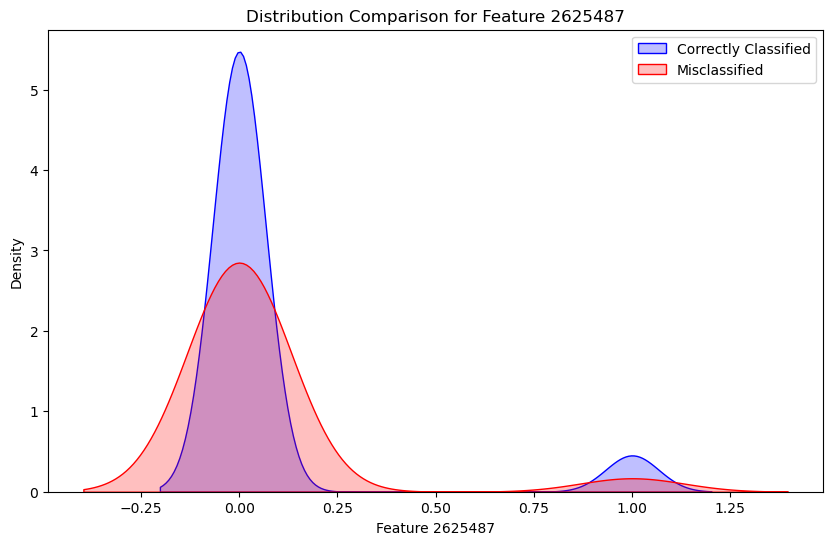

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


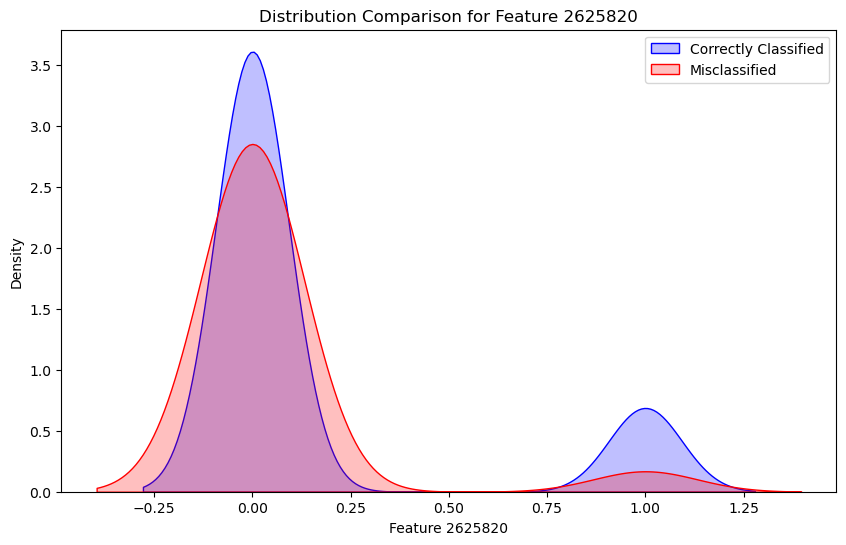

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


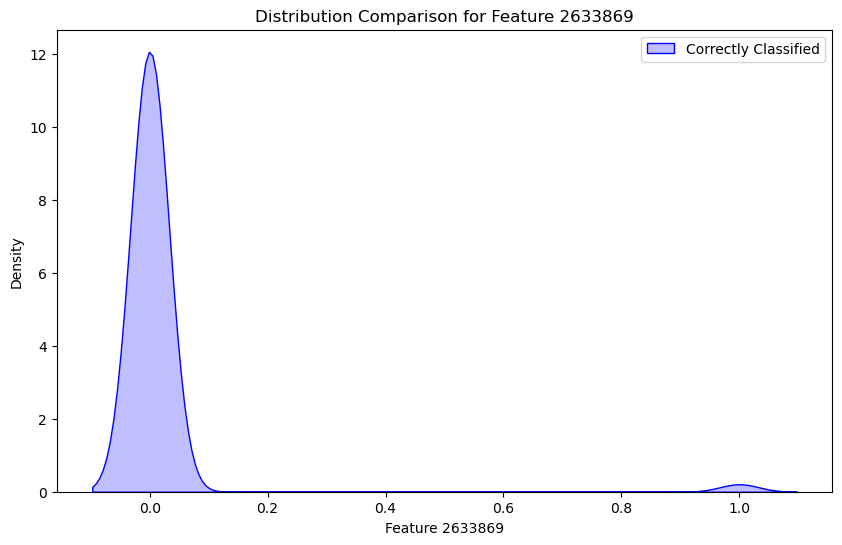

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


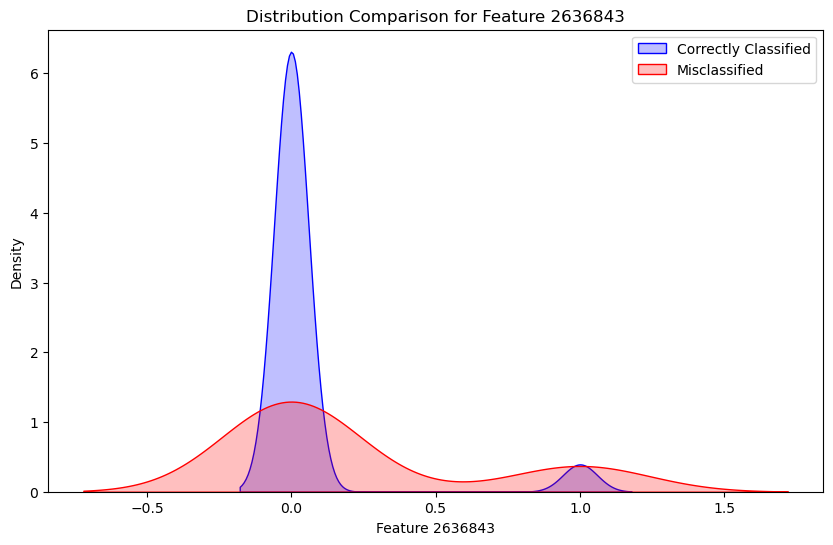

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


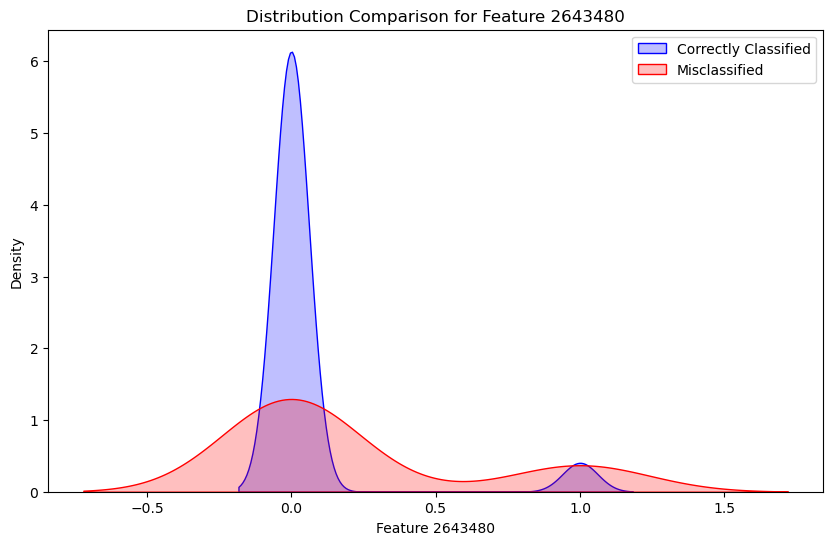

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


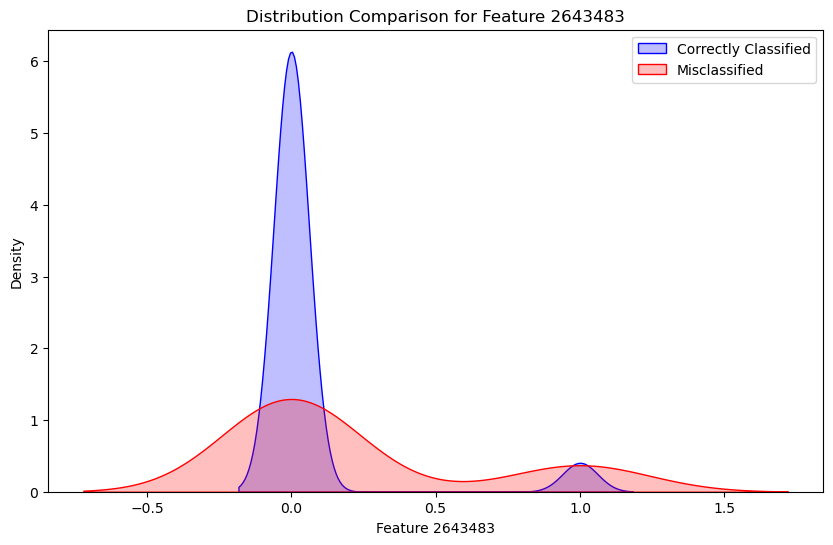

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


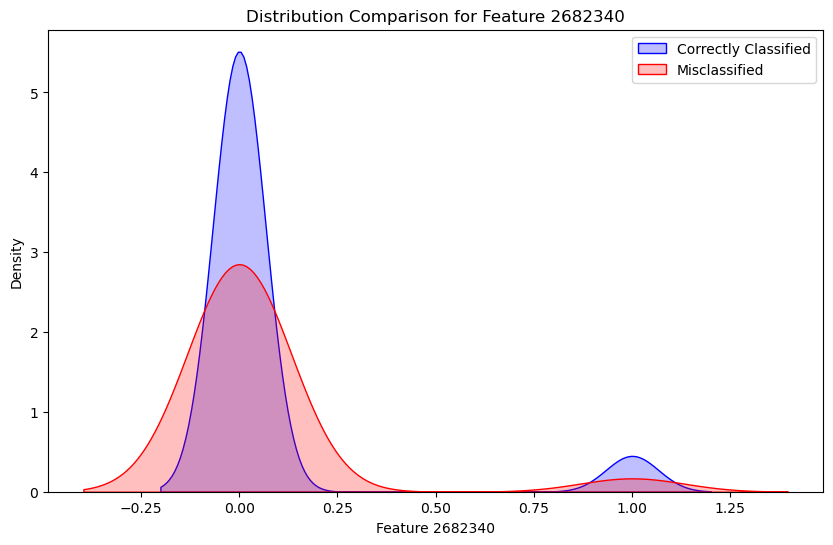

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


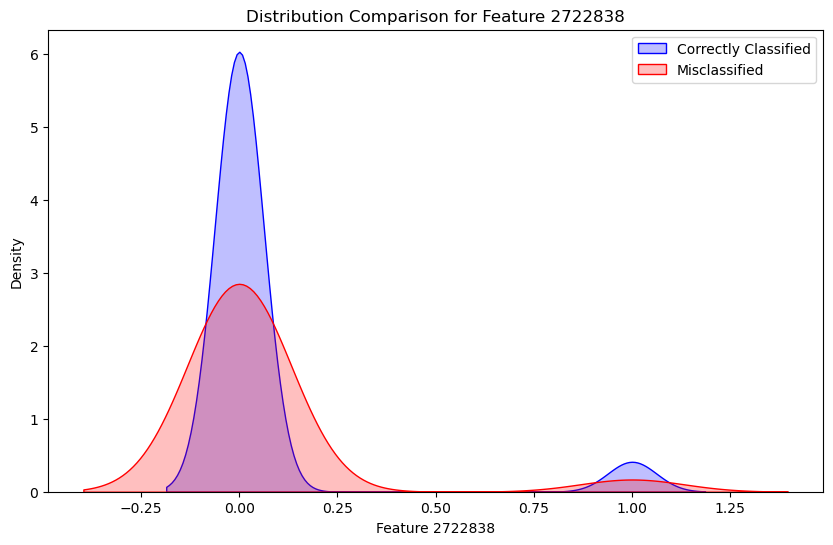

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


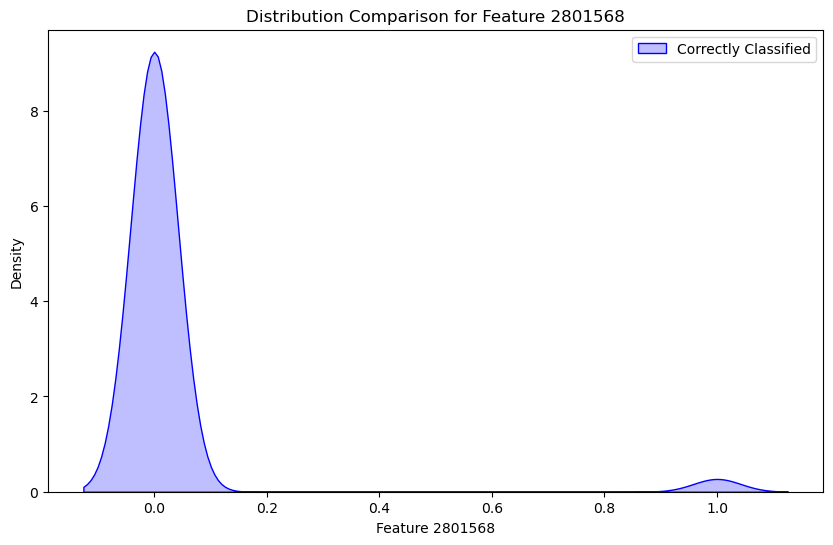

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


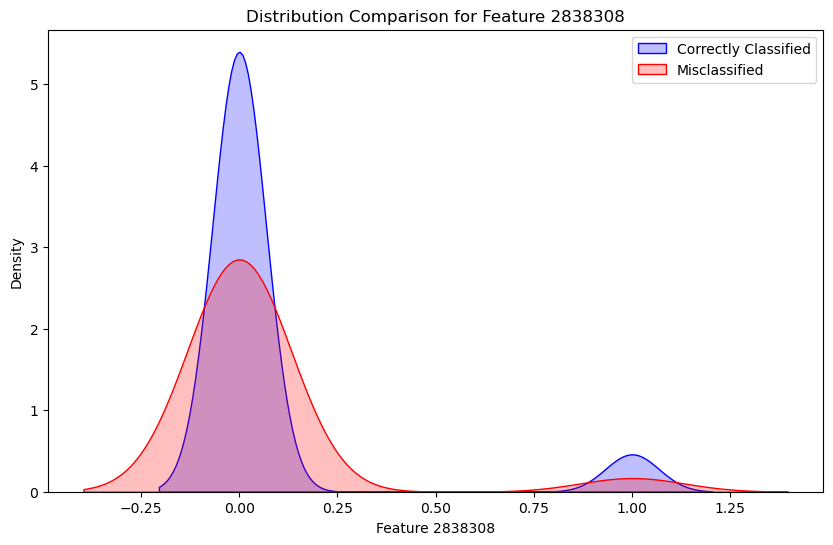

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


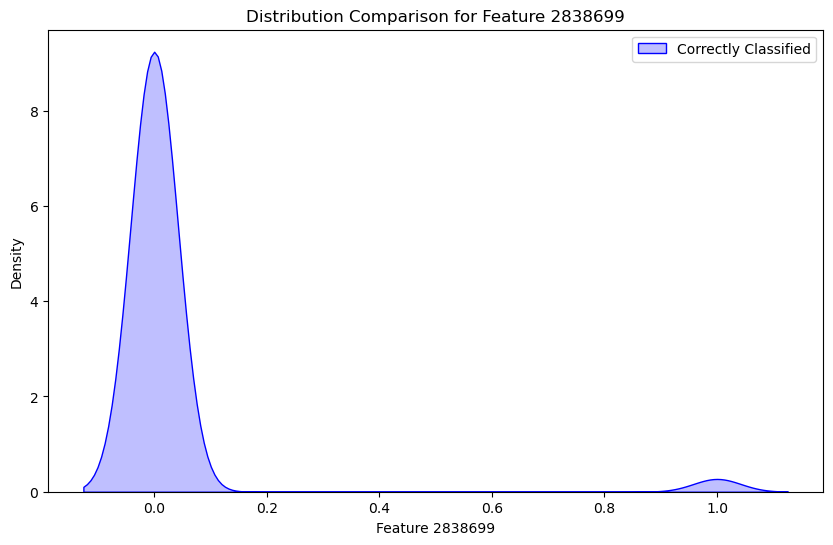

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


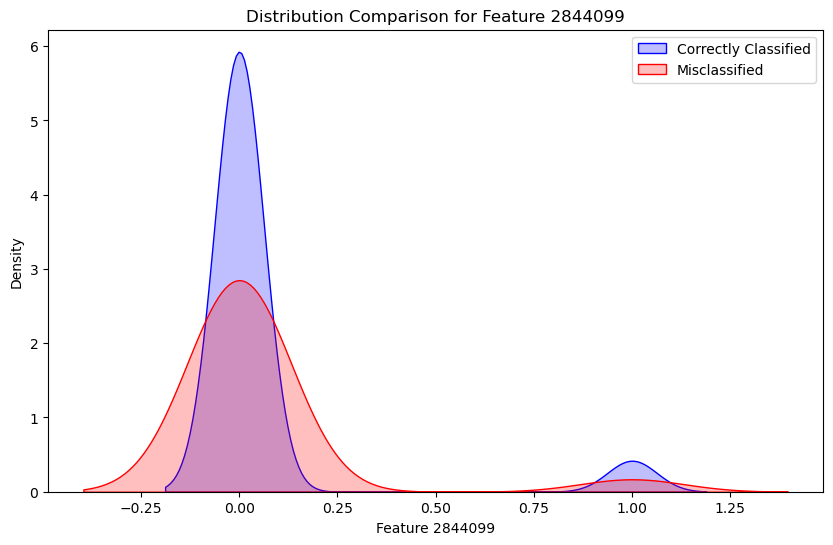

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


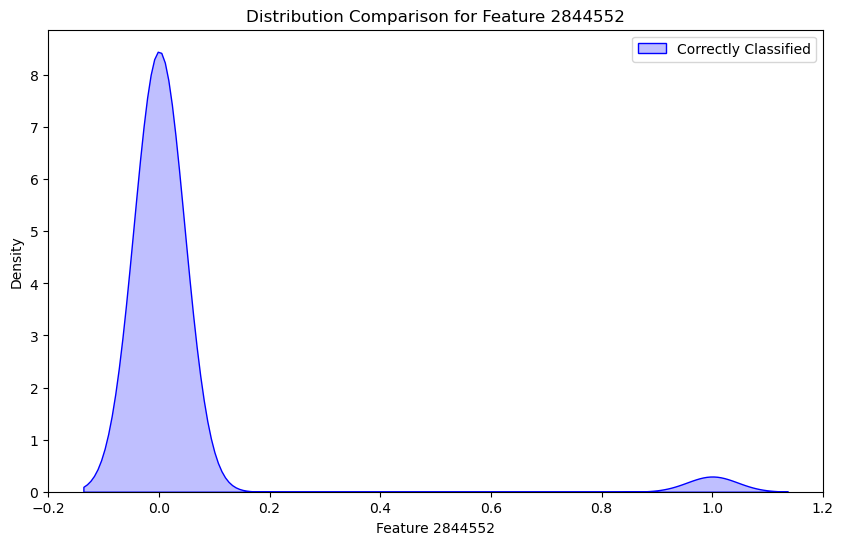

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


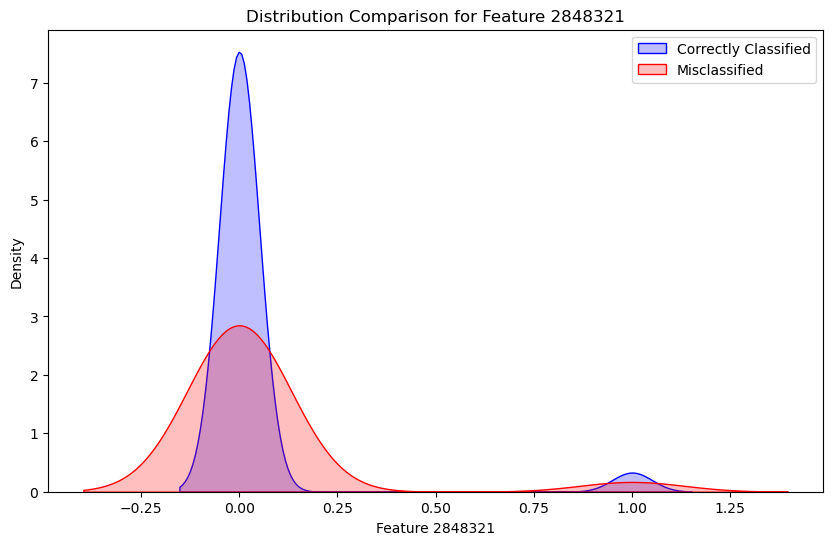

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


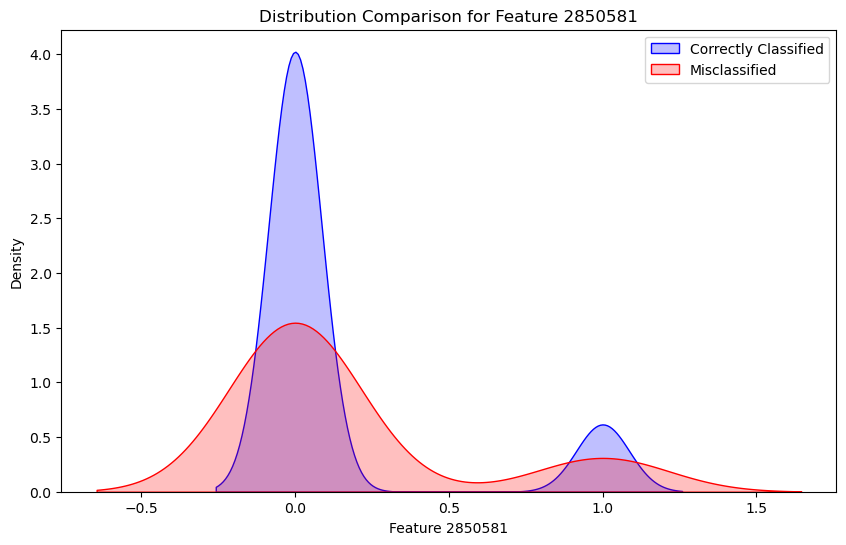

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


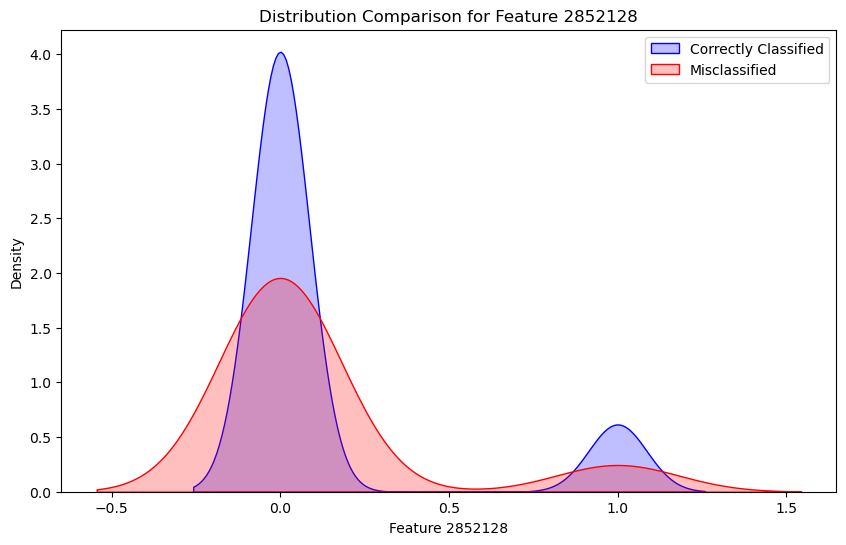

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


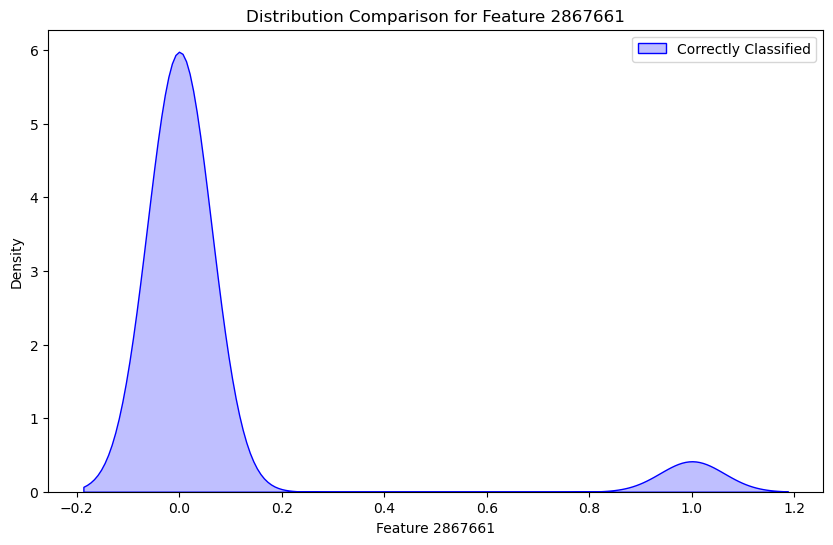

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


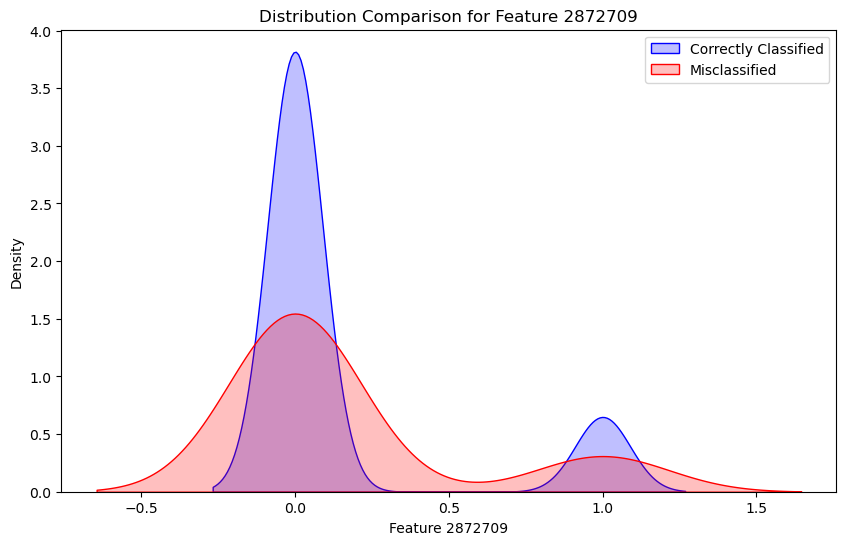

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


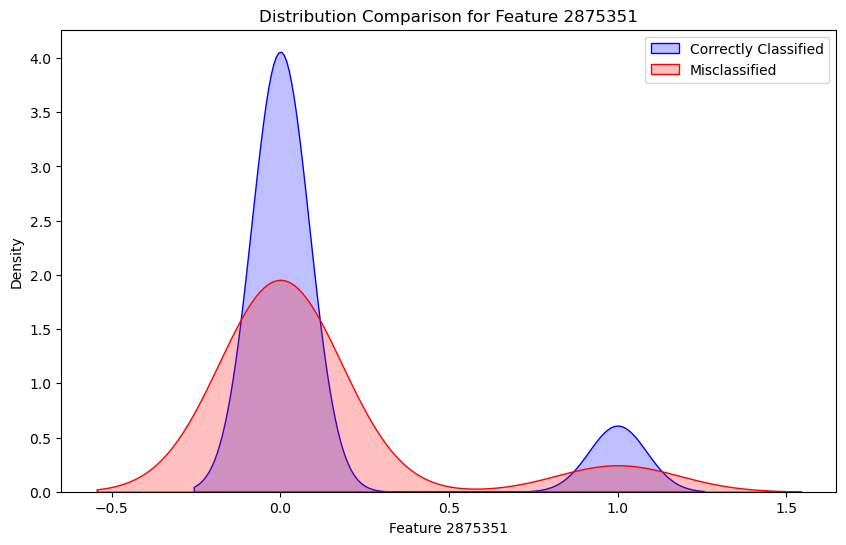

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


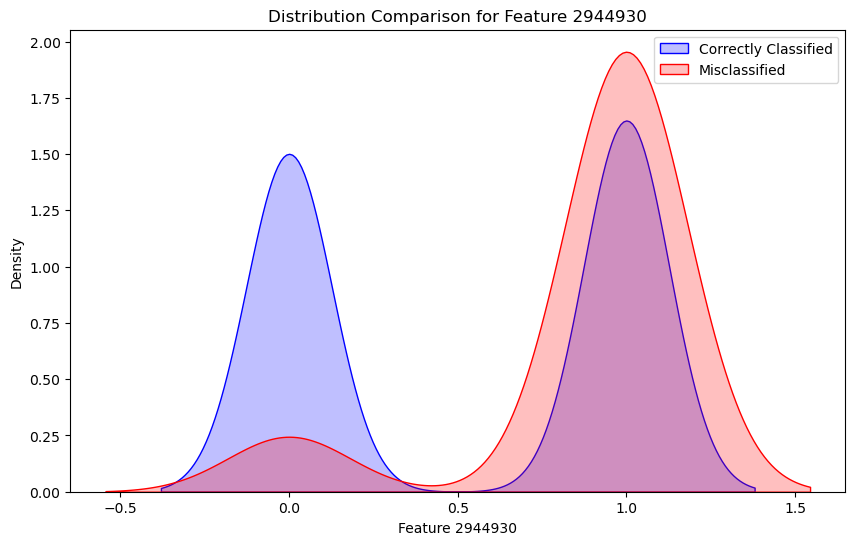

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


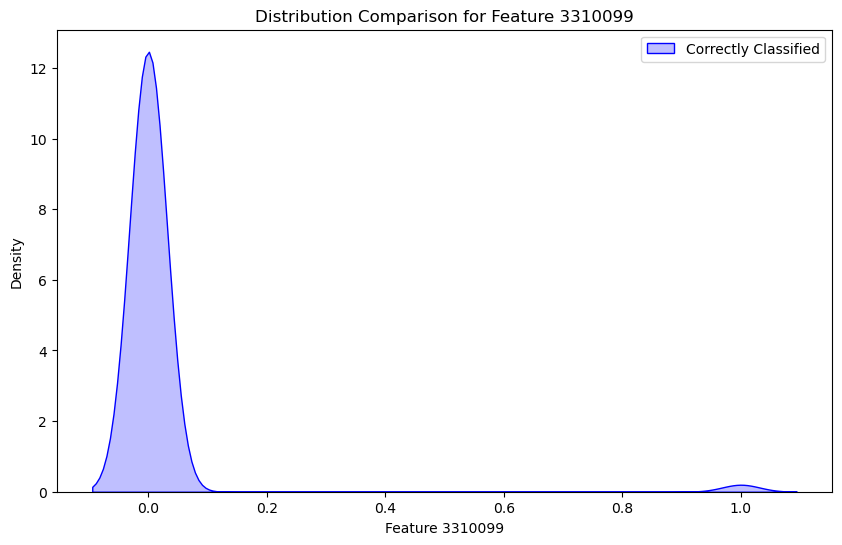

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


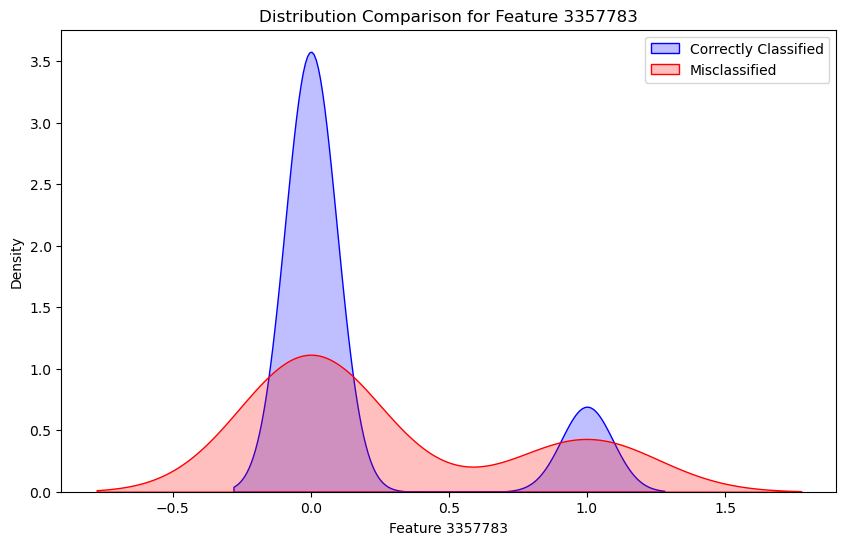

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


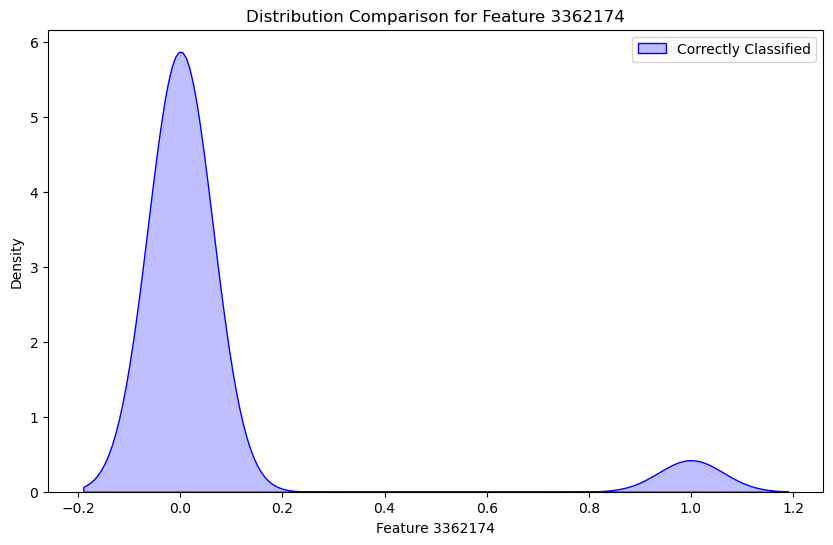

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


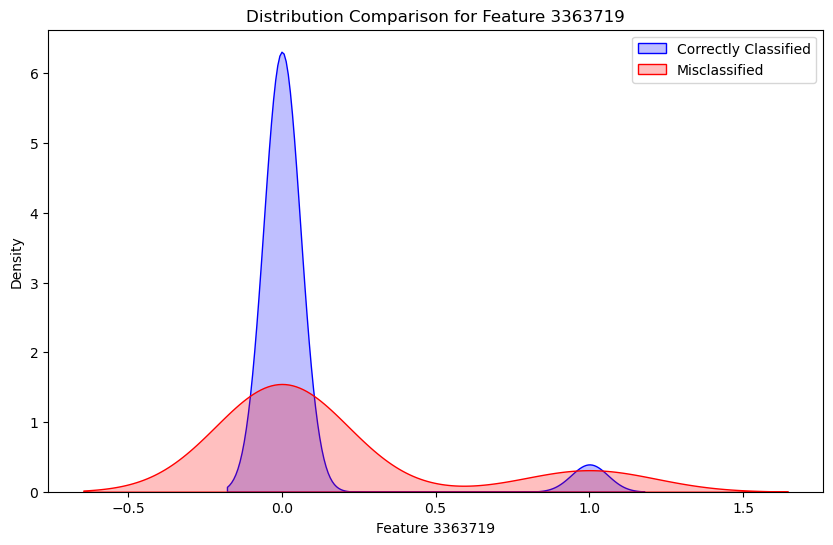

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


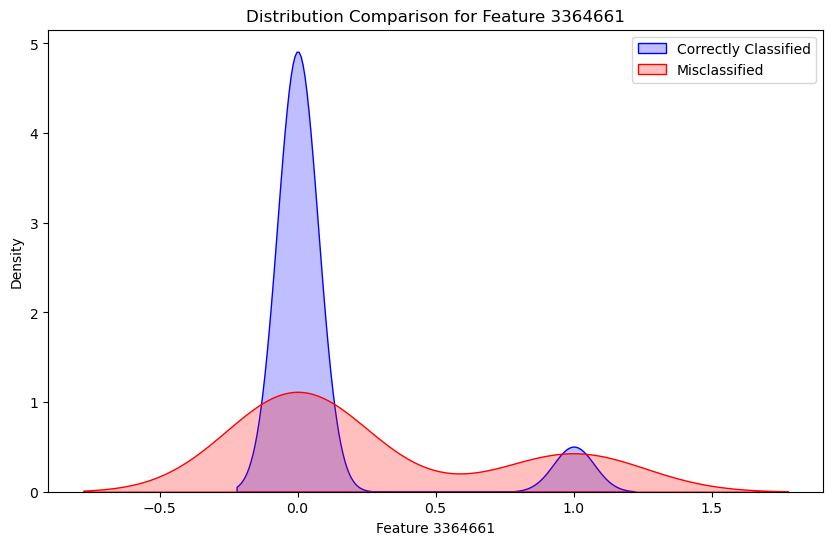

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


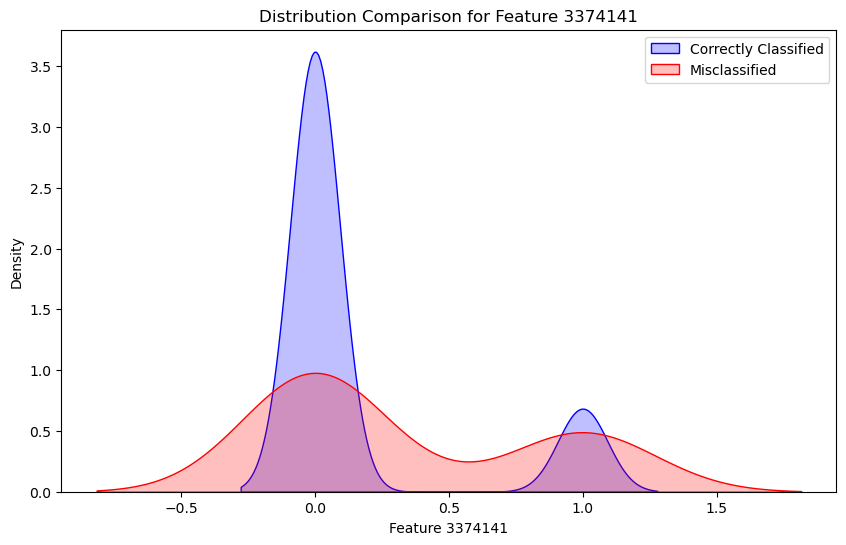

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


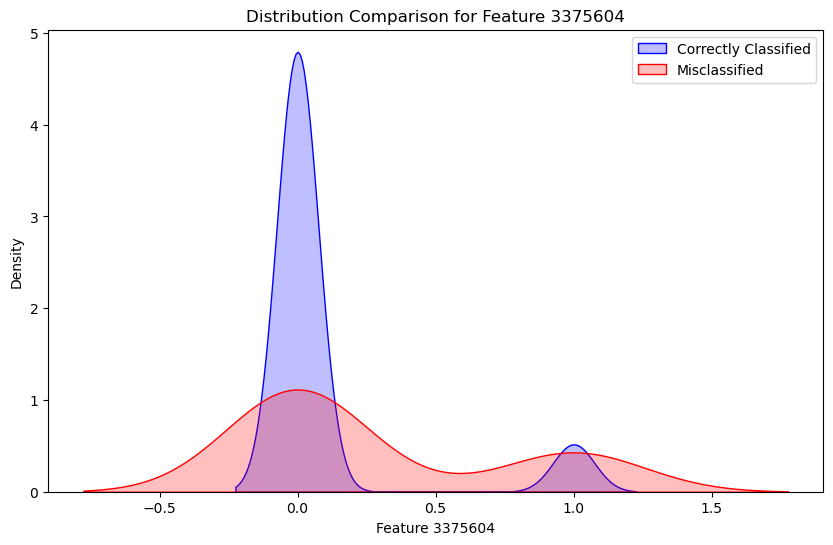

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


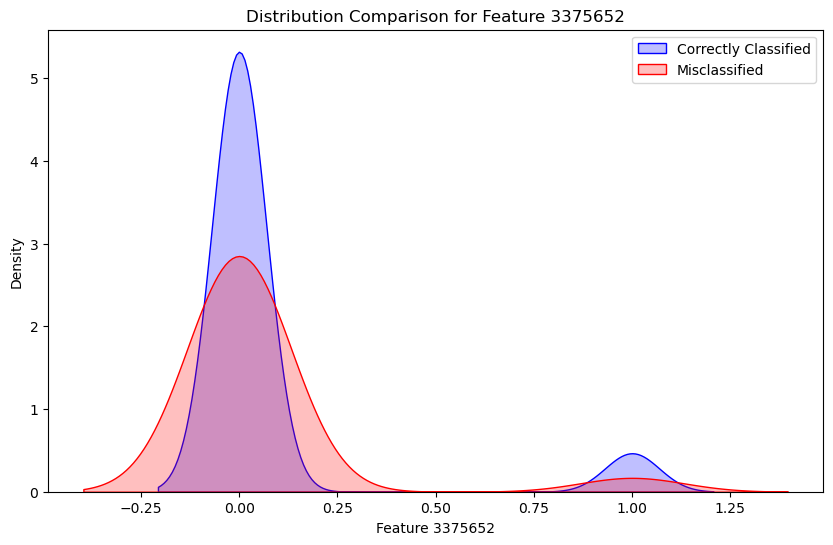

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


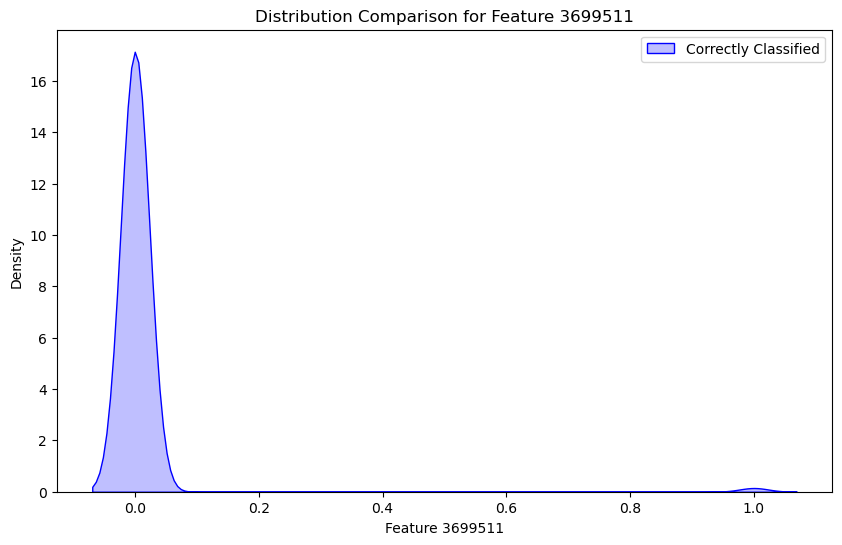

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


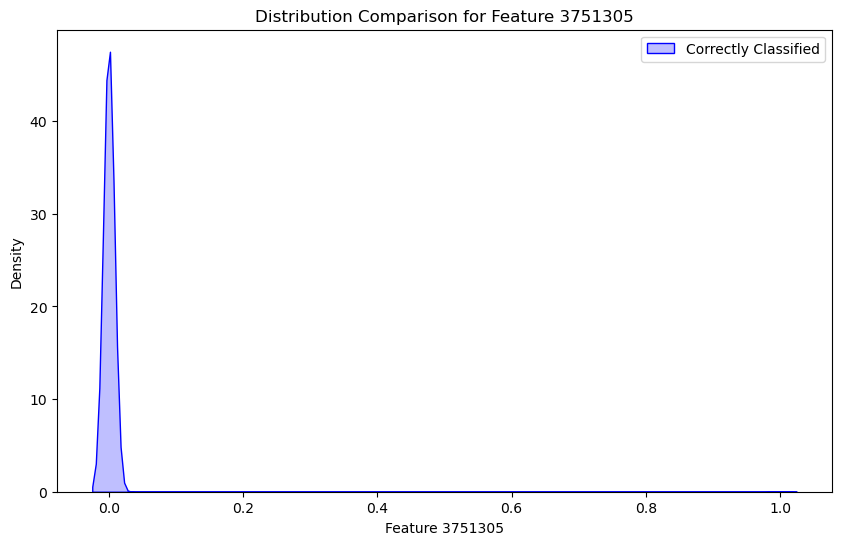

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


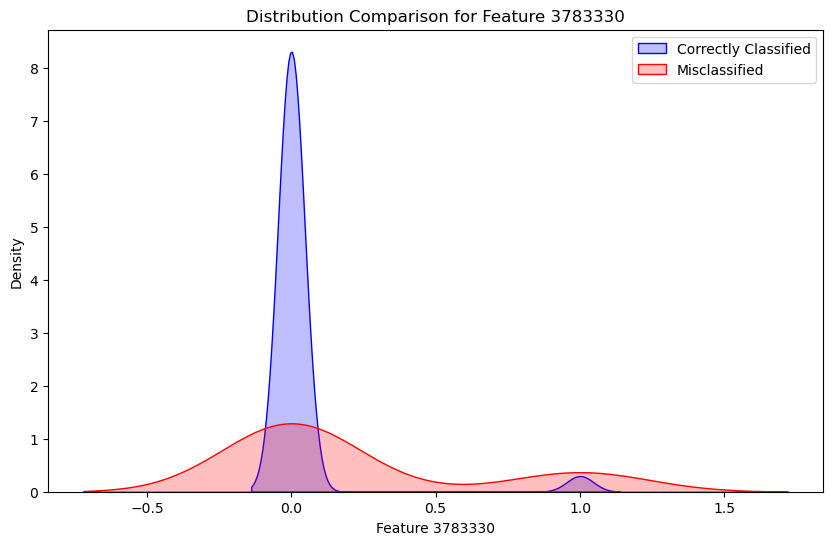

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


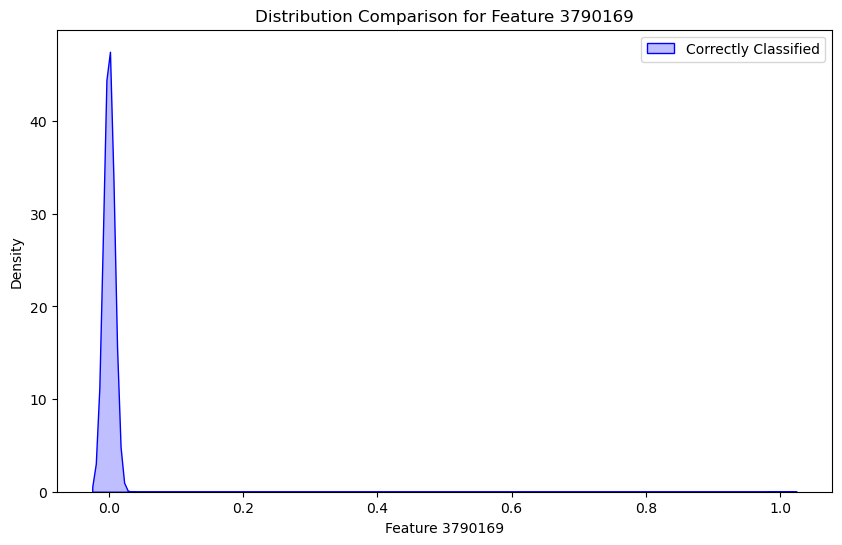

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


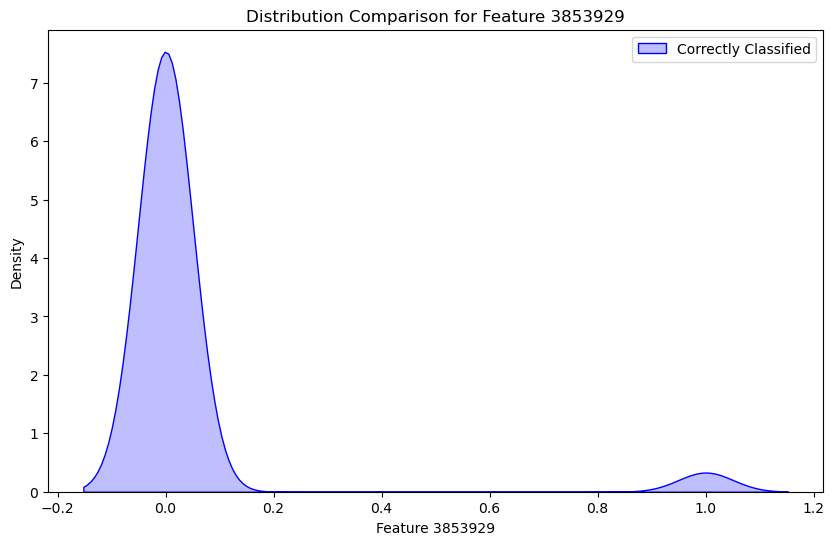

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


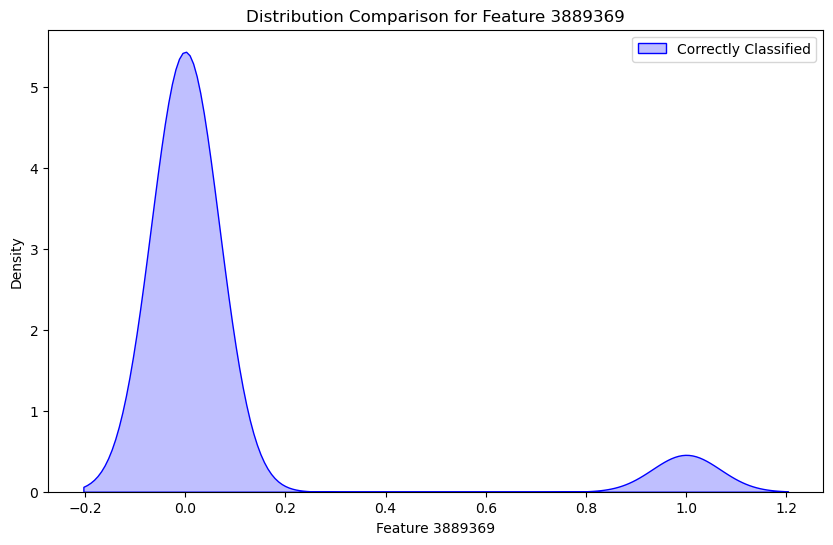

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


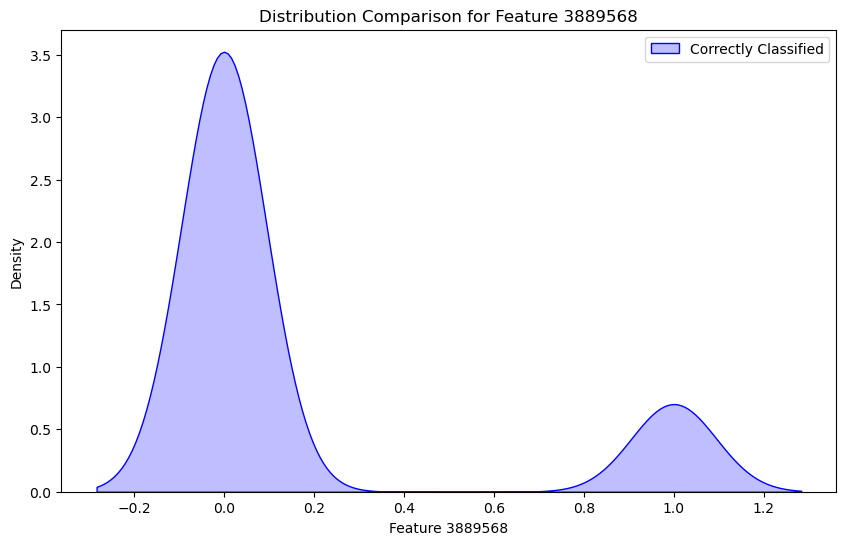

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


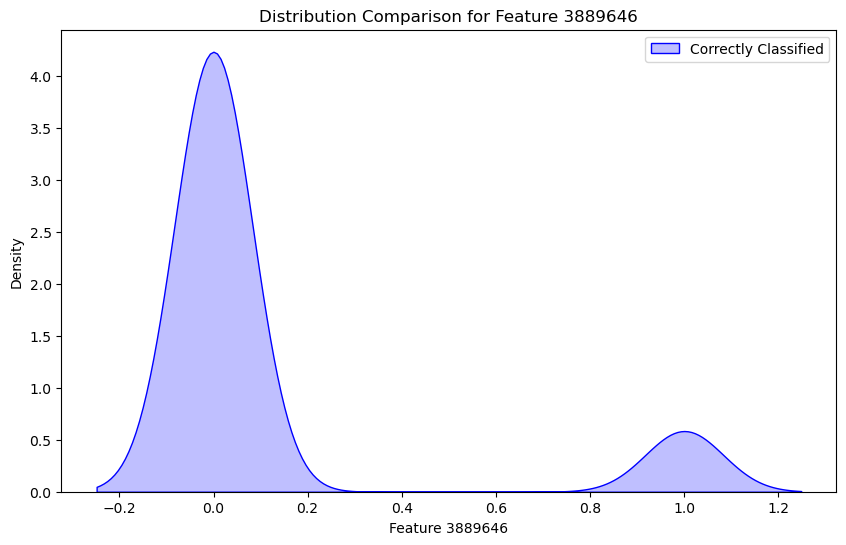

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


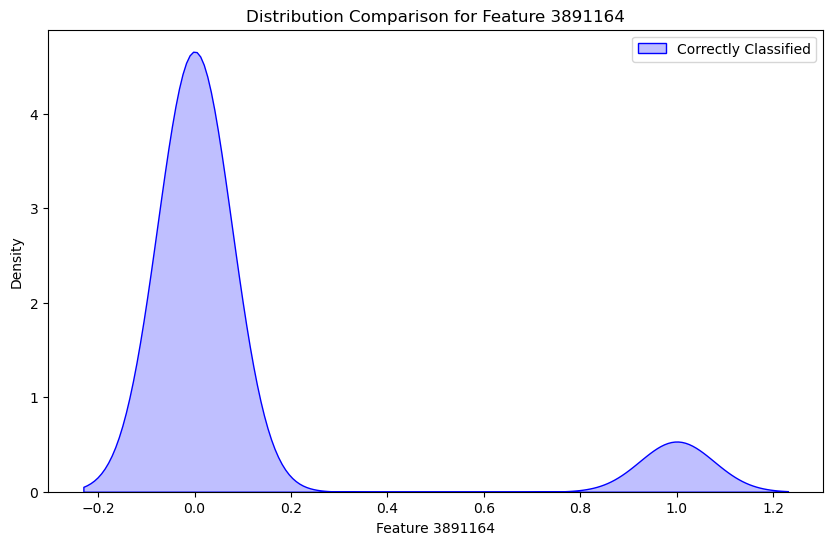

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


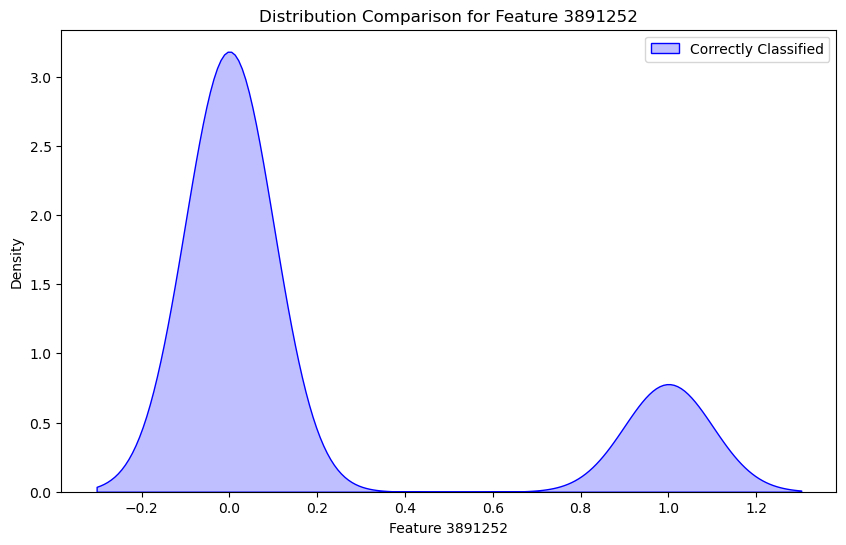

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


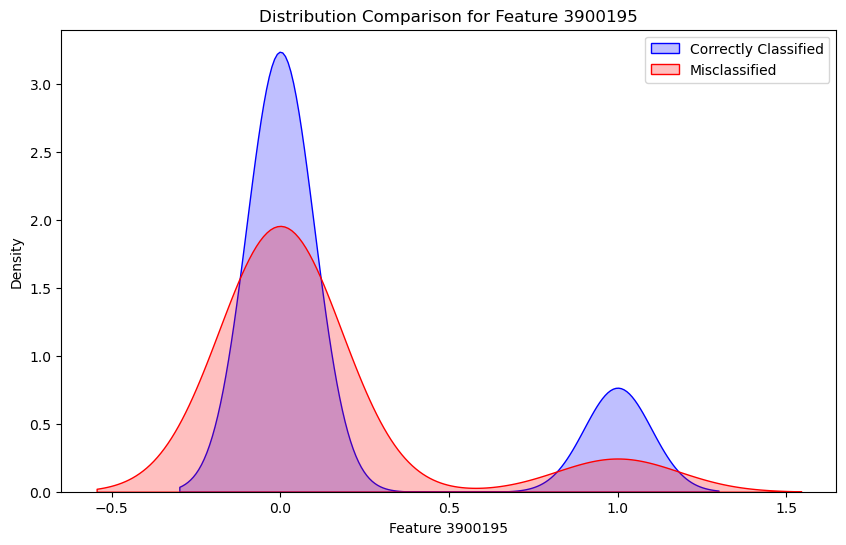

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


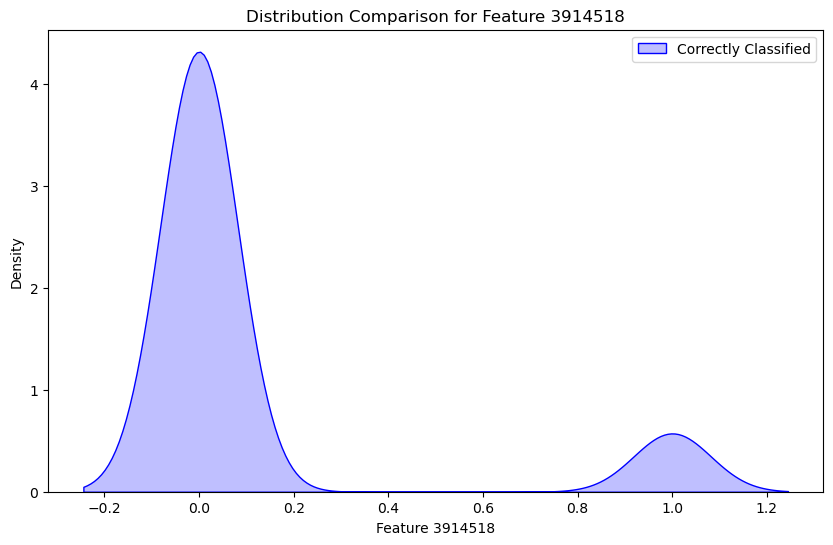

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


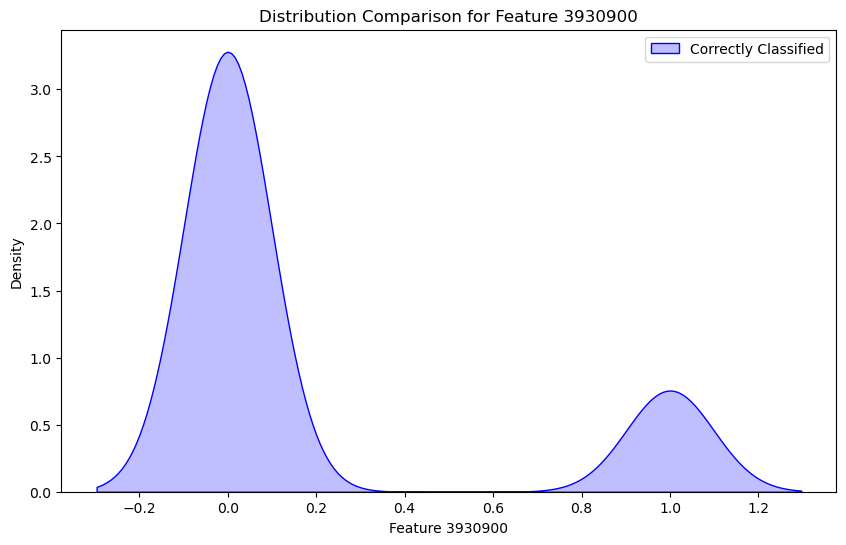

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


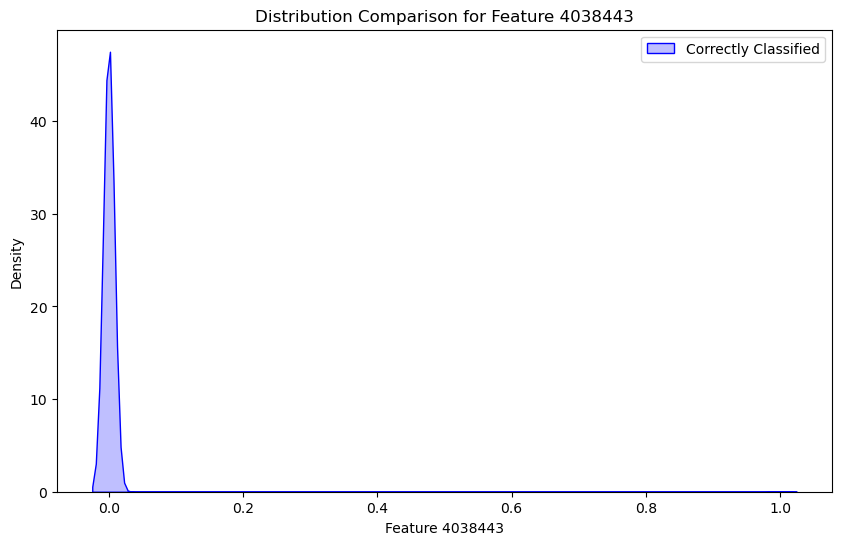

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


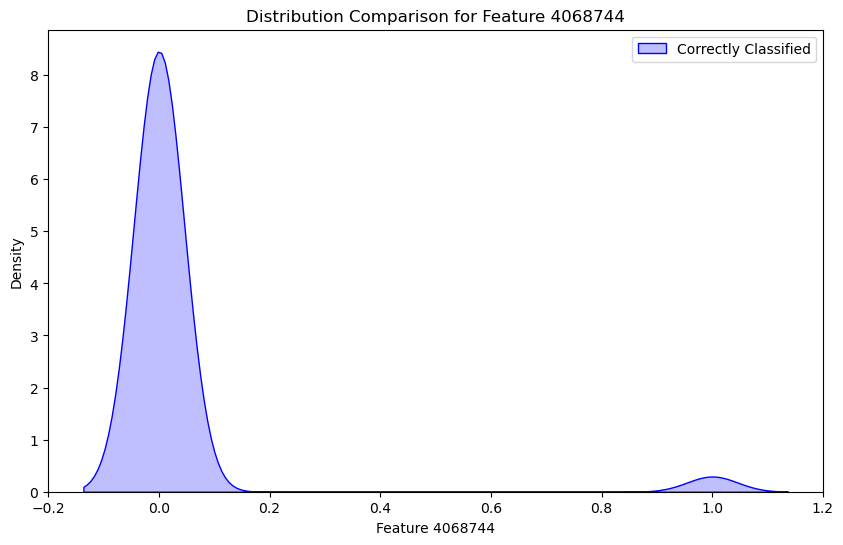

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


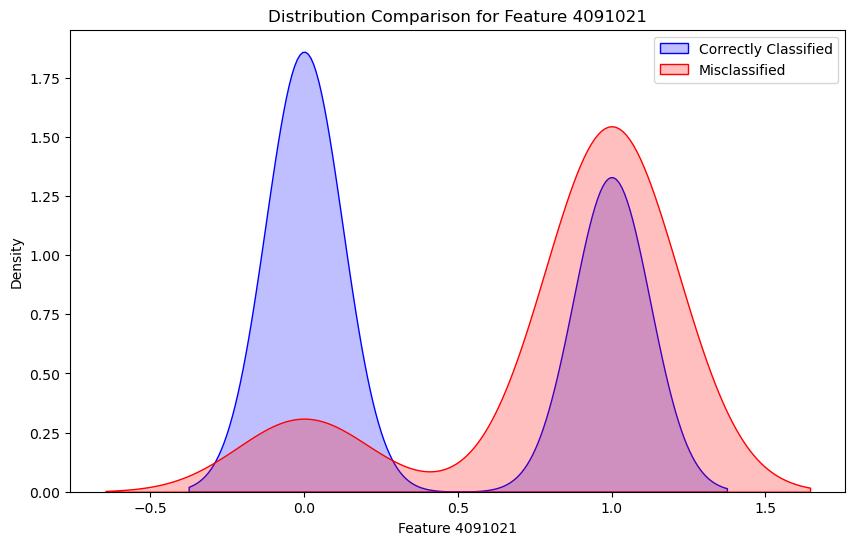

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


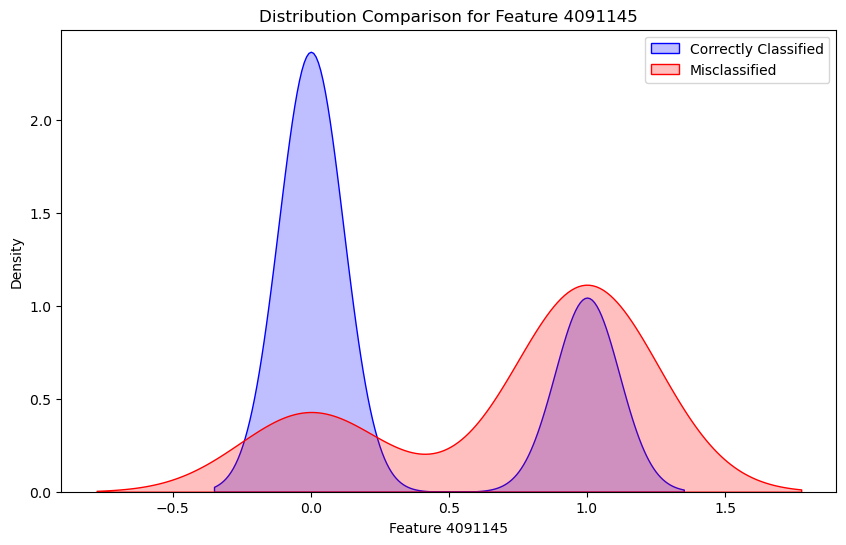

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


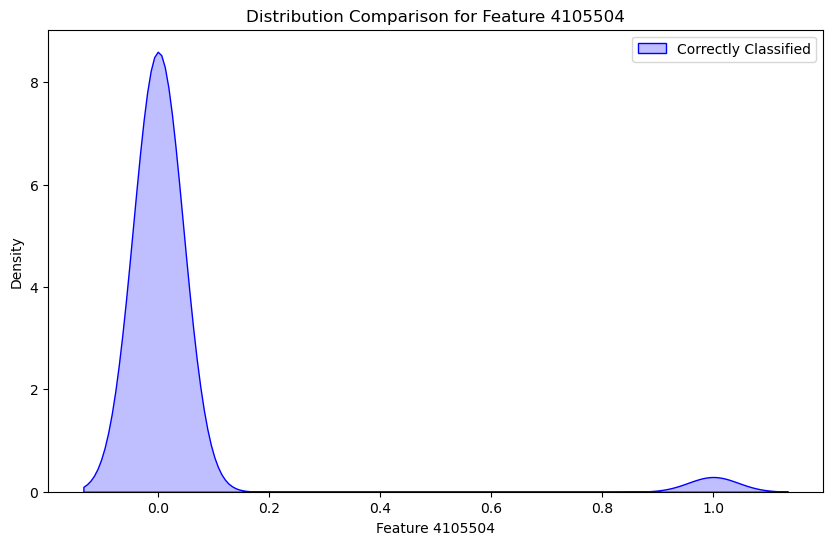

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


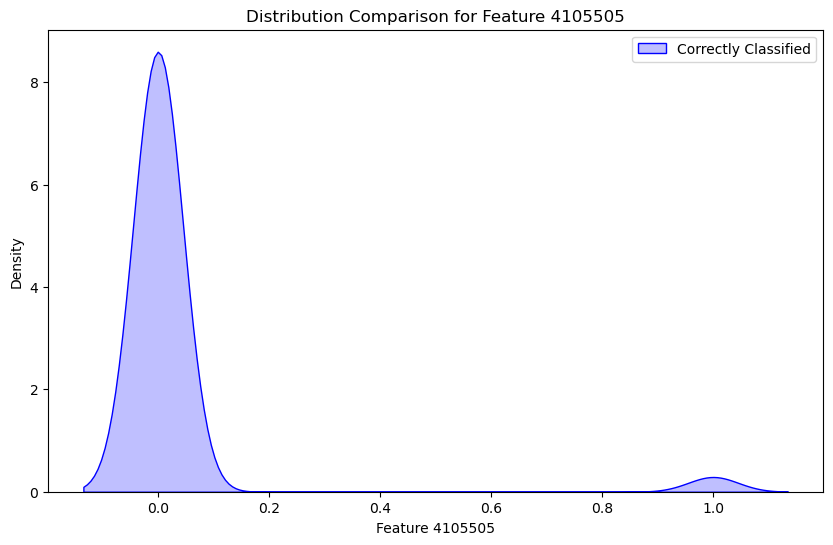

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


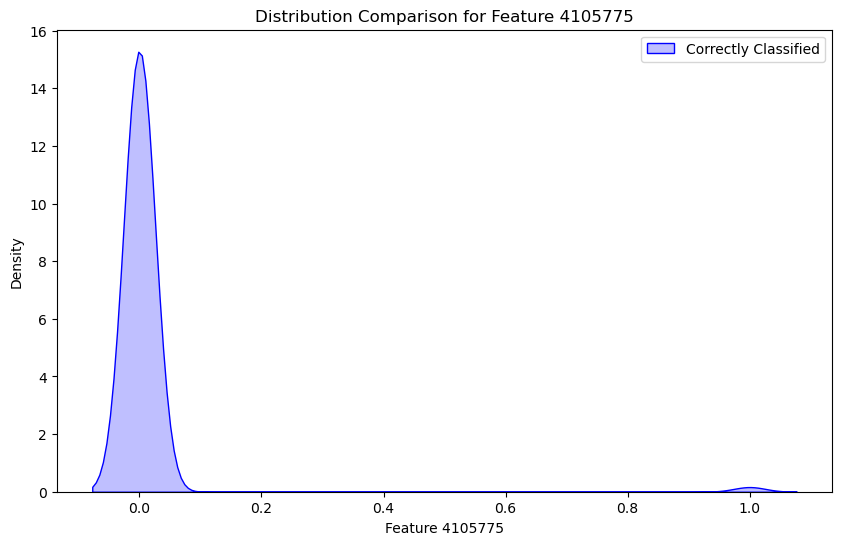

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


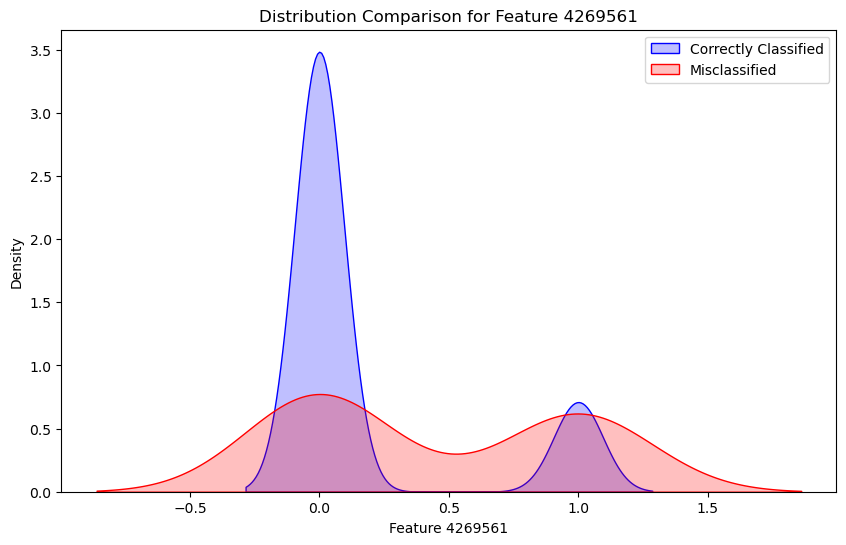

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


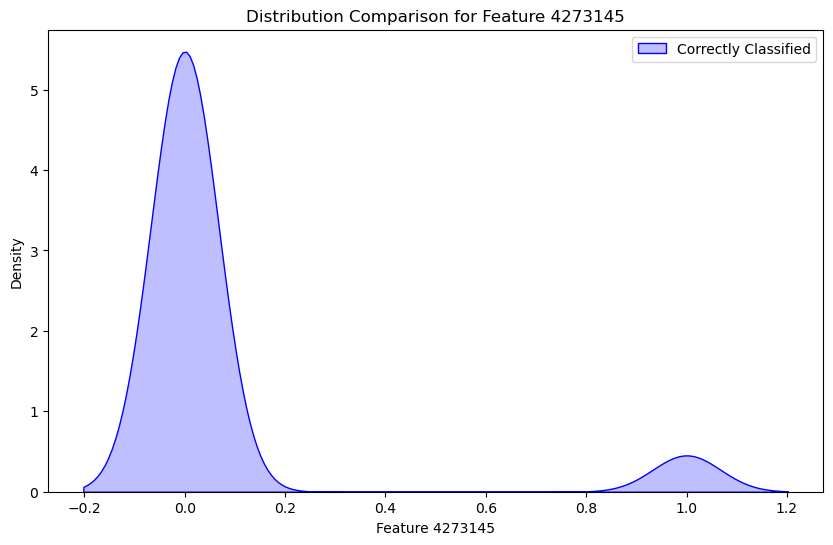

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


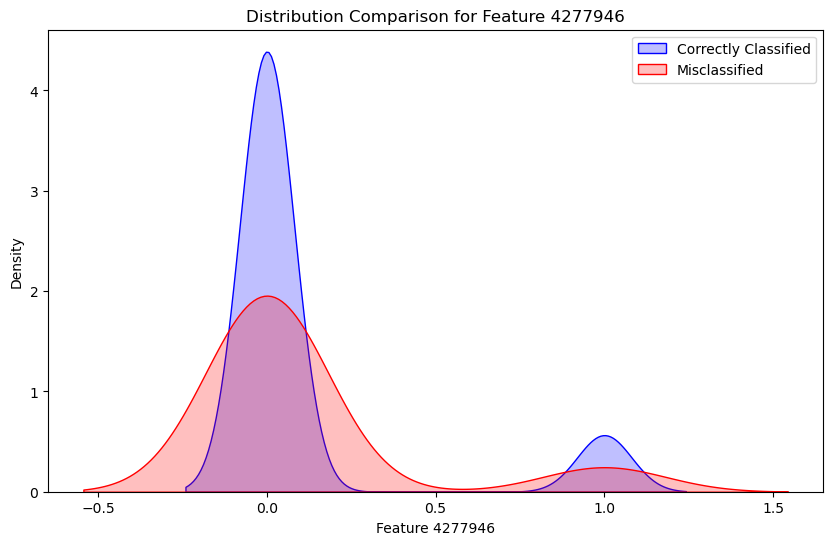

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


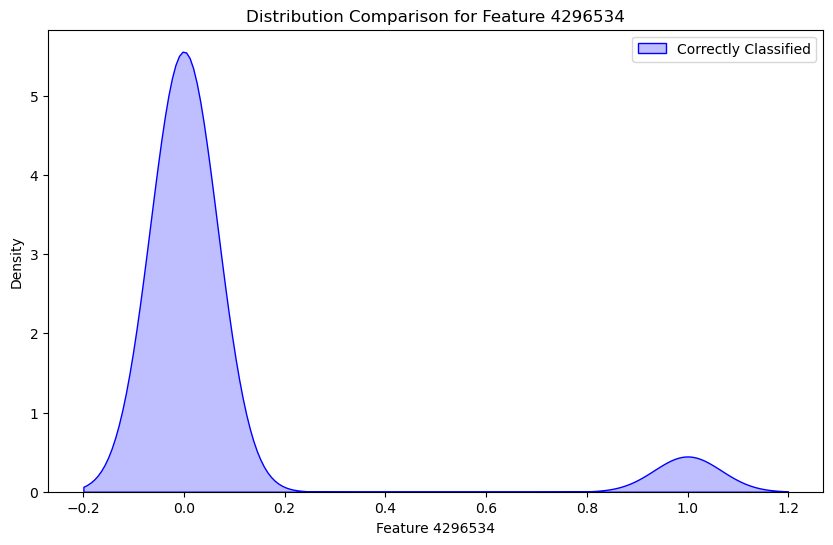

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


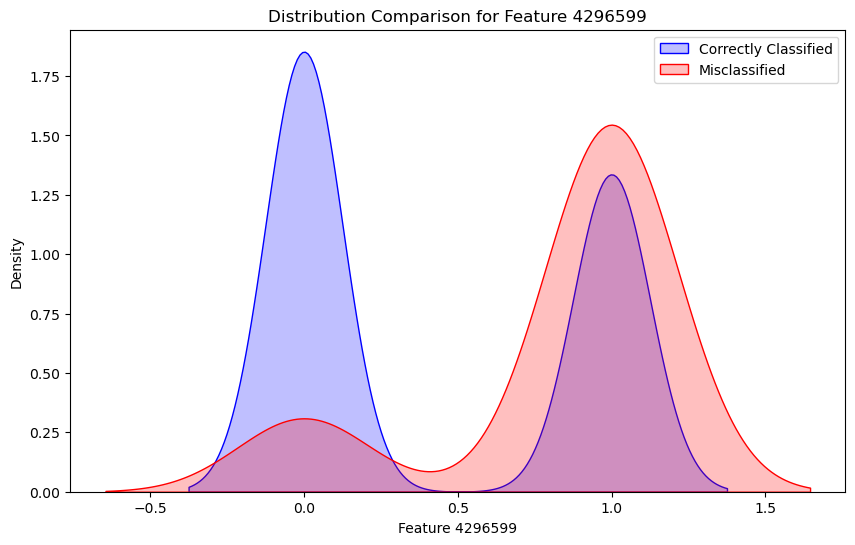

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


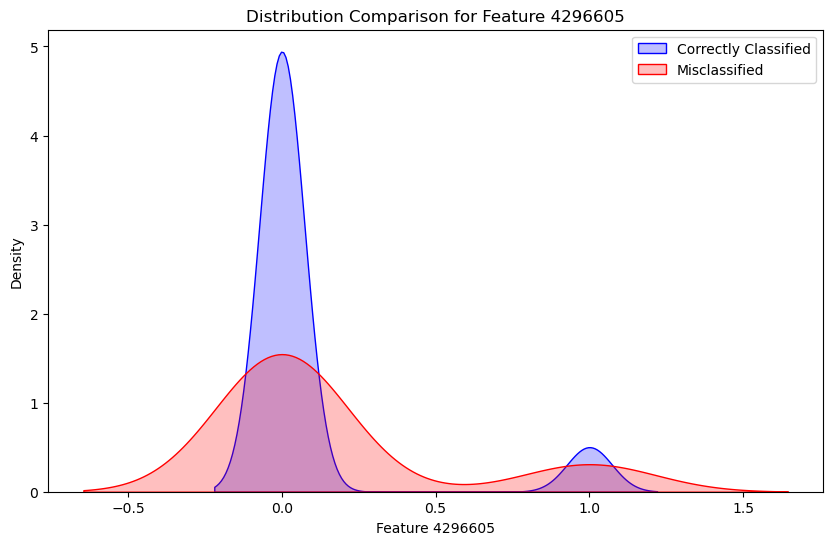

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


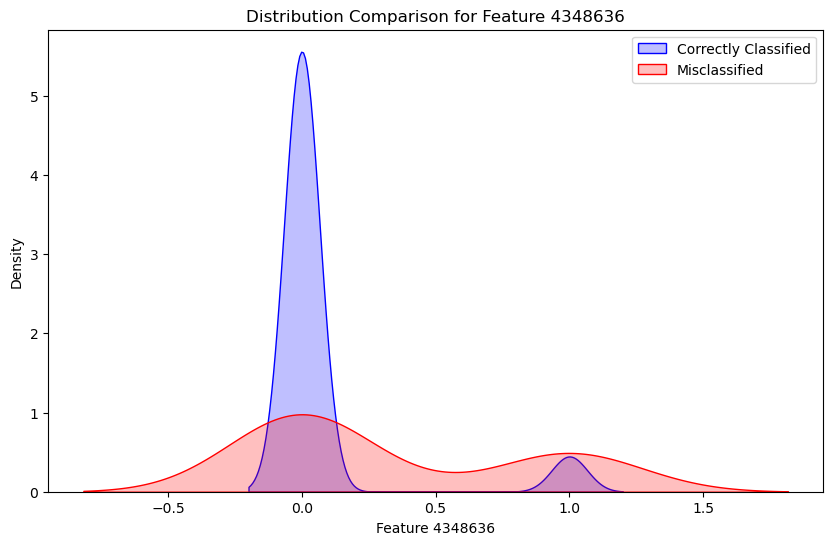

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


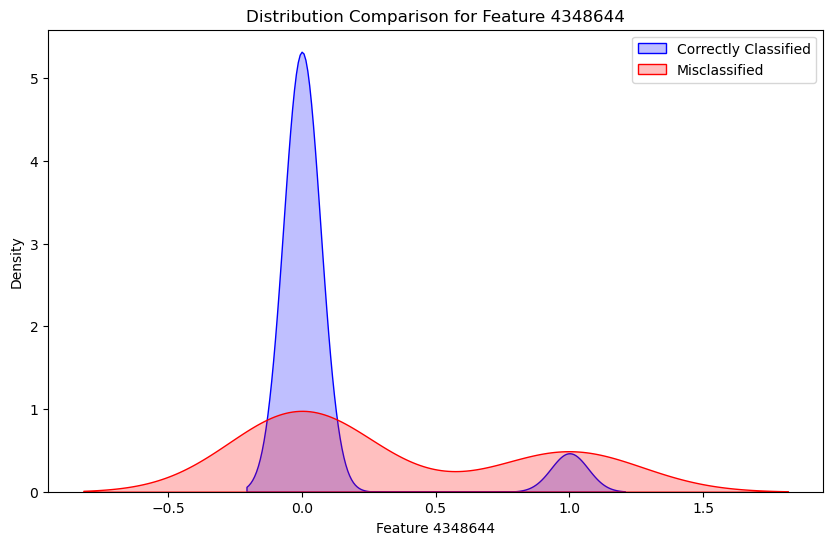

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


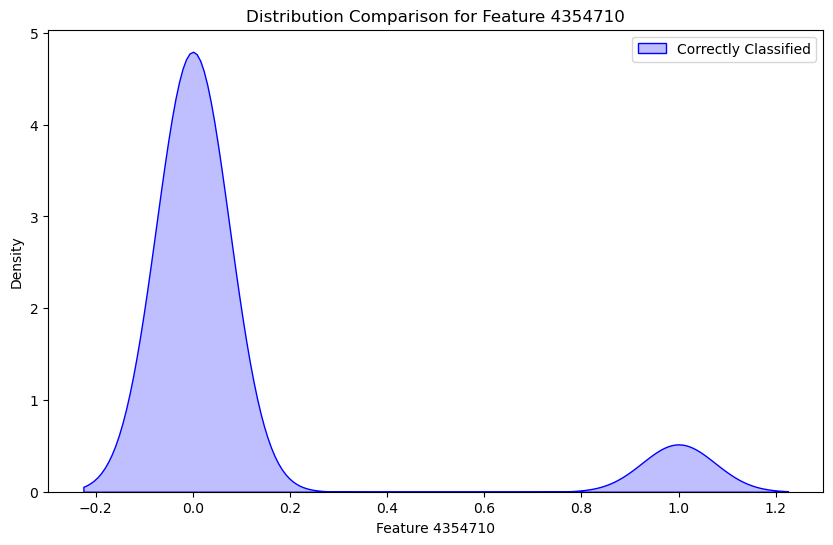

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


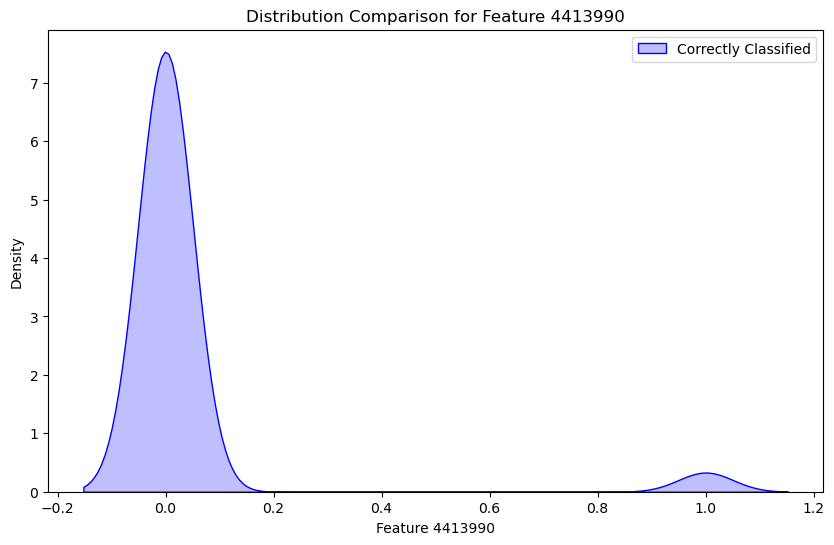

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


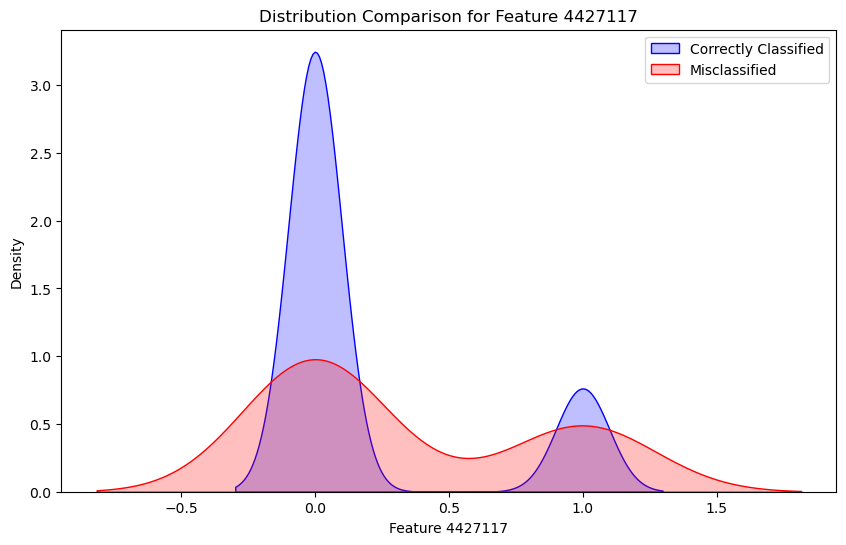

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


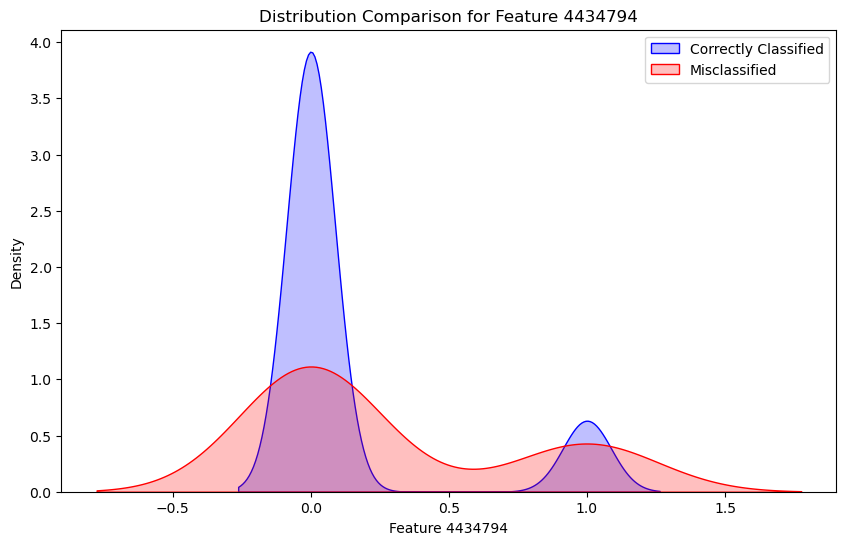

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


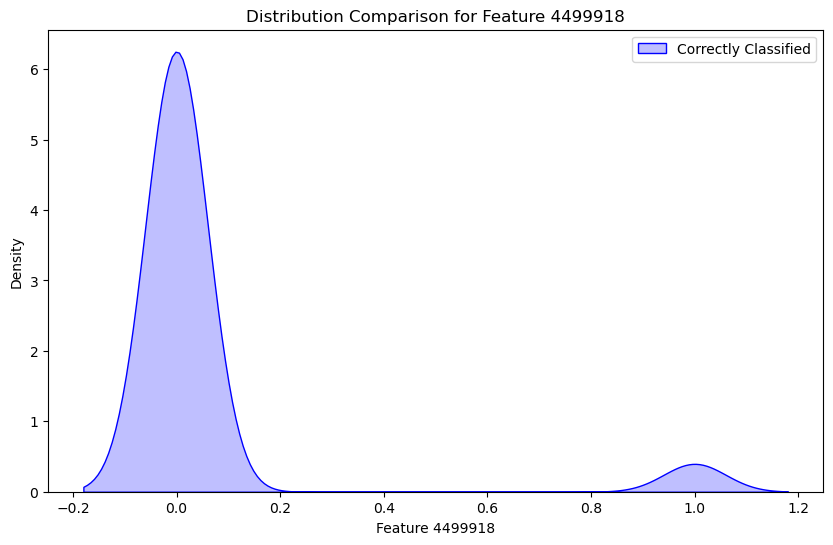

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


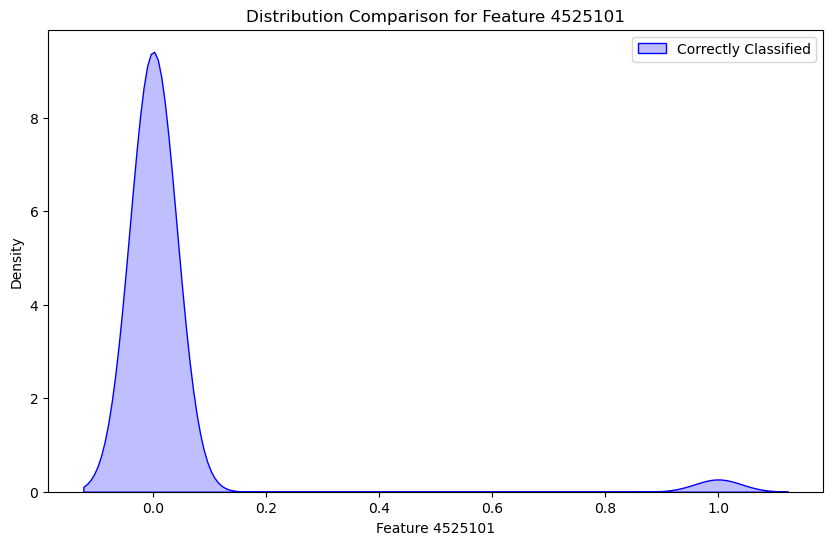

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


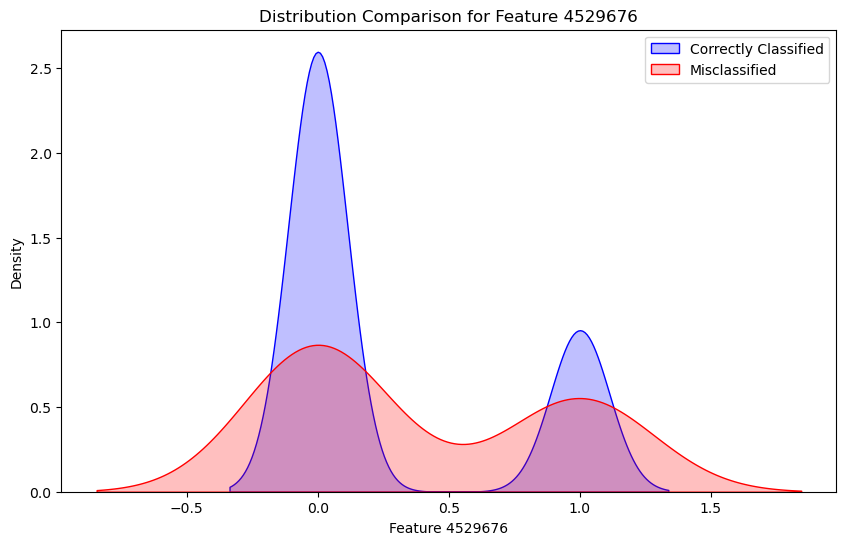

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


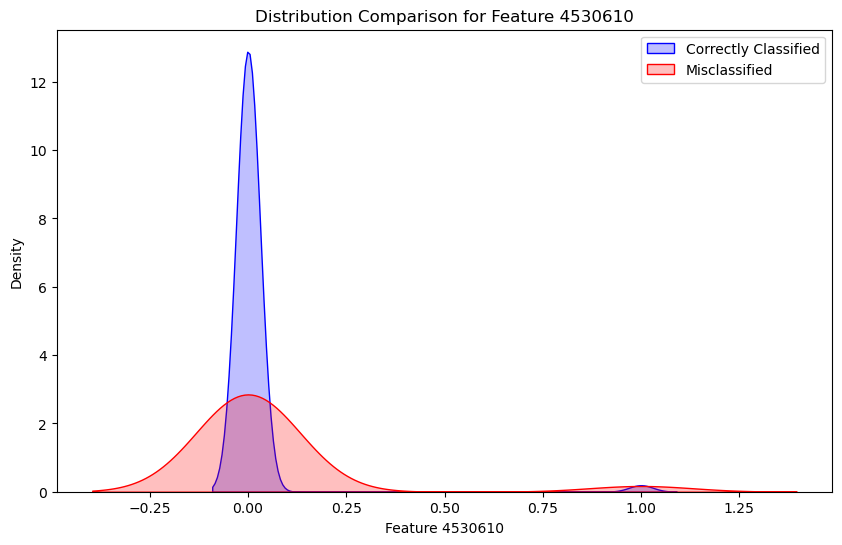

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


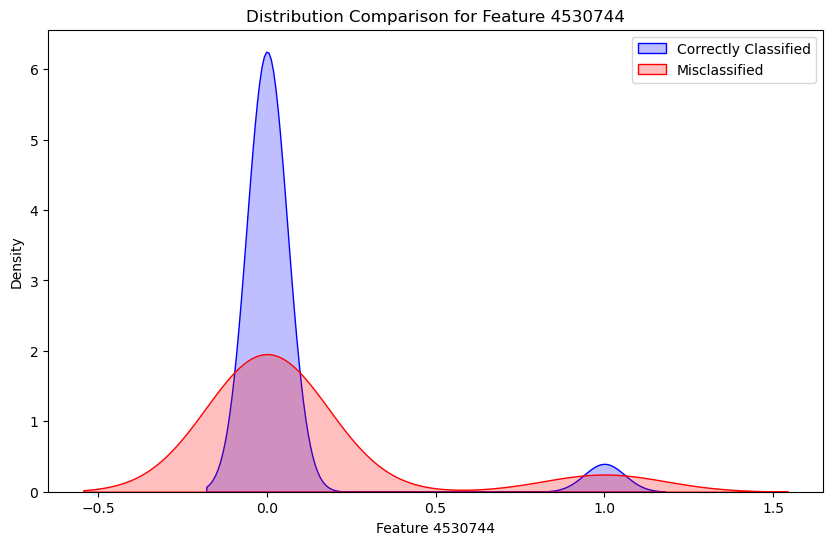

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


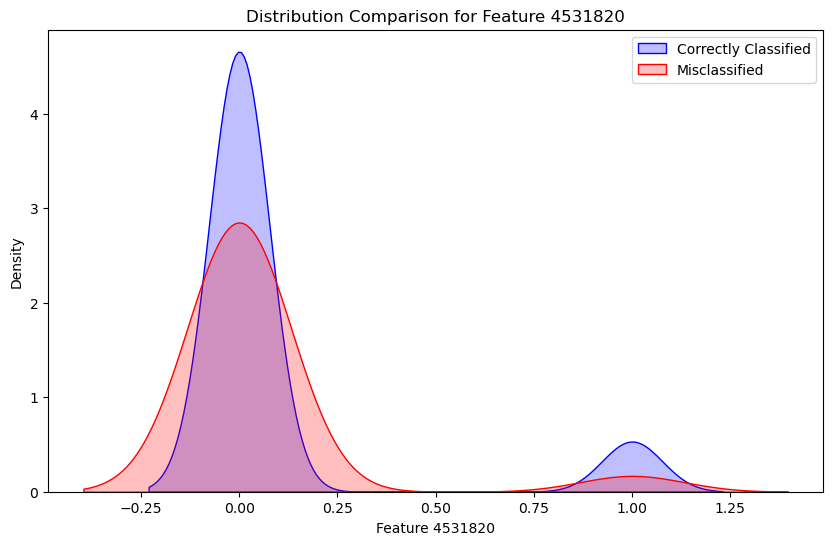

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


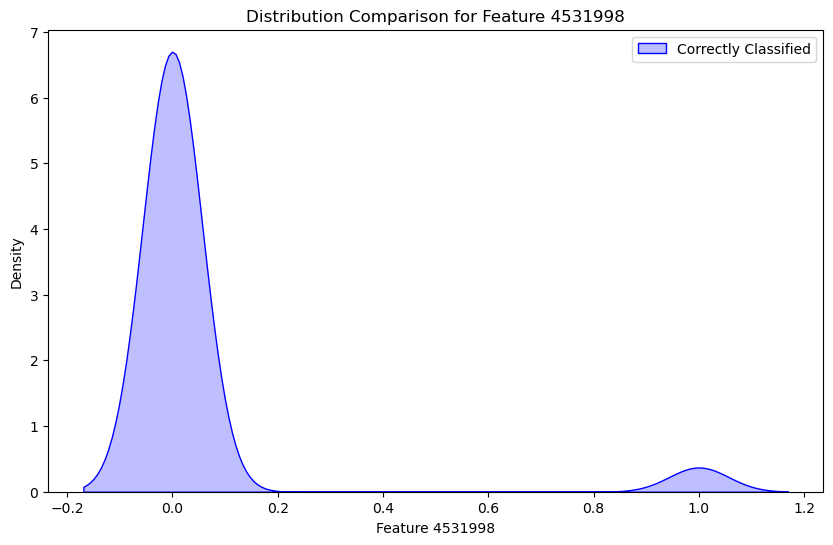

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


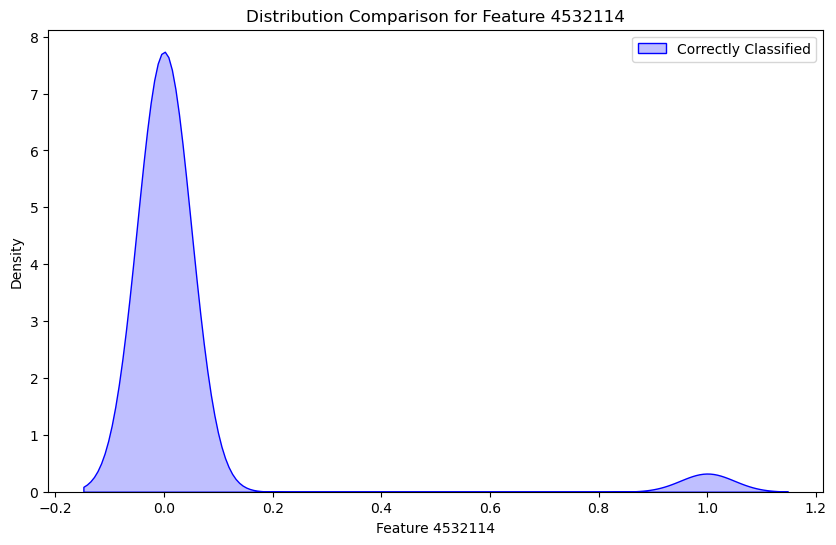

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


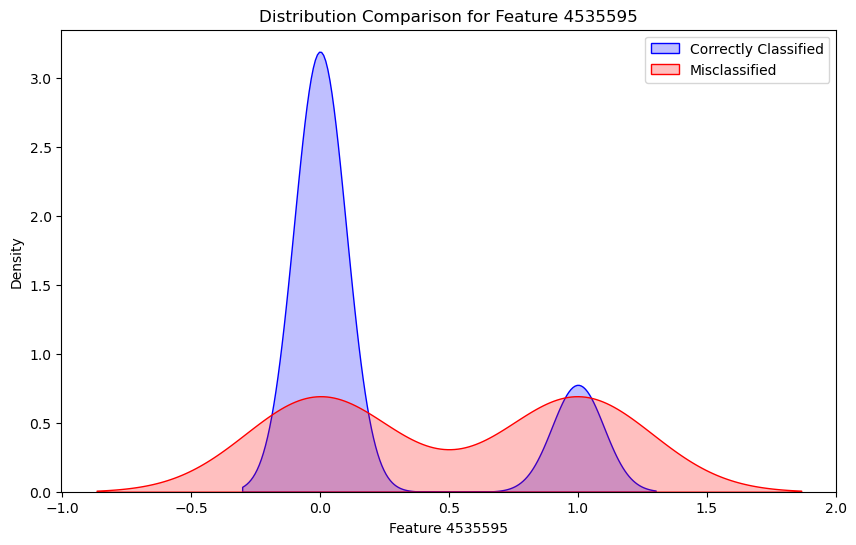

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


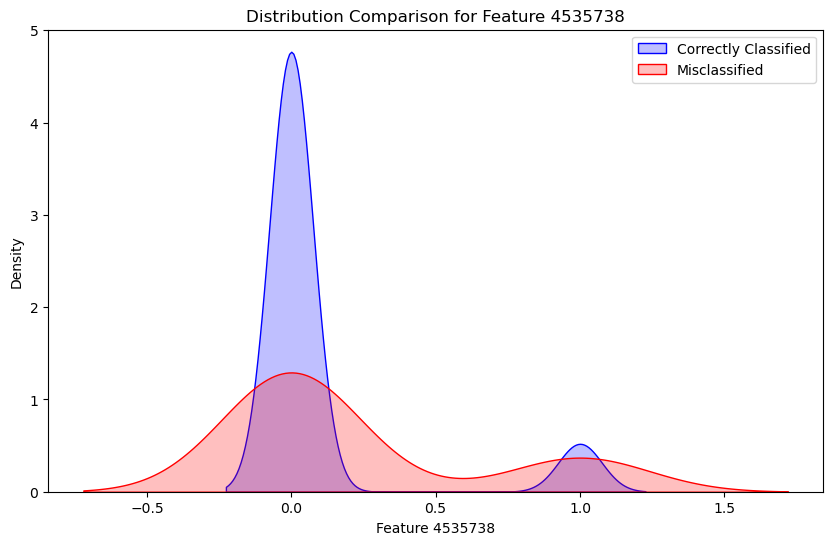

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


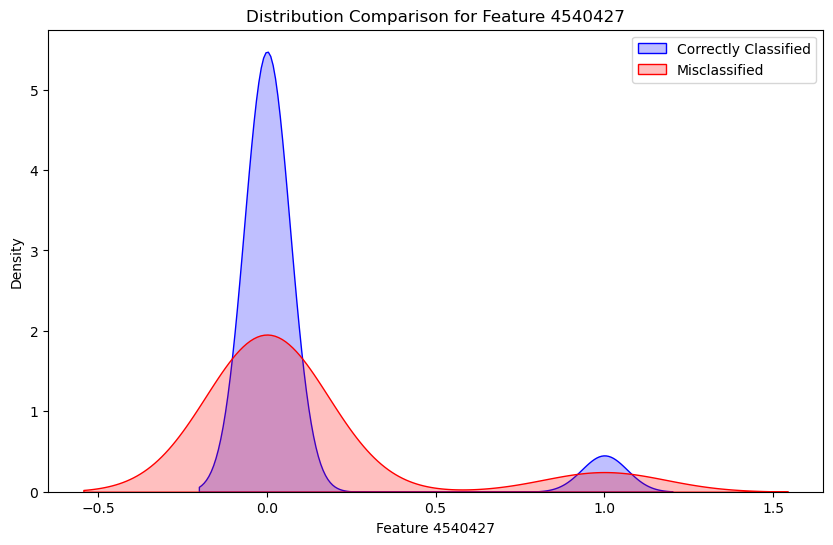

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


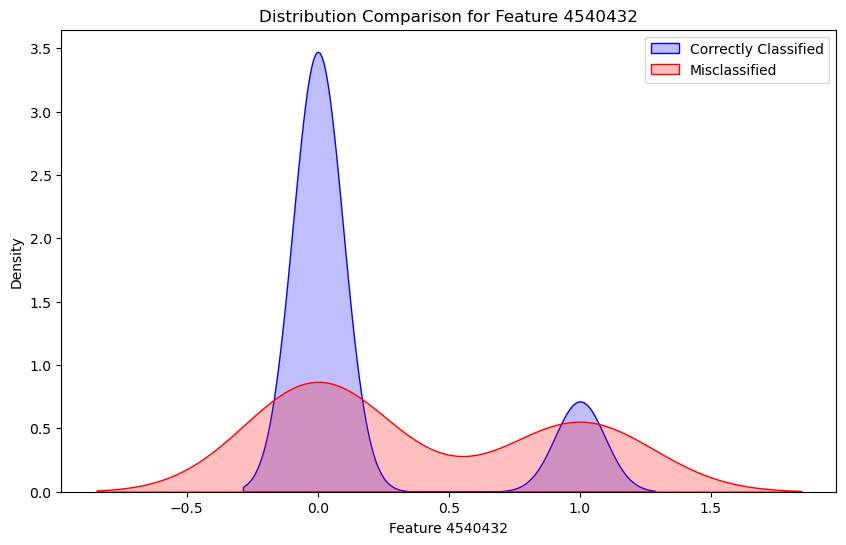

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


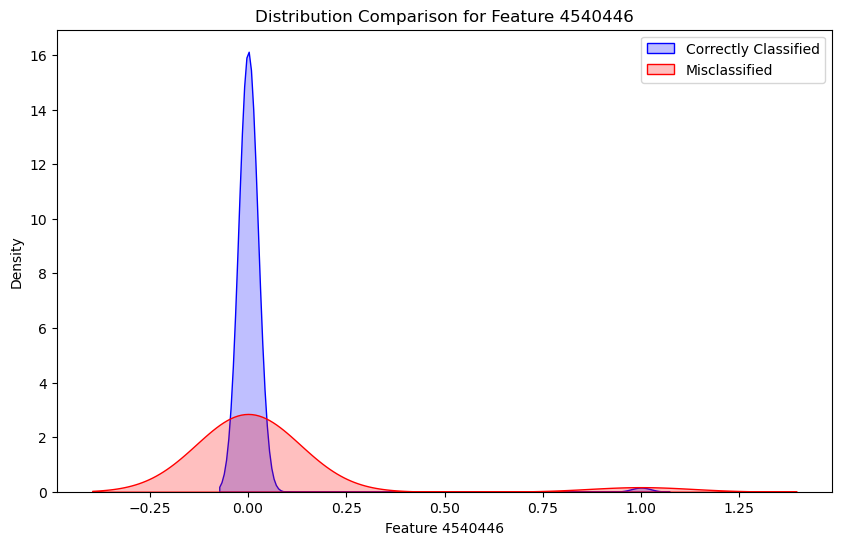

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


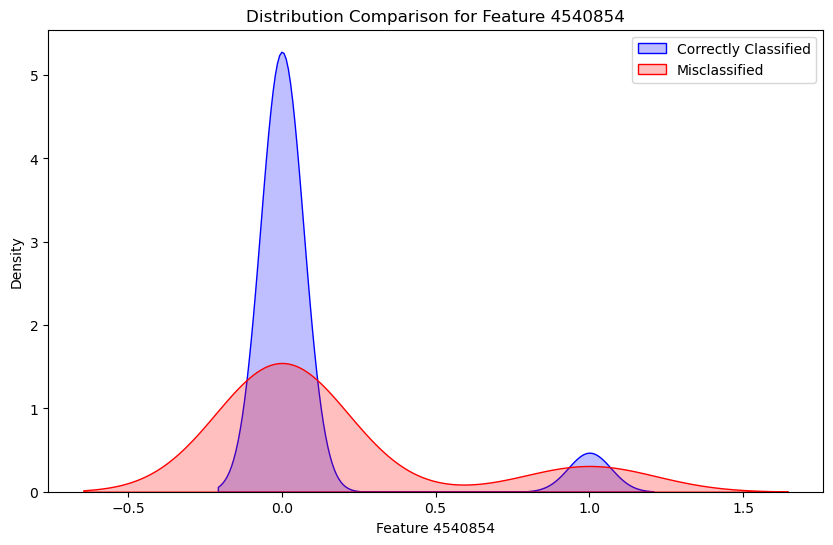

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:12: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kde

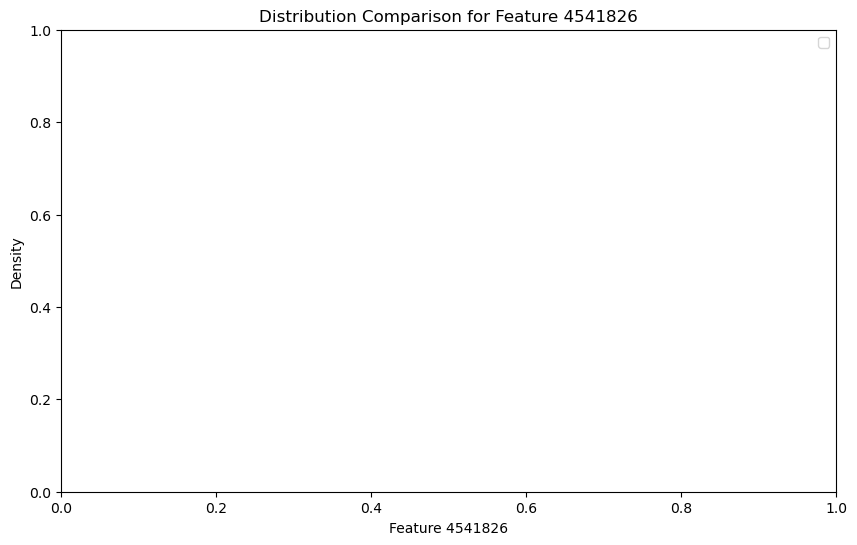

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


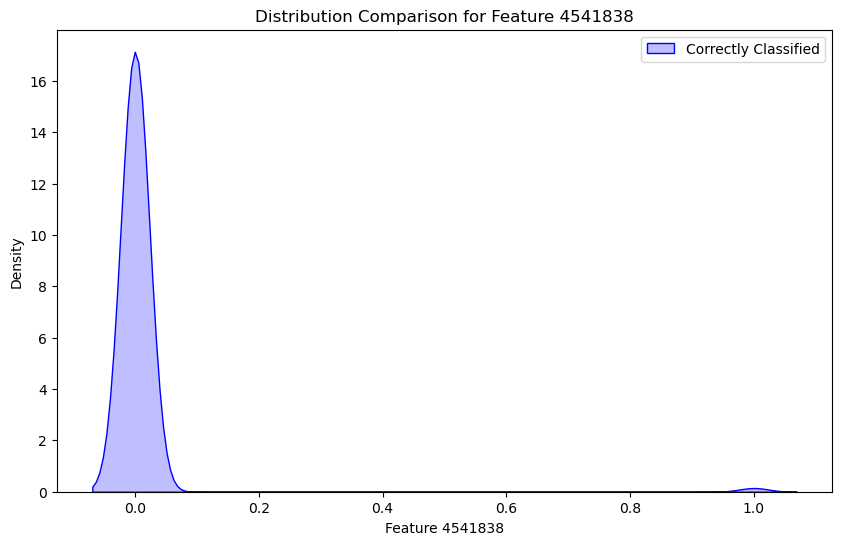

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


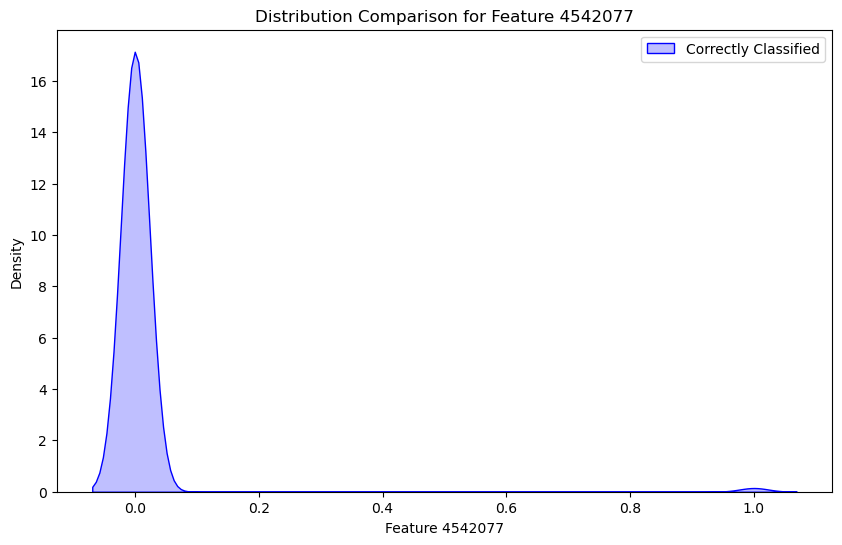

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


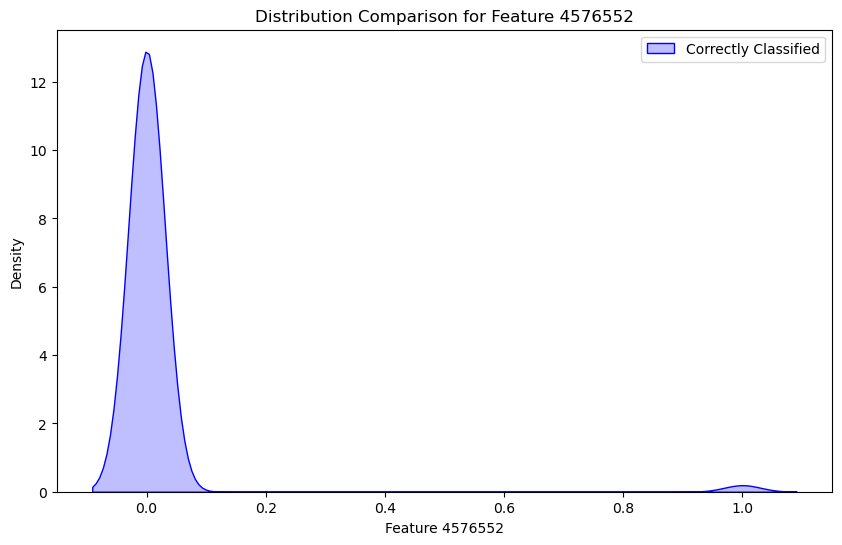

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


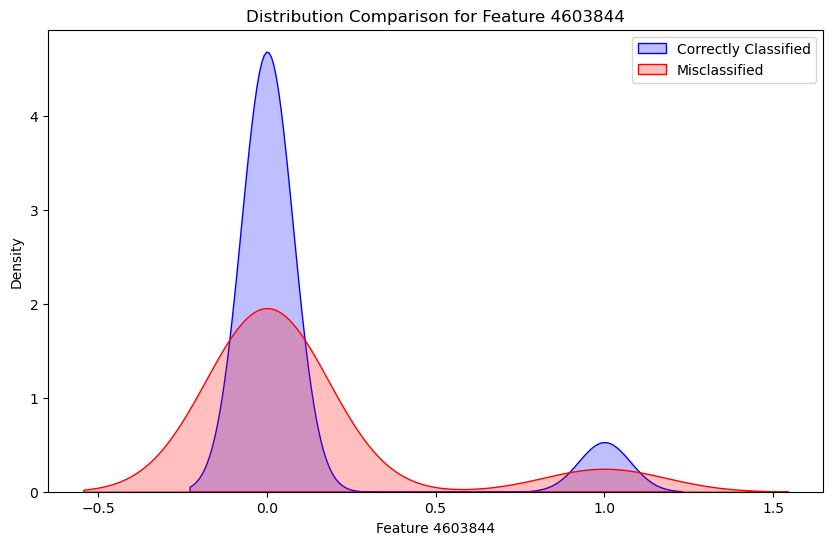

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


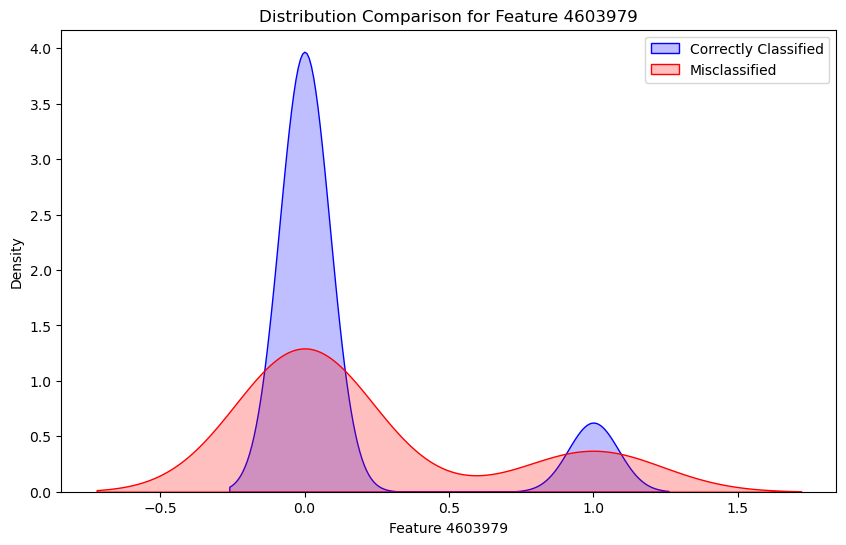

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:12: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kde

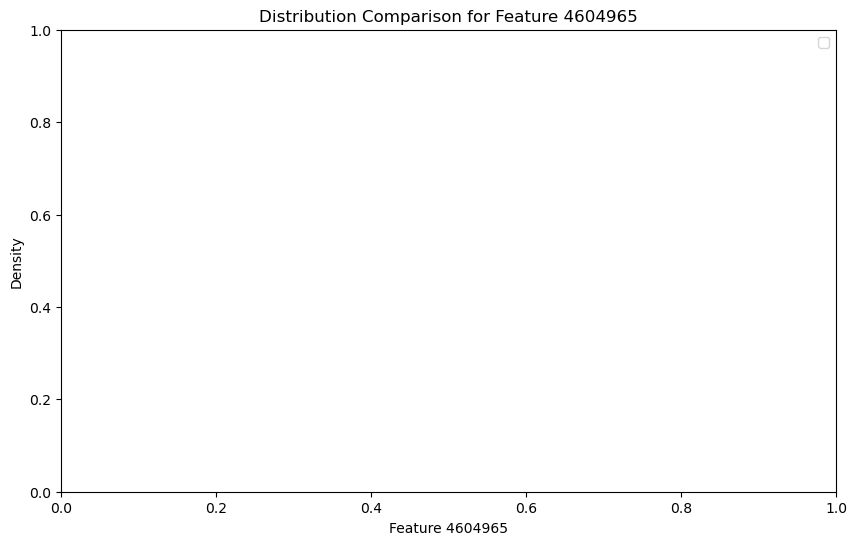

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


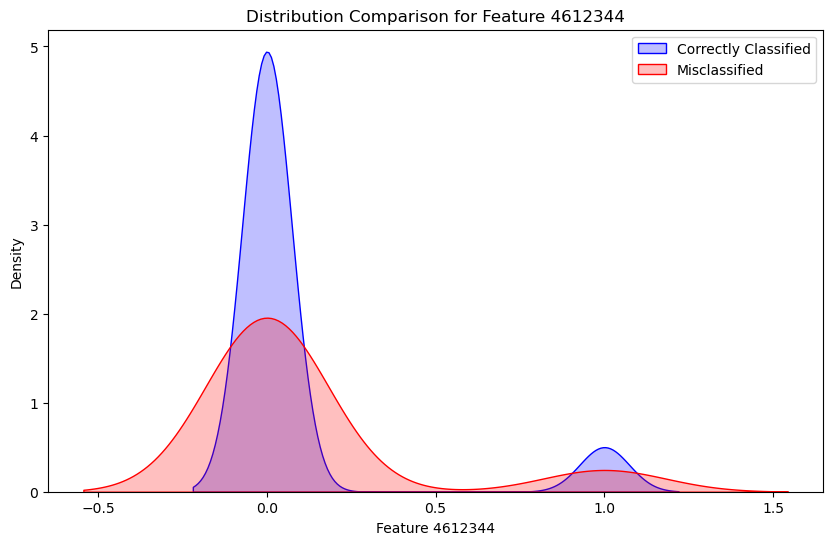

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


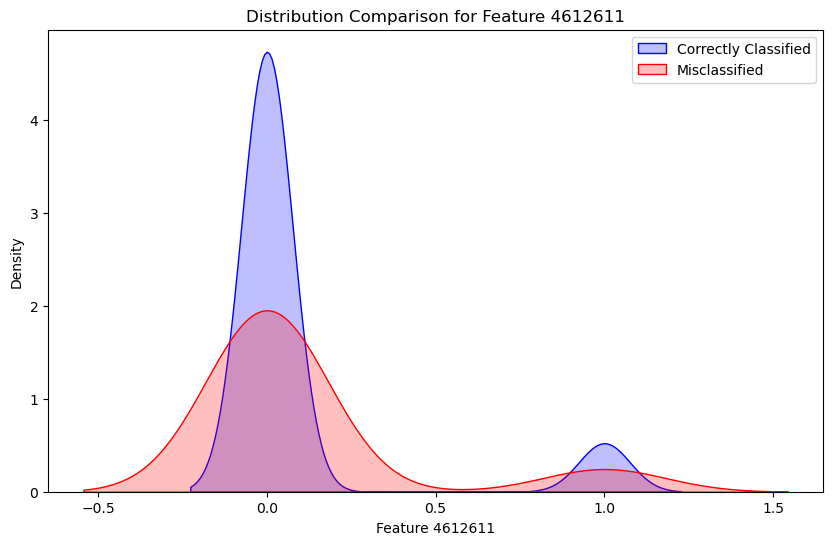

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


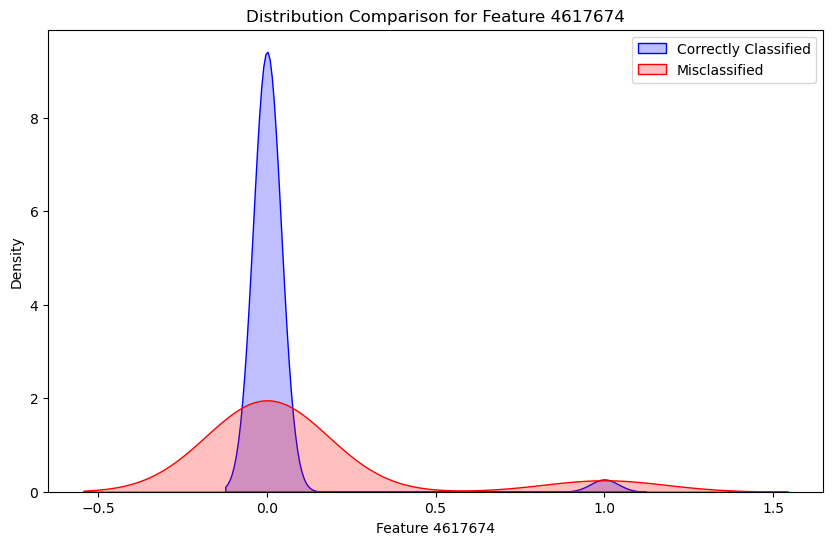

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


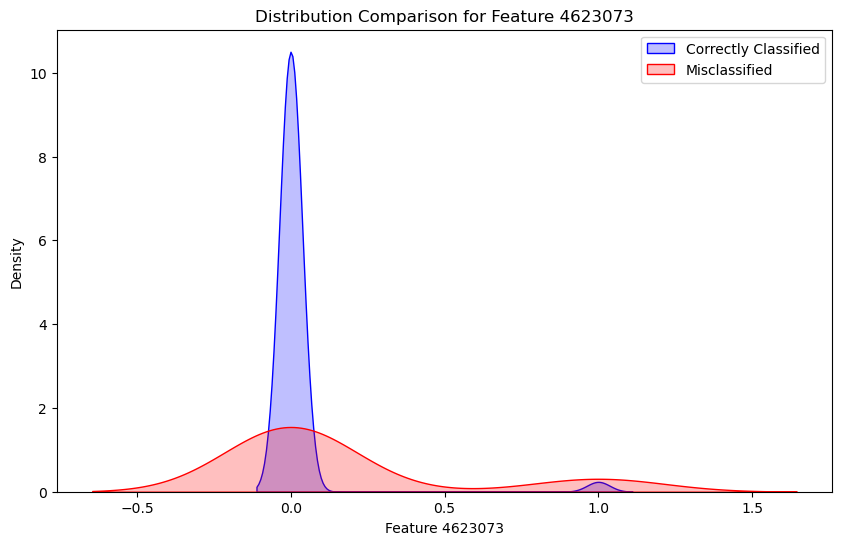

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


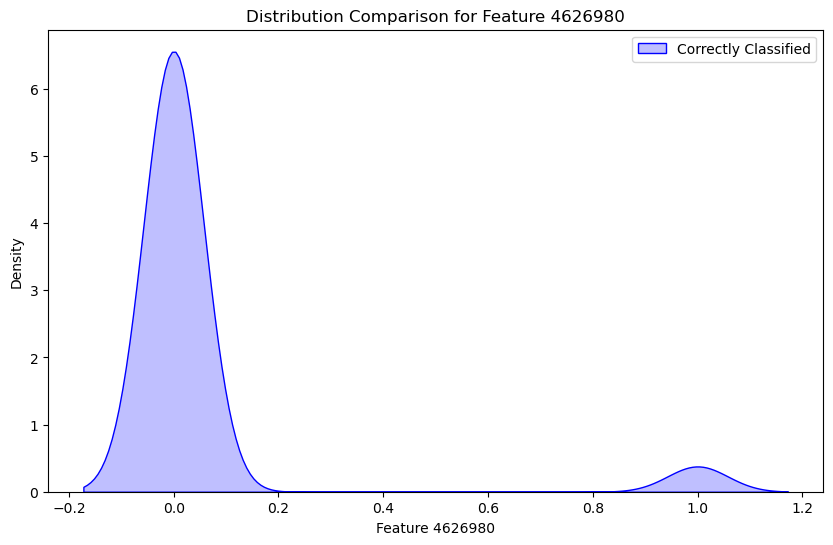

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


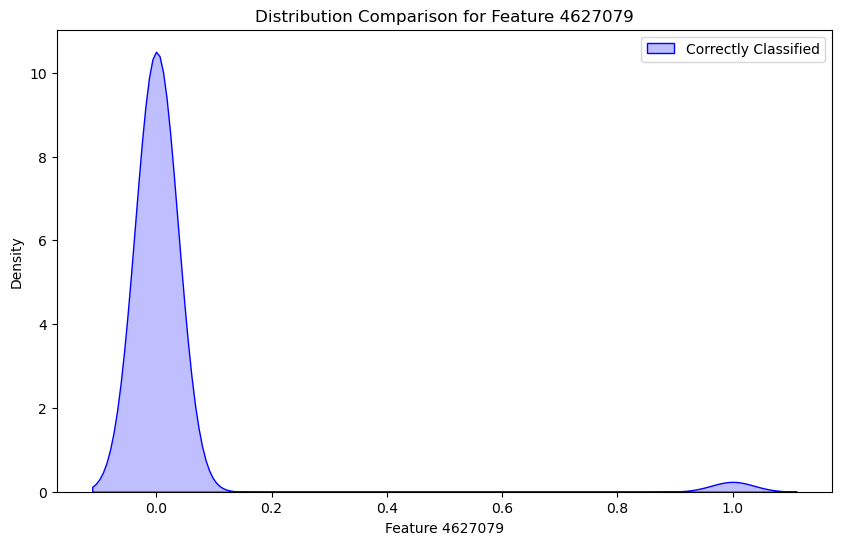

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


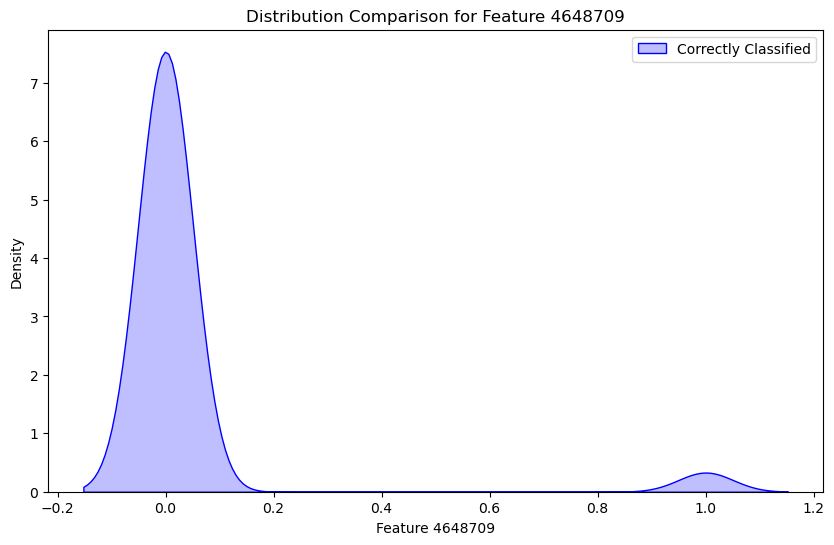

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


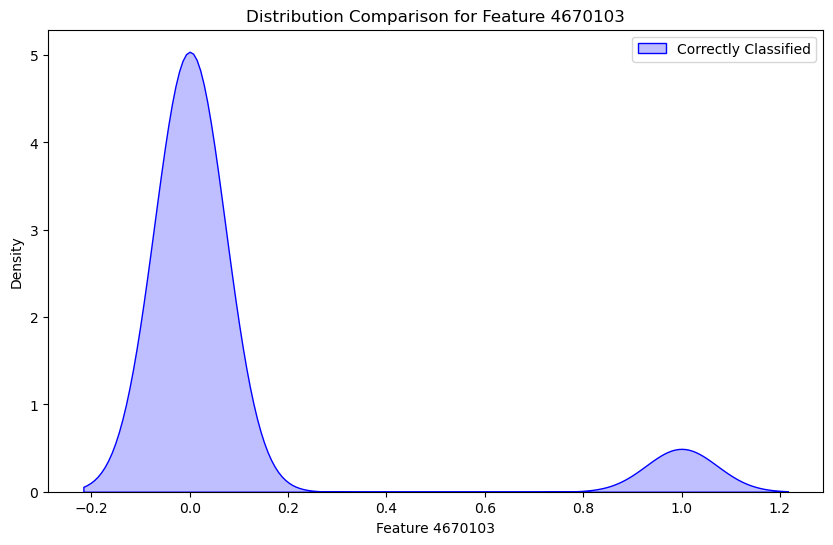

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


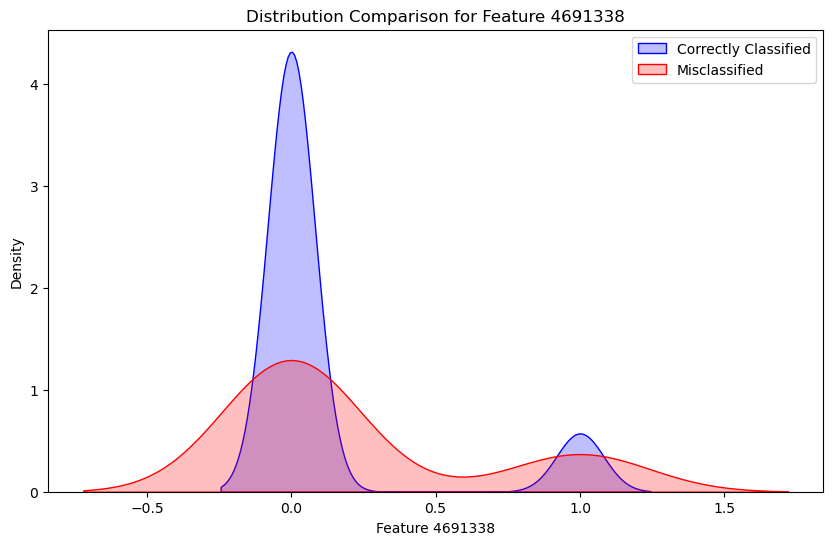

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


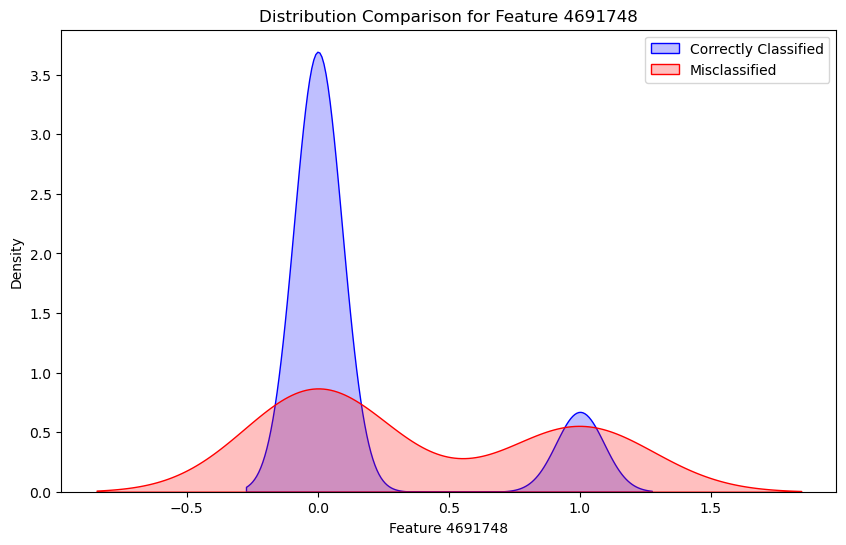

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


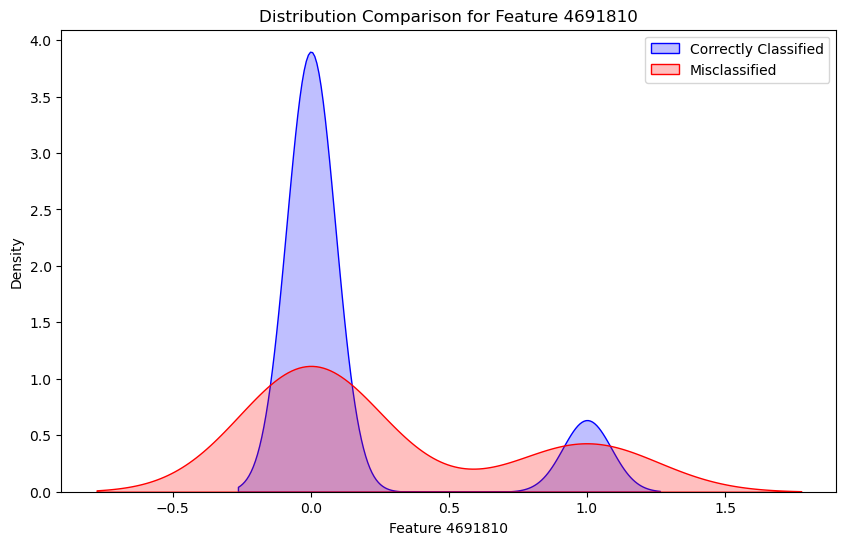

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


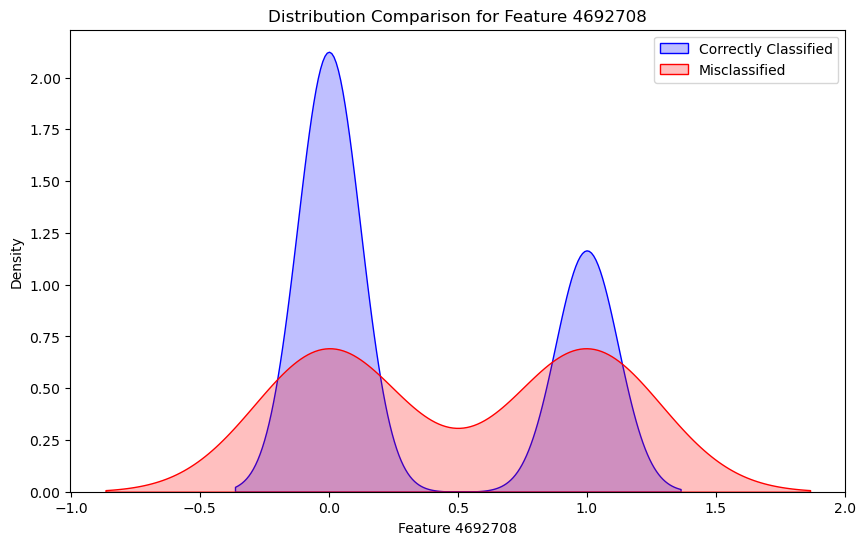

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


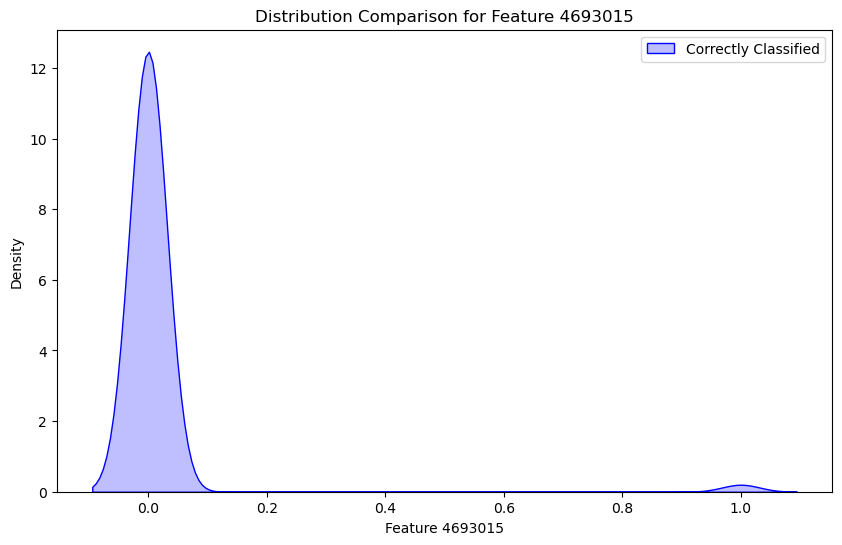

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


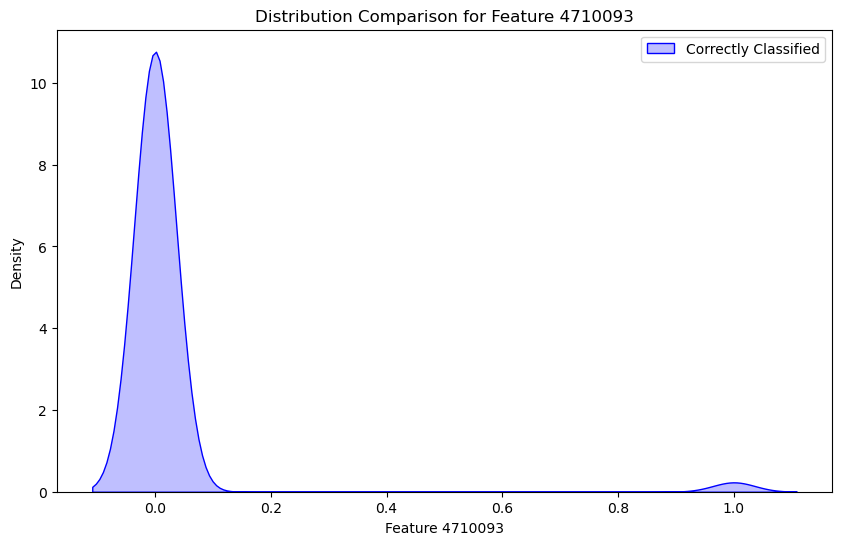

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


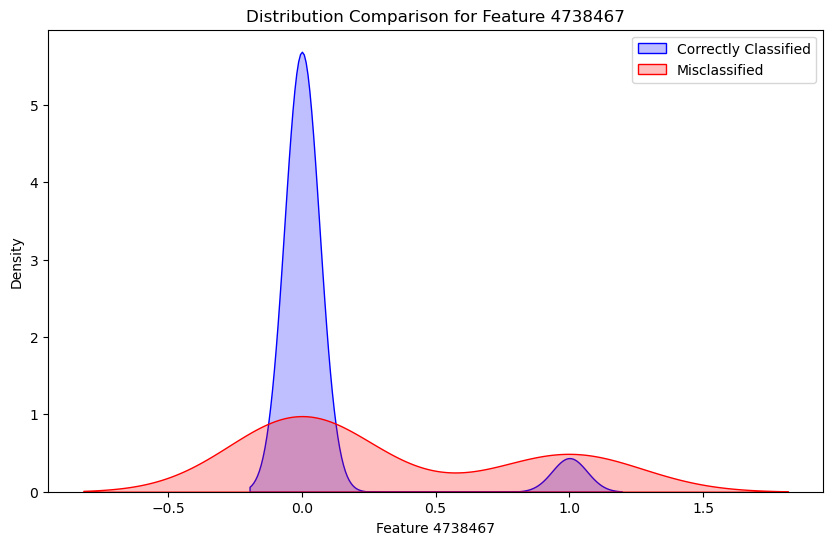

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


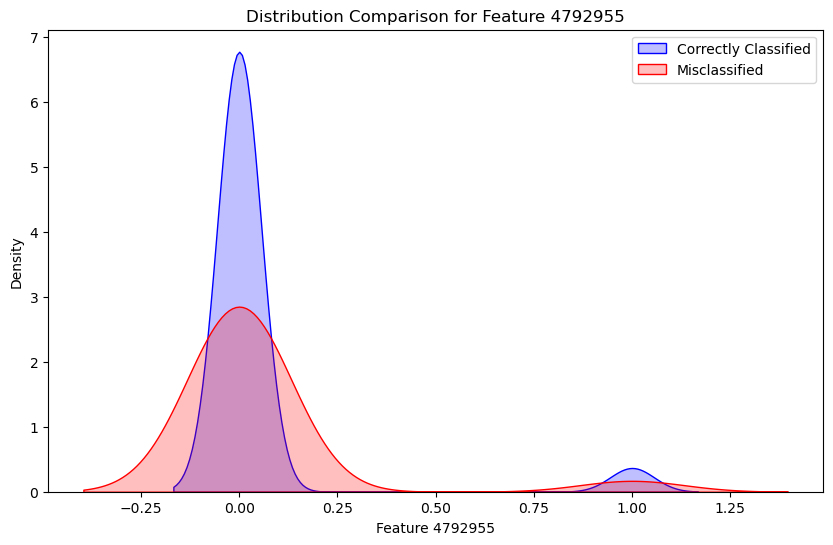

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


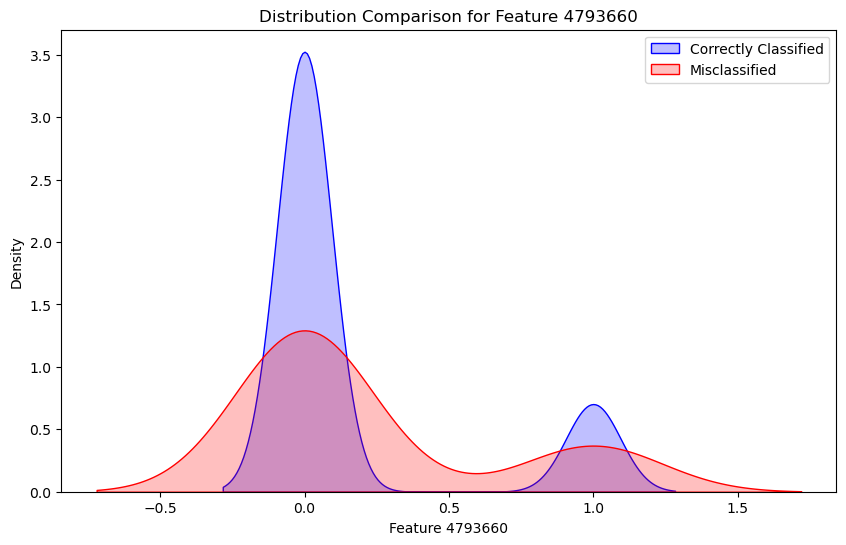

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


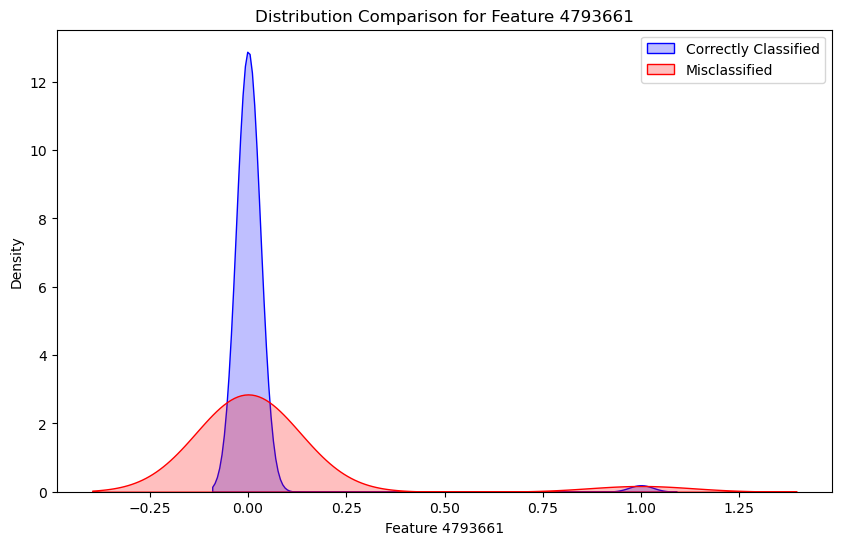

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


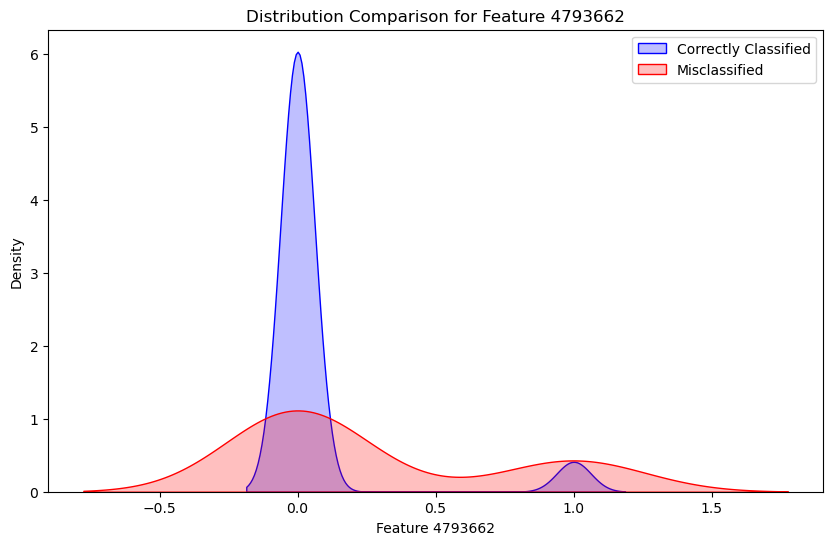

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


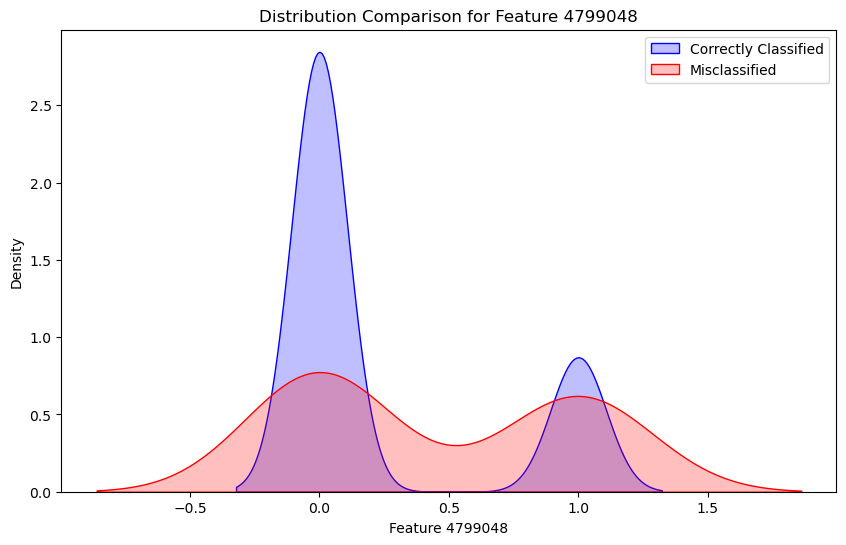

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


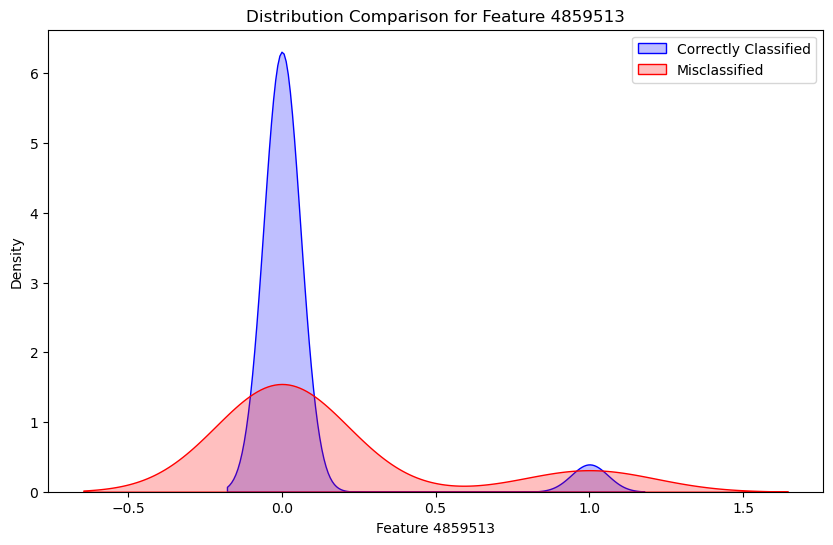

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


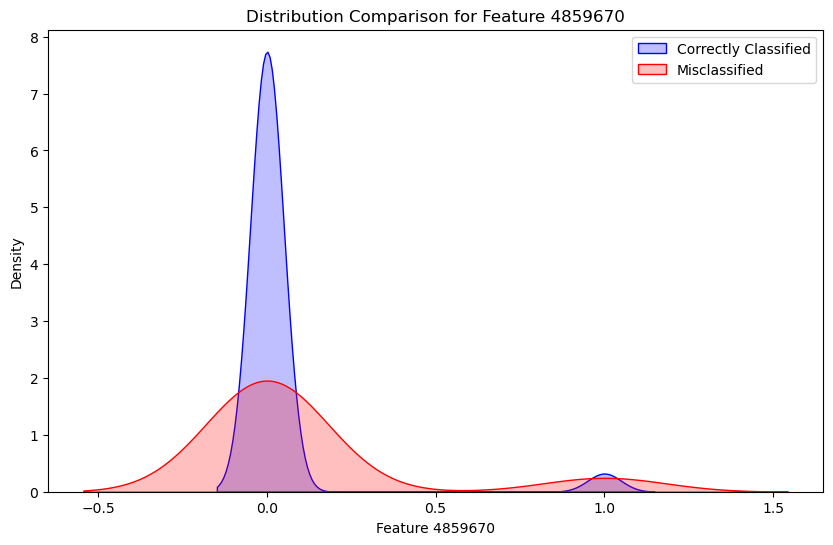

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


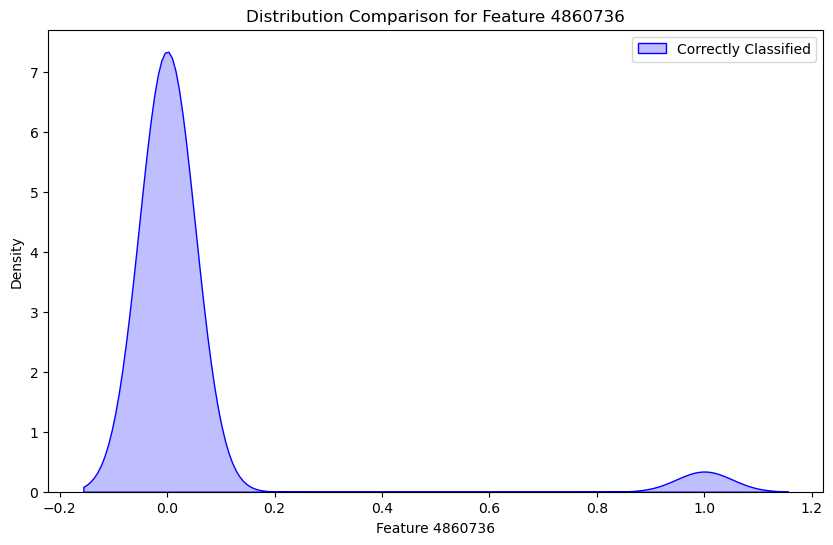

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


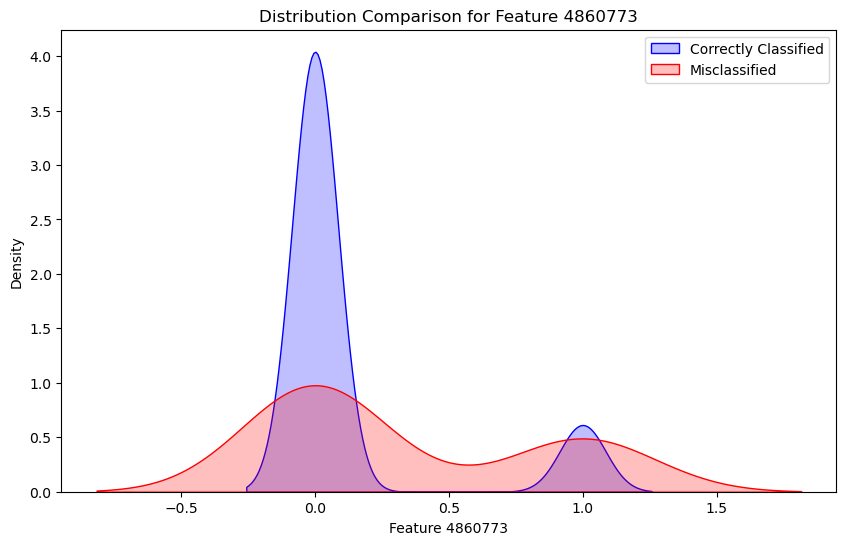

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


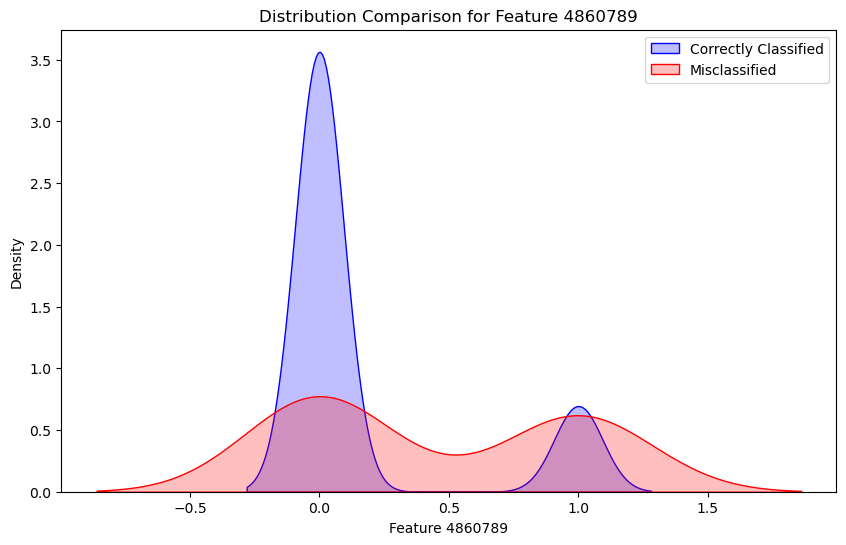

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


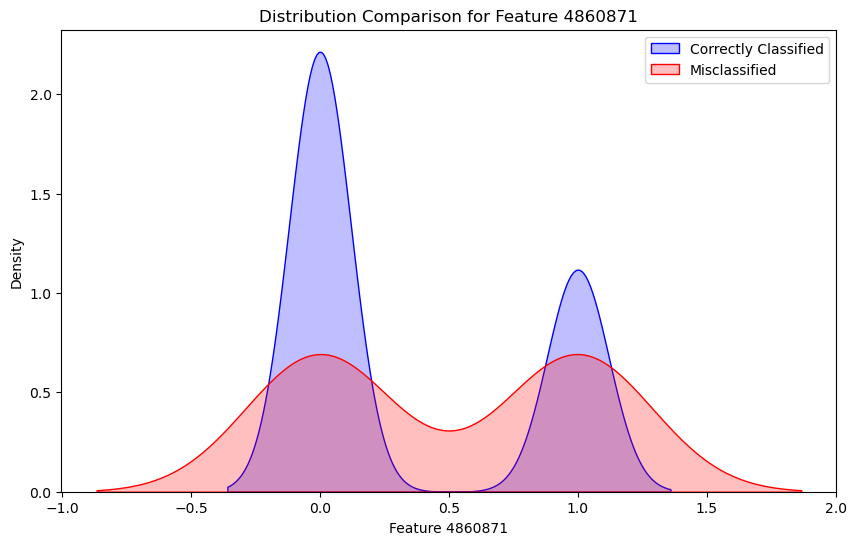

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


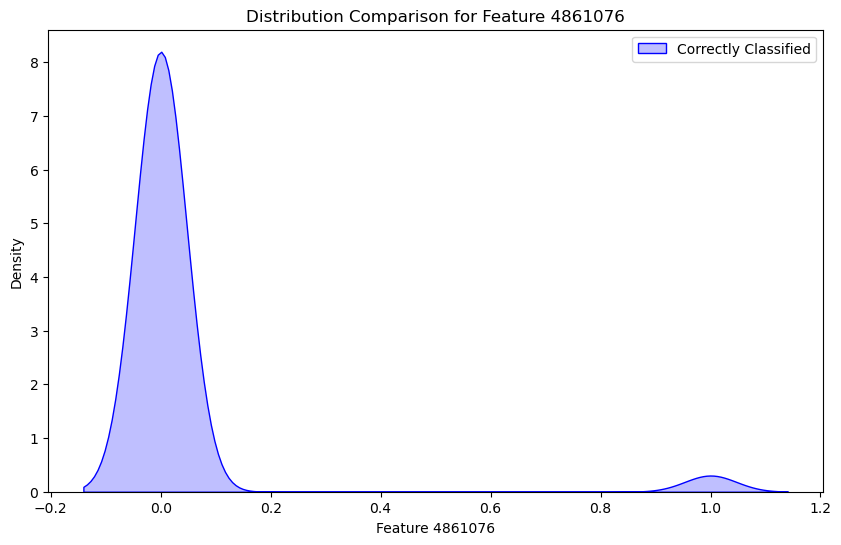

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


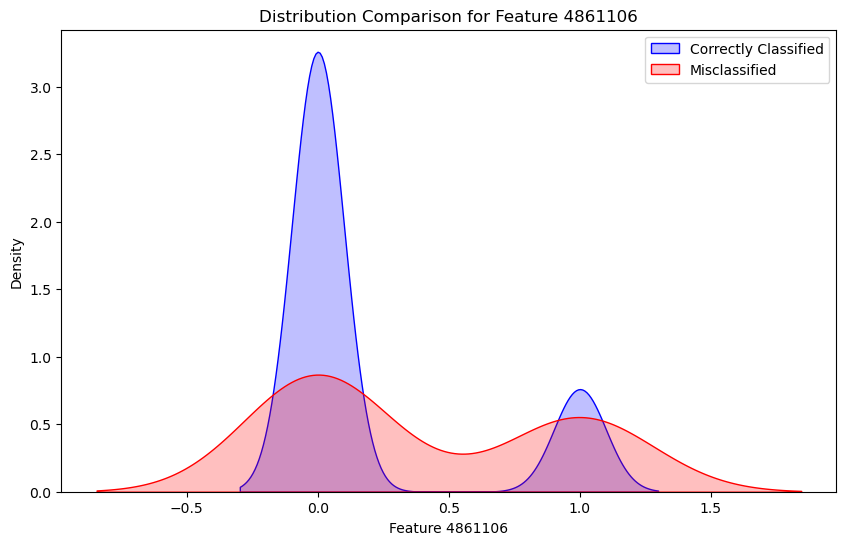

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


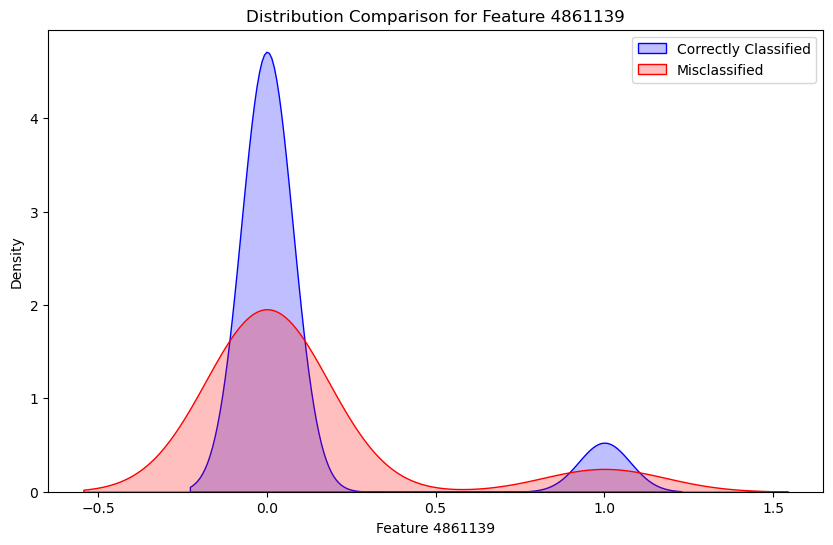

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


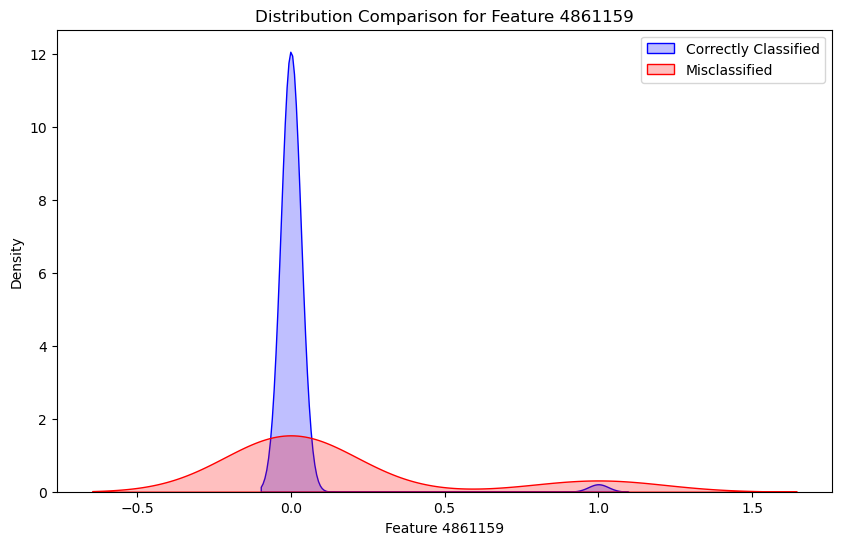

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


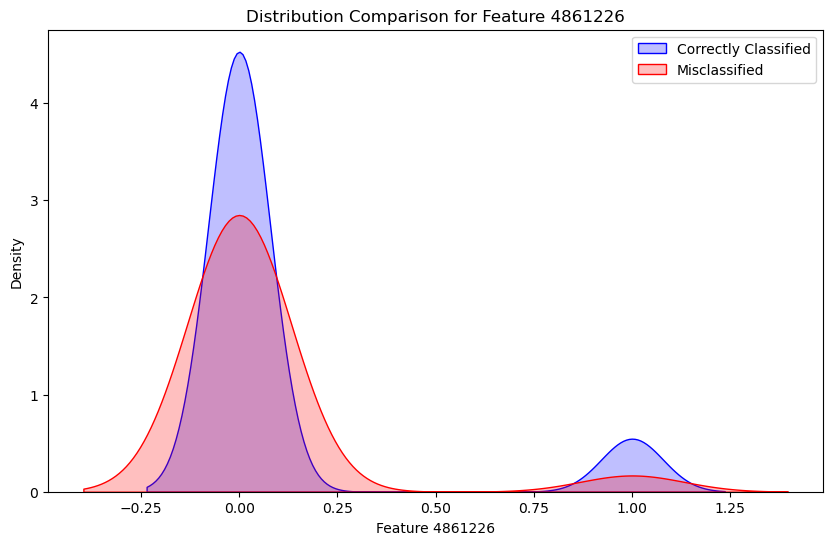

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


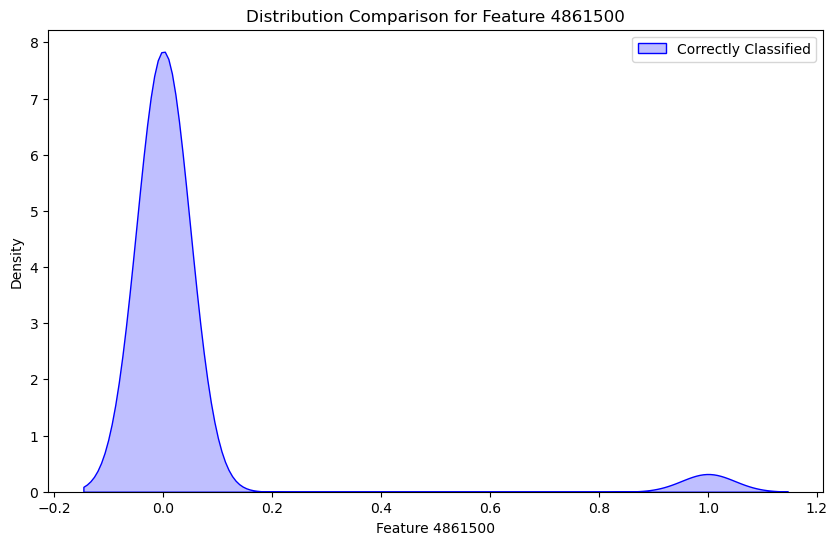

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


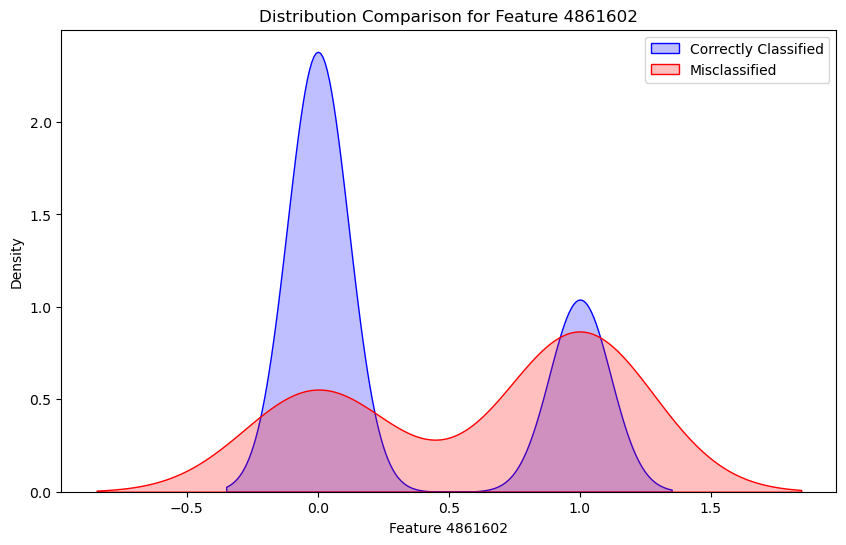

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


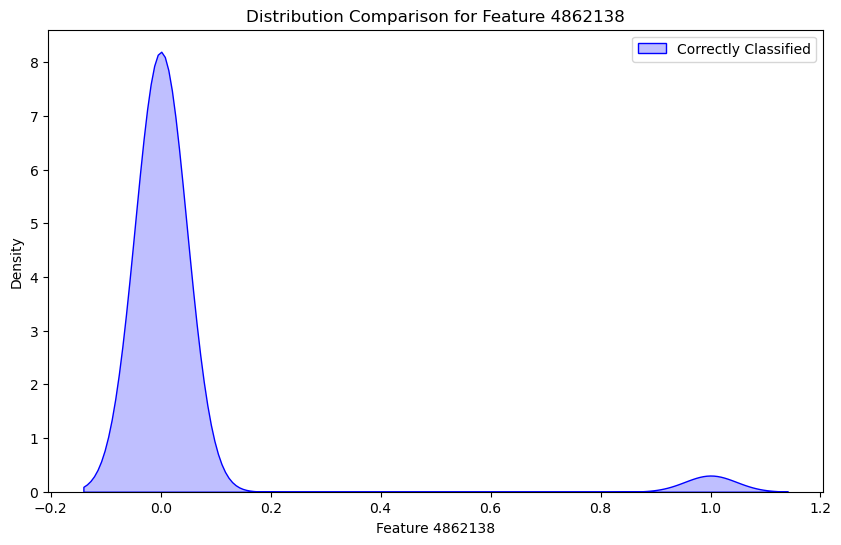

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


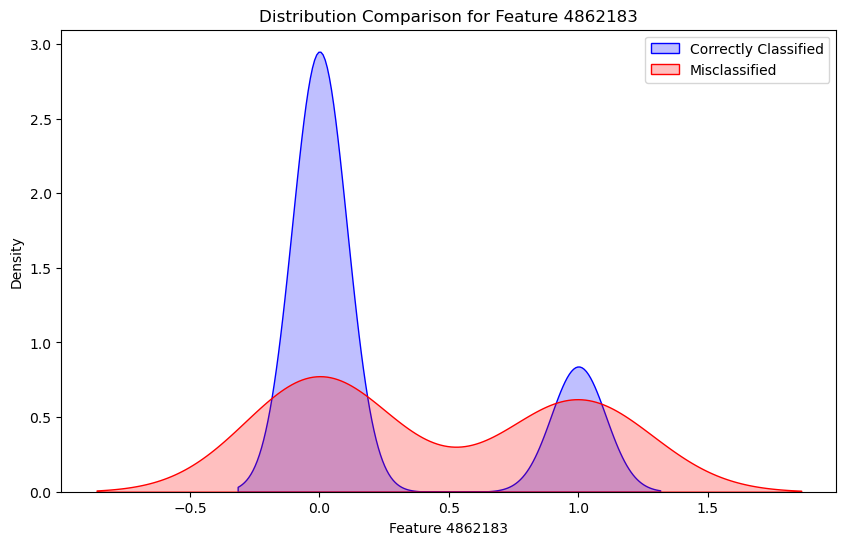

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


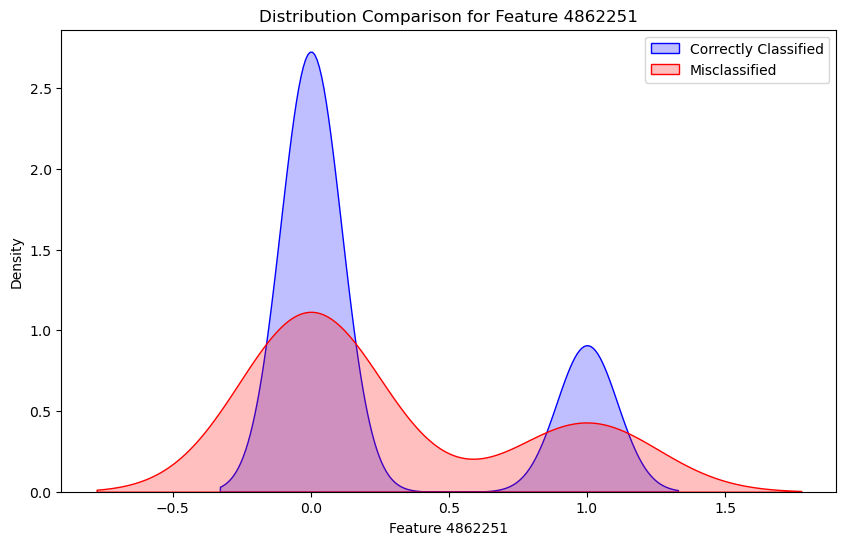

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


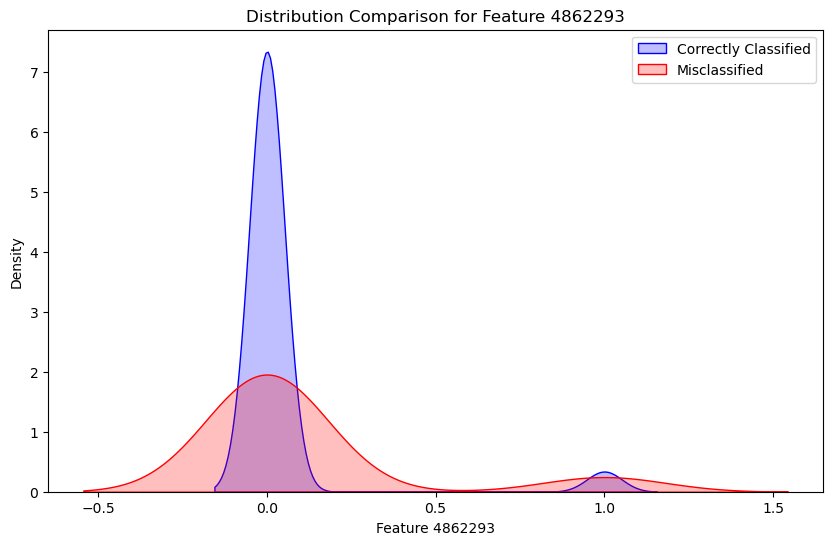

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


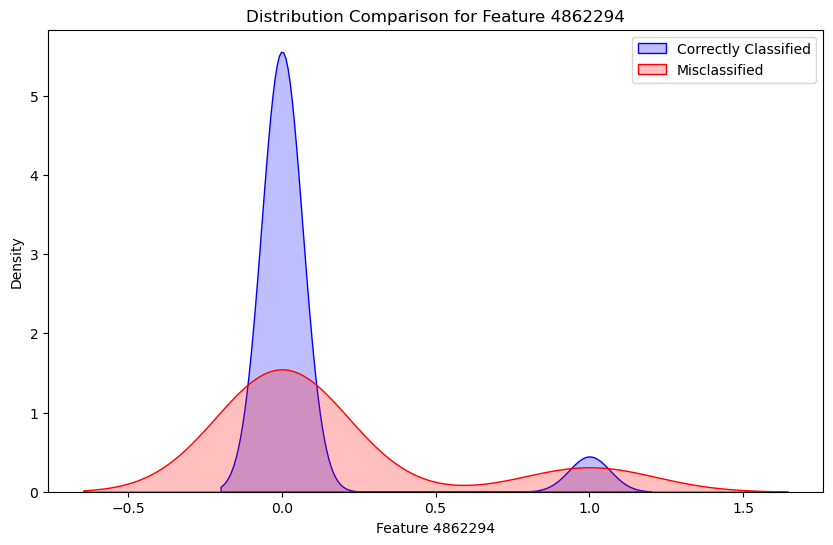

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


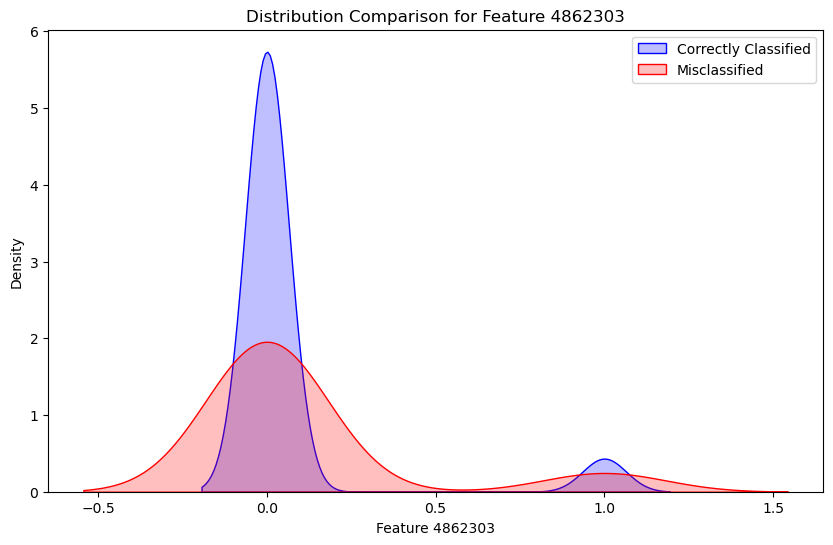

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


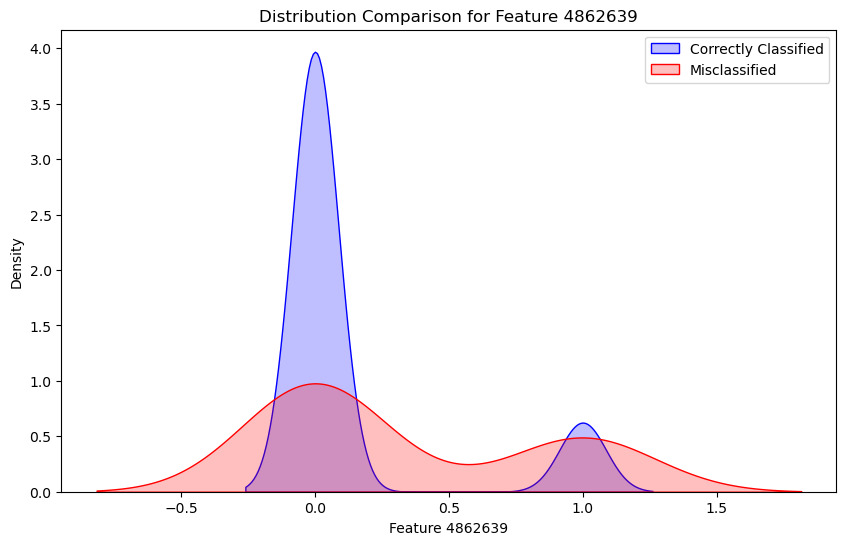

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


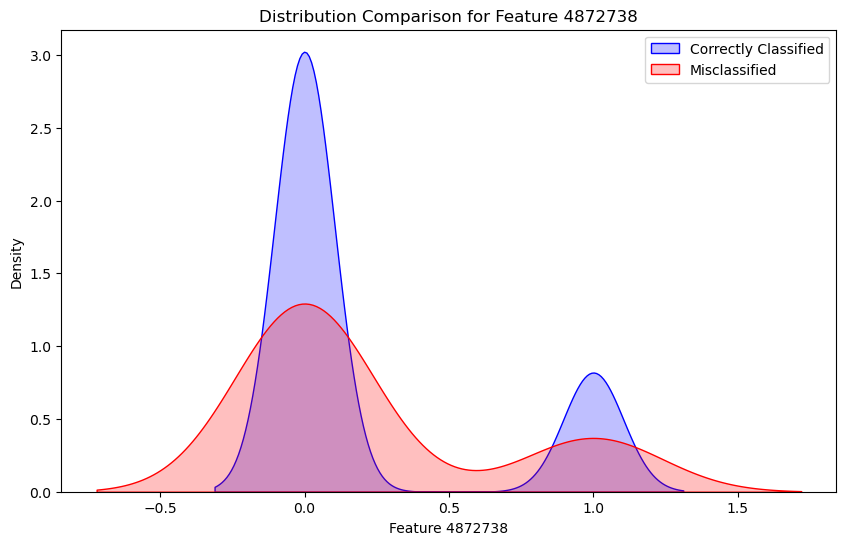

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


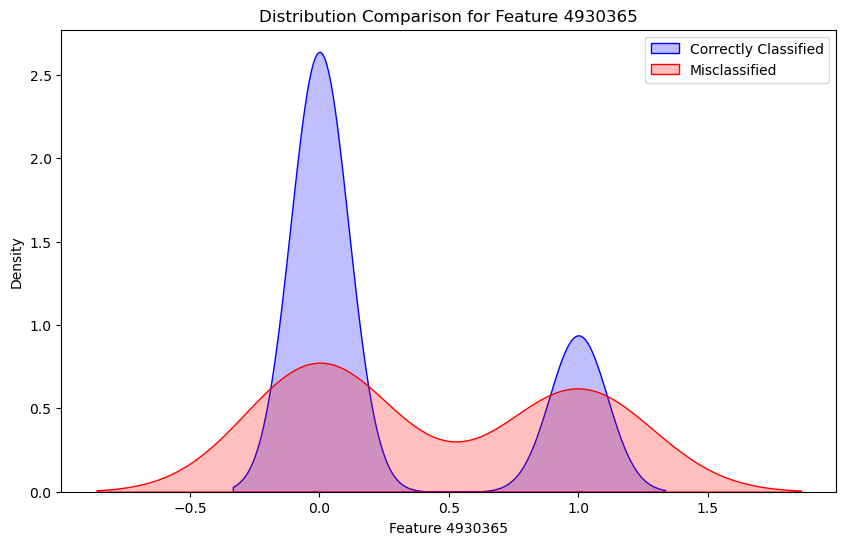

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


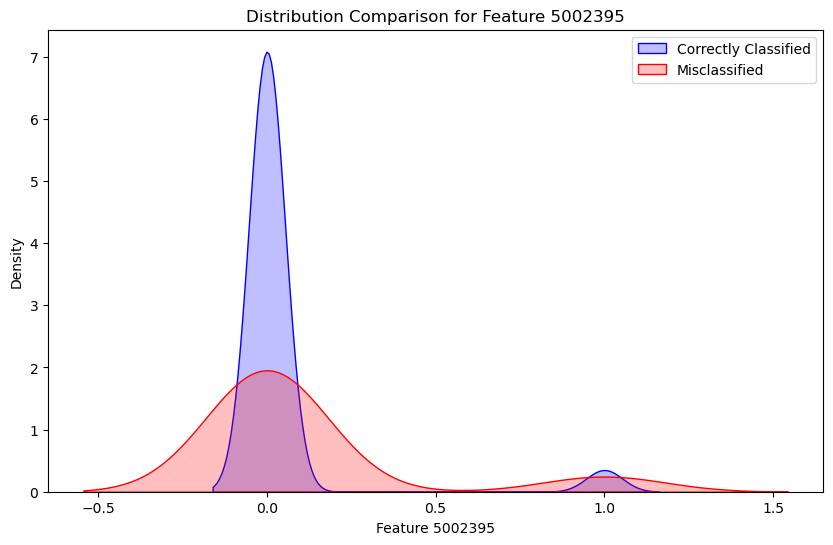

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


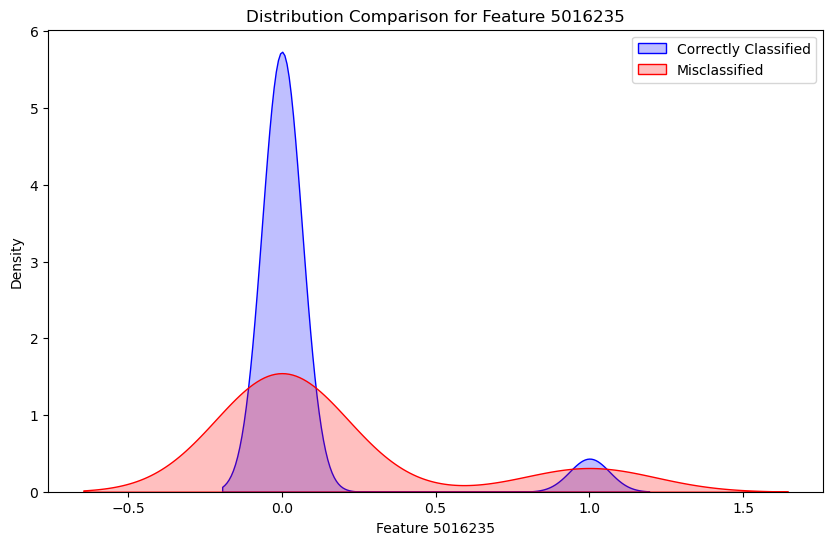

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


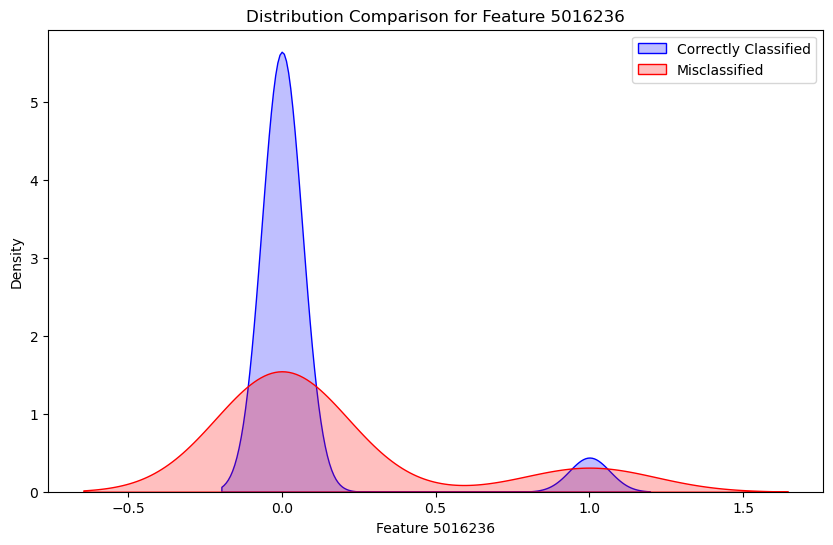

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


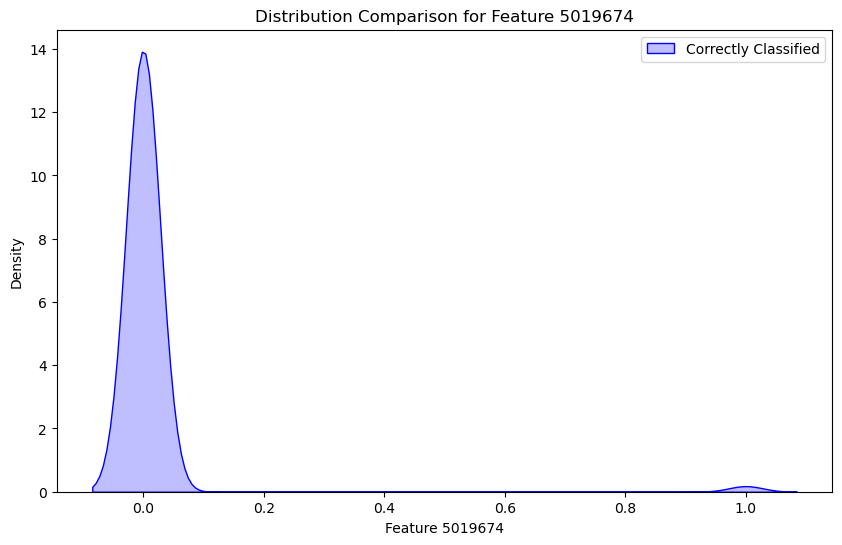

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


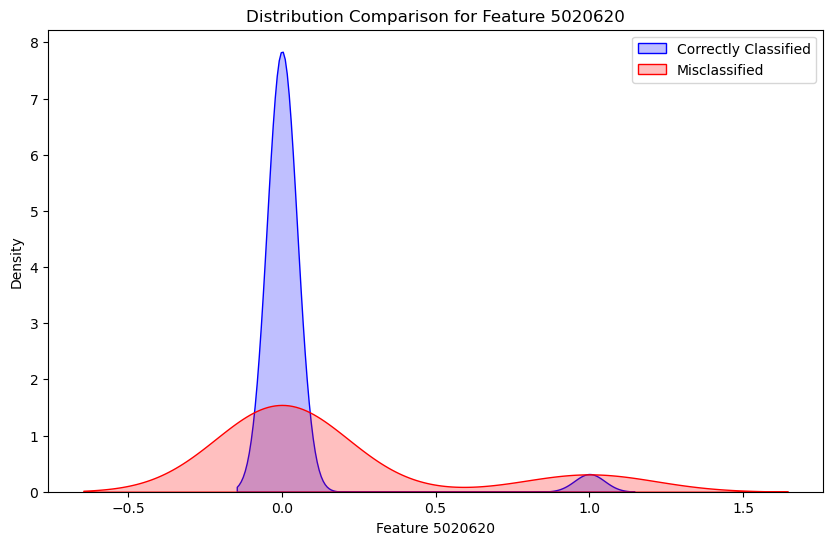

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


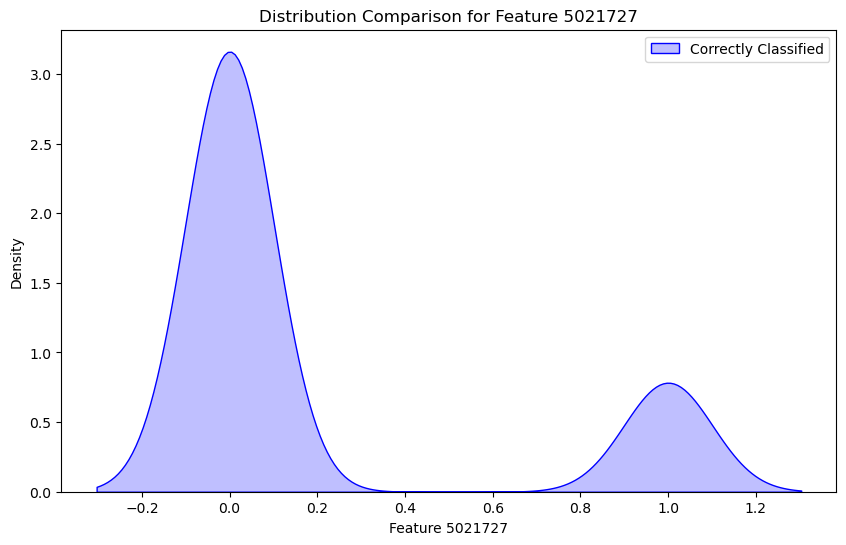

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


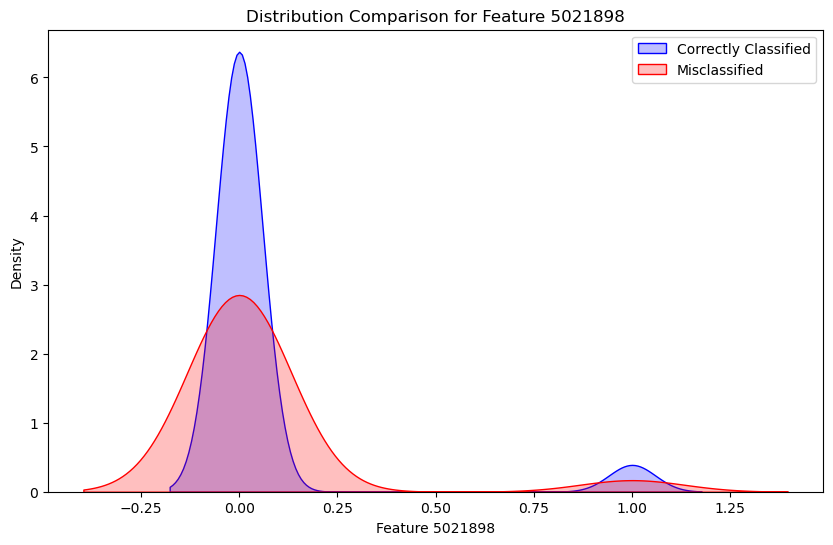

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


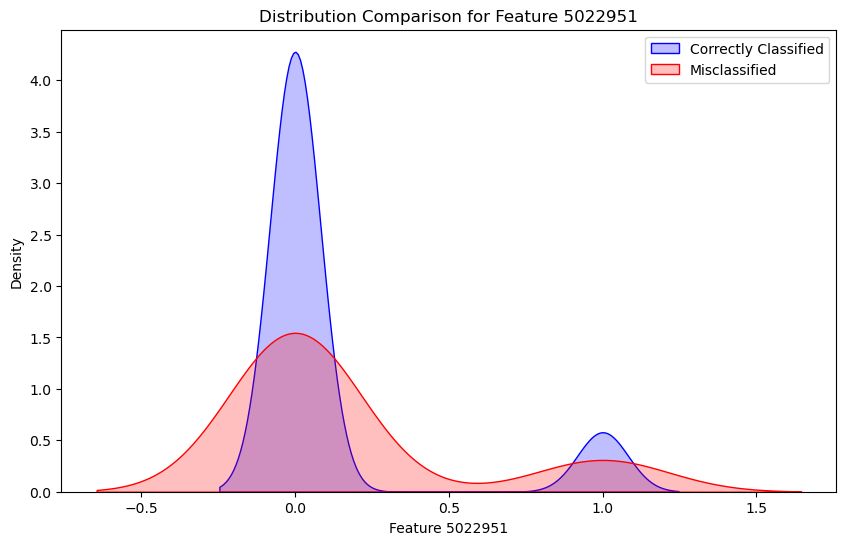

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


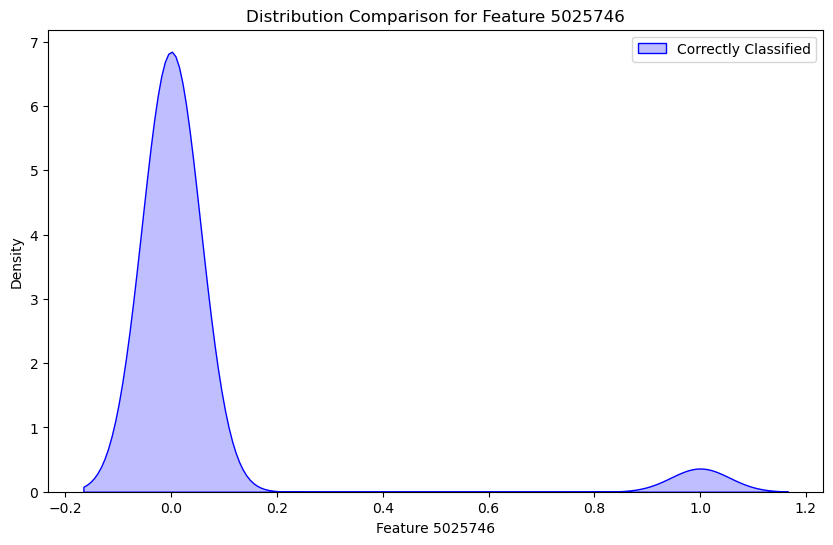

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


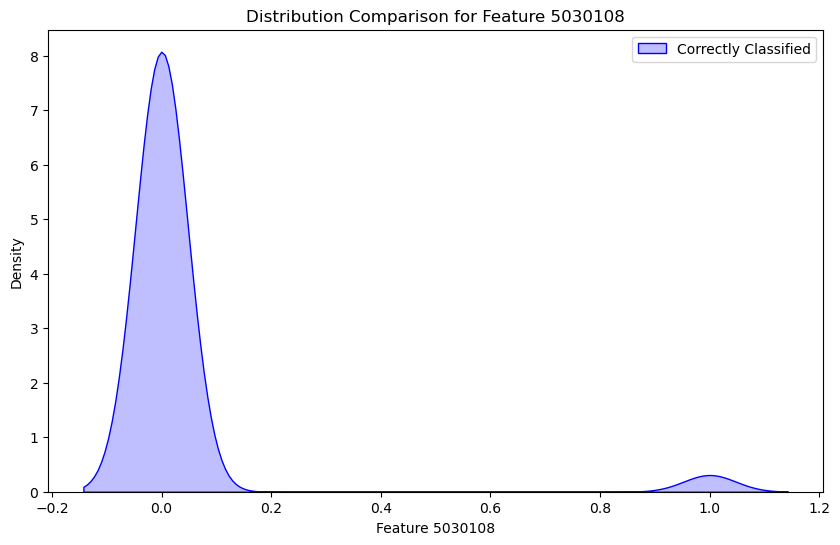

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


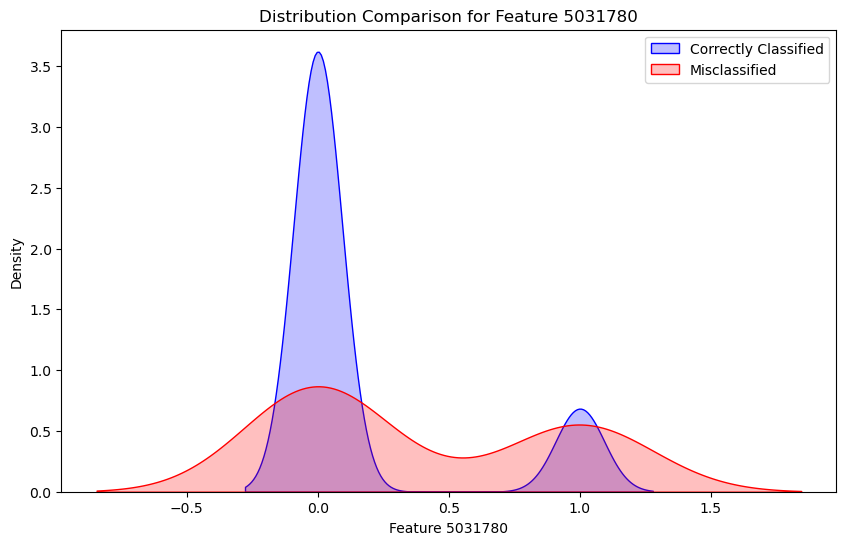

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


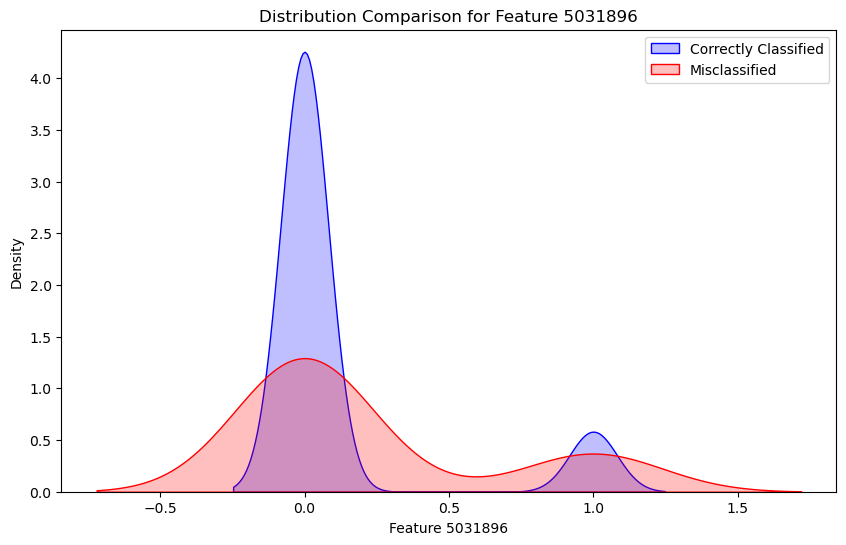

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


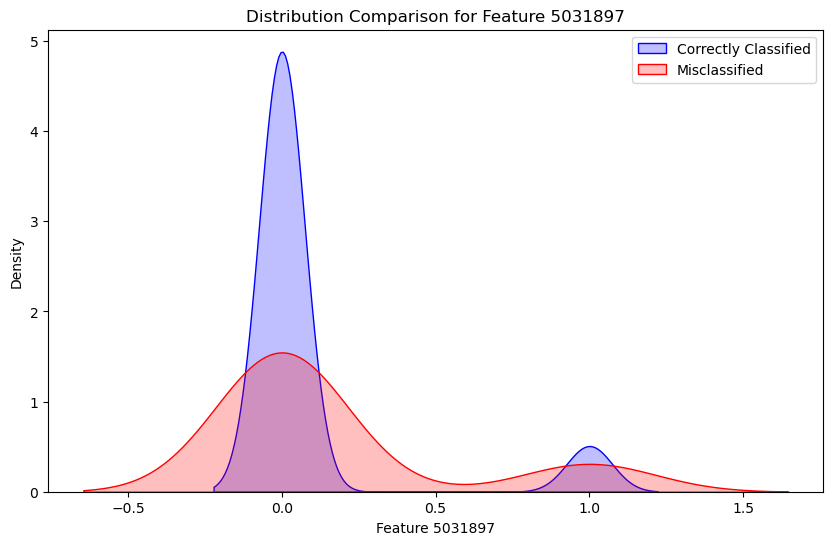

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


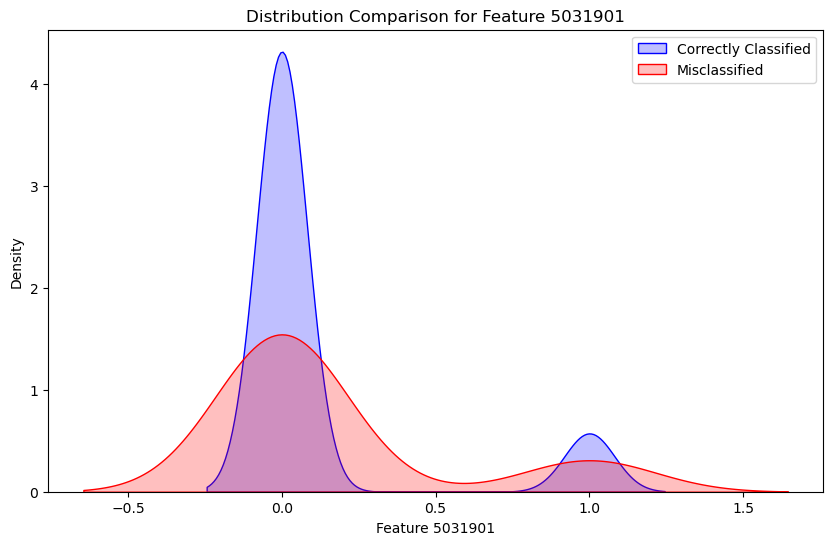

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


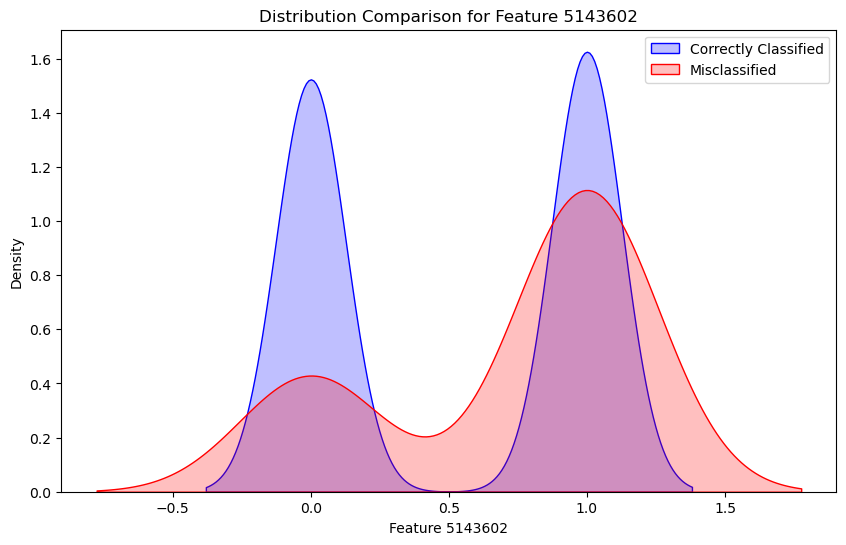

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


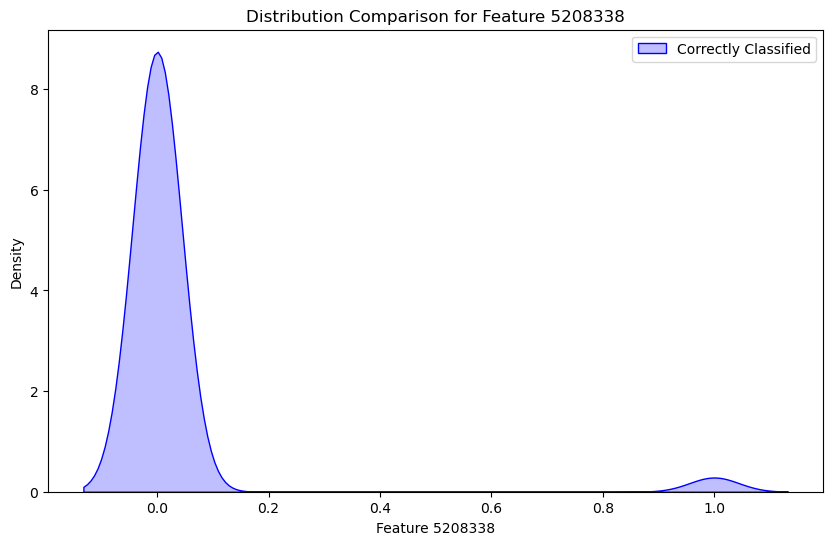

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


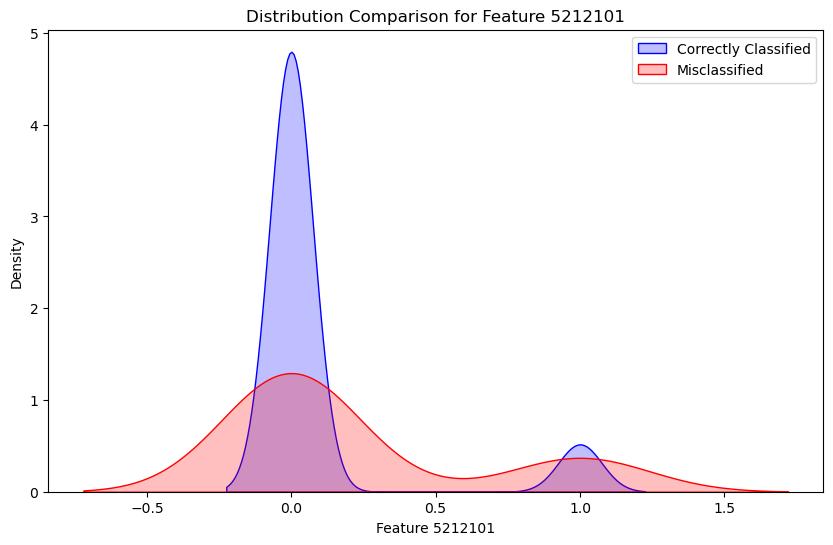

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


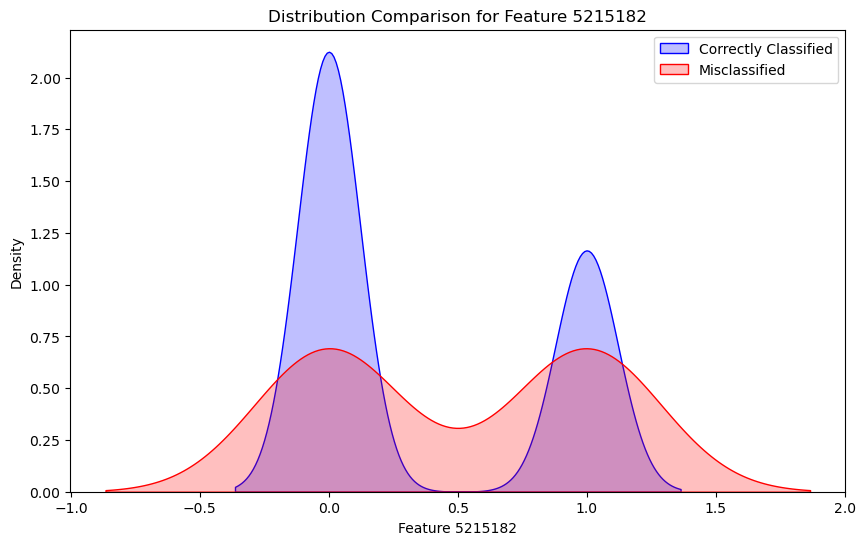

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


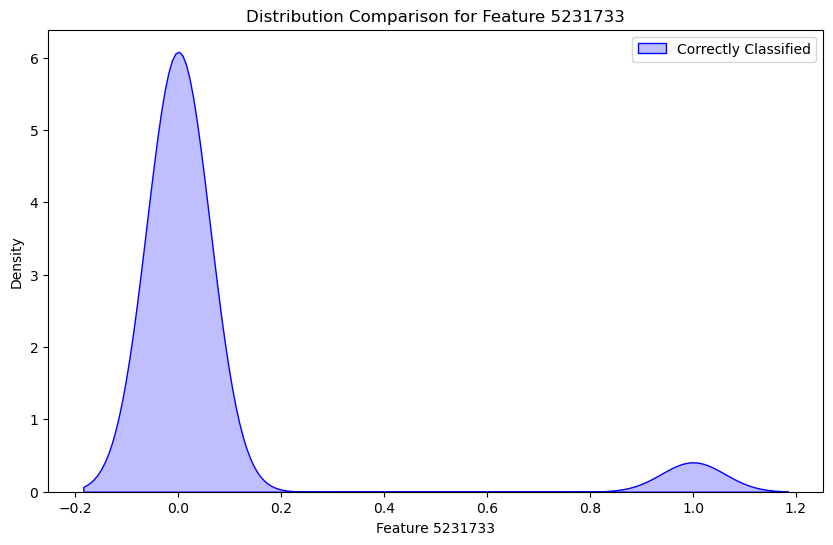

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


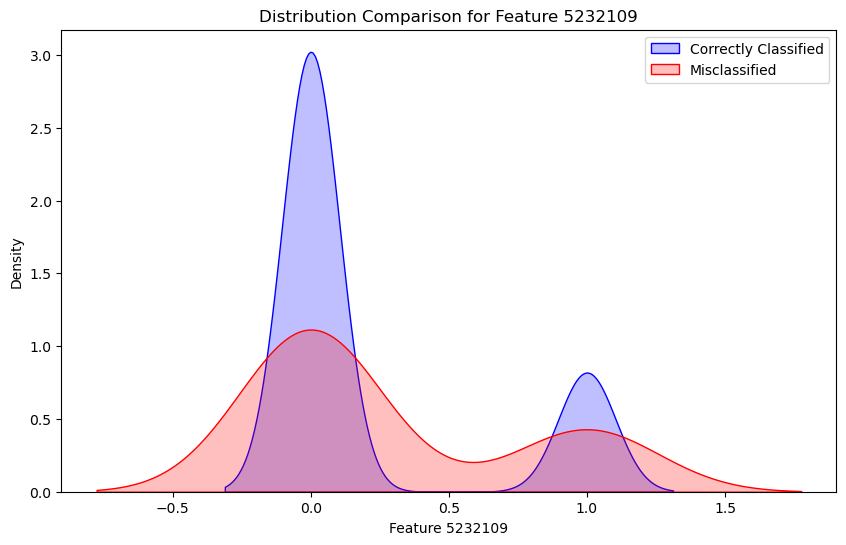

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


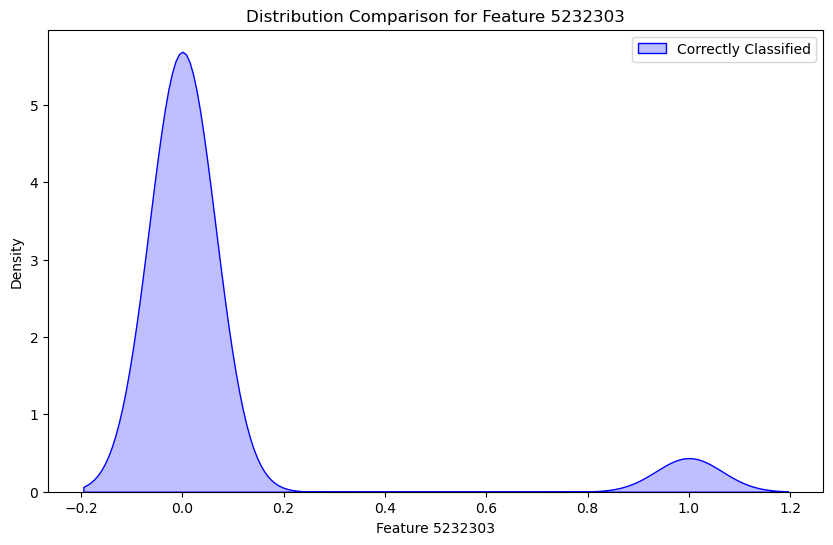

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


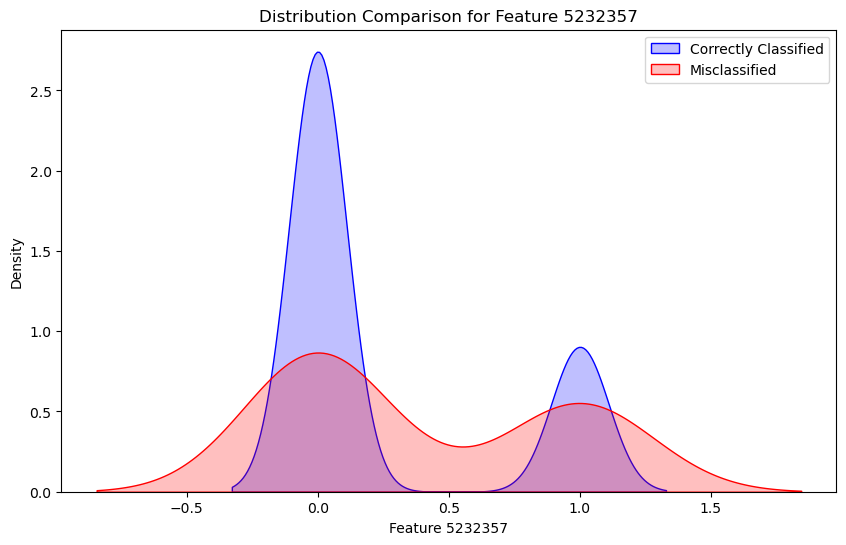

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


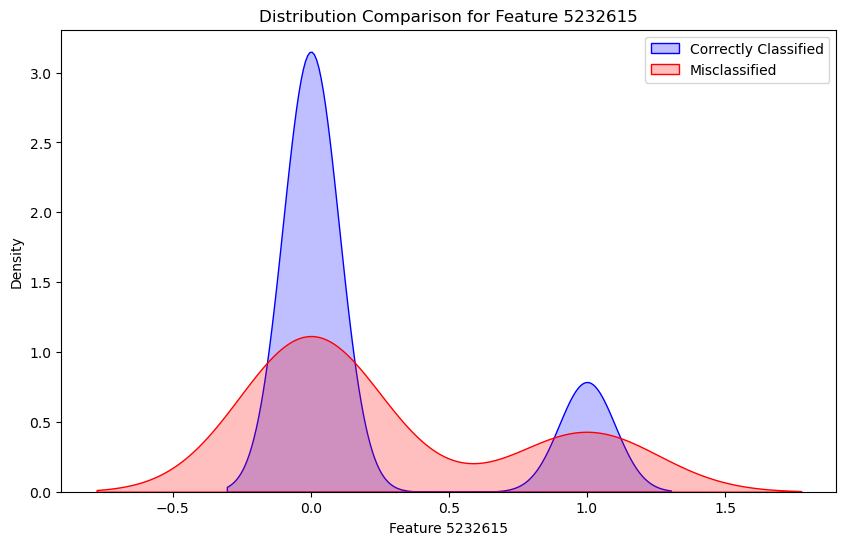

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


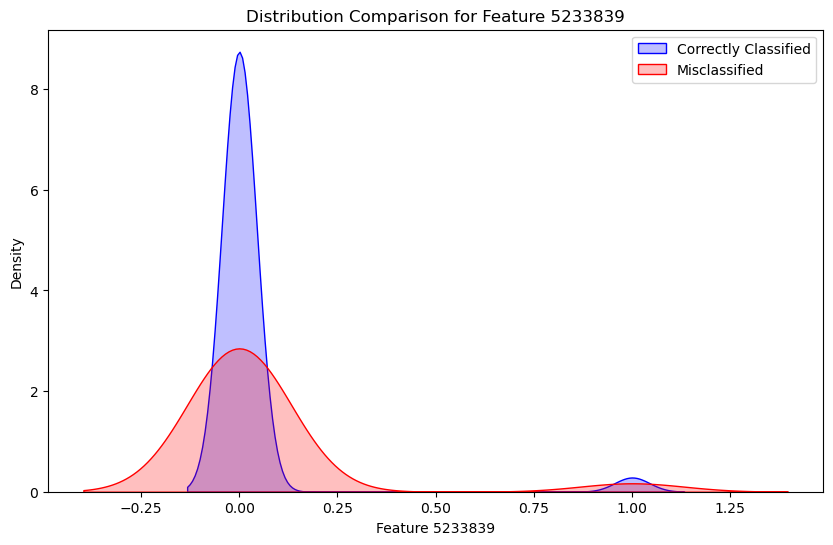

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


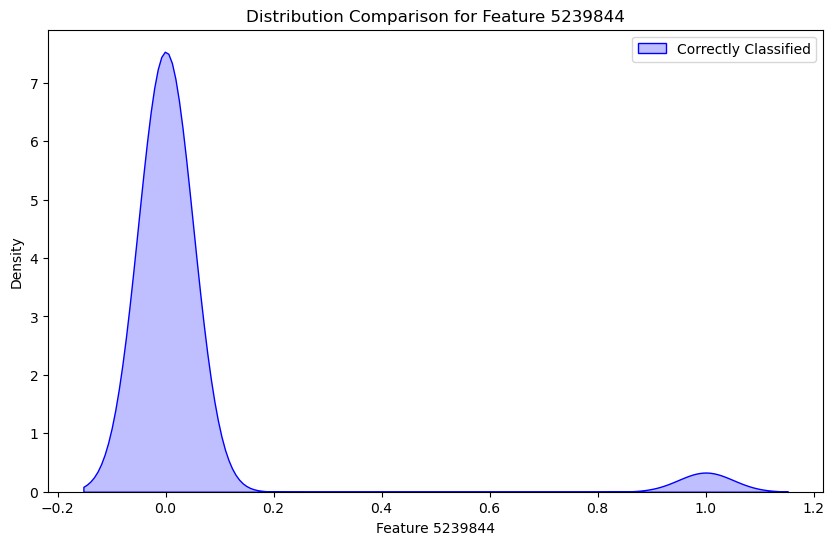

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


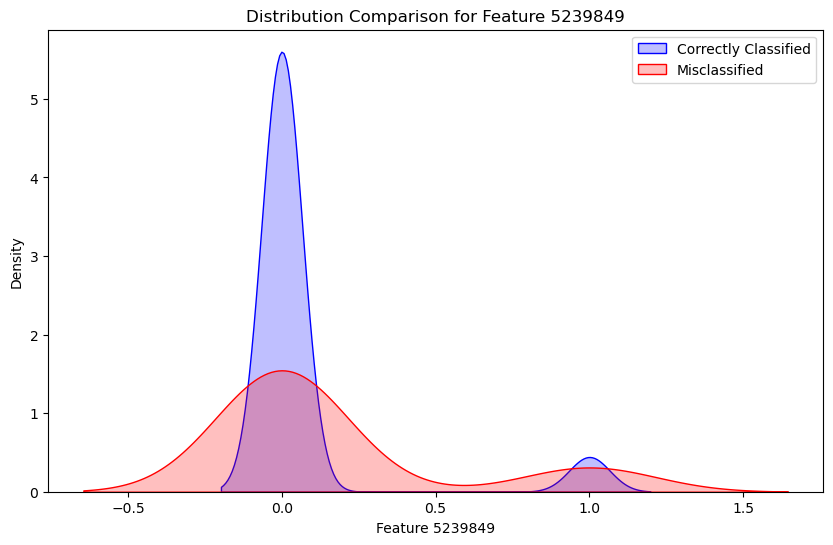

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


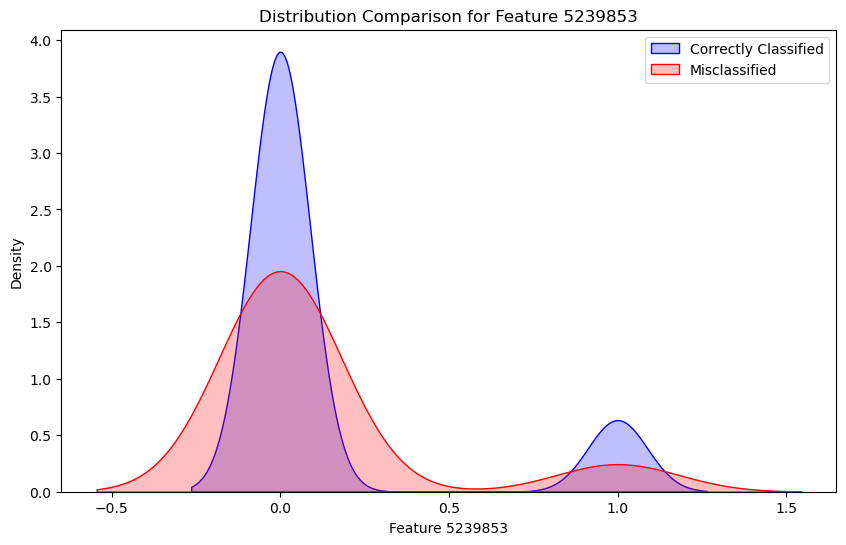

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


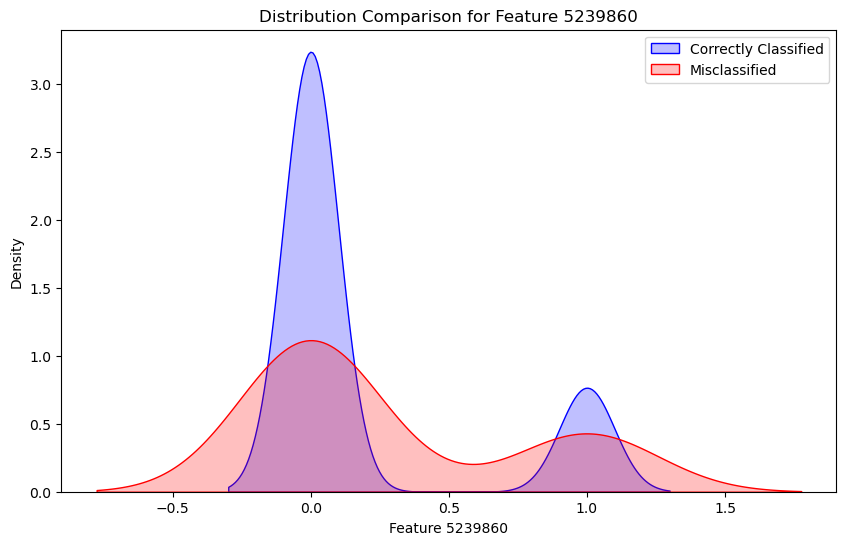

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


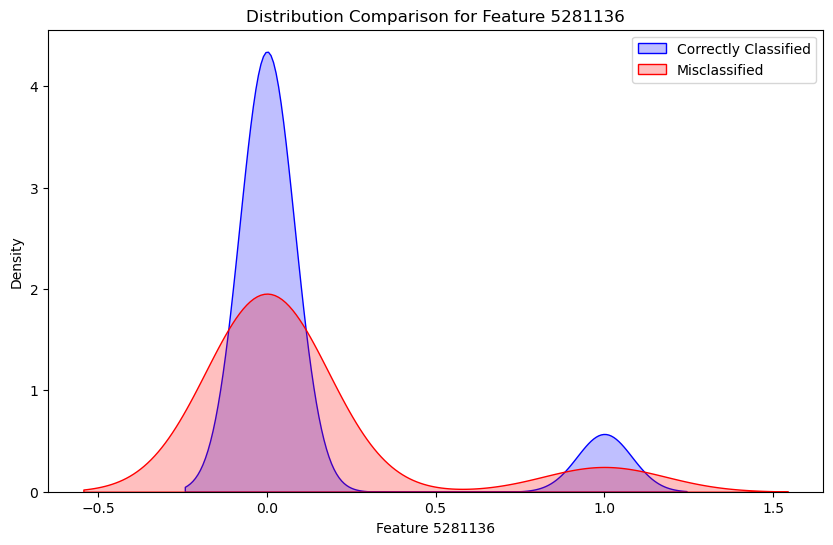

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


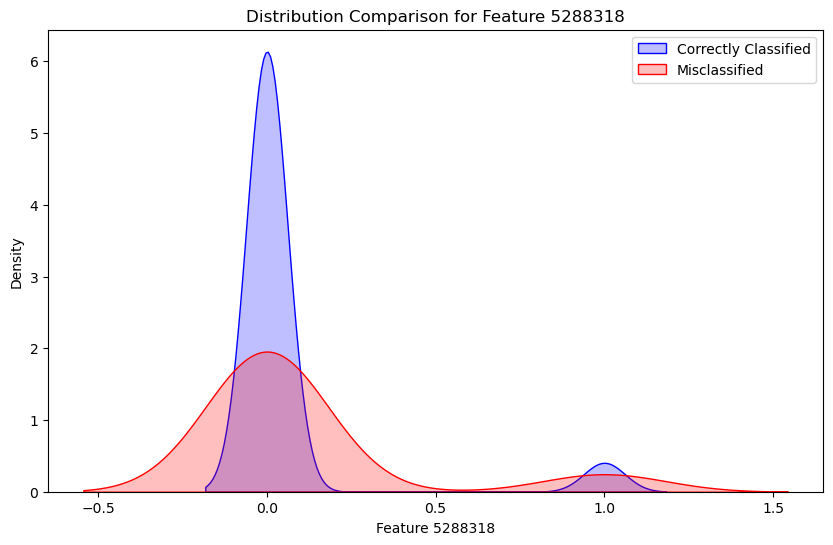

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


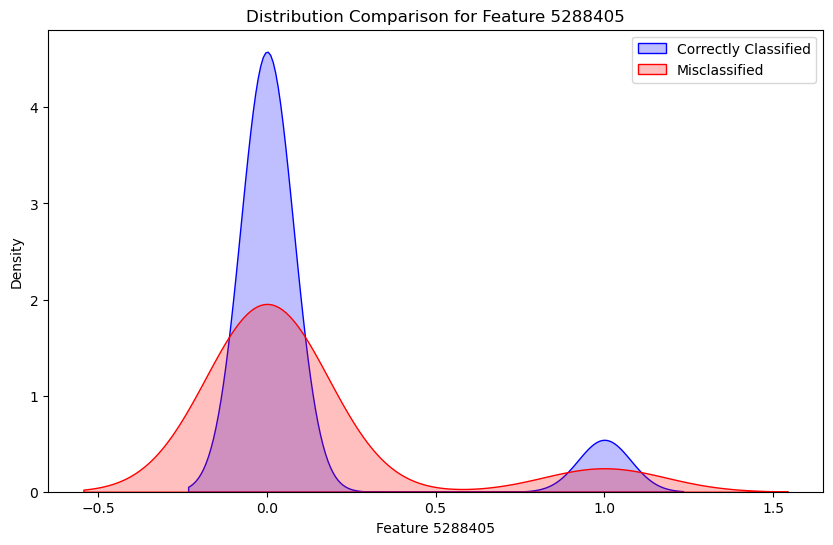

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


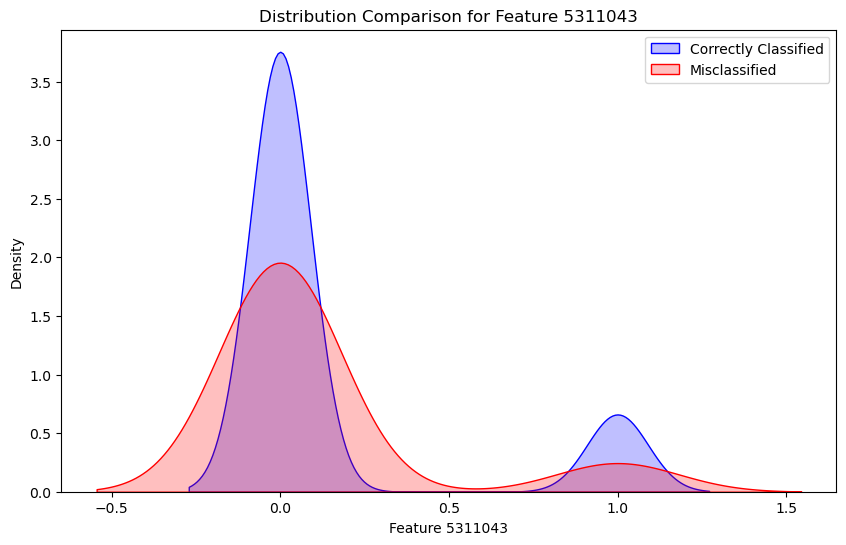

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


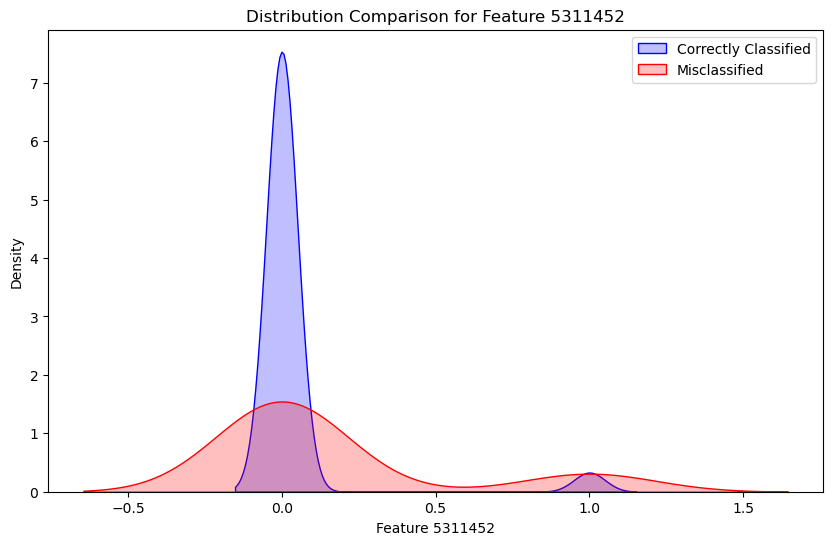

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


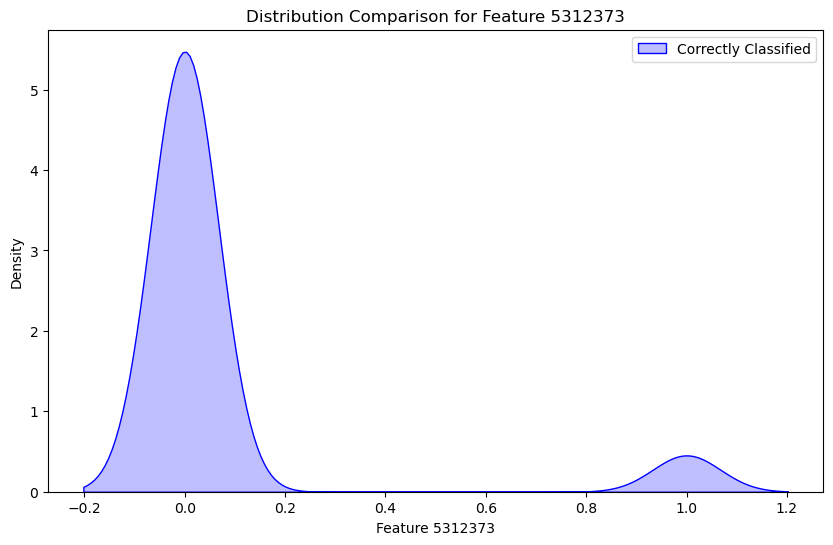

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


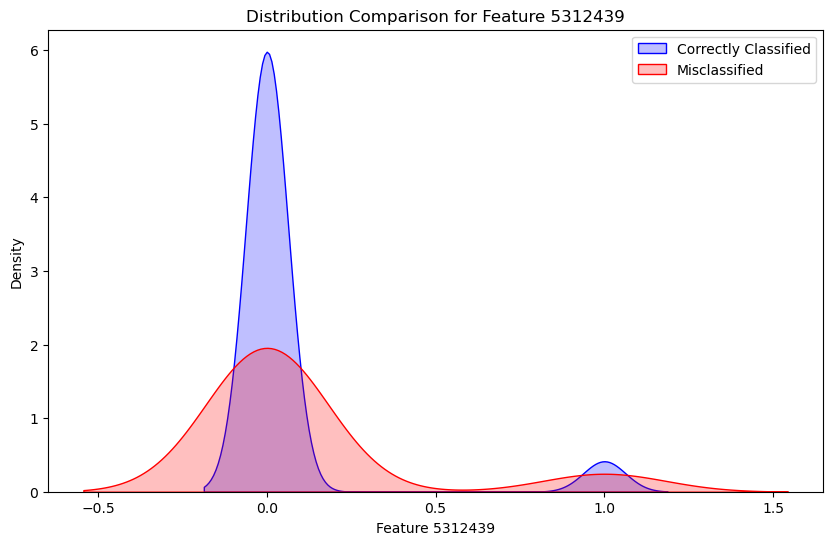

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


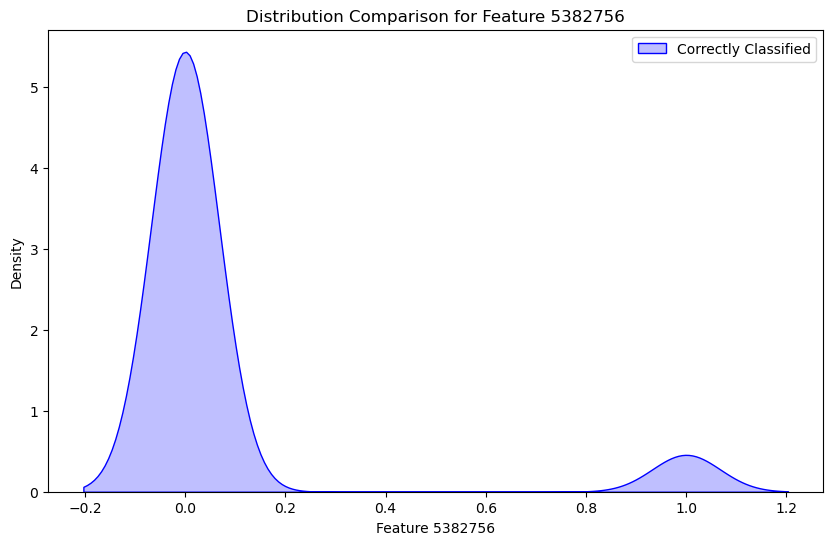

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


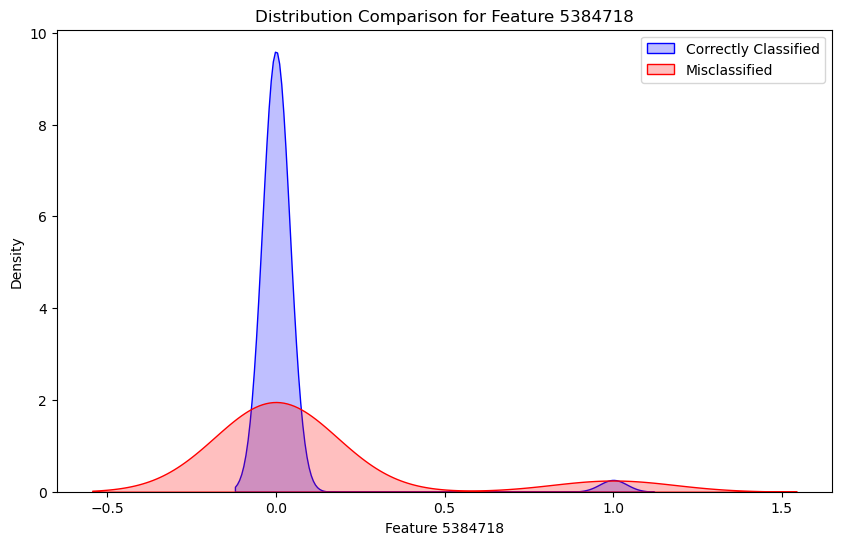

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


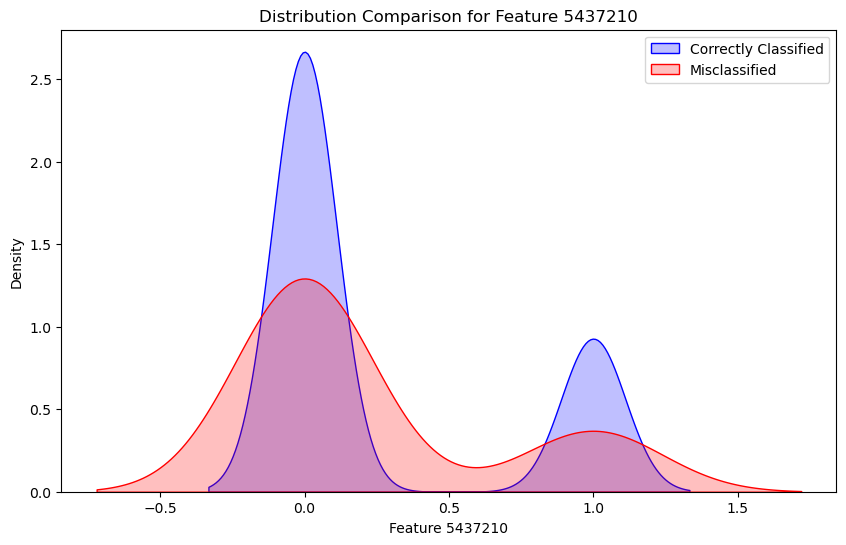

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


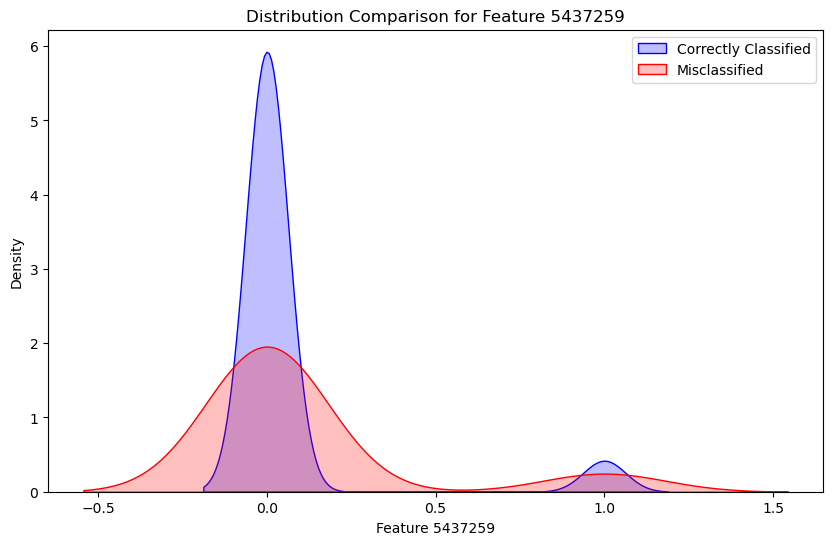

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


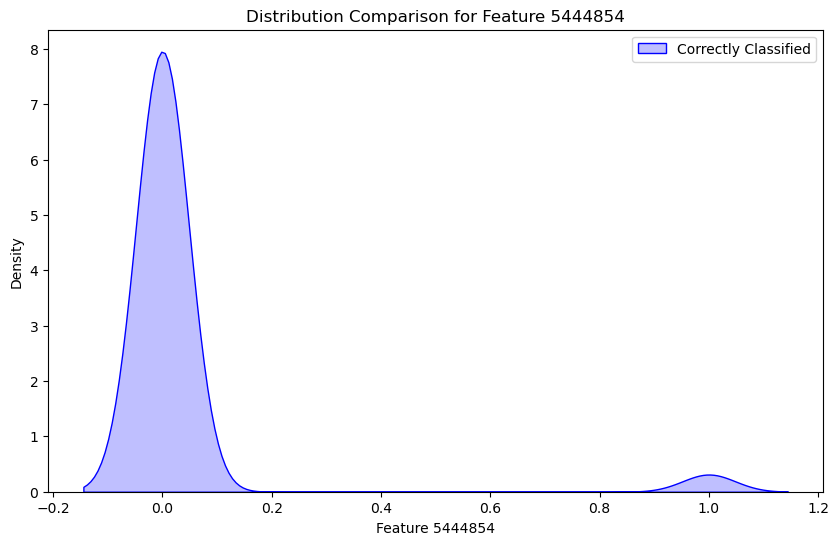

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


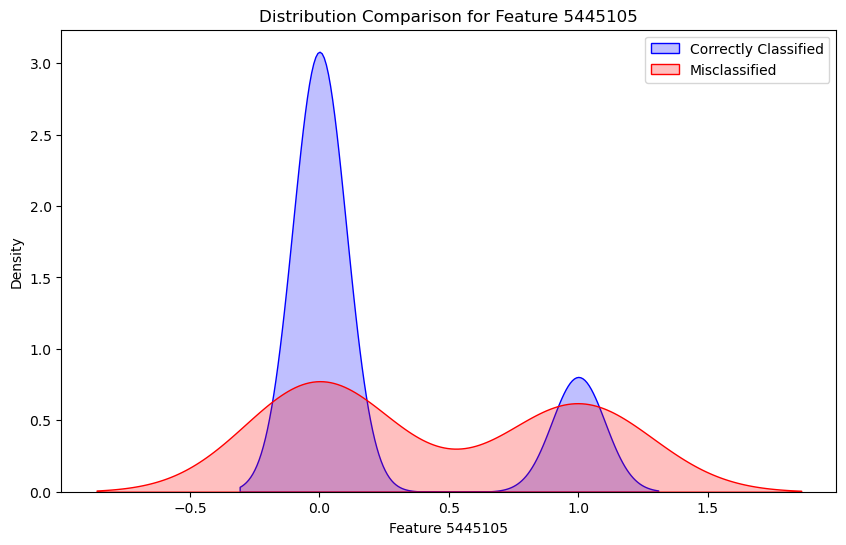

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


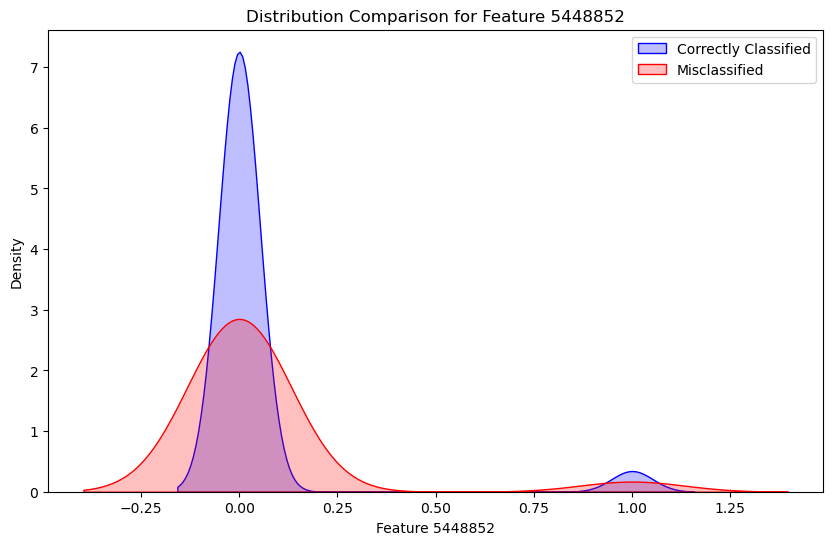

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


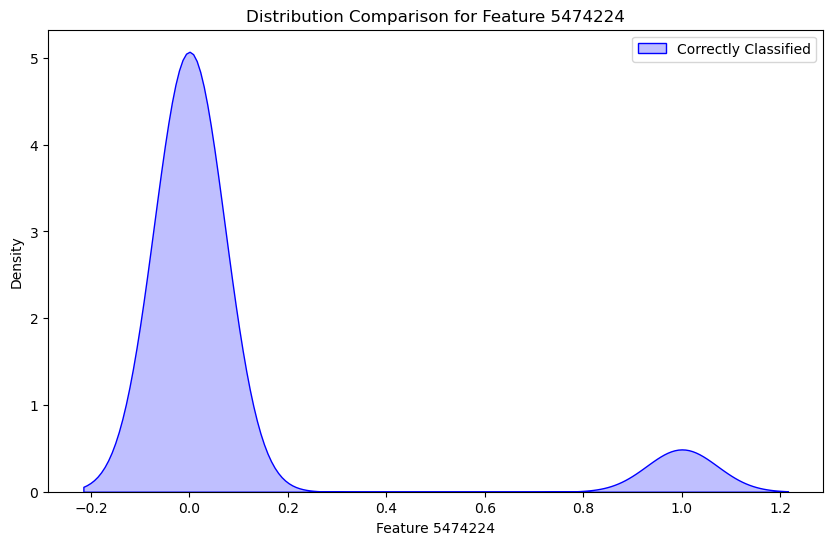

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


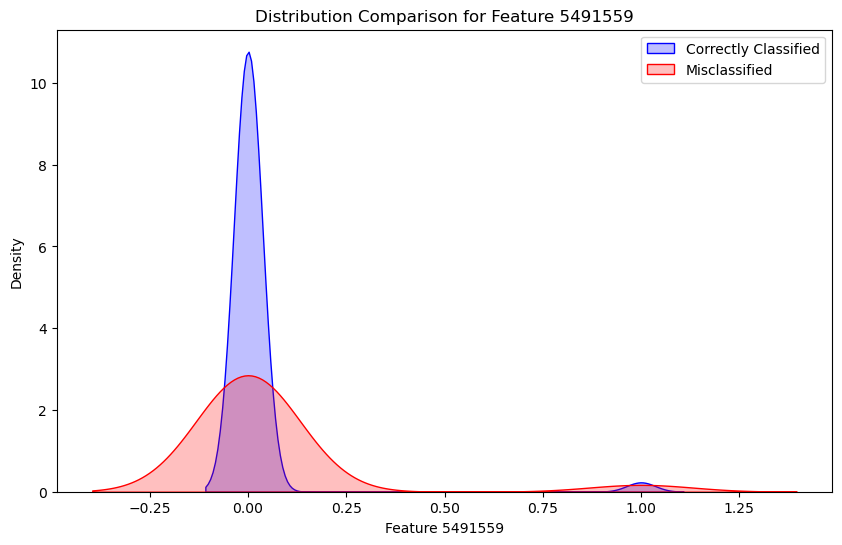

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


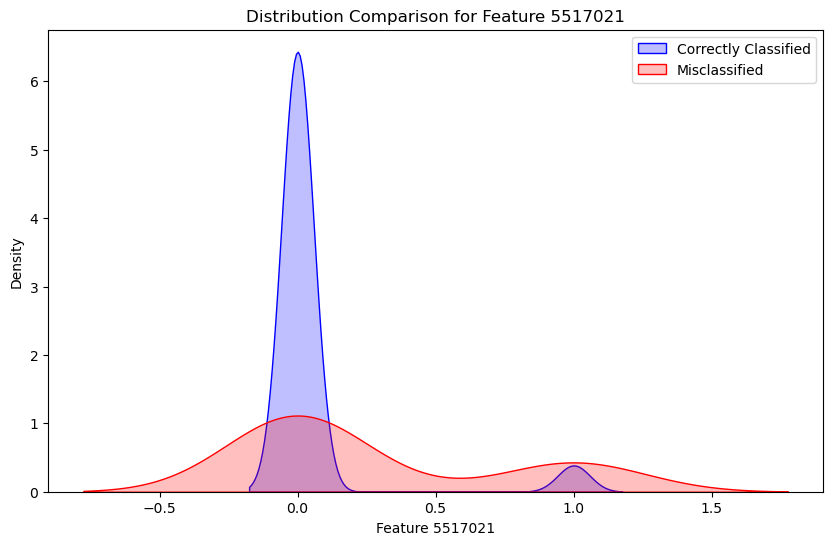

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


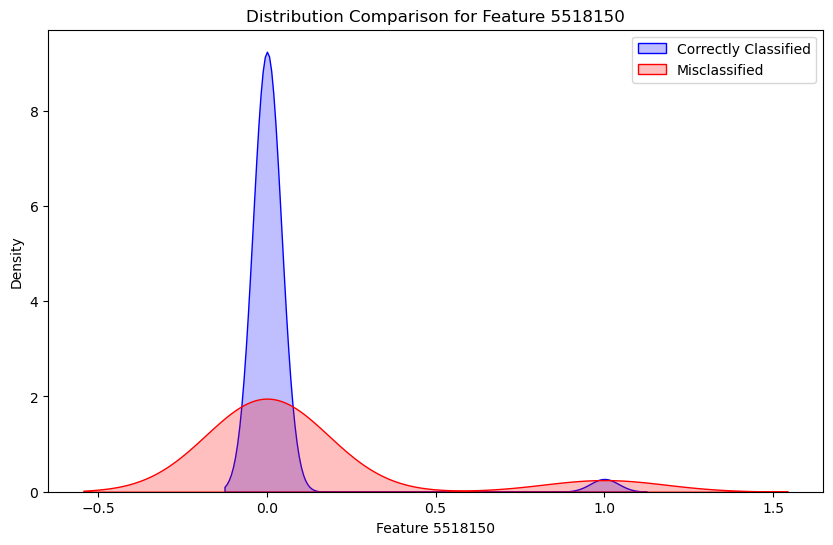

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


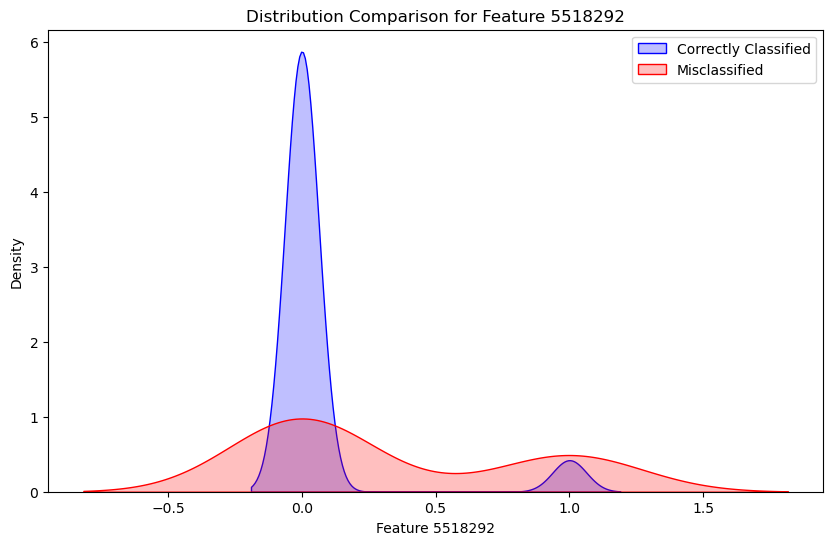

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


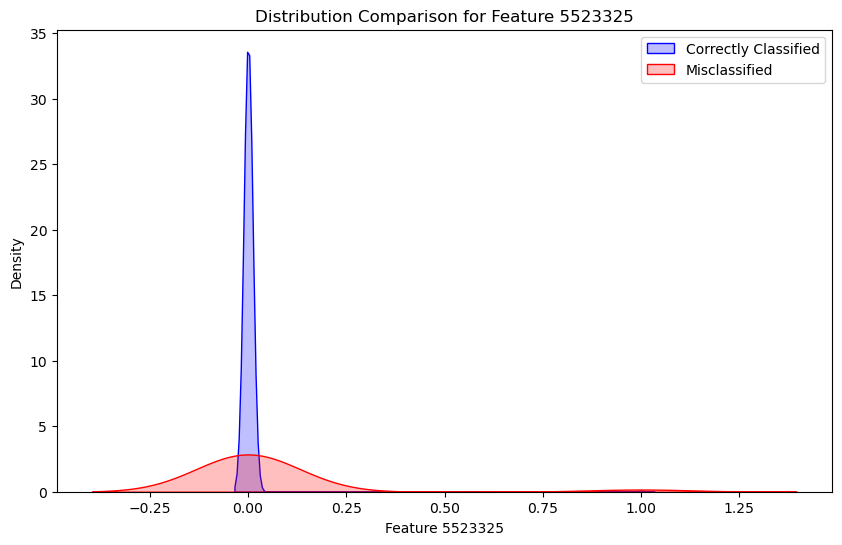

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


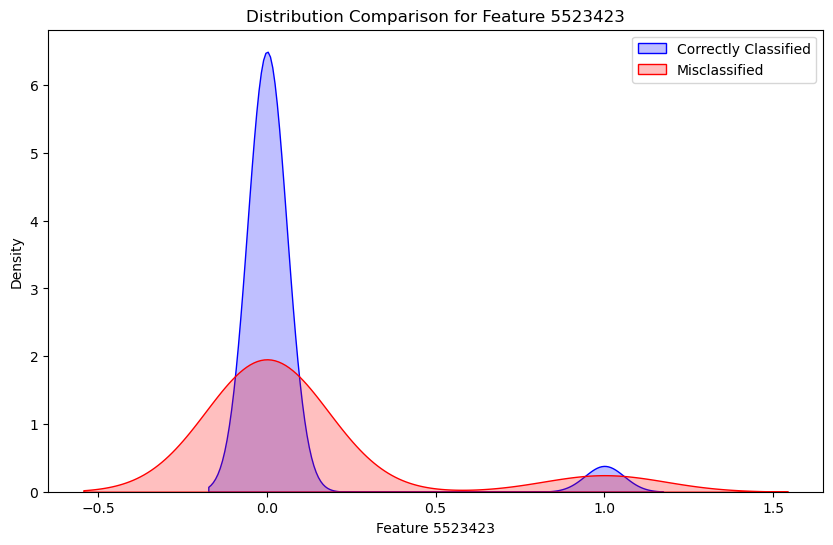

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


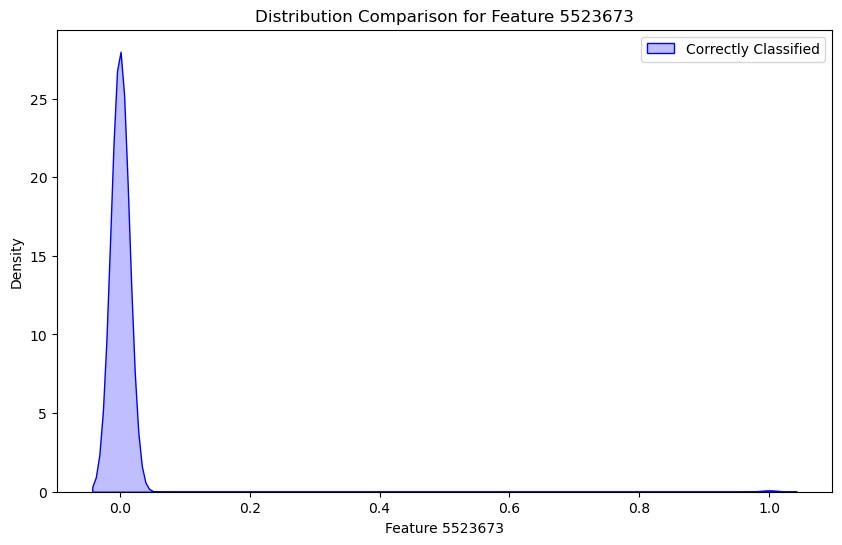

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


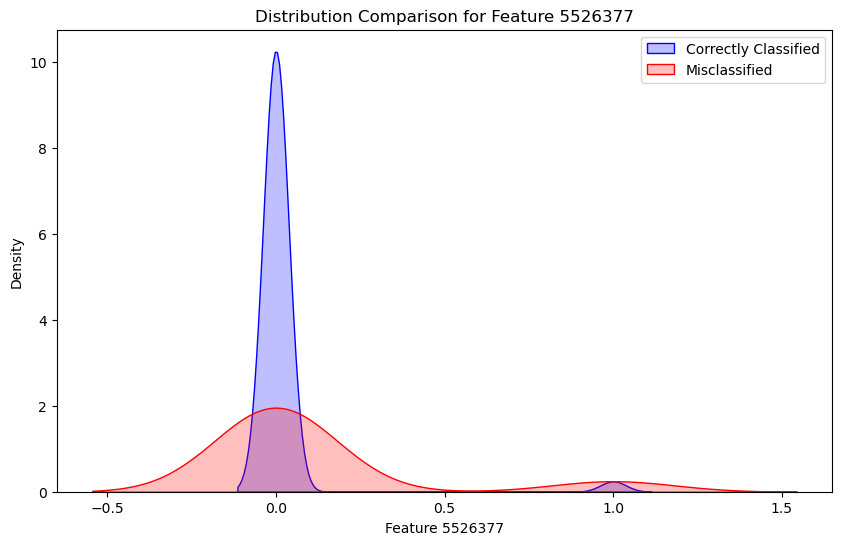

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


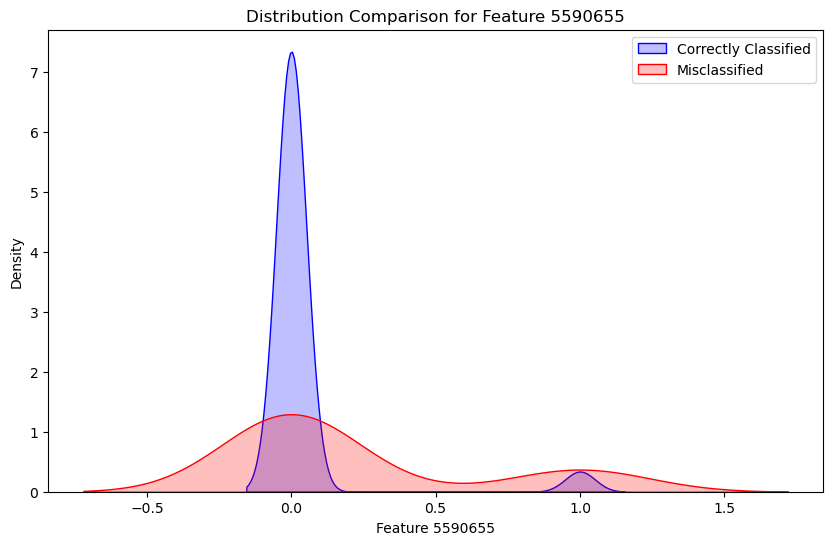

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


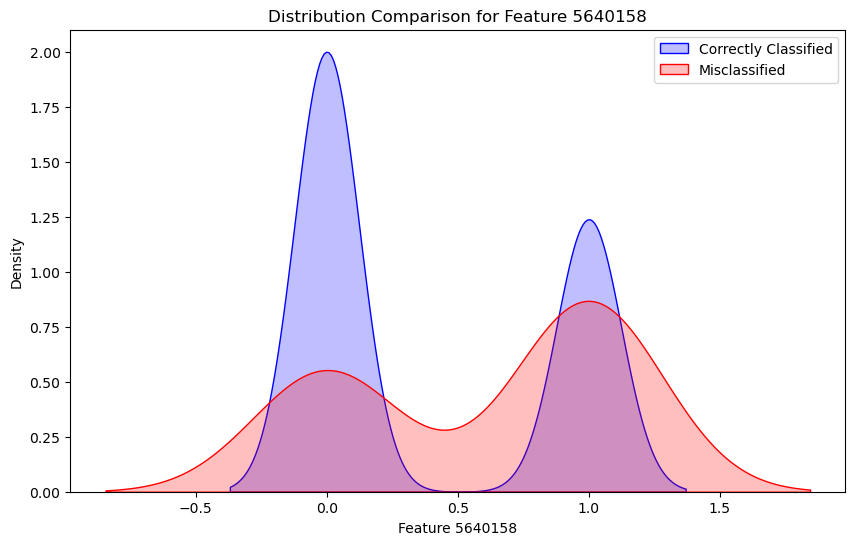

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


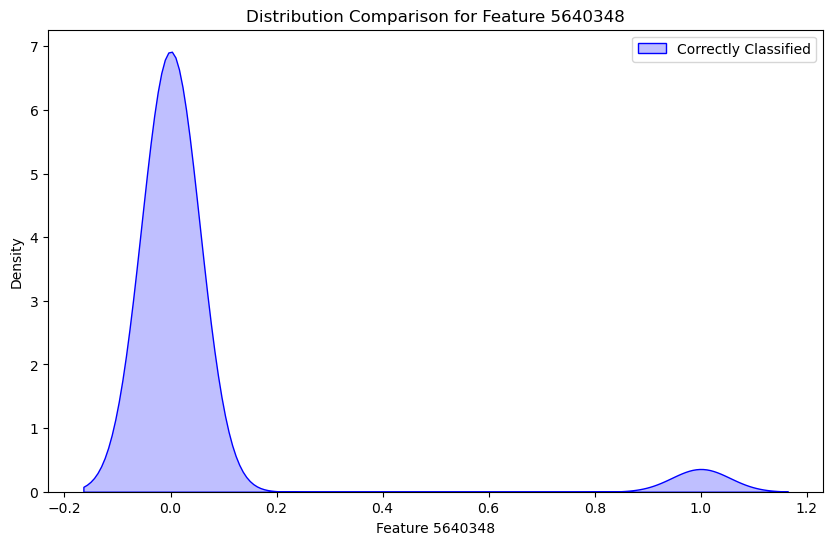

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


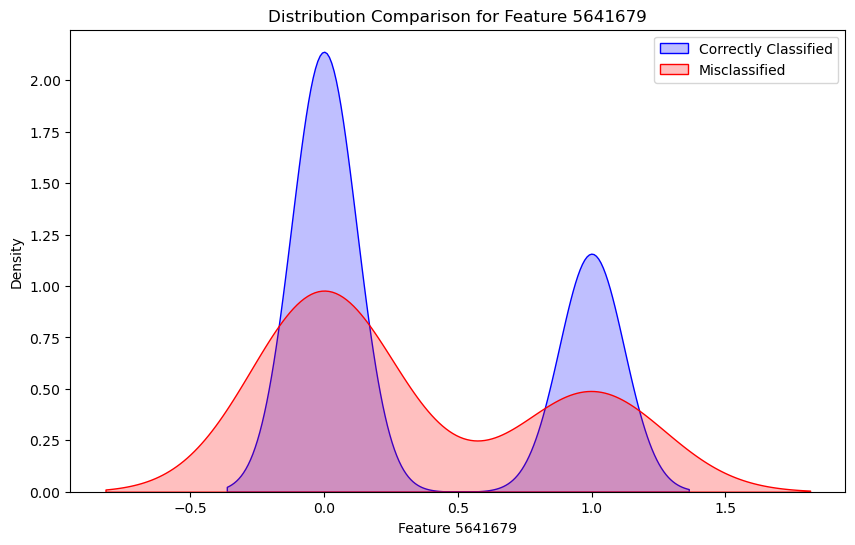

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


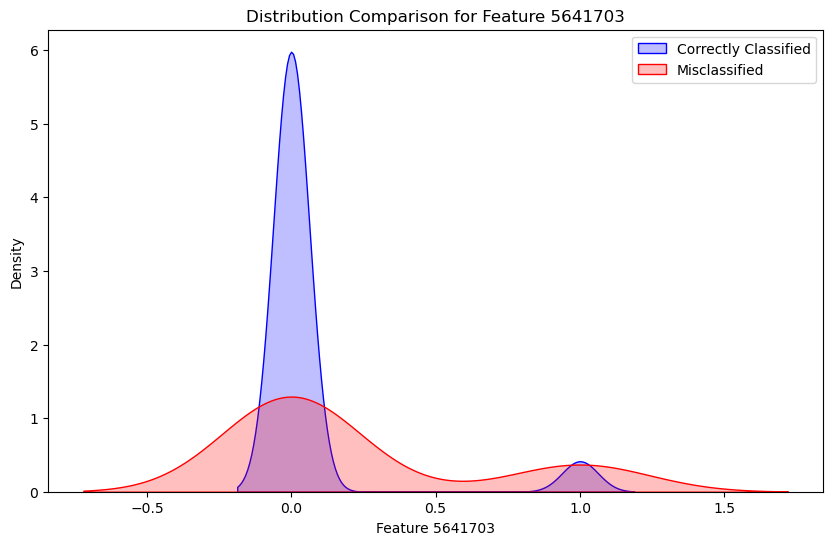

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


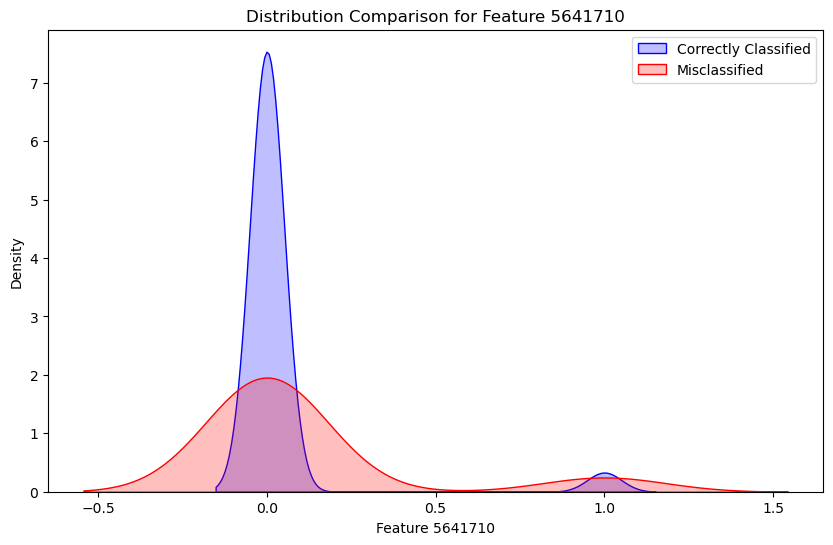

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


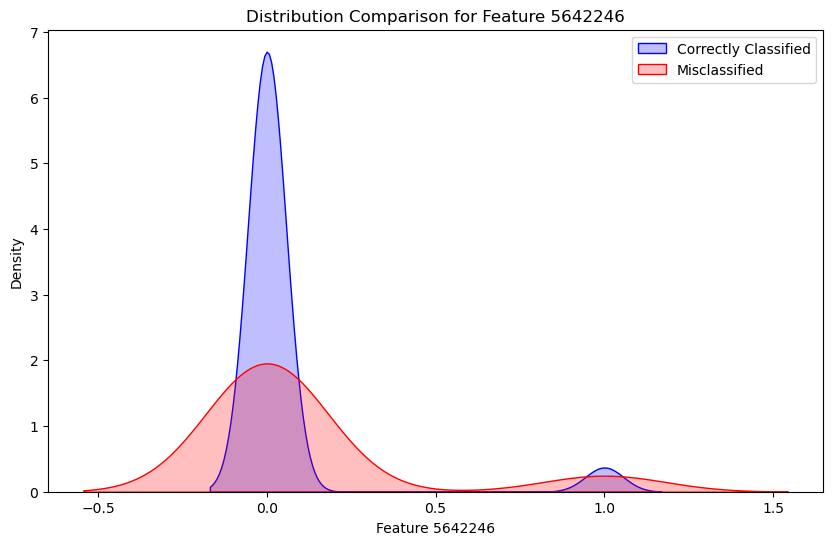

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


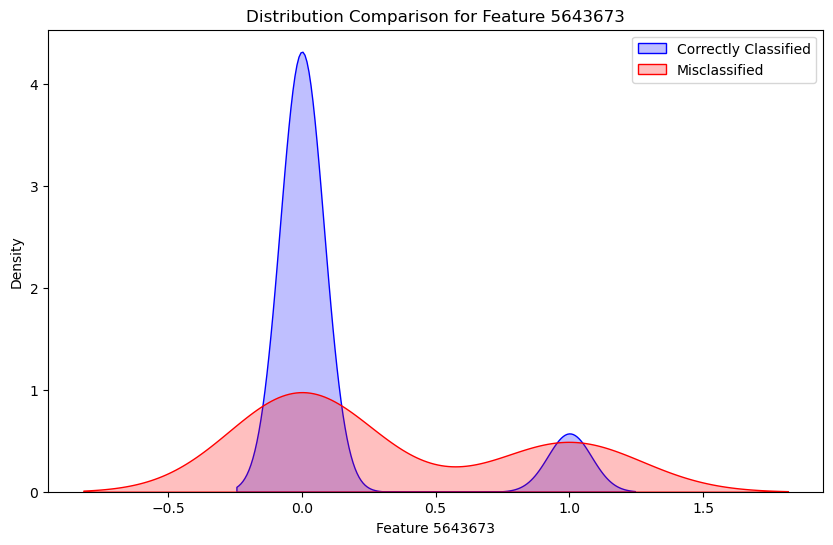

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


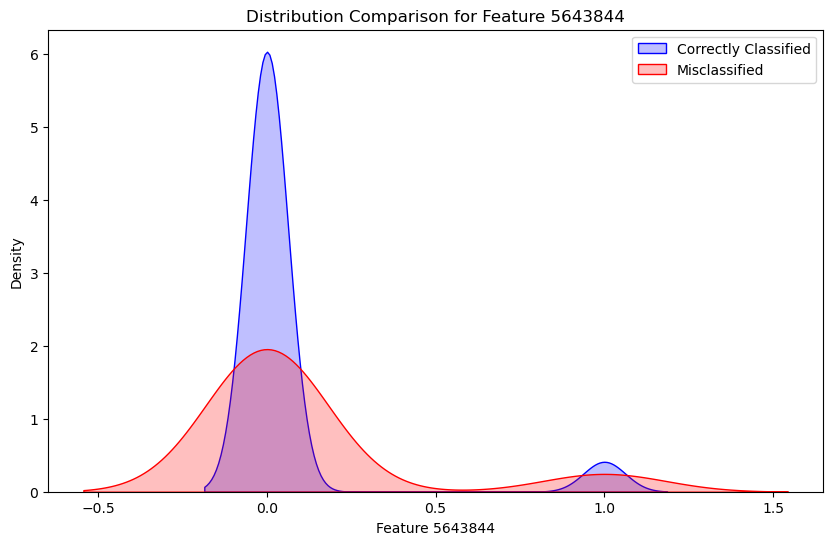

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


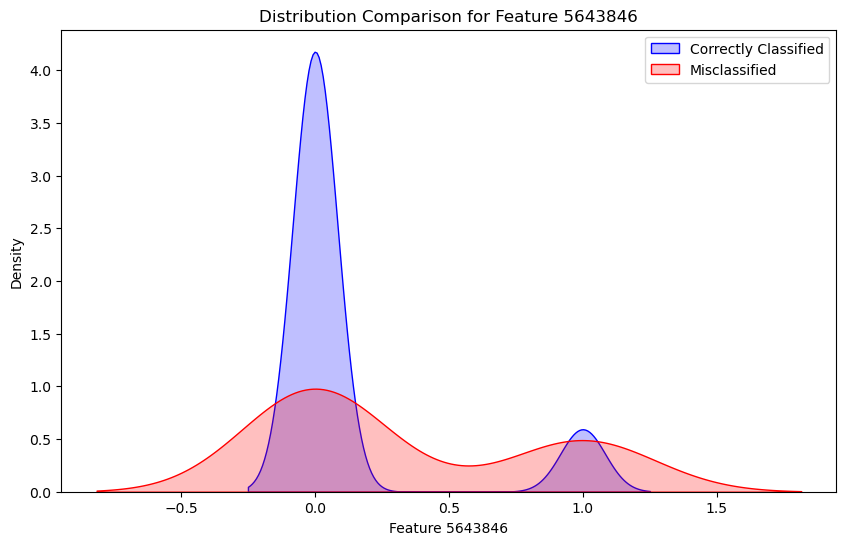

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


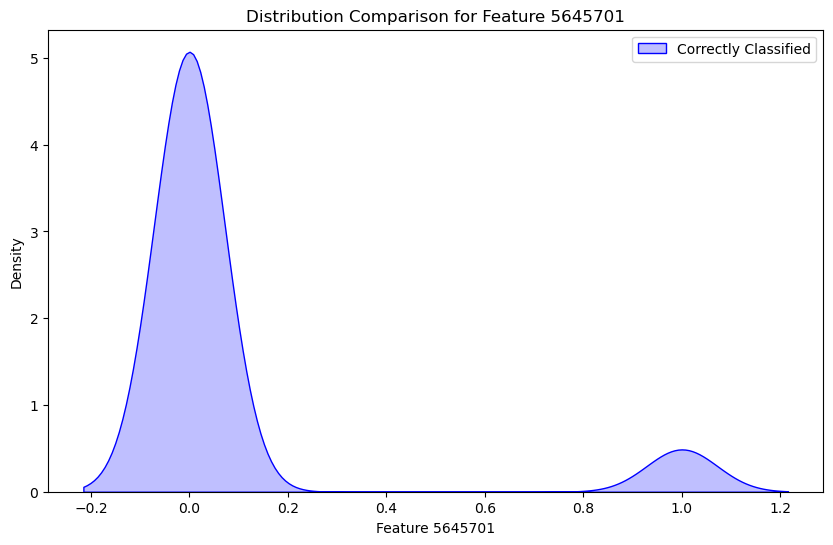

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


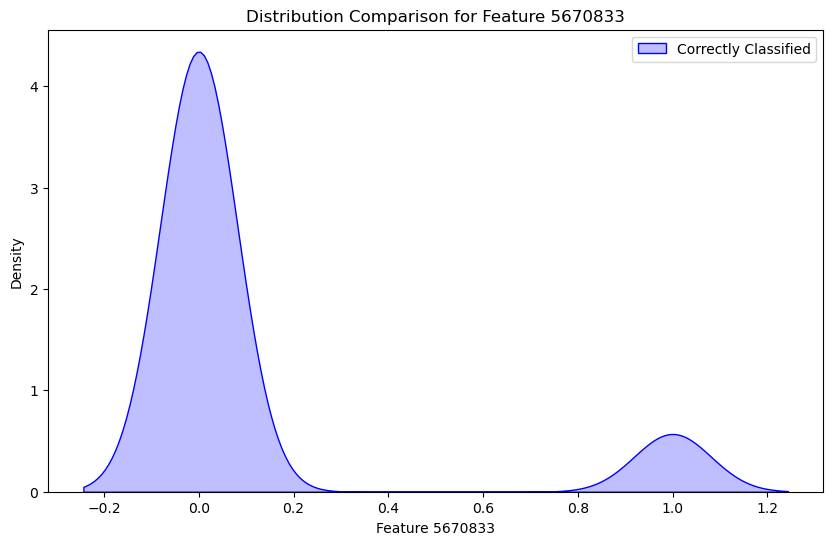

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


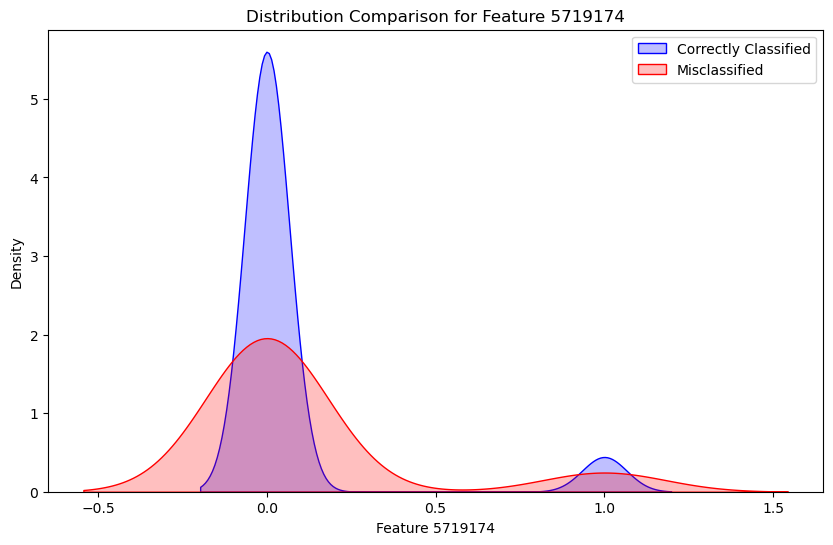

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


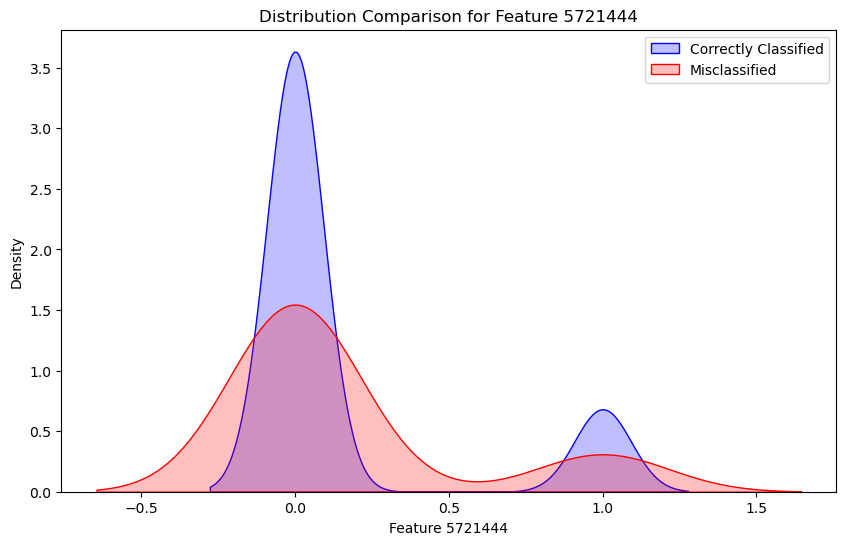

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


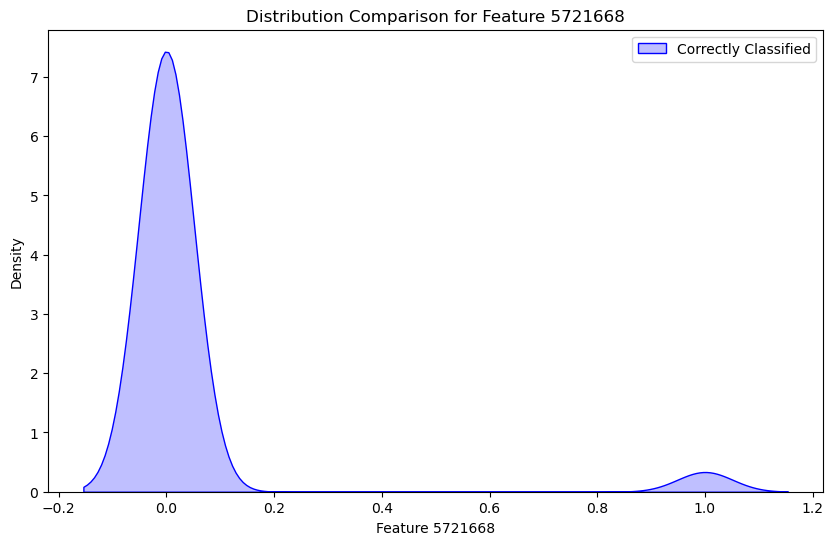

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


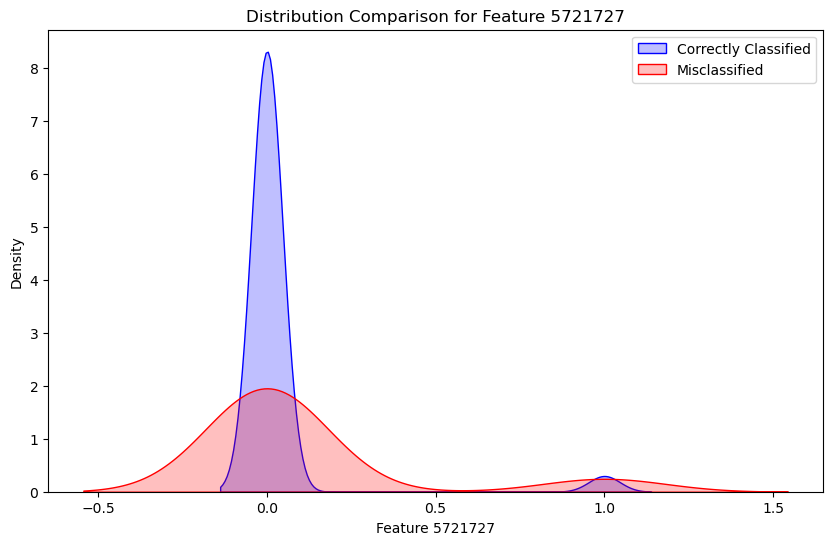

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


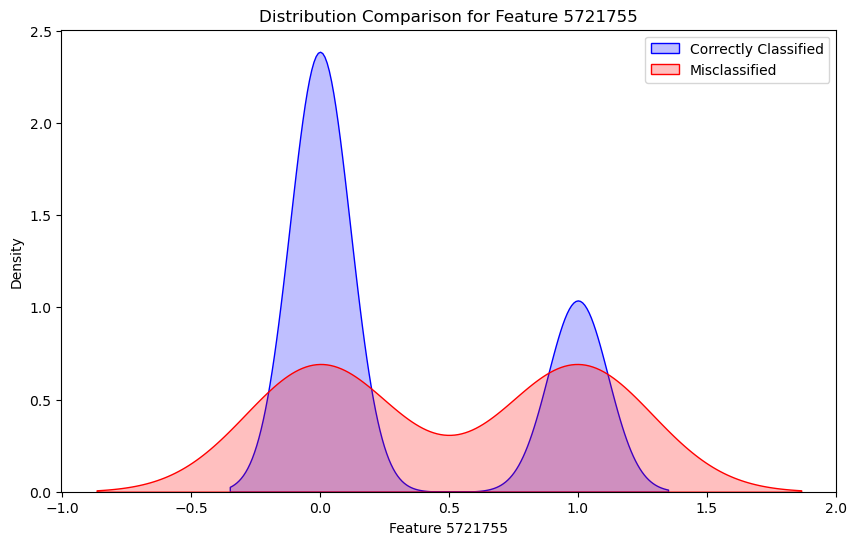

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


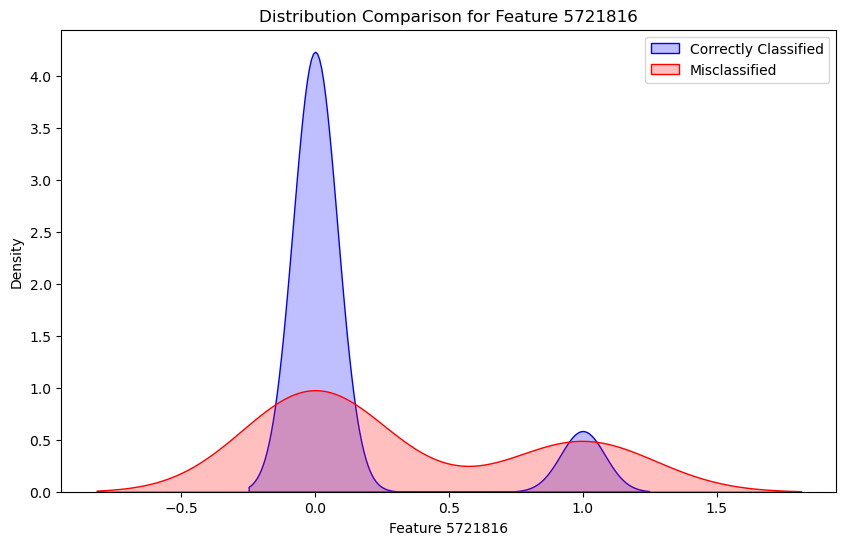

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


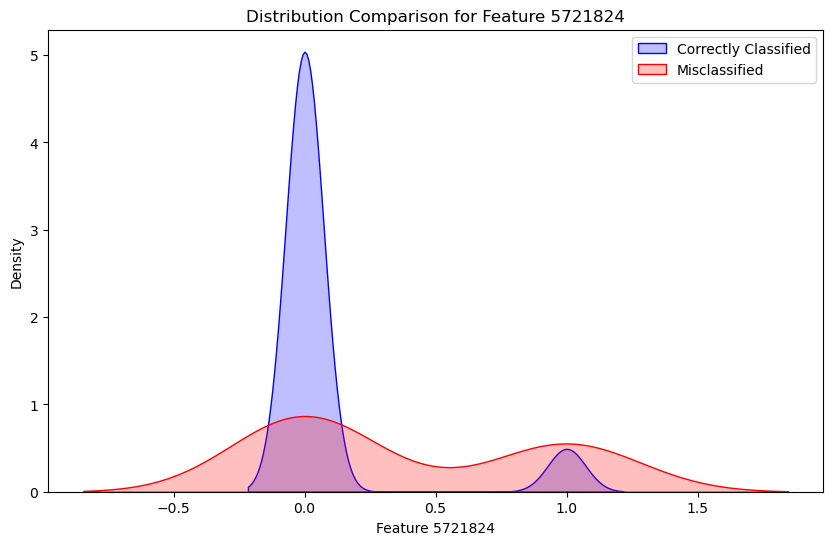

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


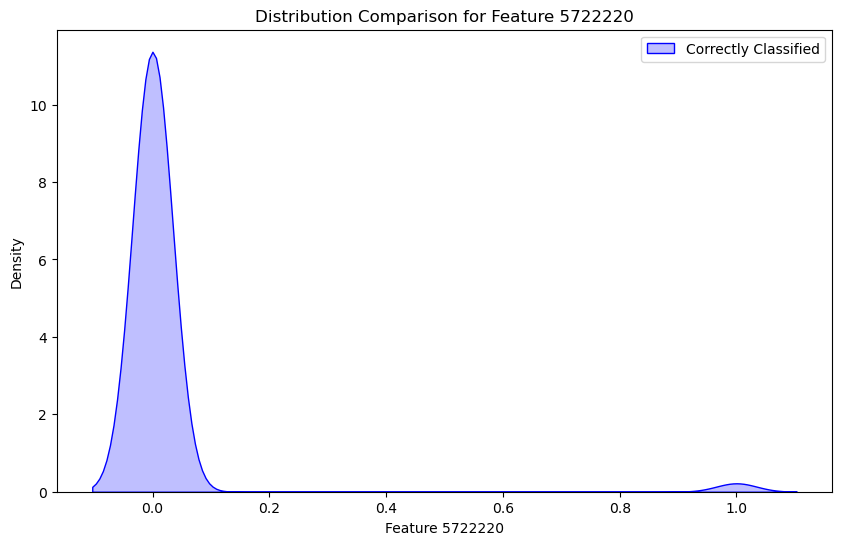

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


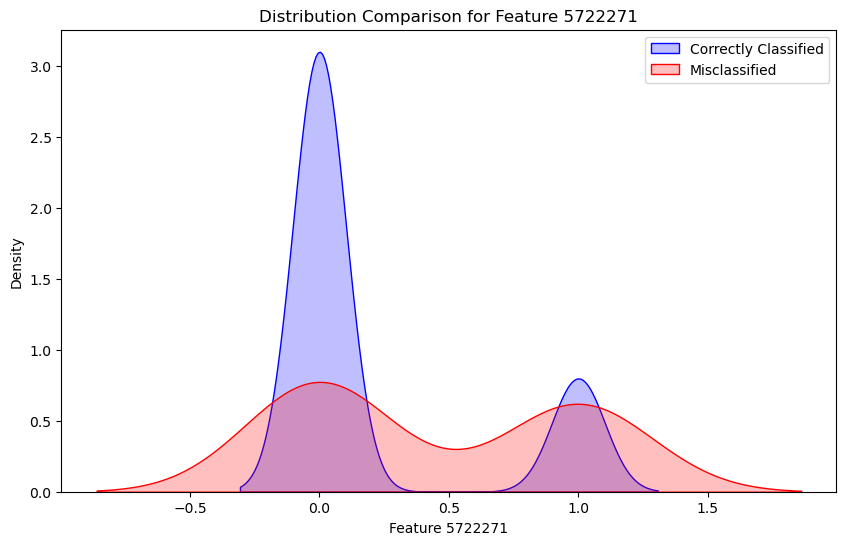

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


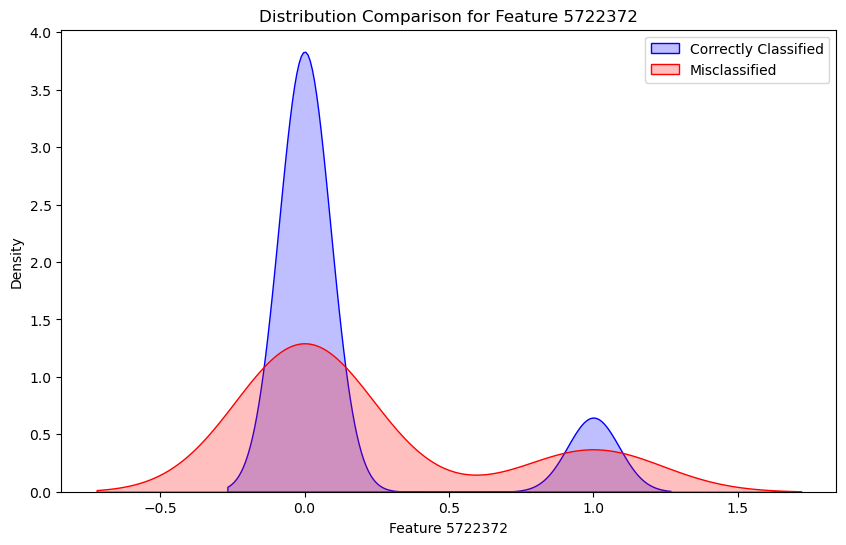

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


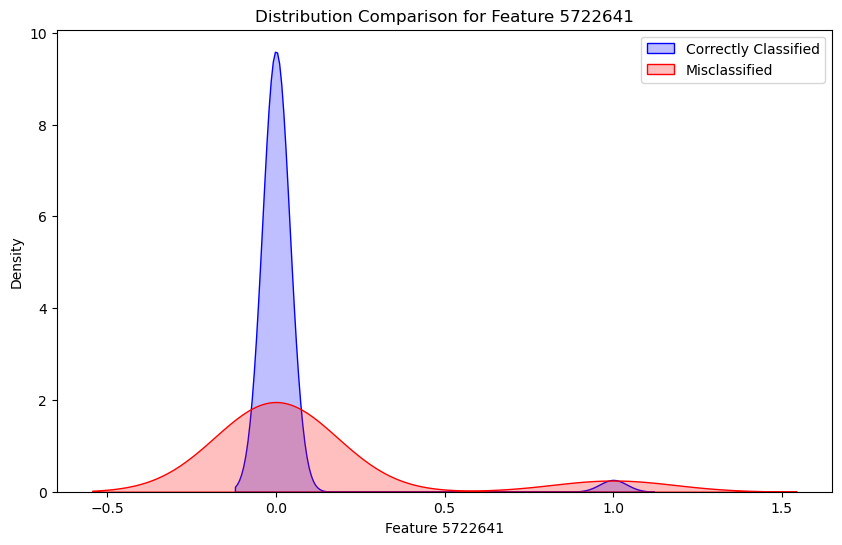

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


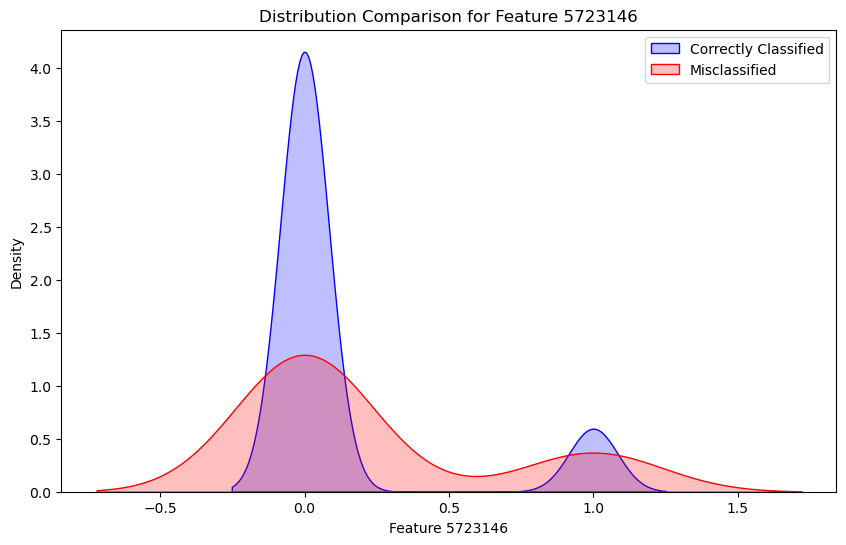

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


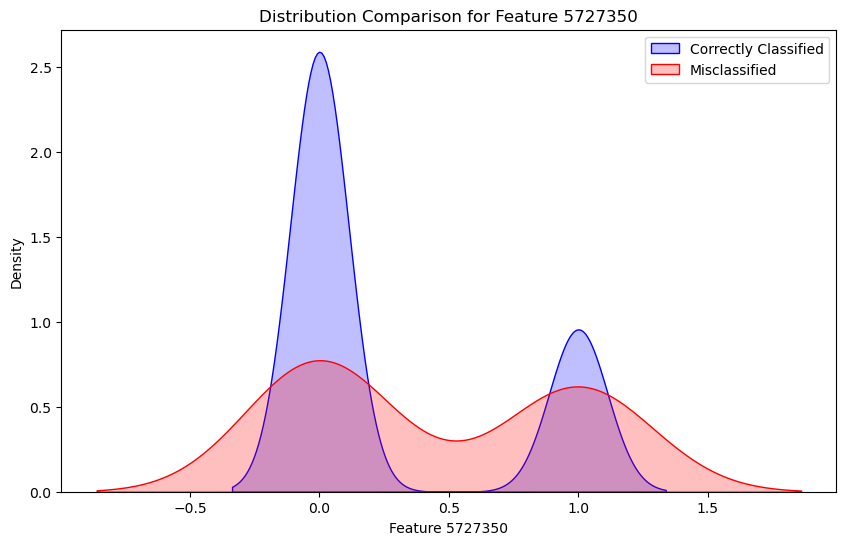

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


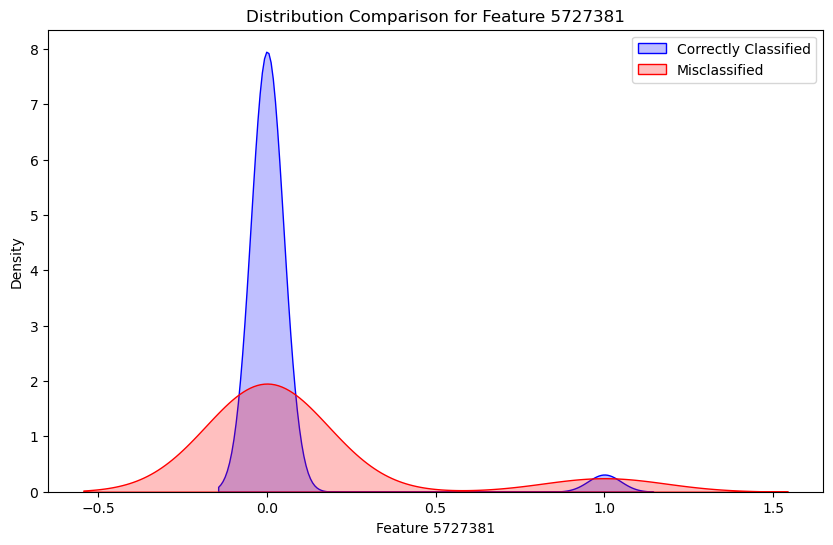

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


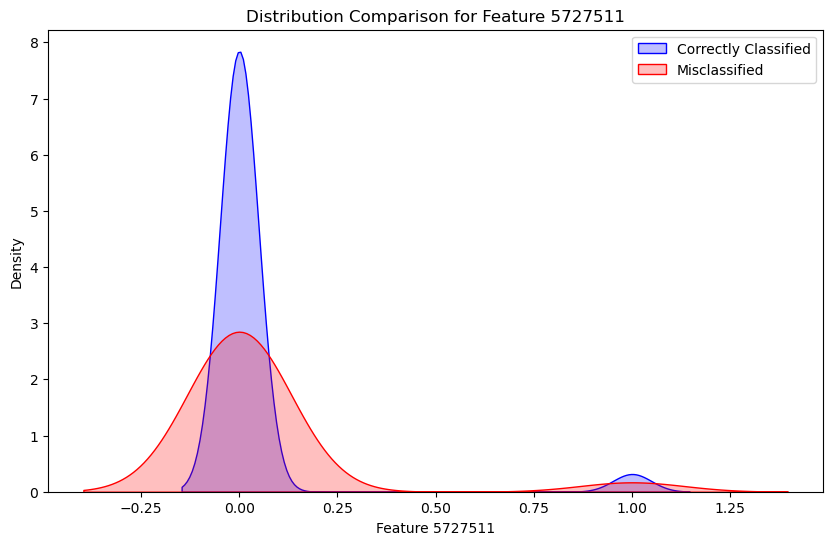

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


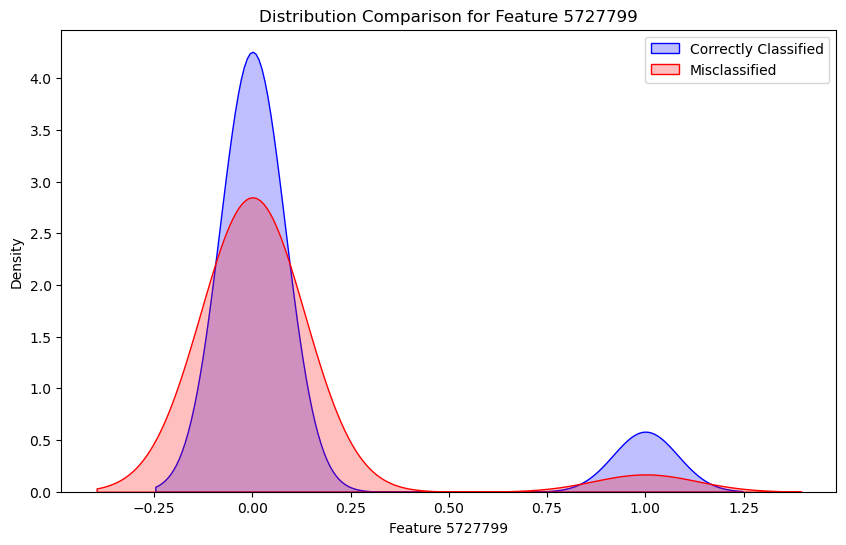

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


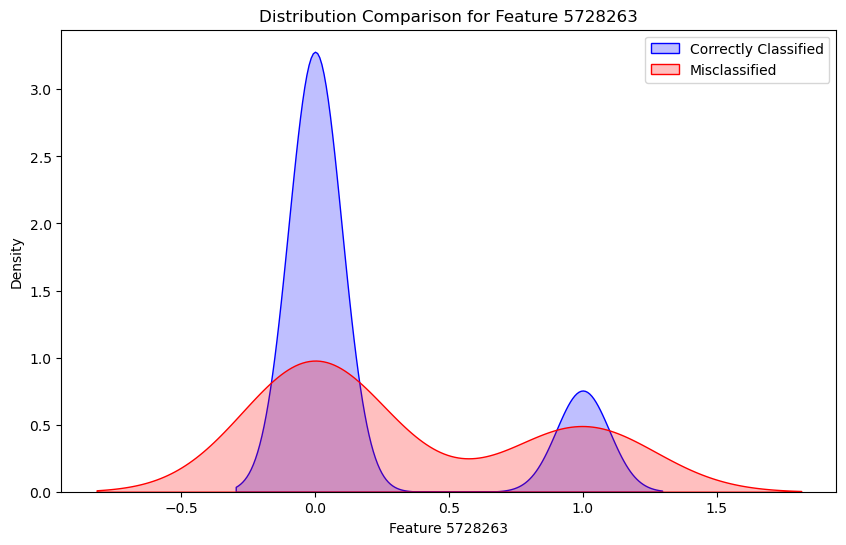

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


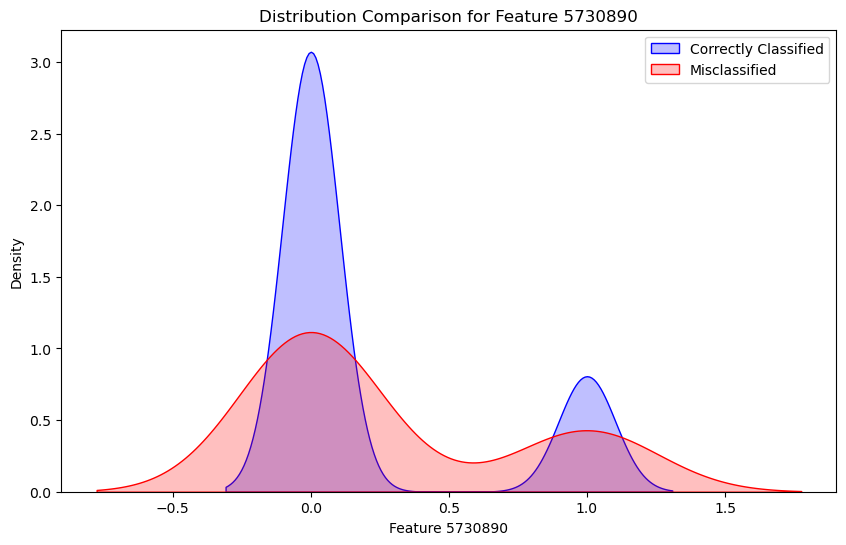

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


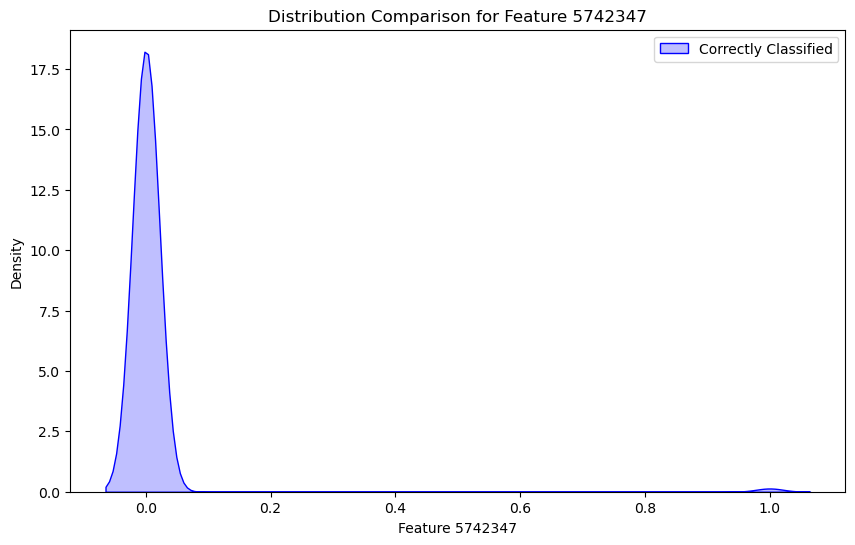

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


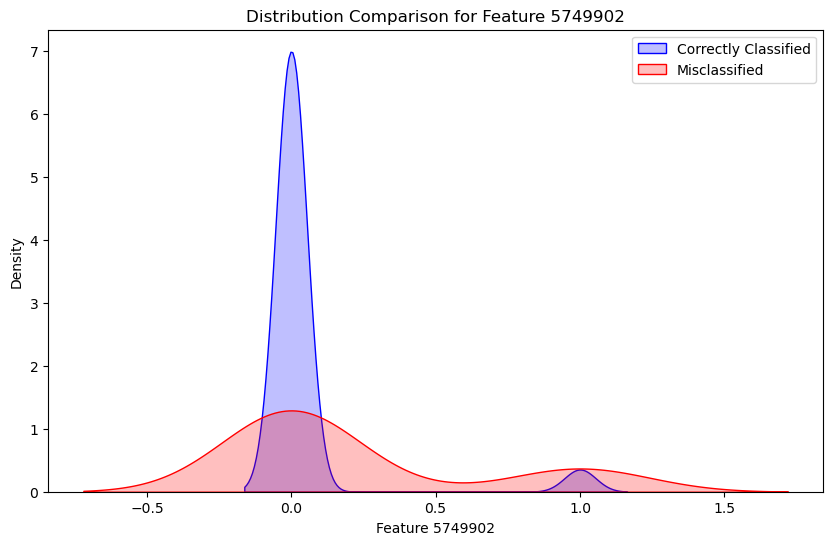

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


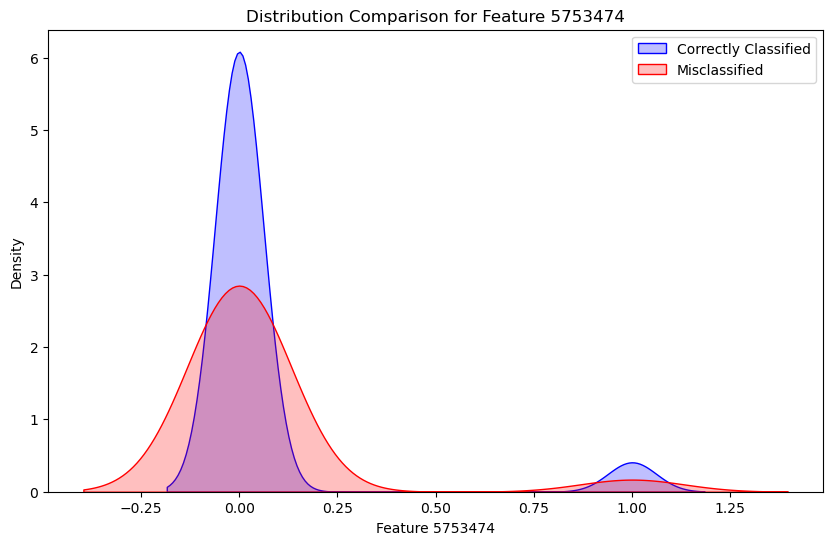

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


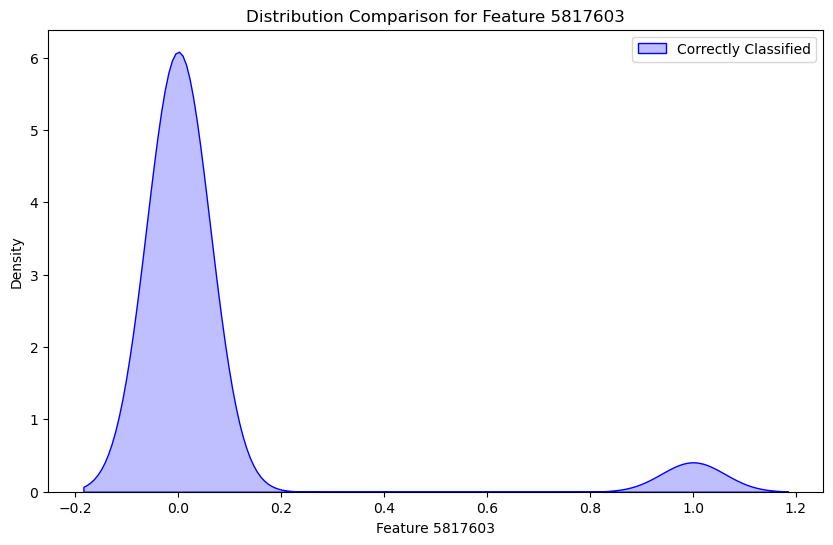

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


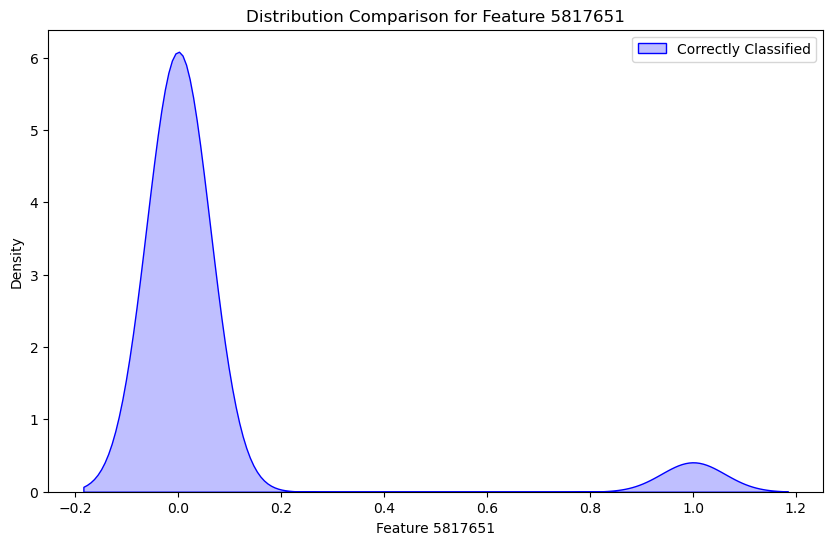

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


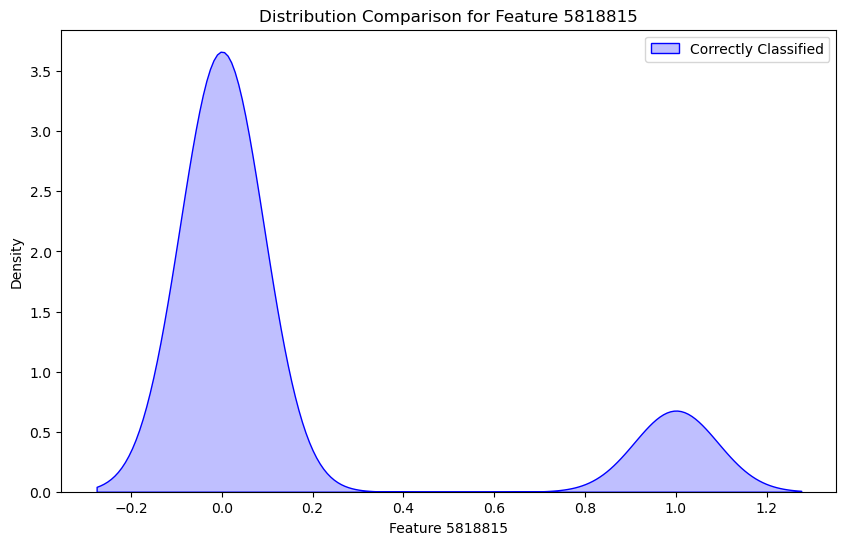

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


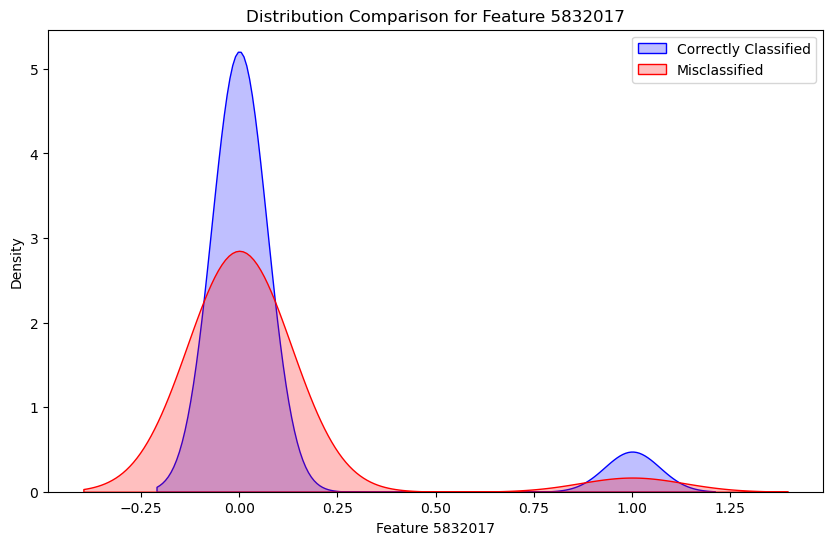

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


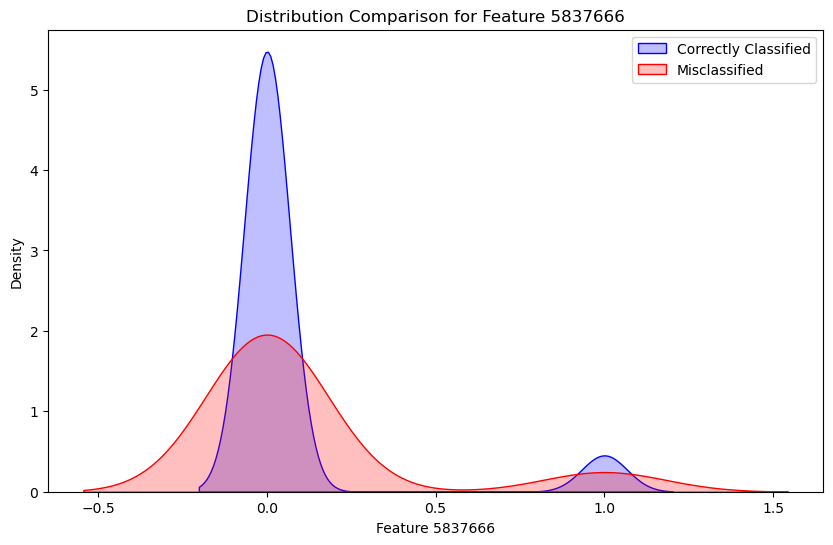

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


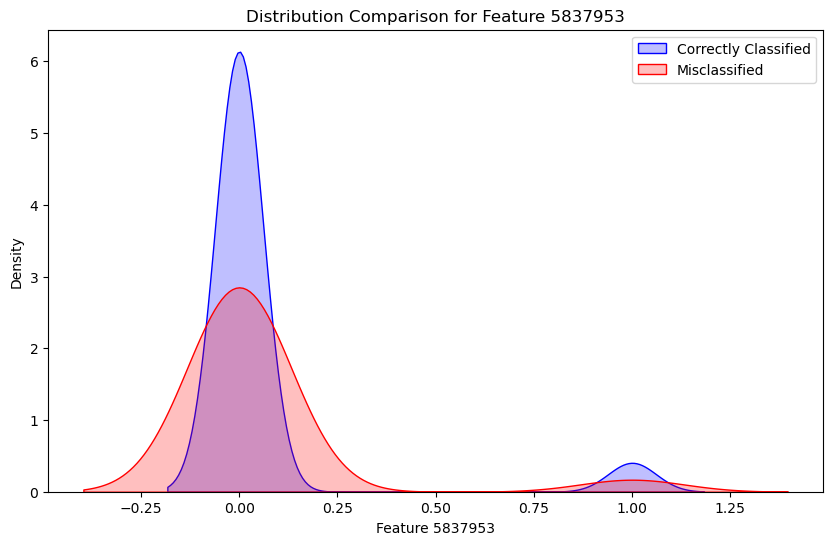

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


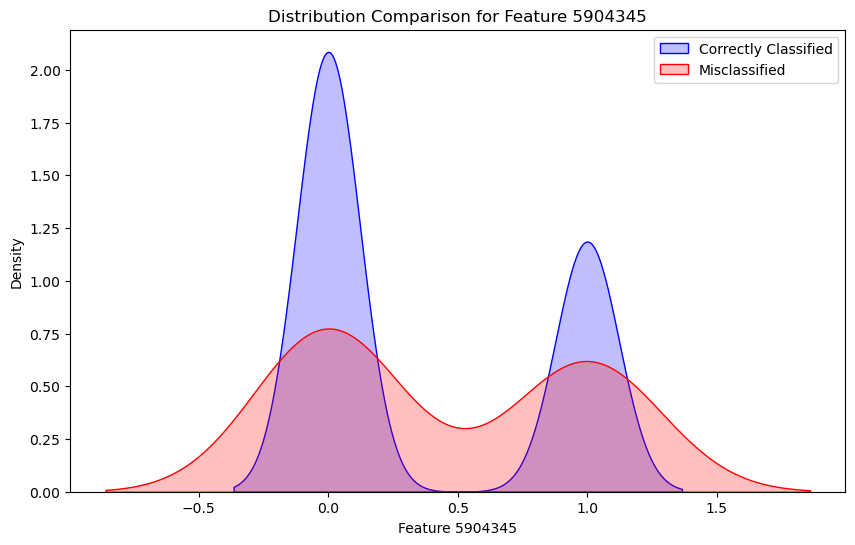

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


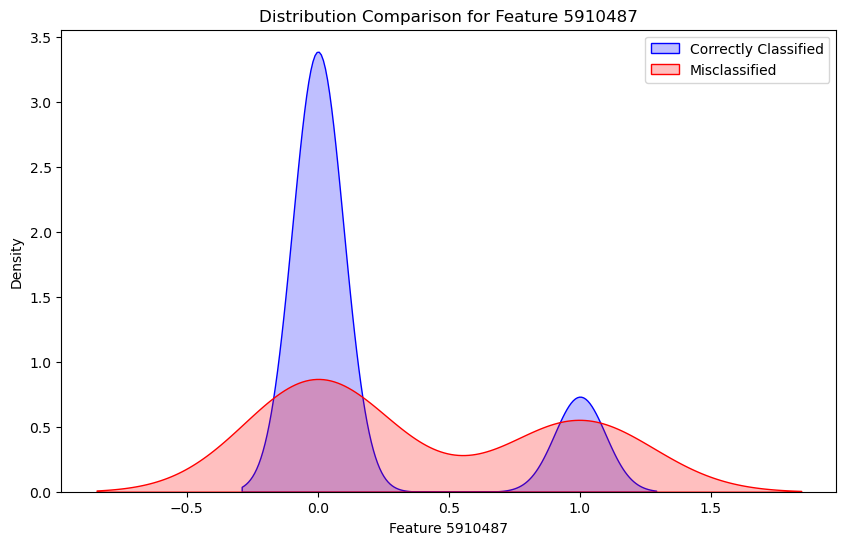

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


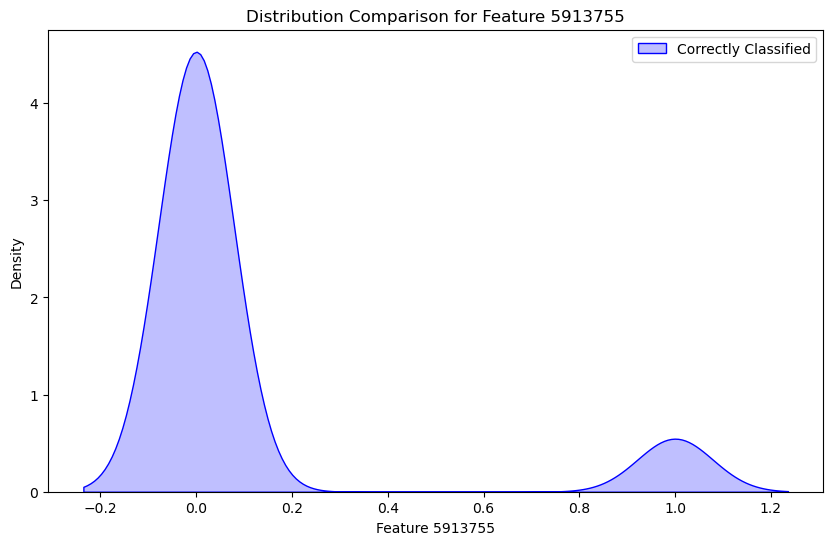

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


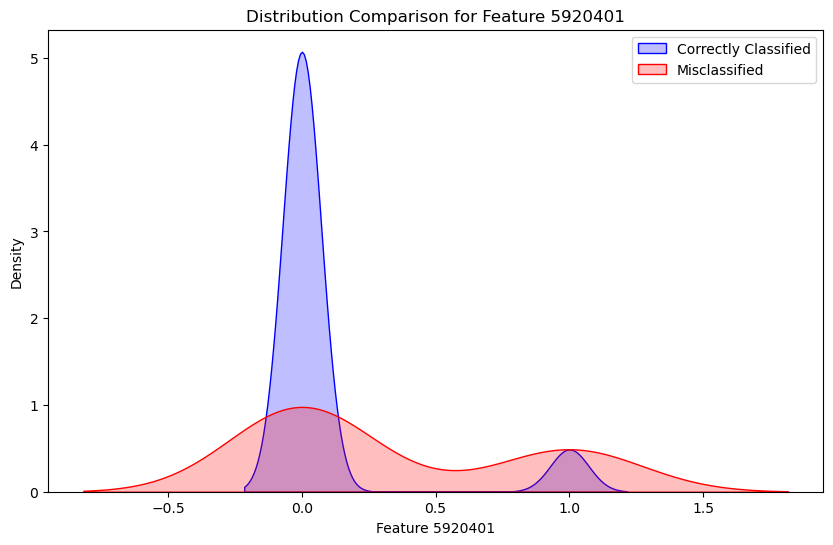

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


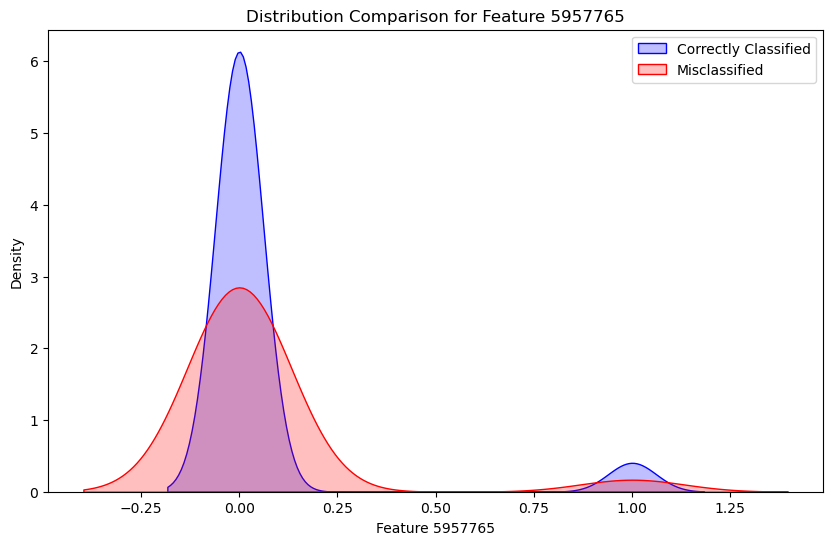

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


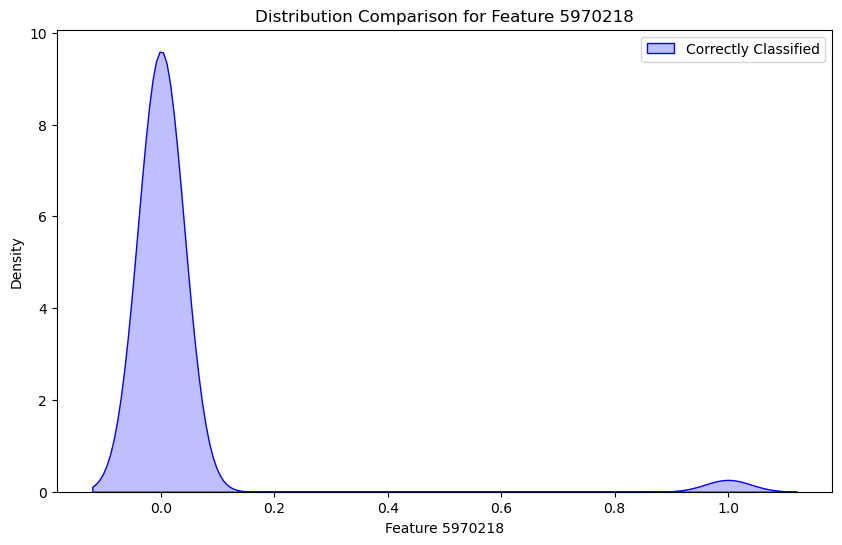

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


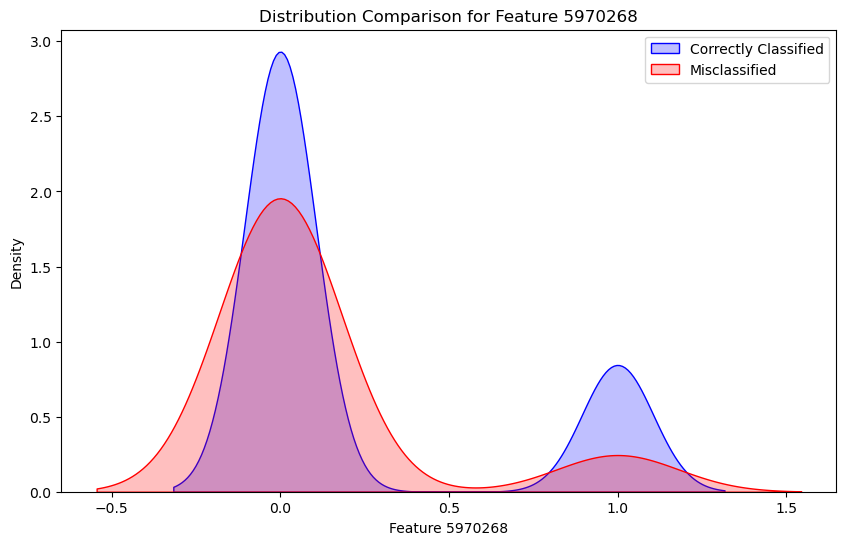

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


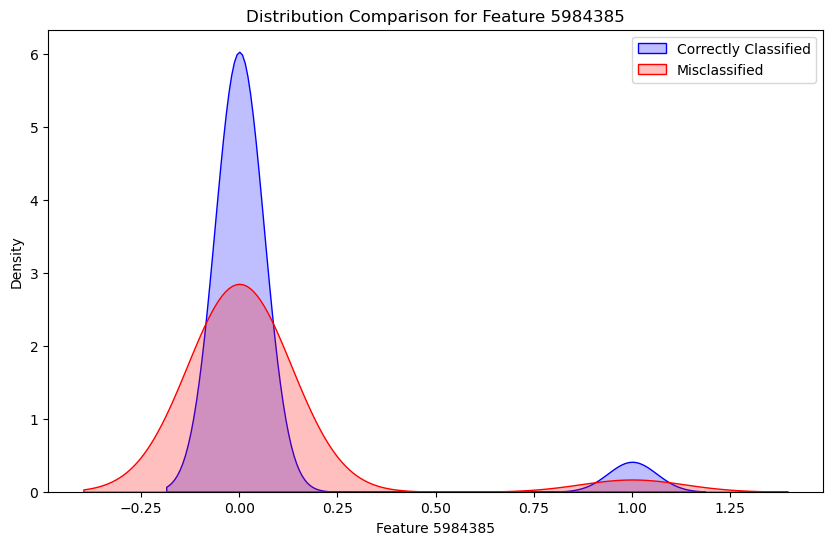

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


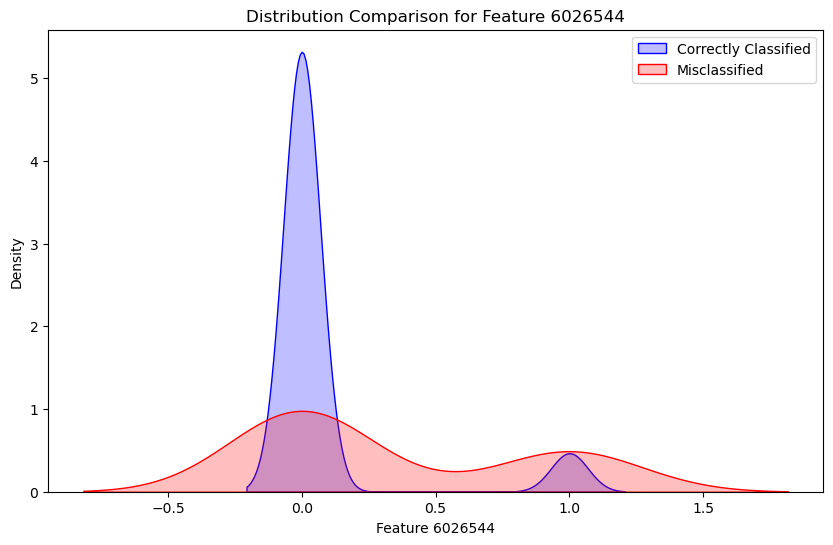

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


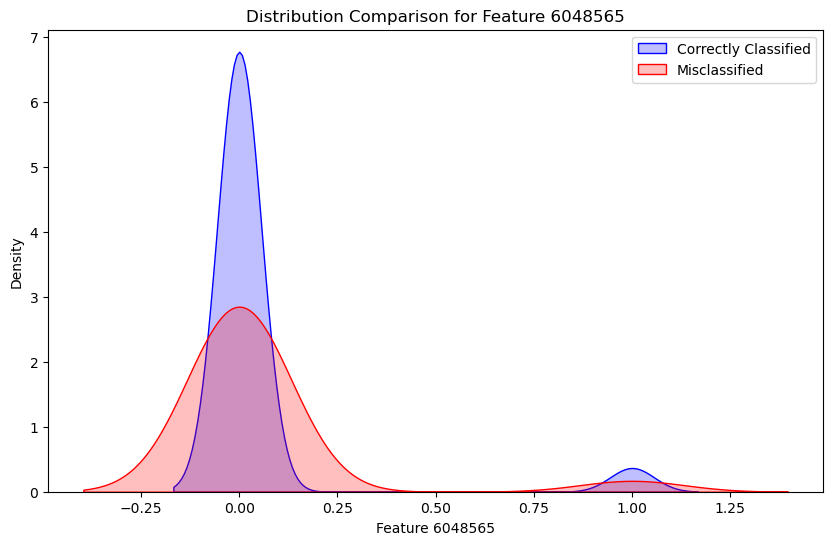

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


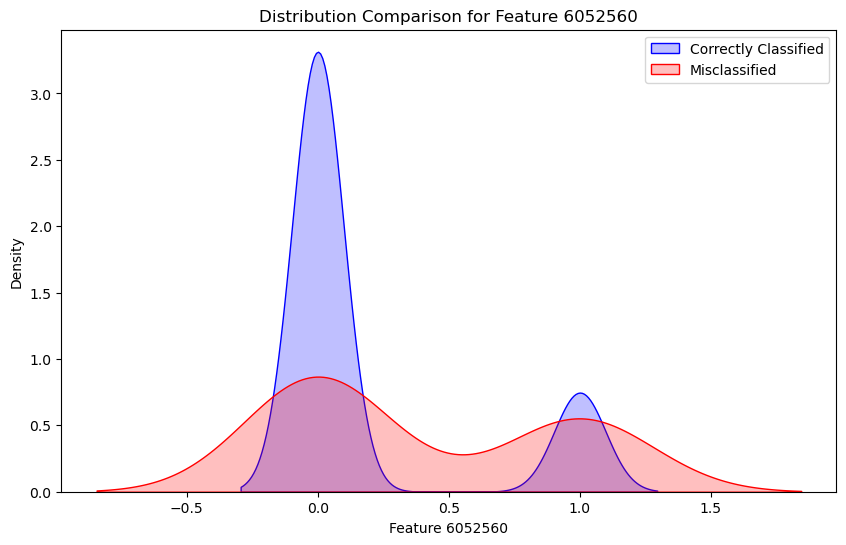

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


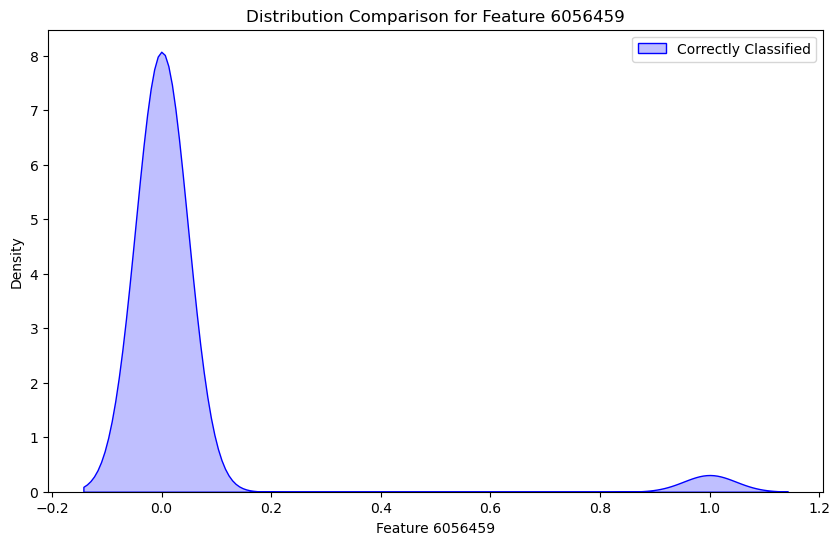

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


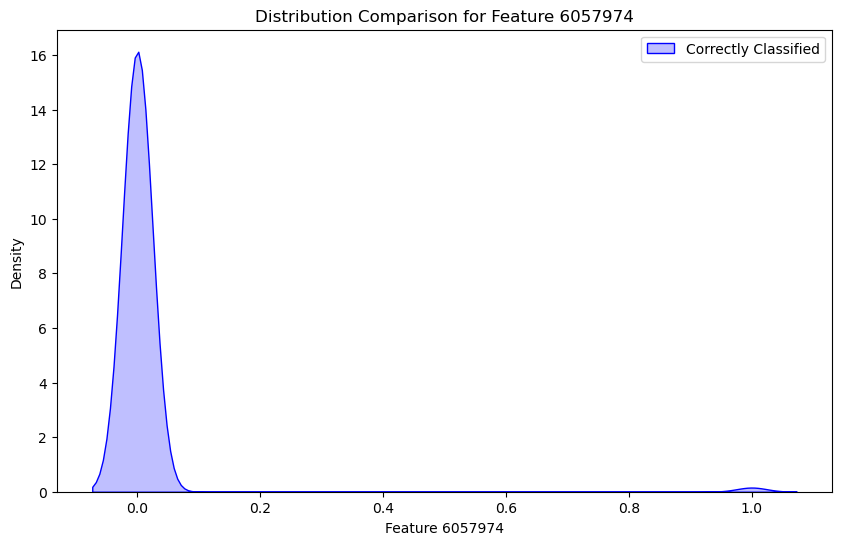

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


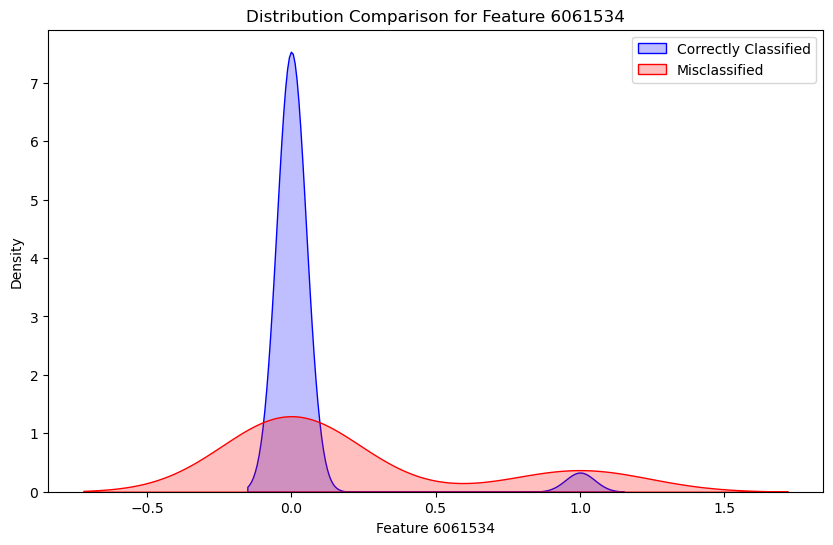

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


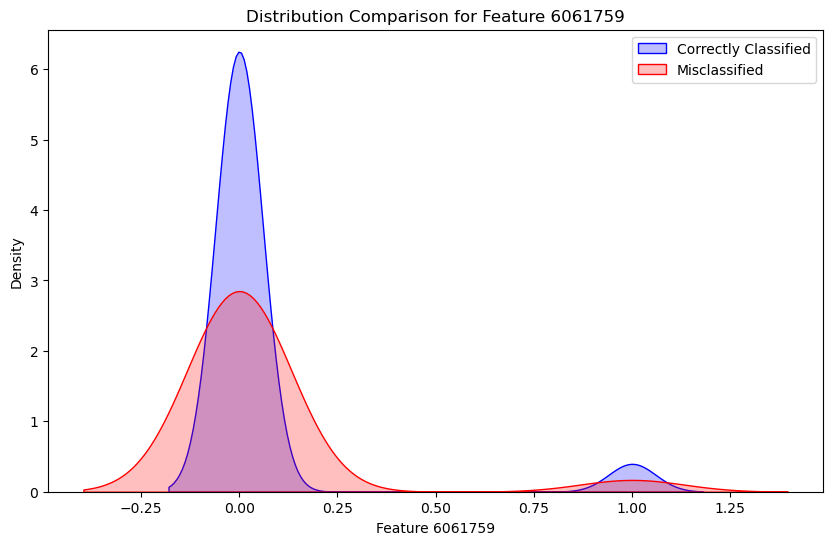

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


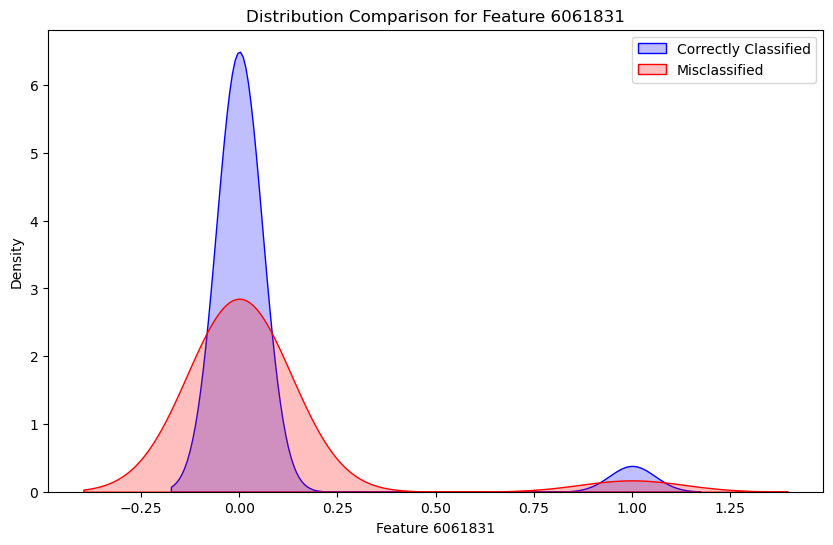

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


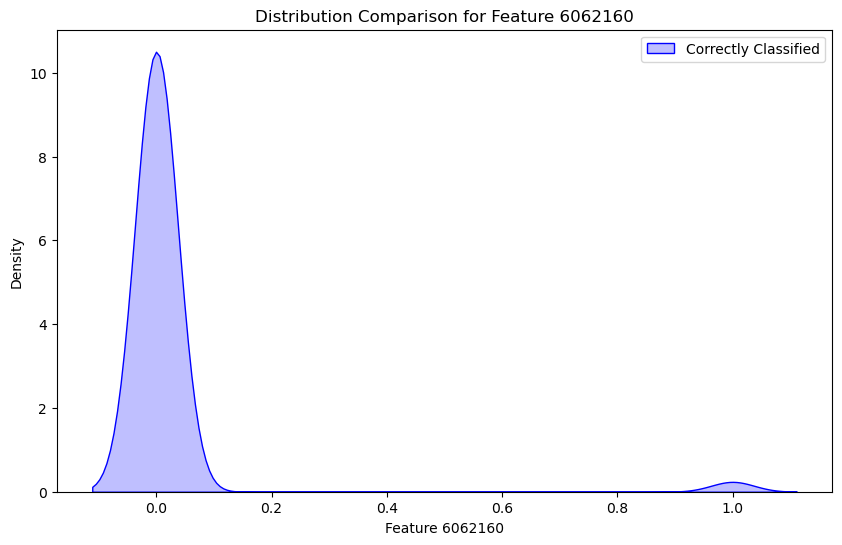

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


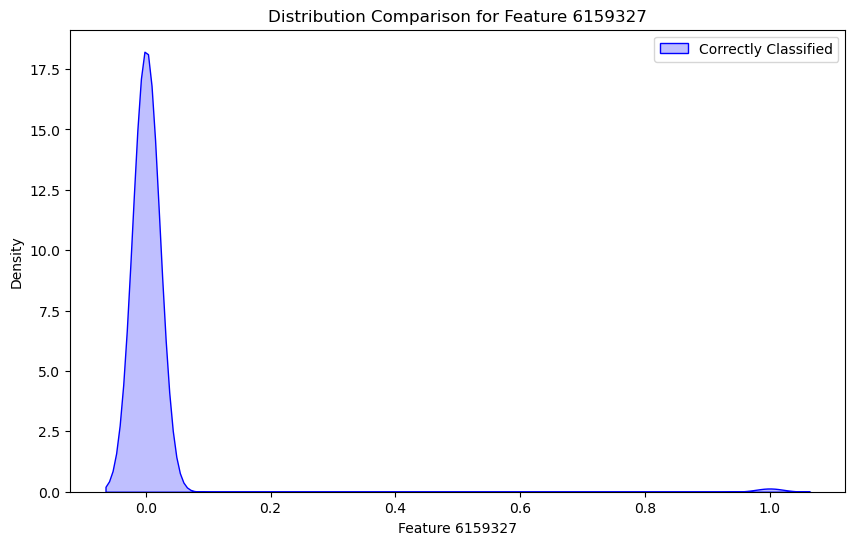

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


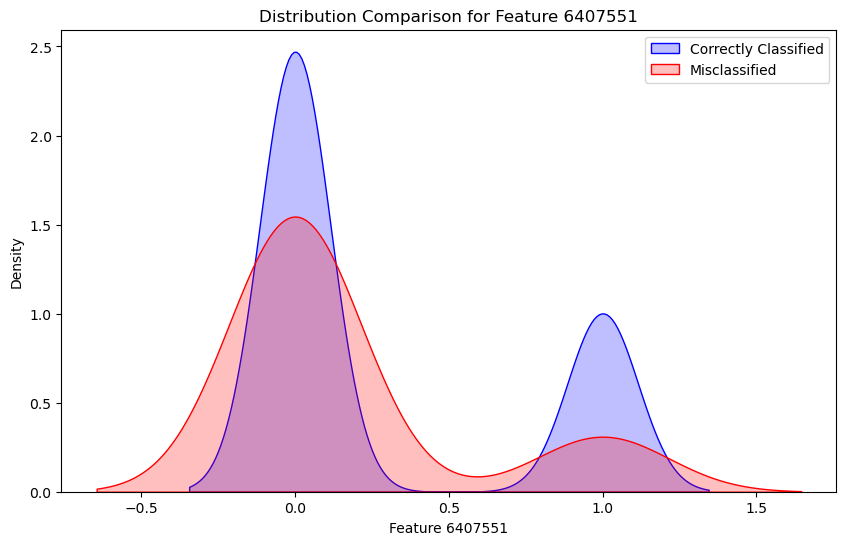

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


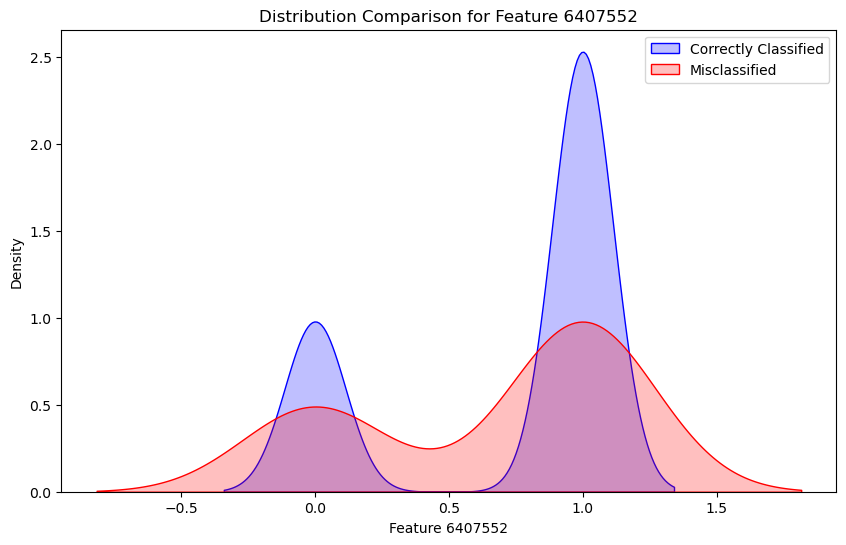

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


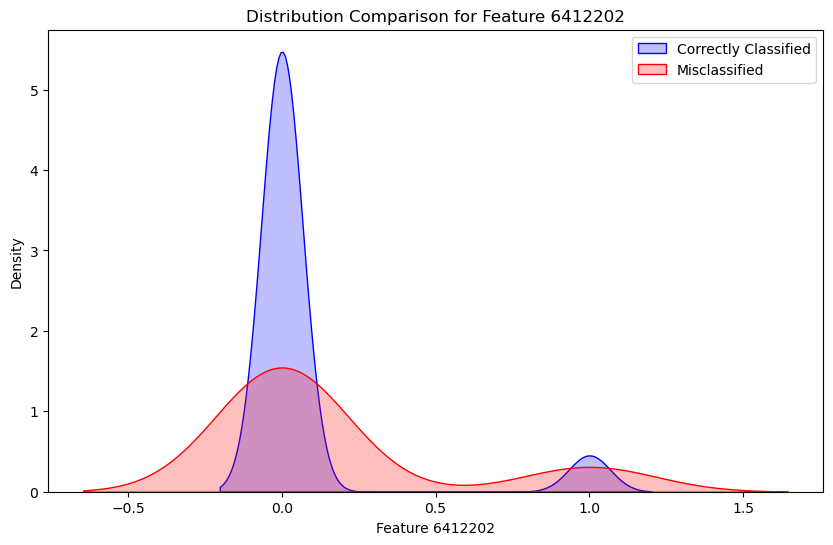

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


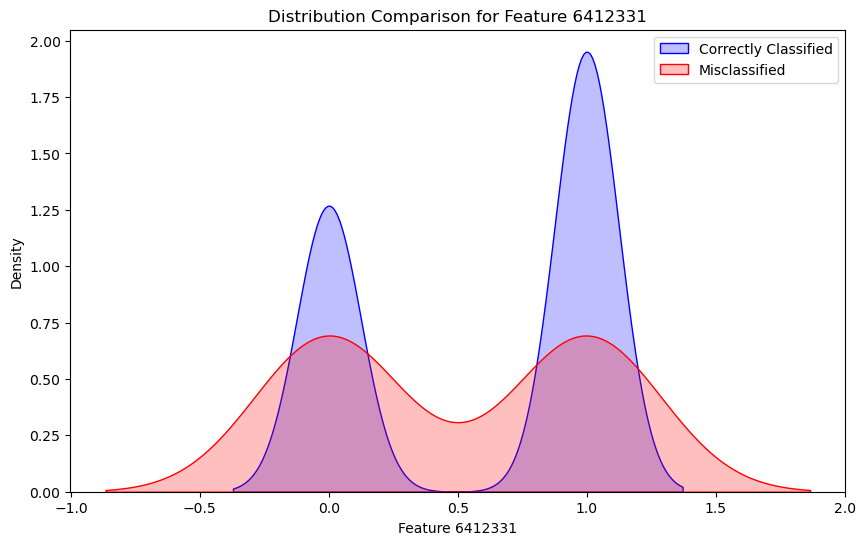

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


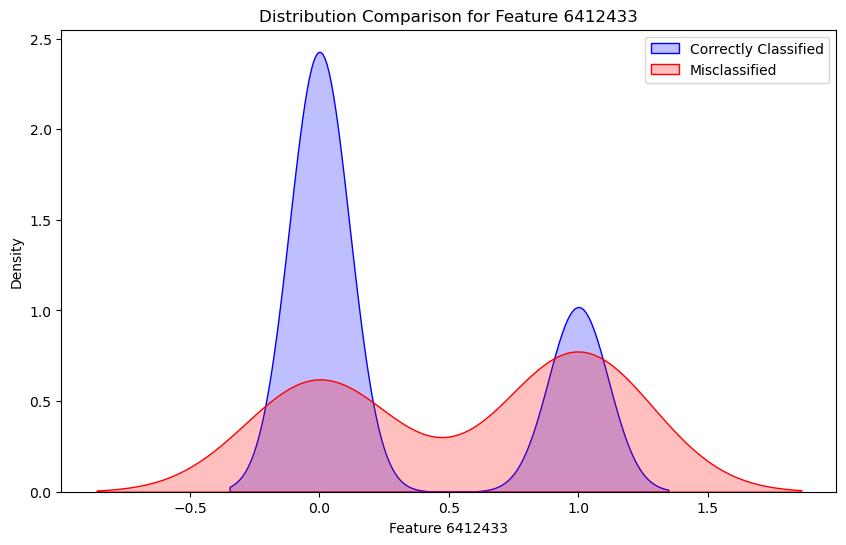

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


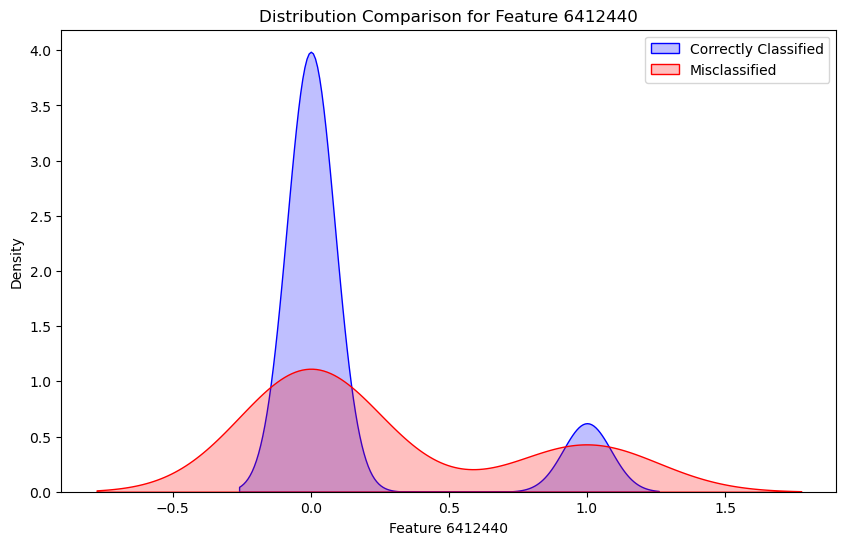

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


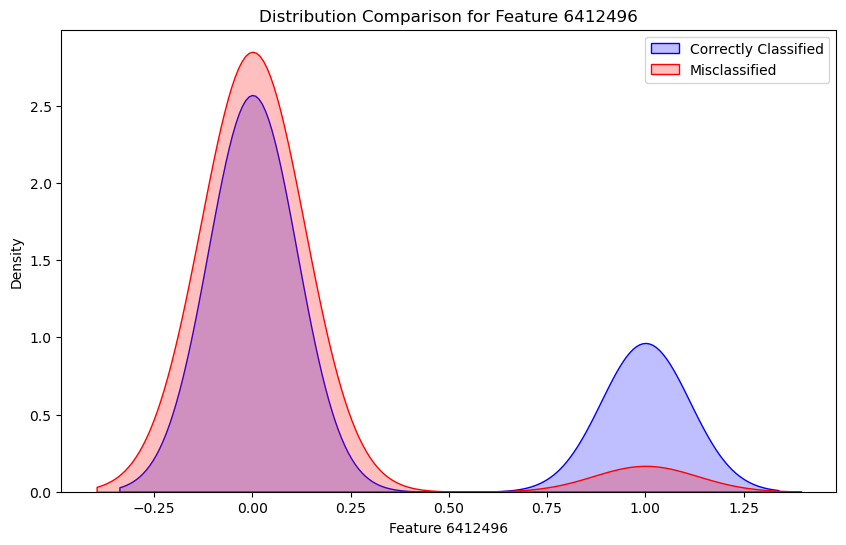

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


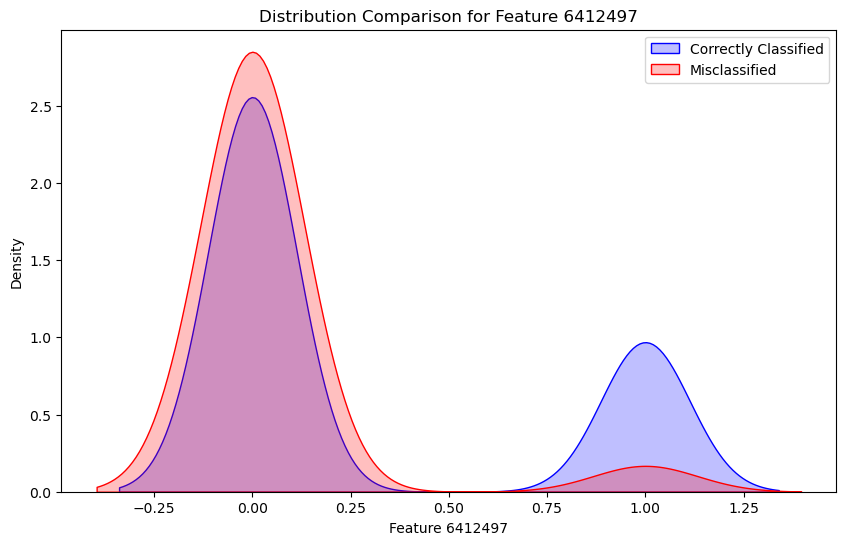

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


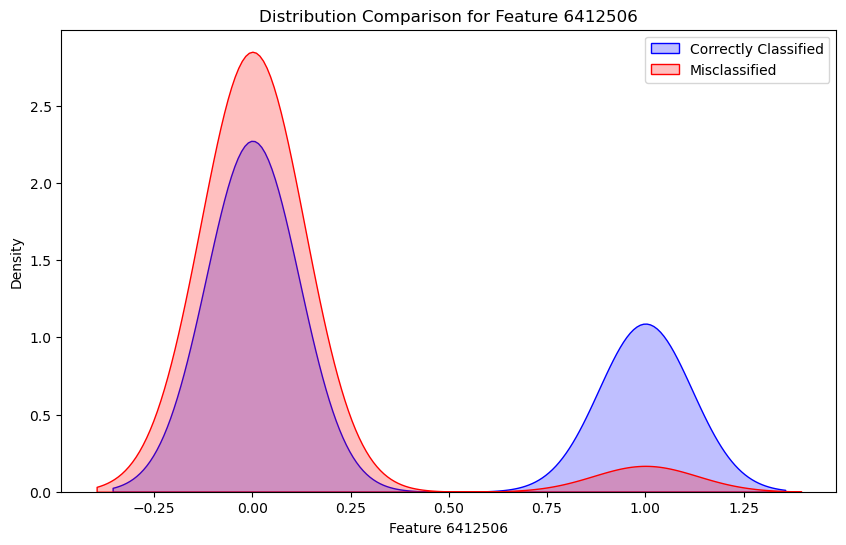

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


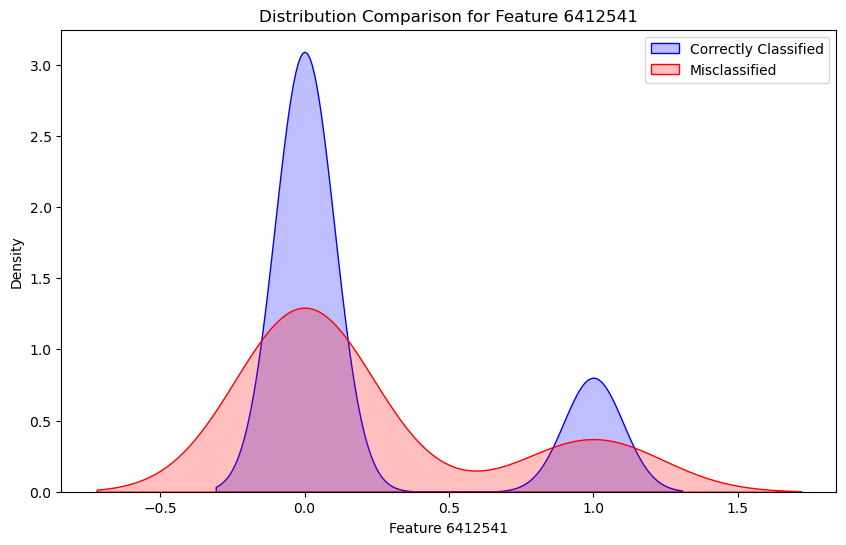

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


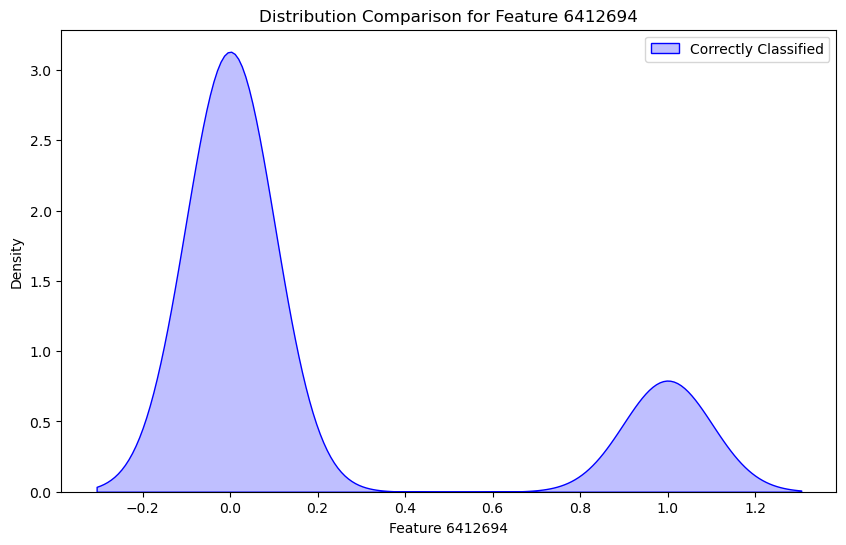

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


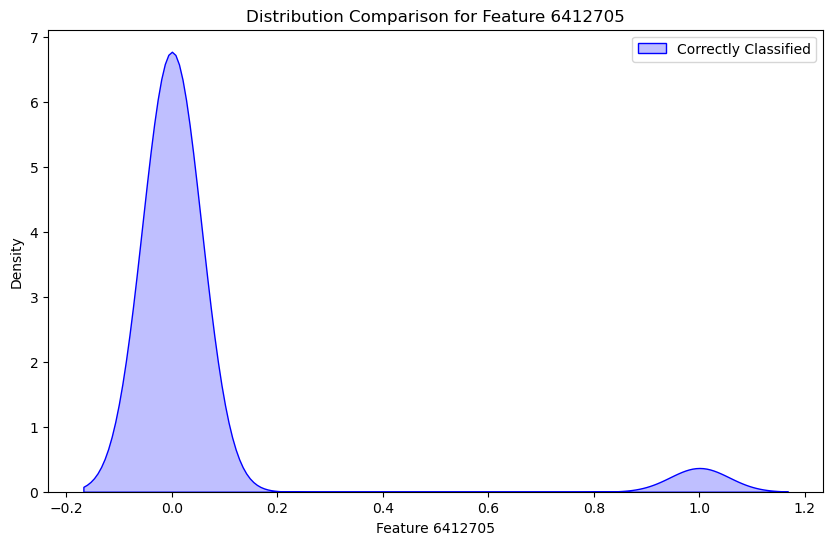

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


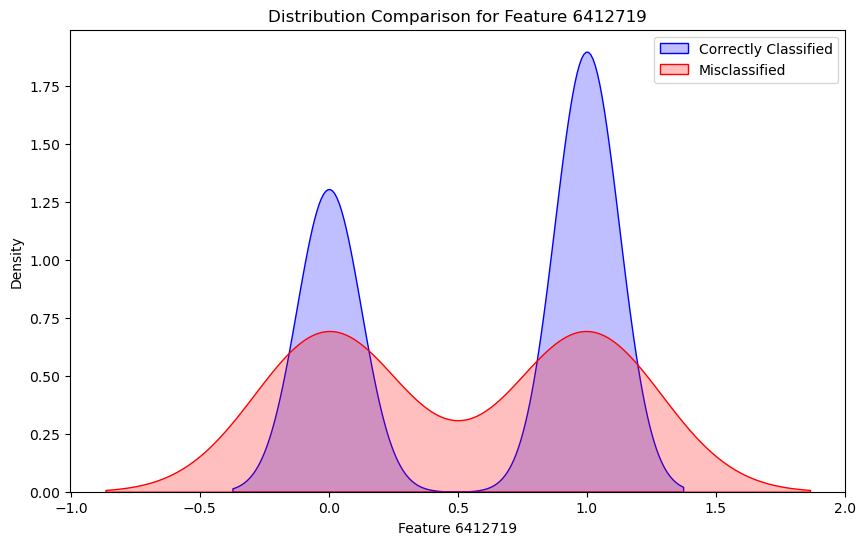

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


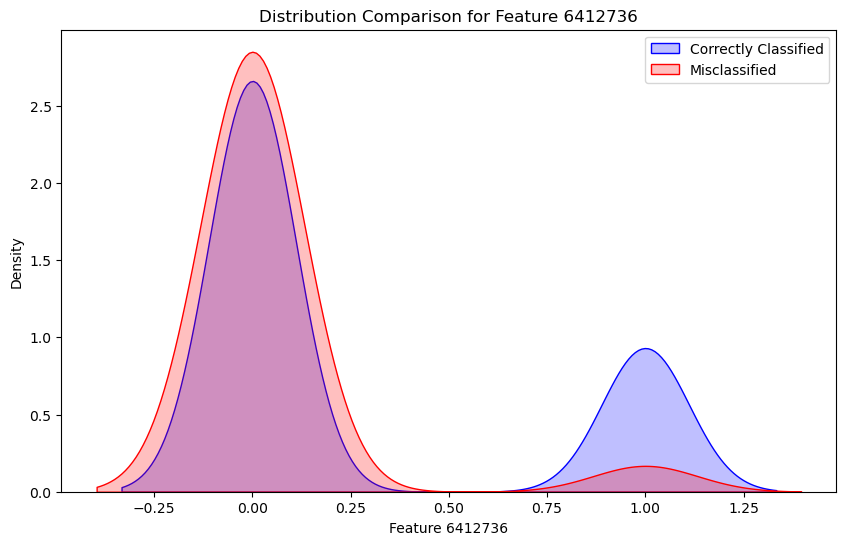

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


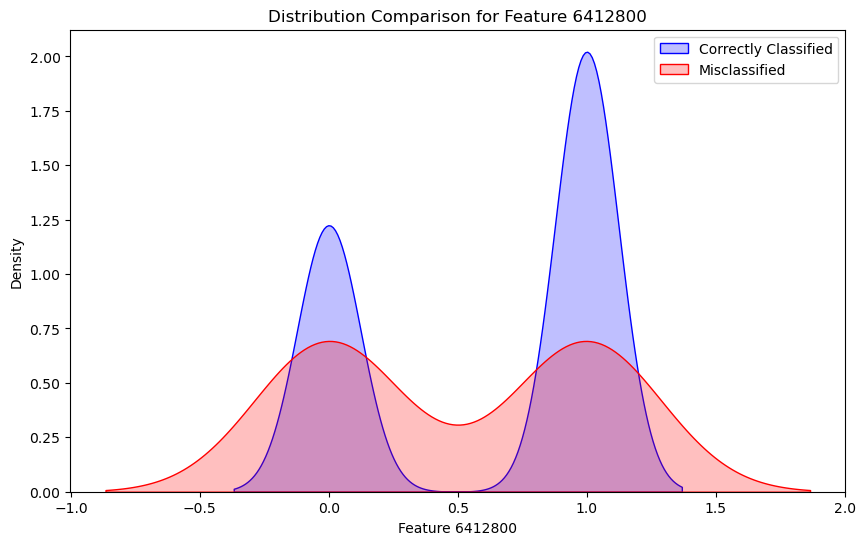

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


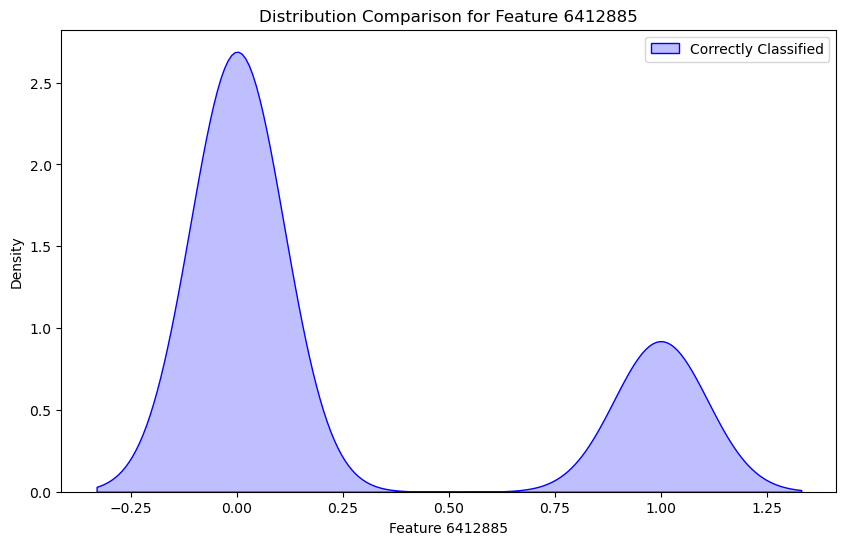

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


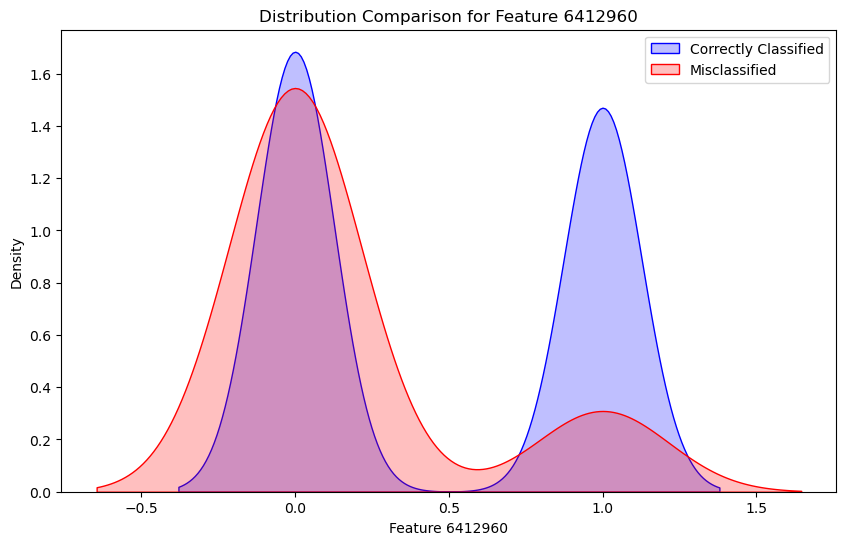

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


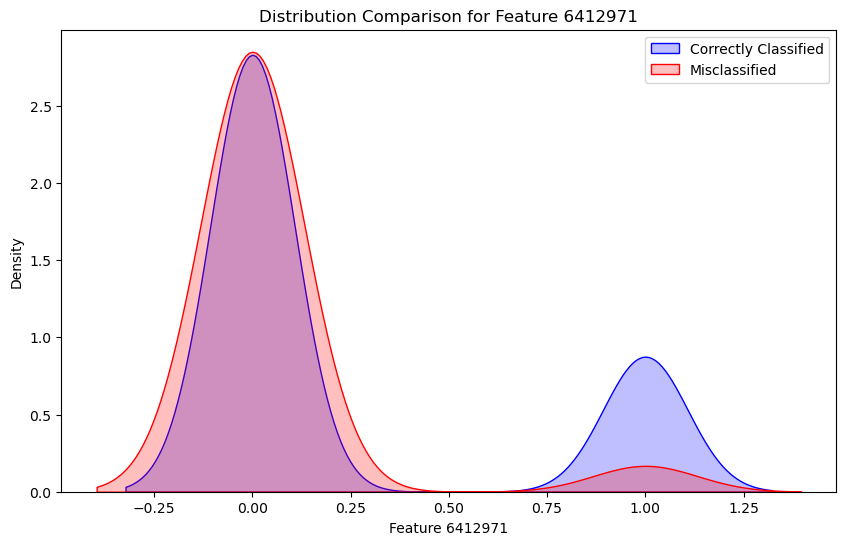

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


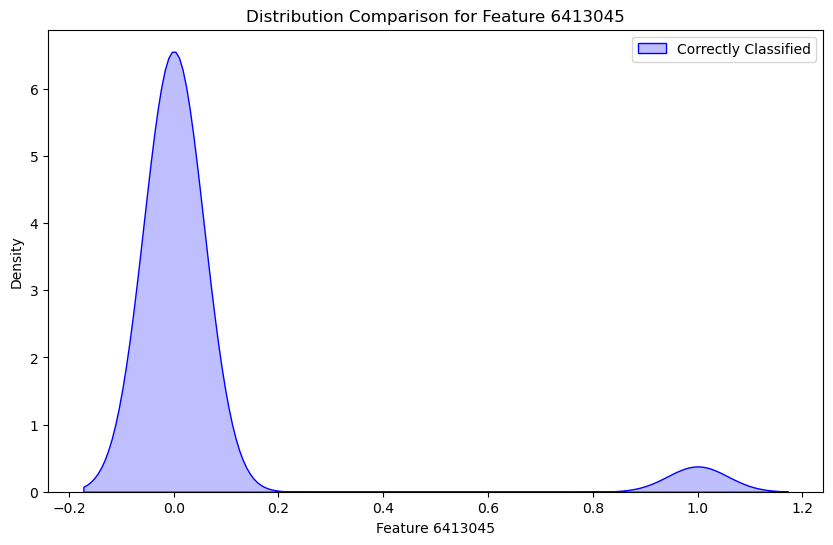

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


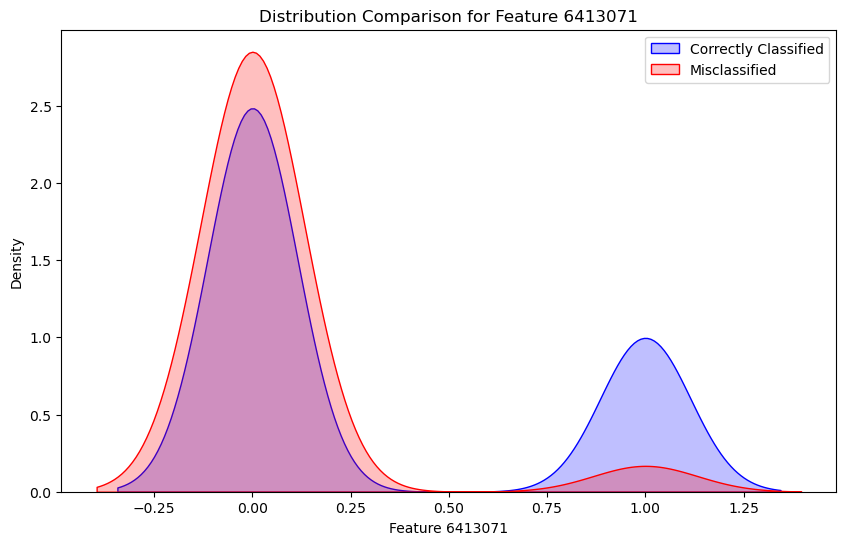

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


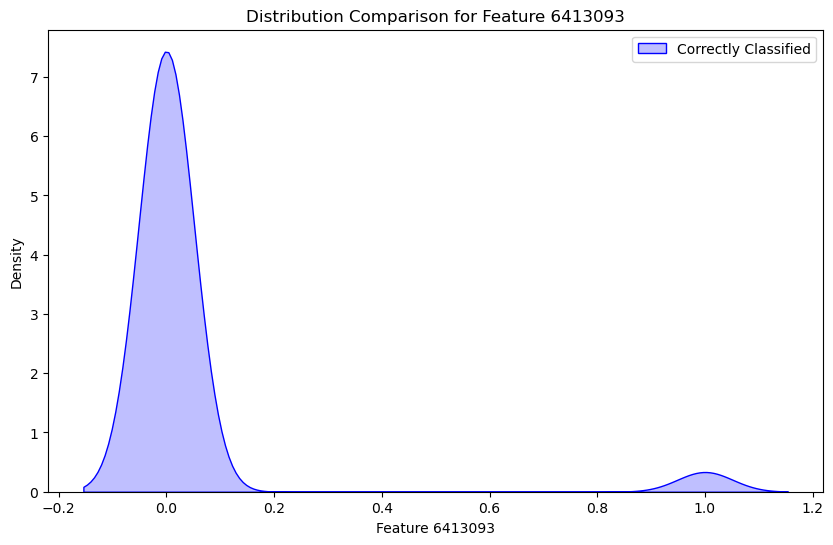

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


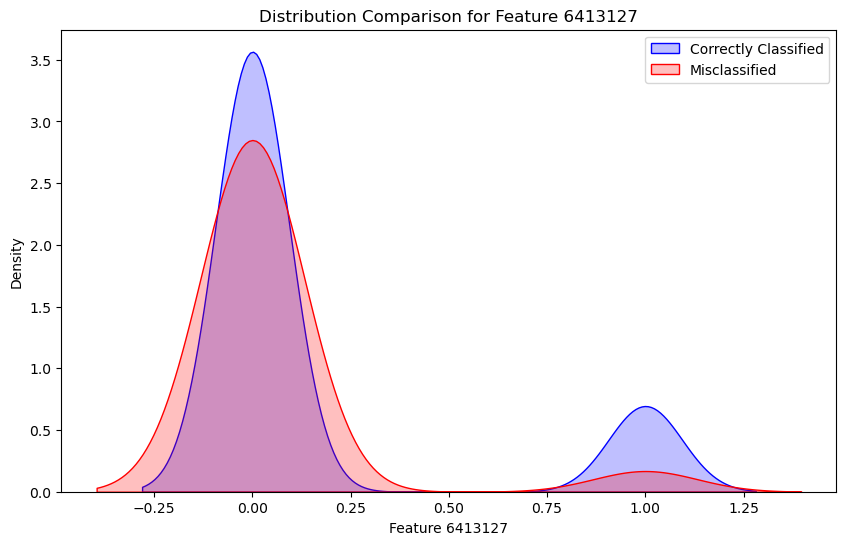

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


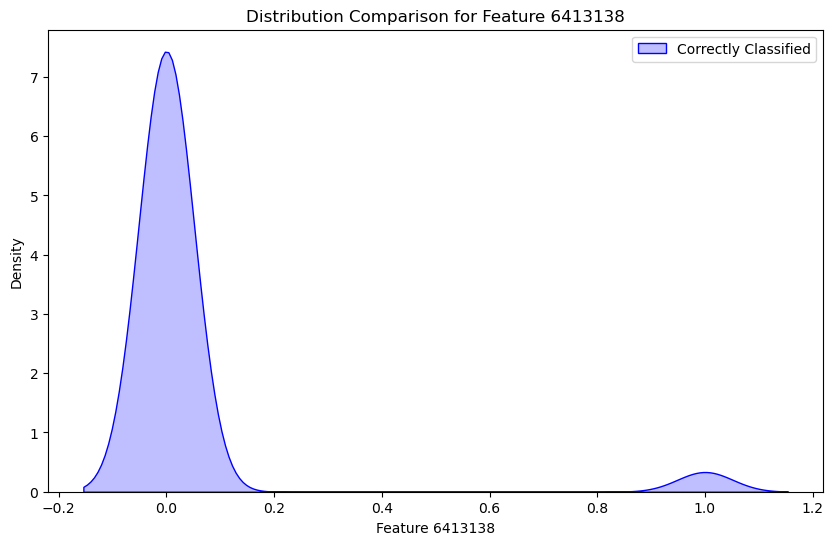

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


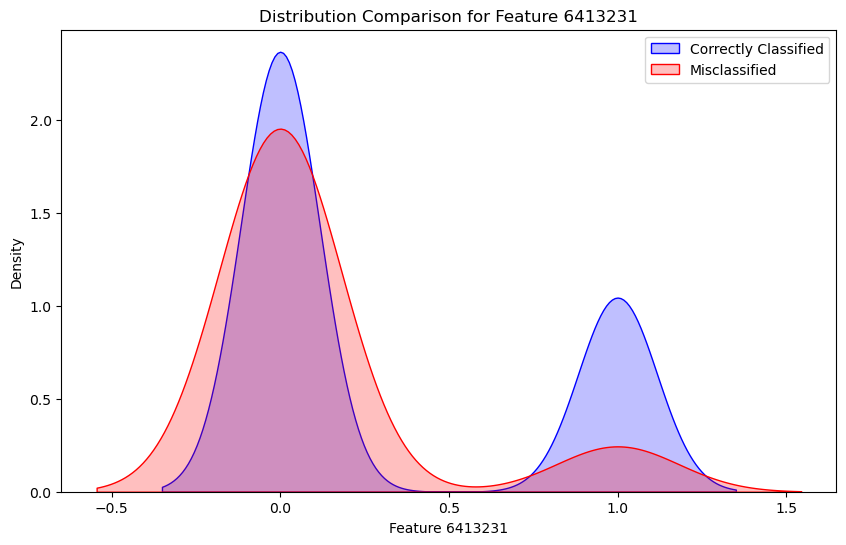

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


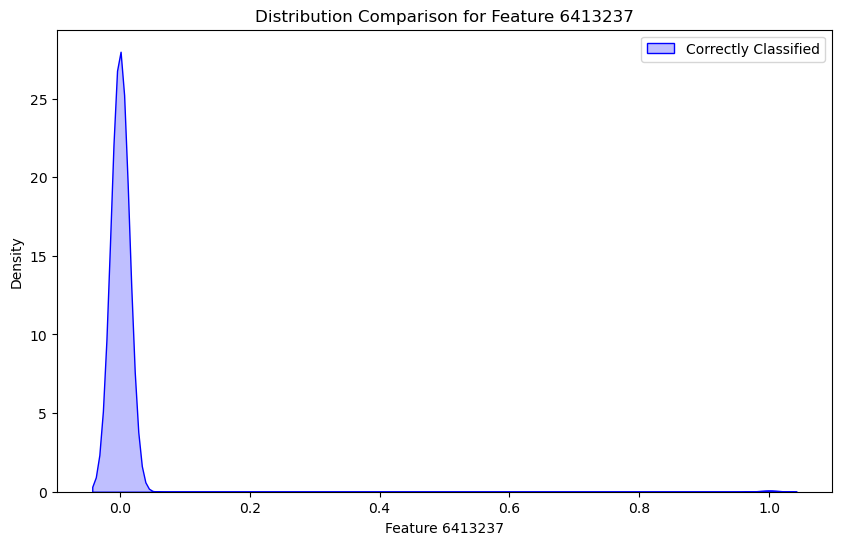

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


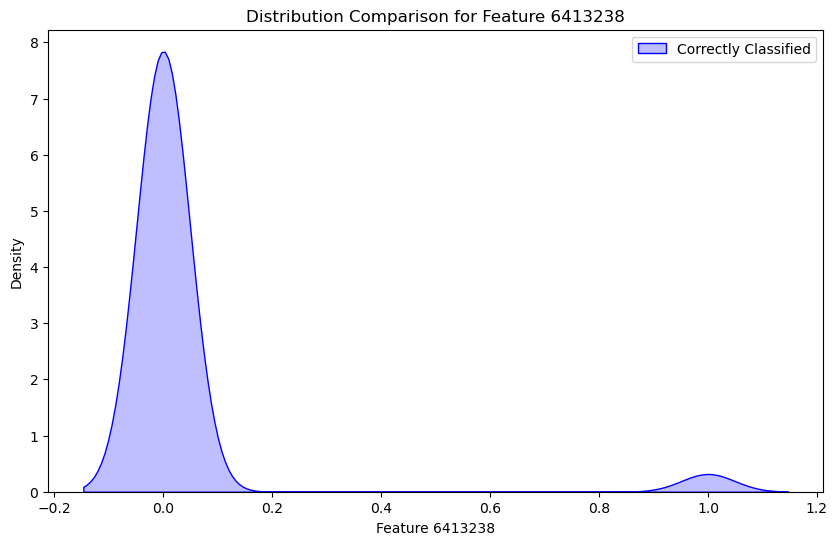

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


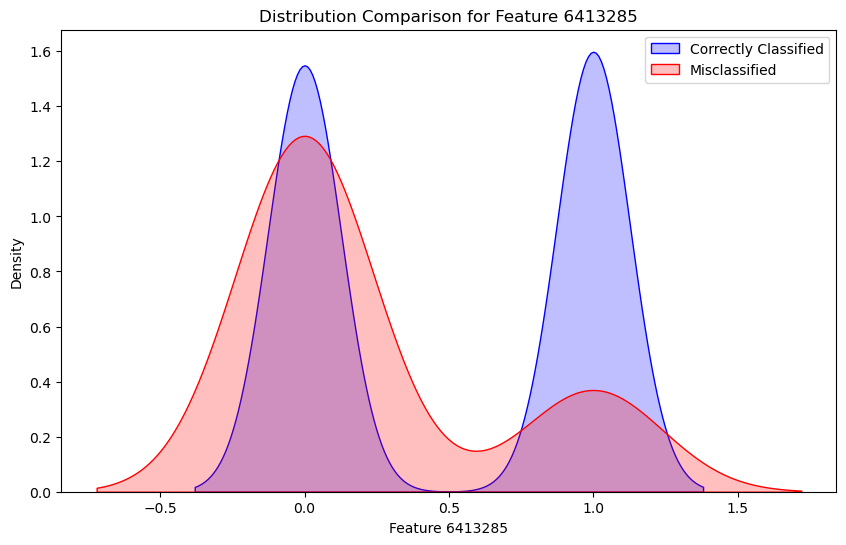

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


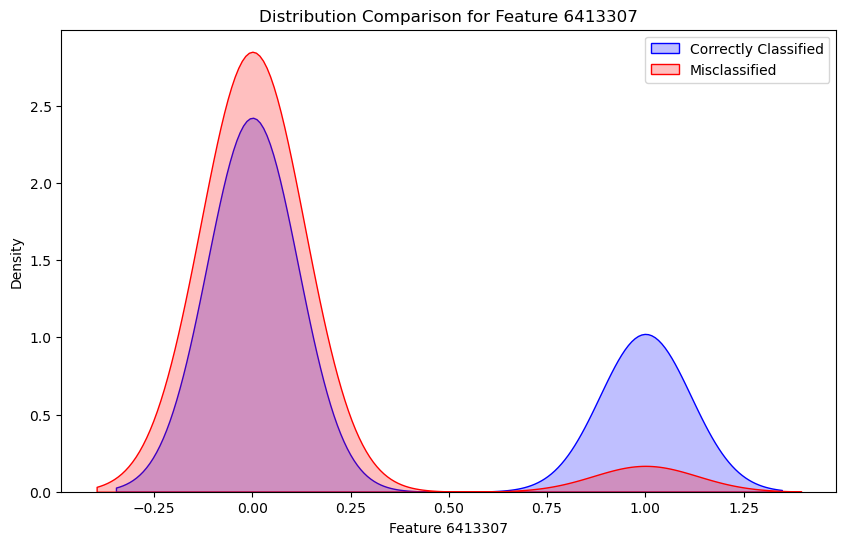

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


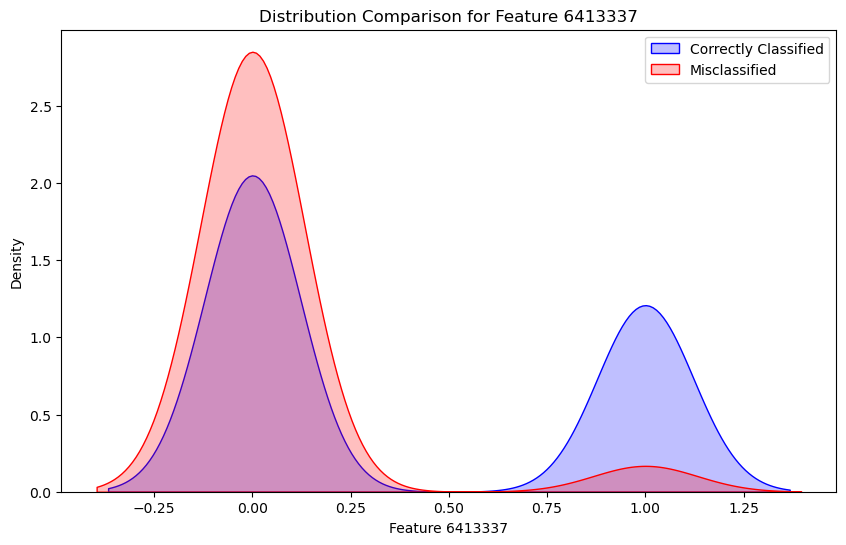

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


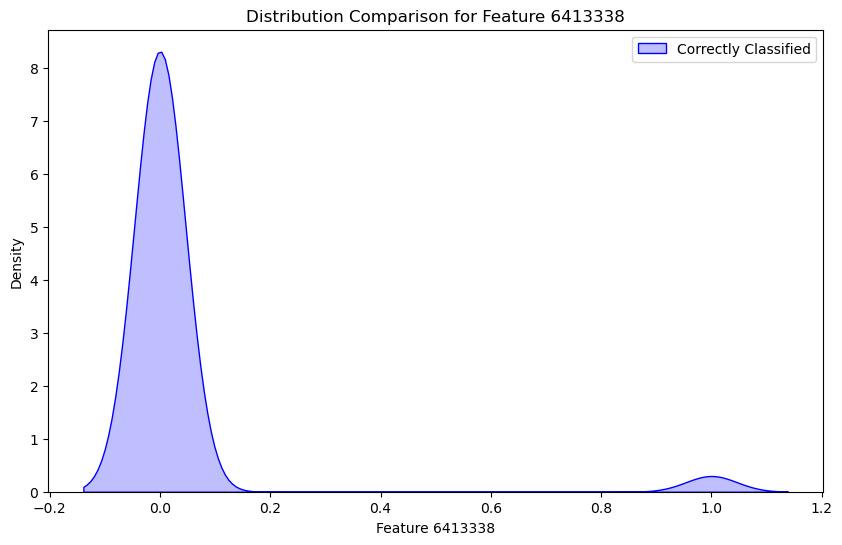

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


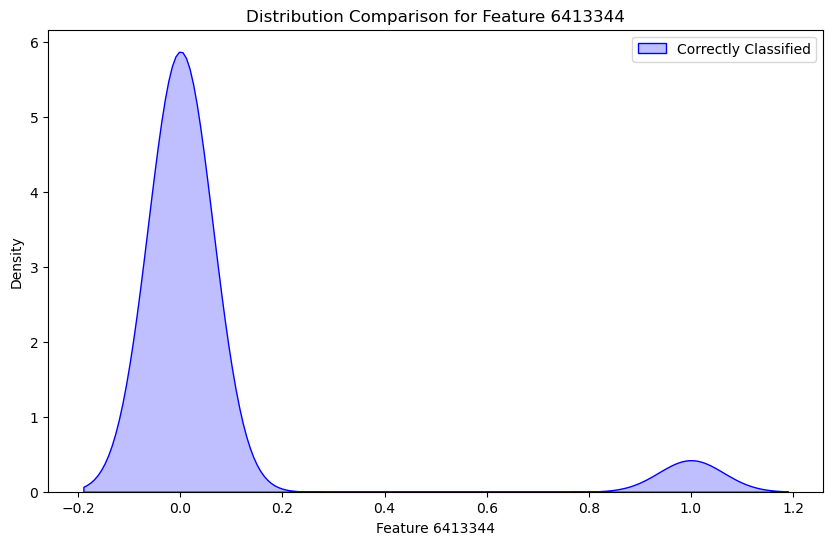

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


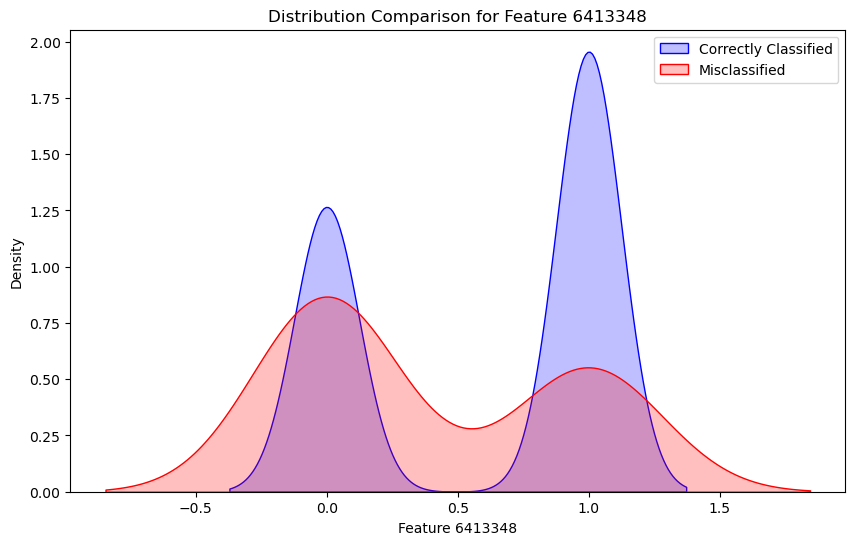

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


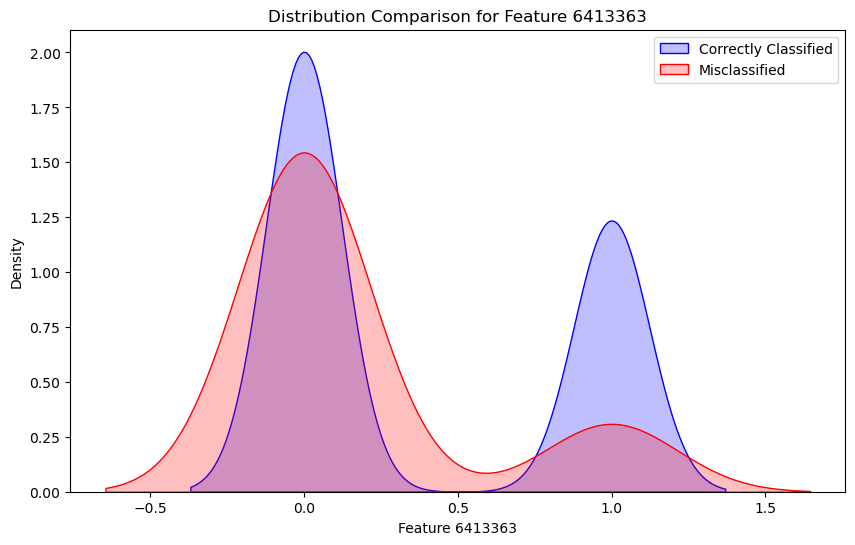

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


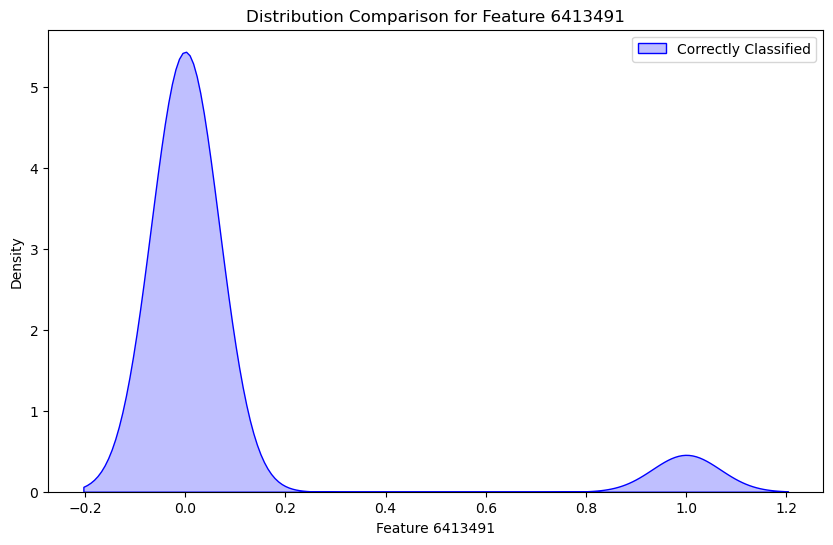

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


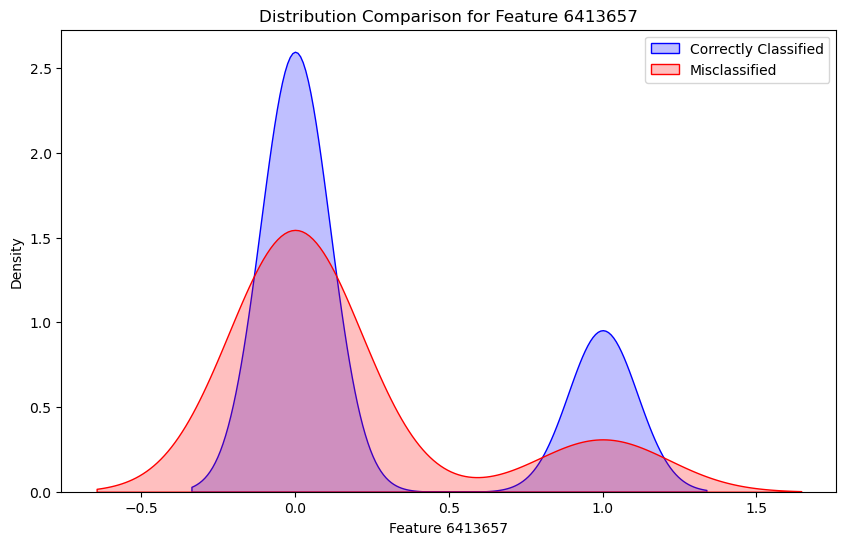

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


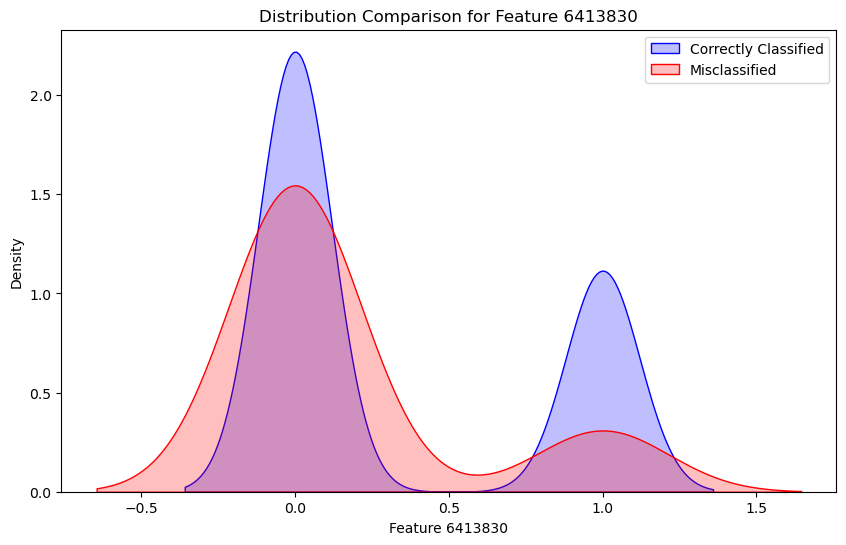

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


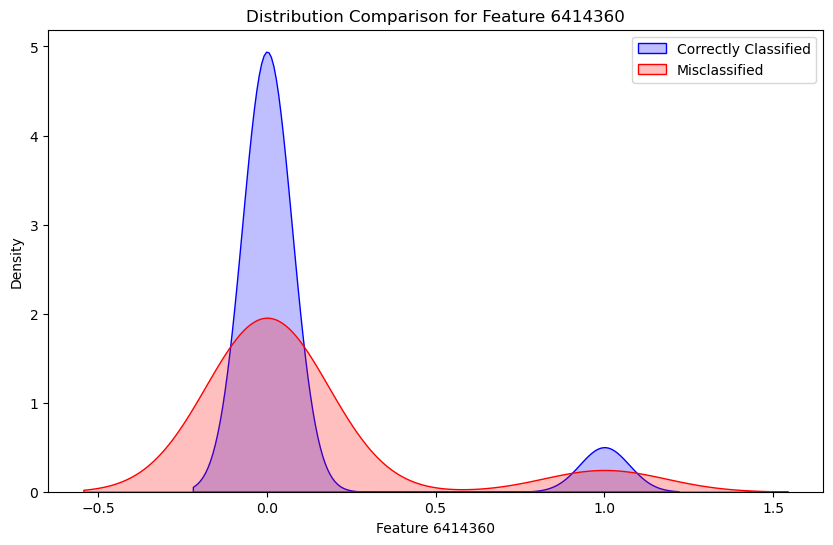

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


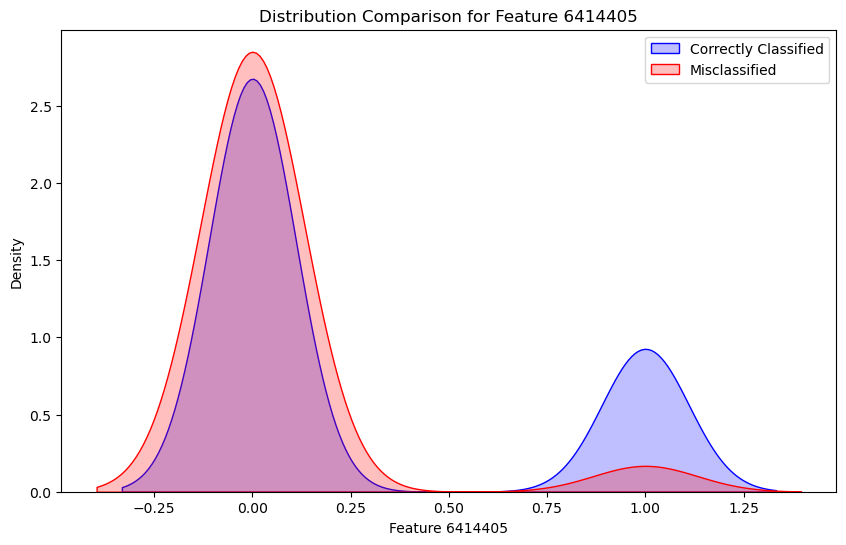

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


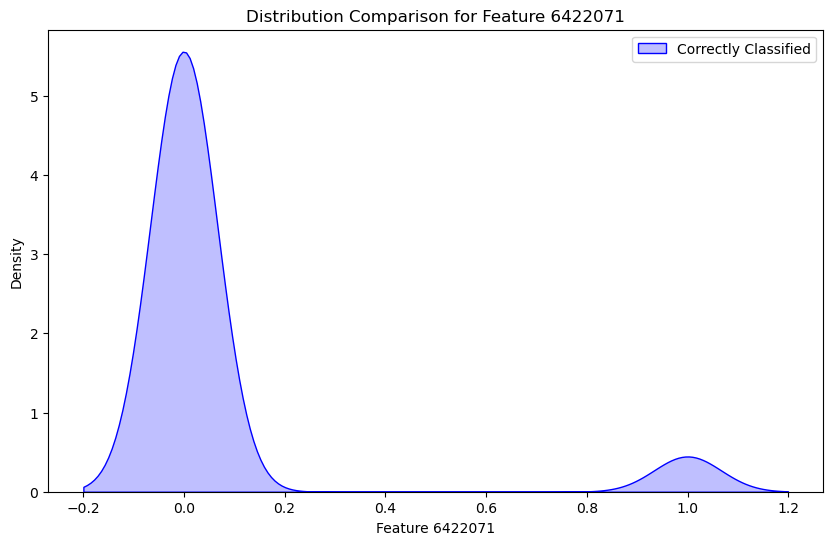

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


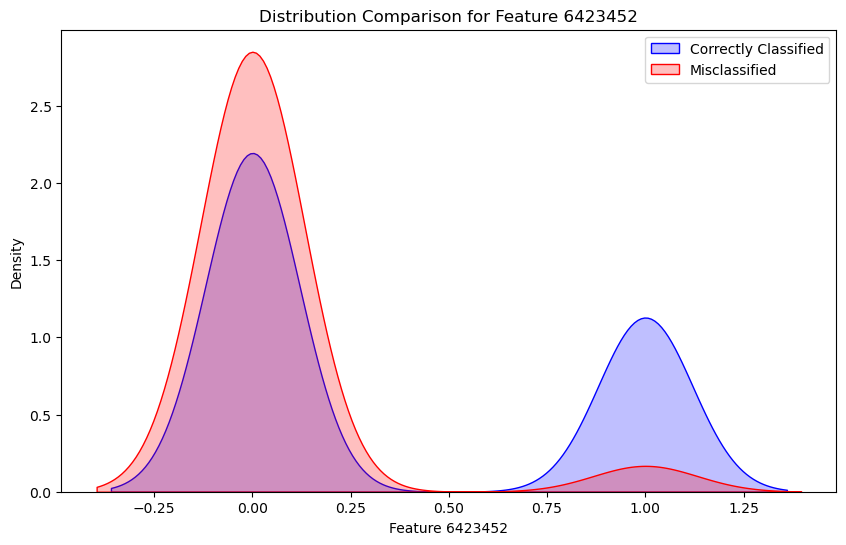

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


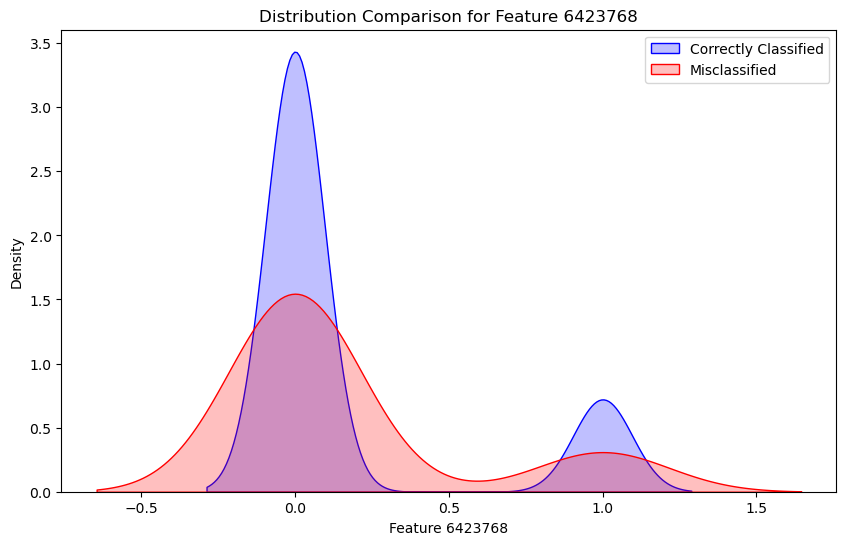

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


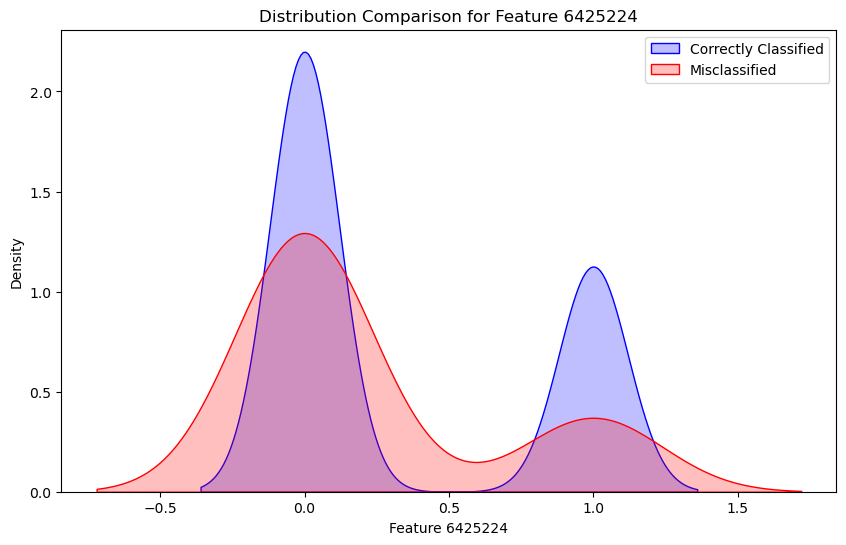

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


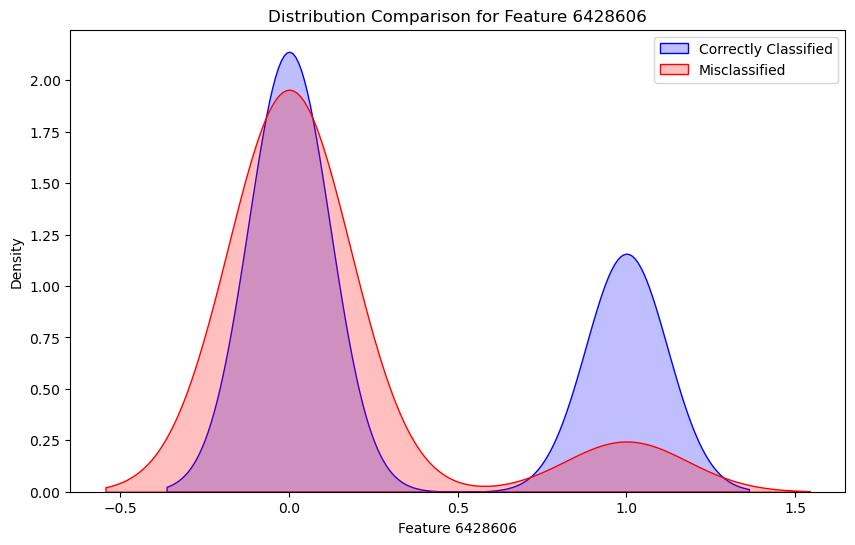

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


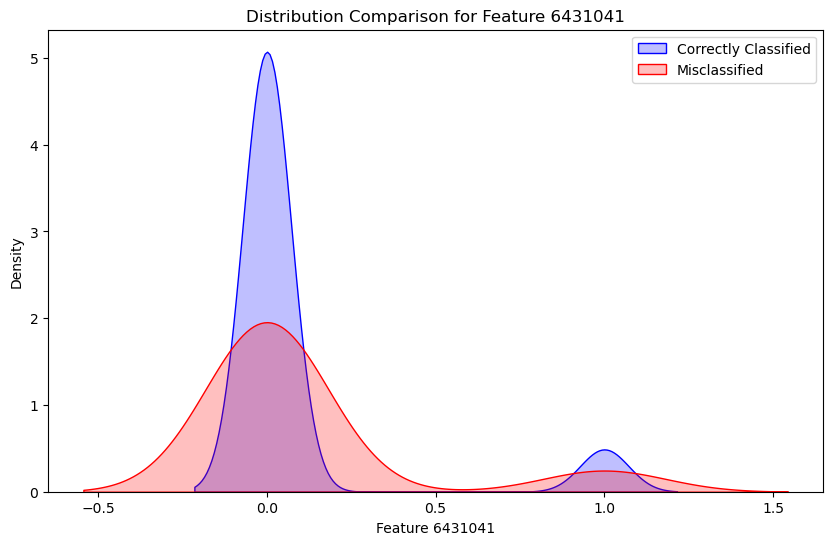

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


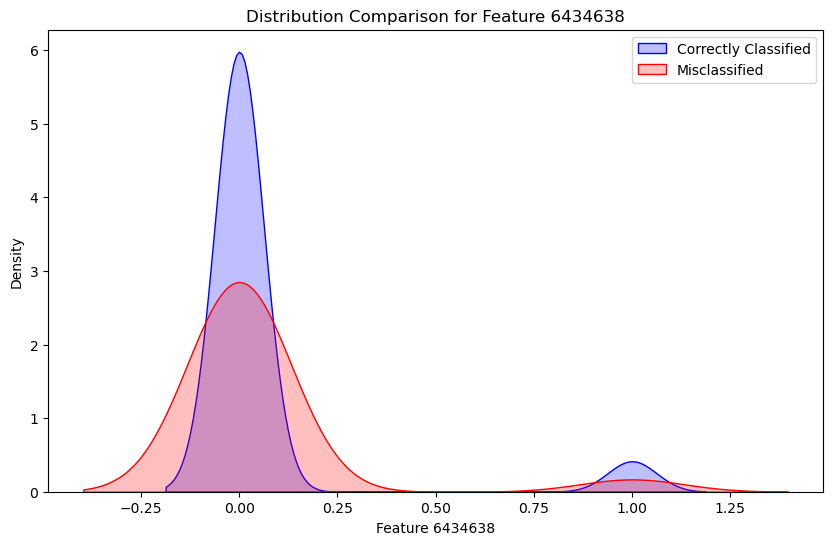

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


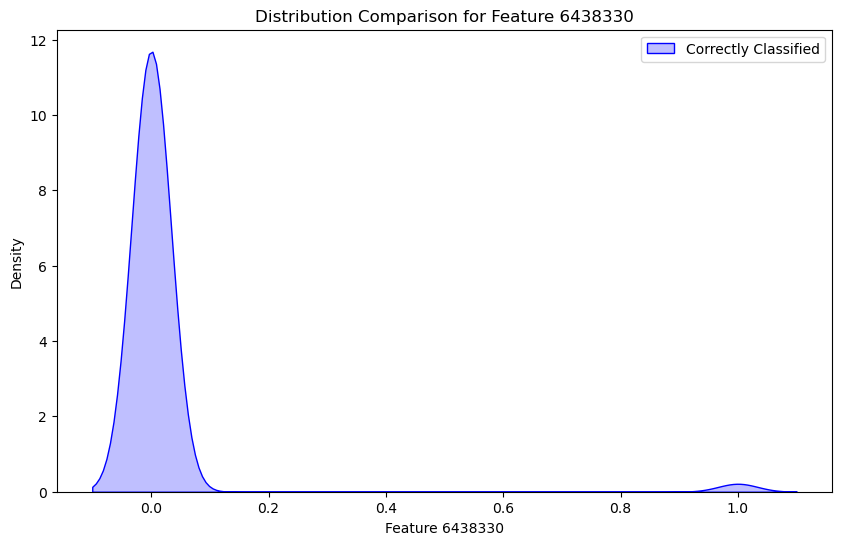

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


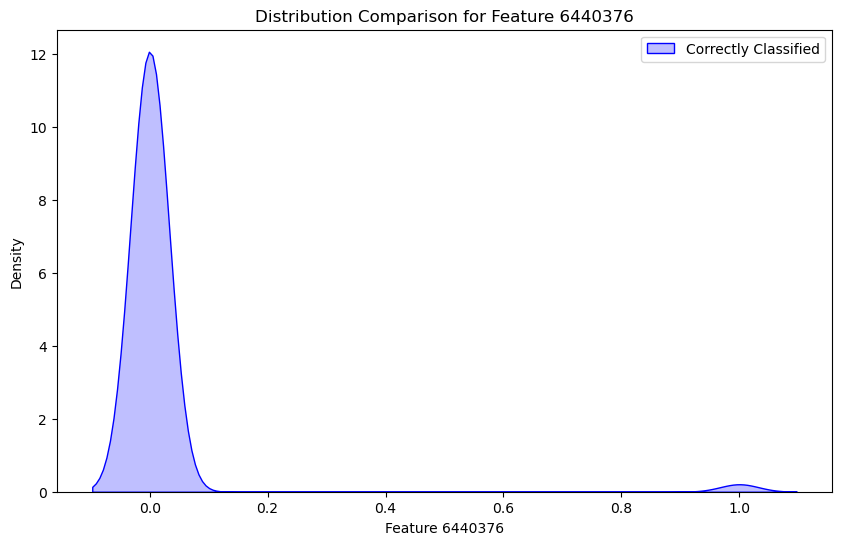

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


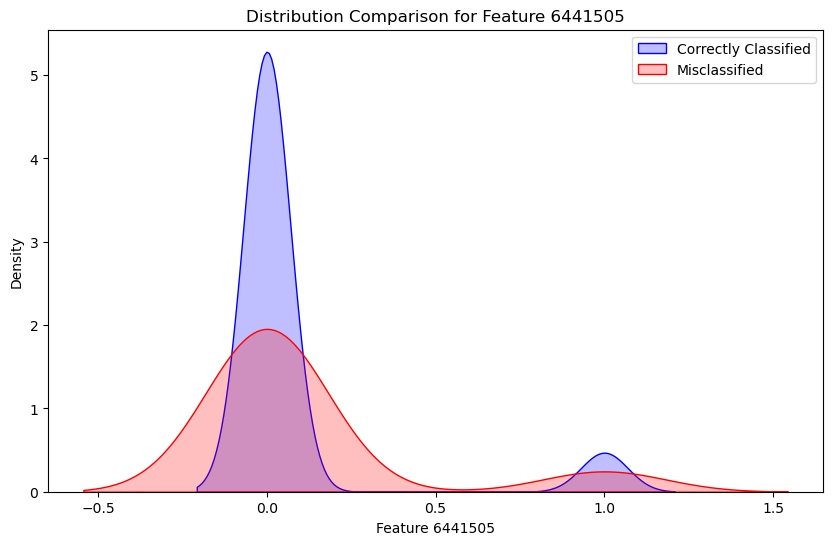

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


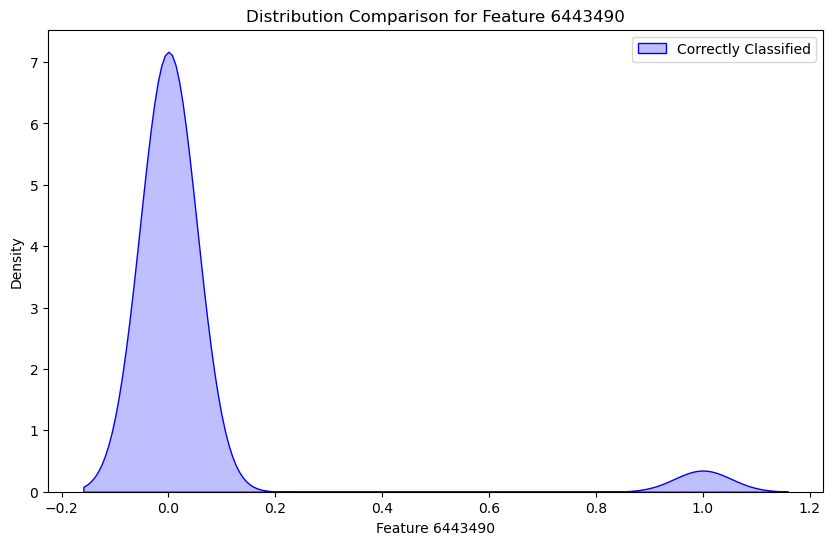

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


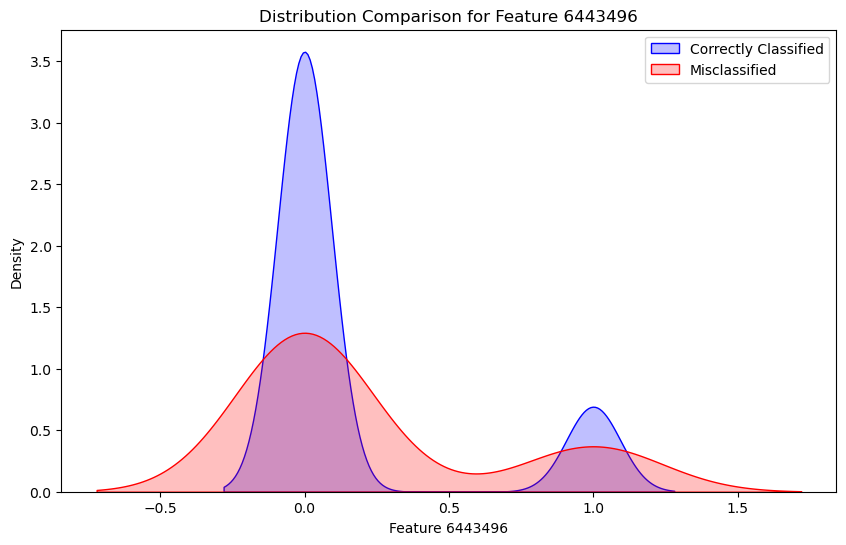

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


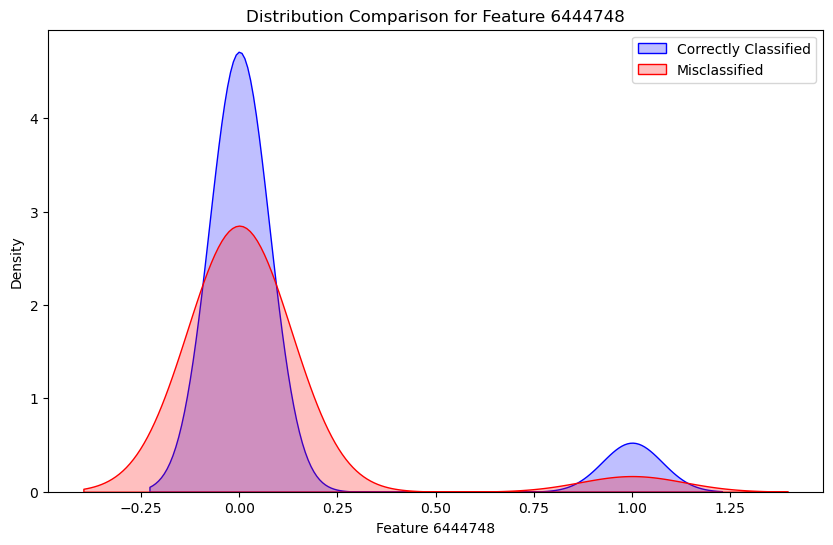

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


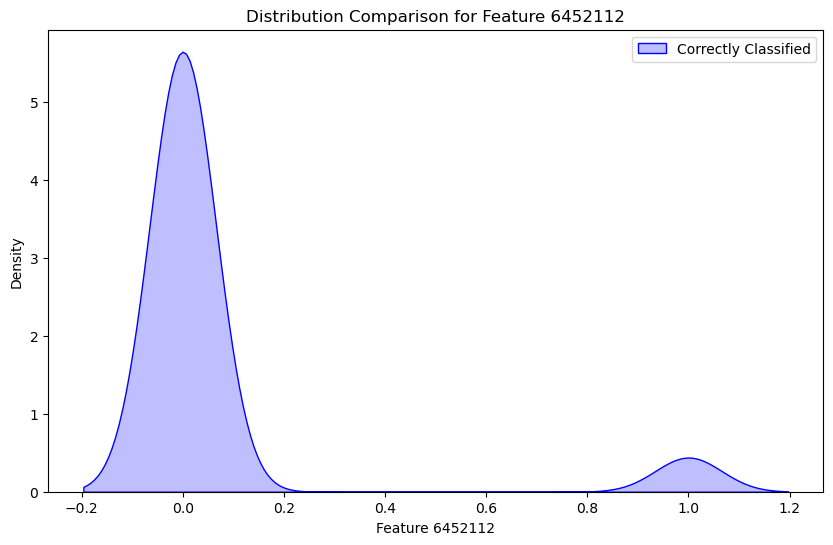

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


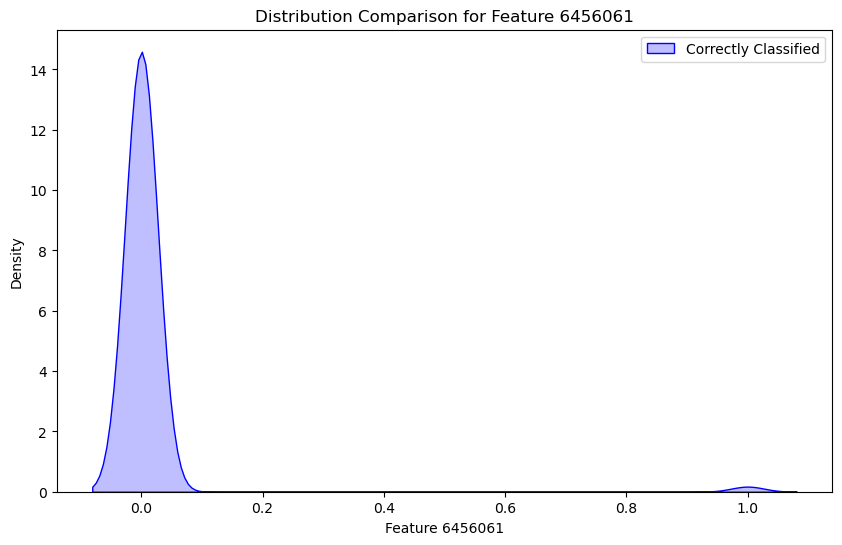

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


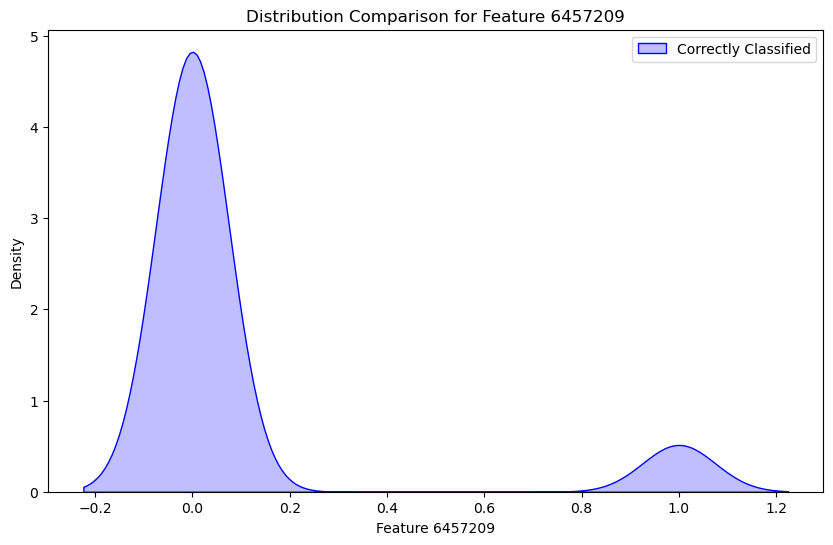

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


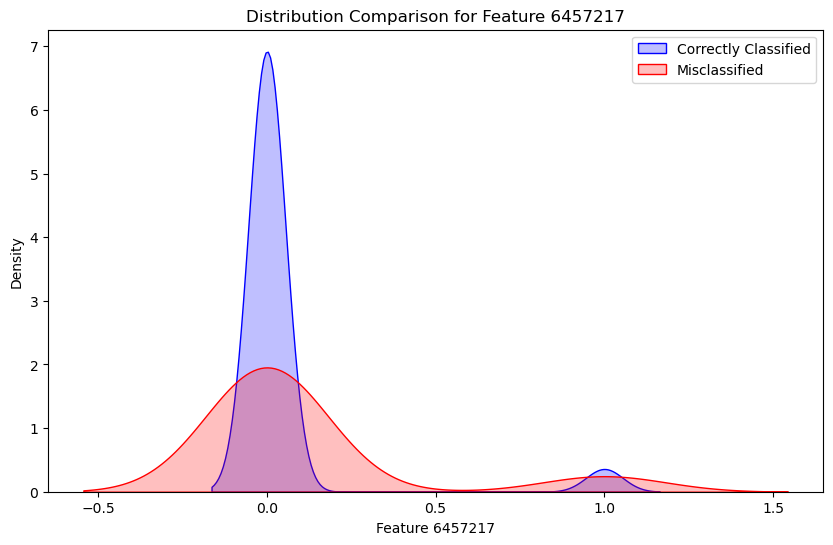

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


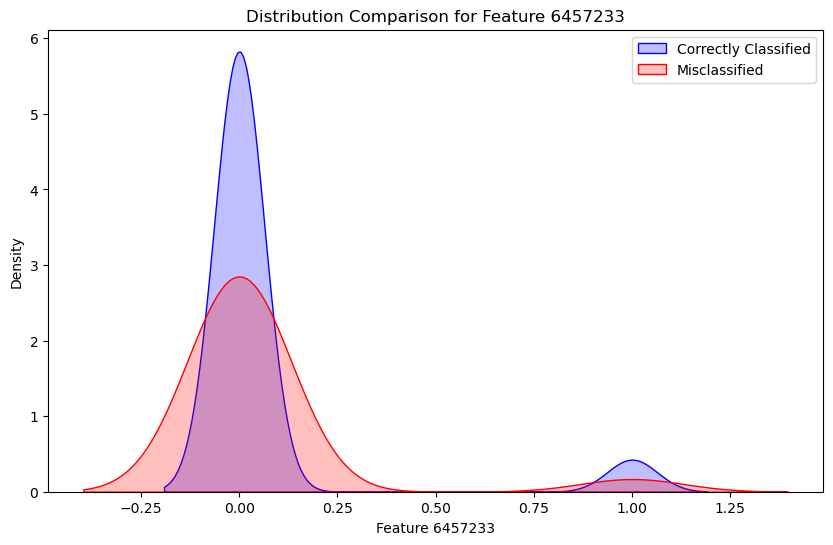

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


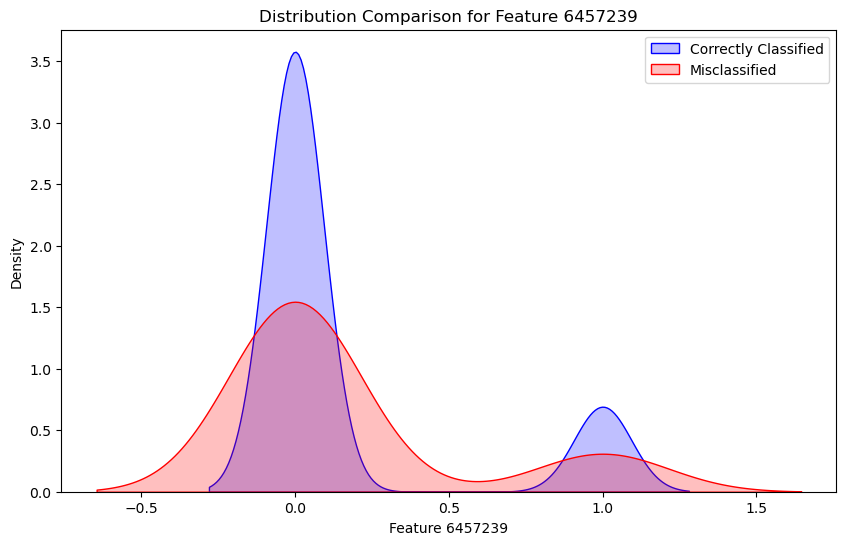

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


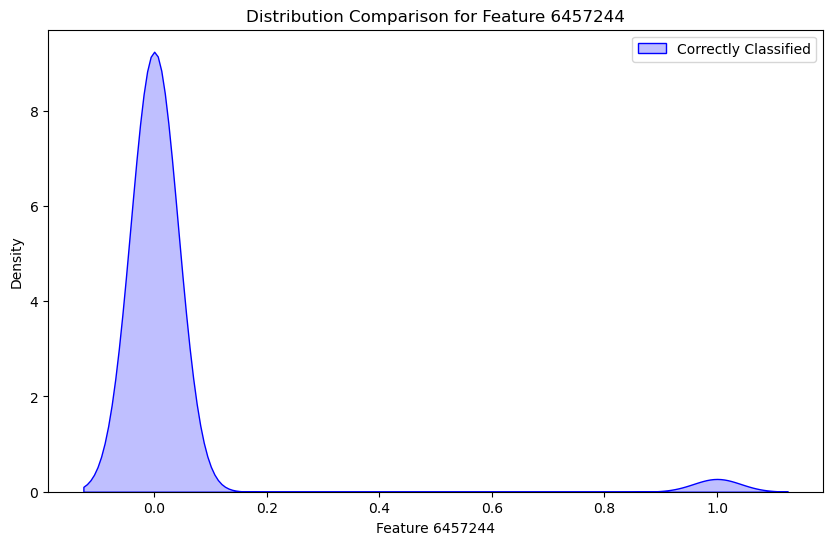

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


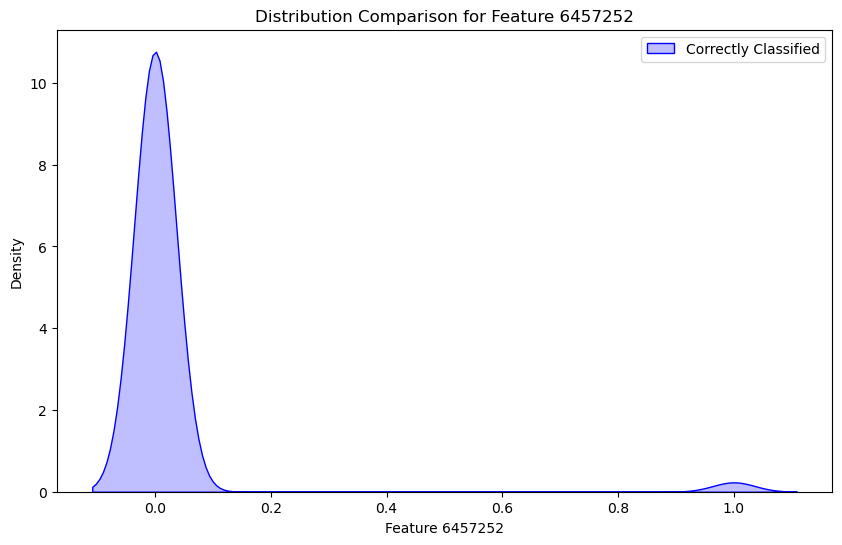

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


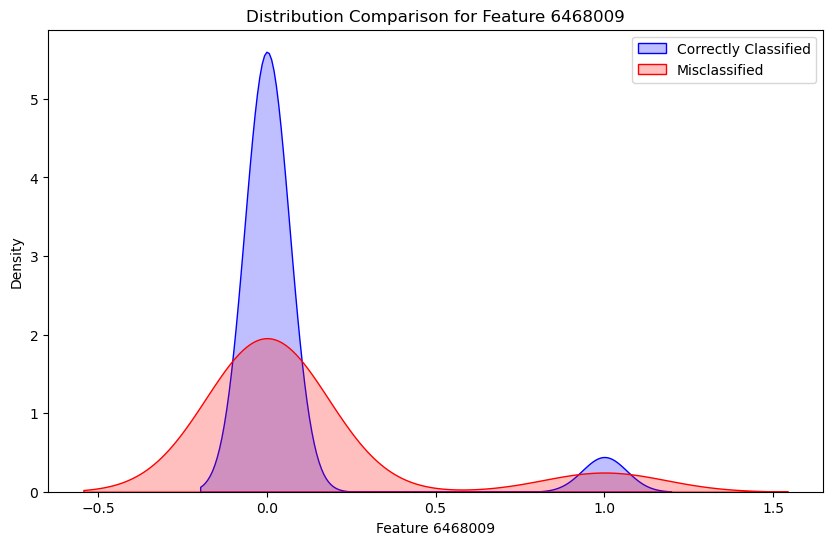

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


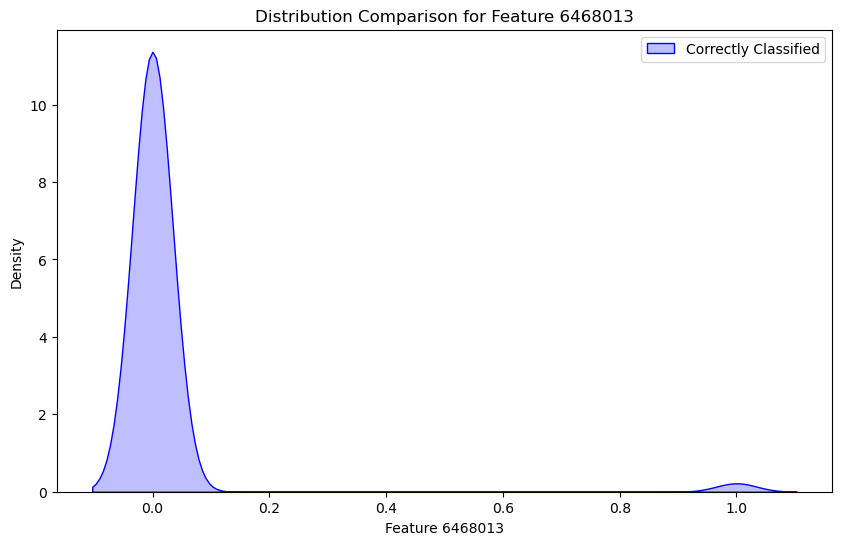

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


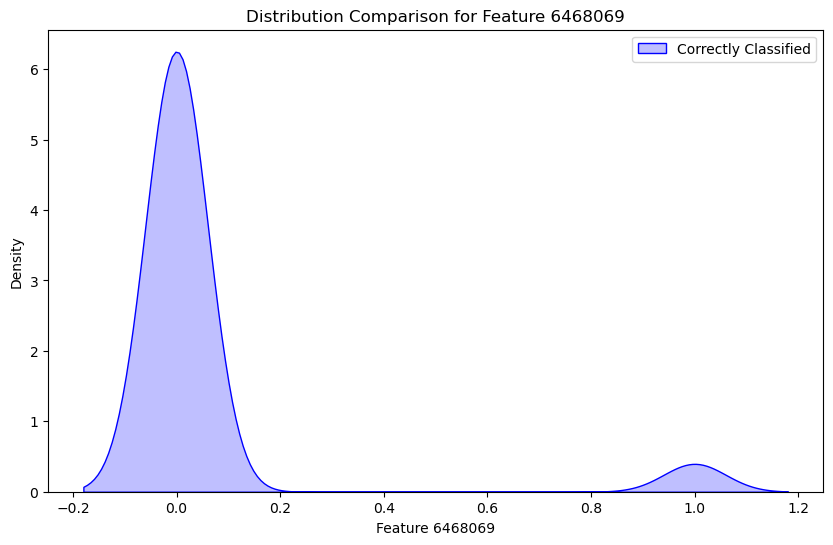

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


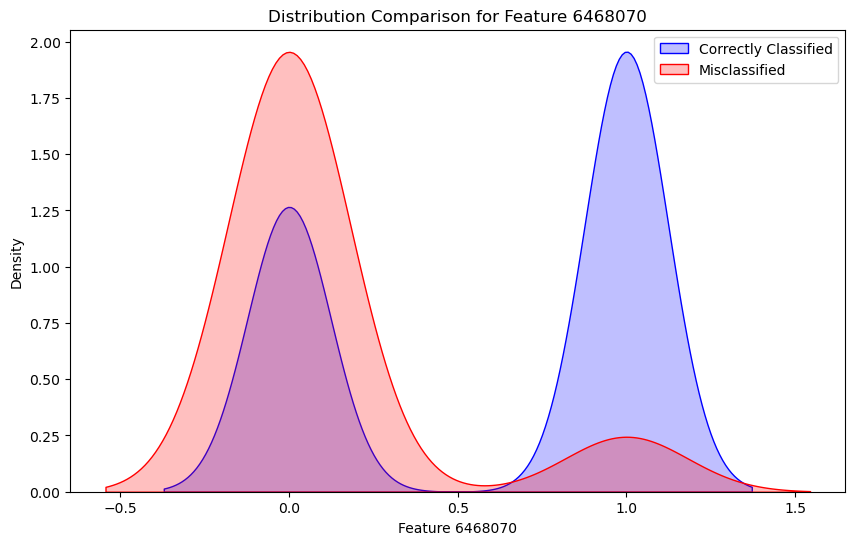

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


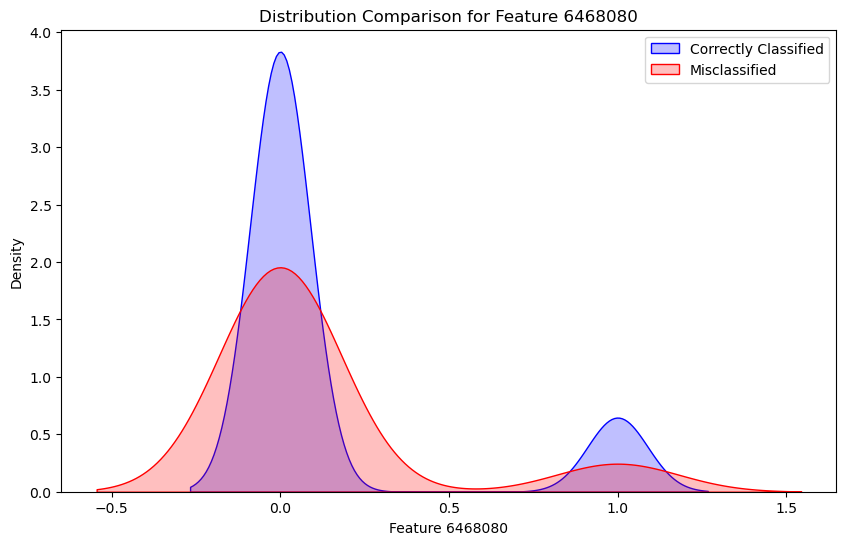

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


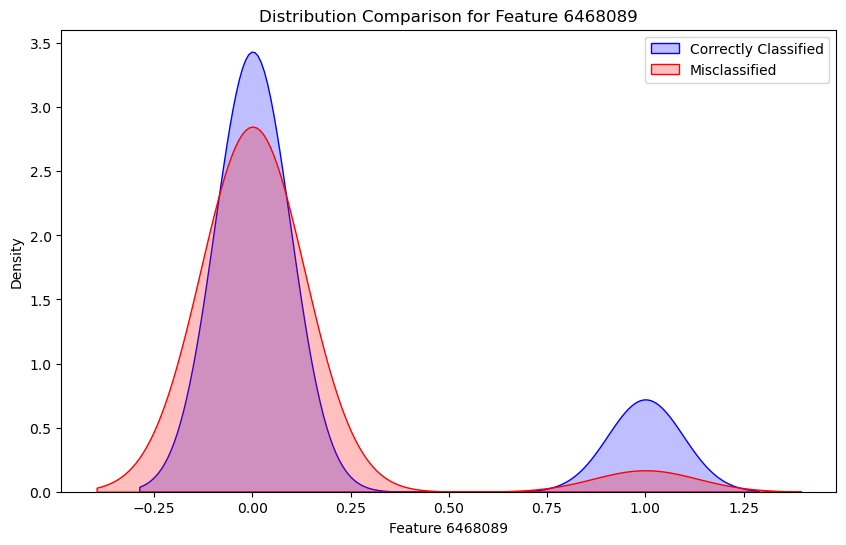

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


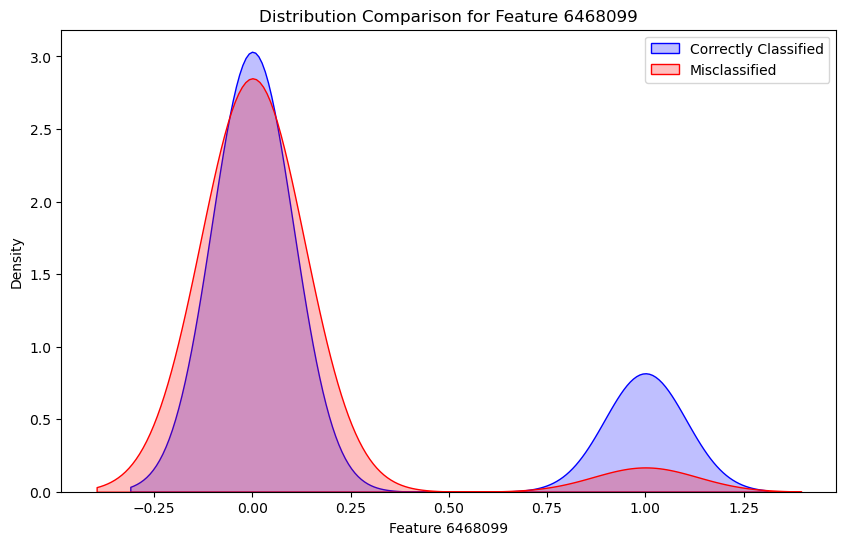

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


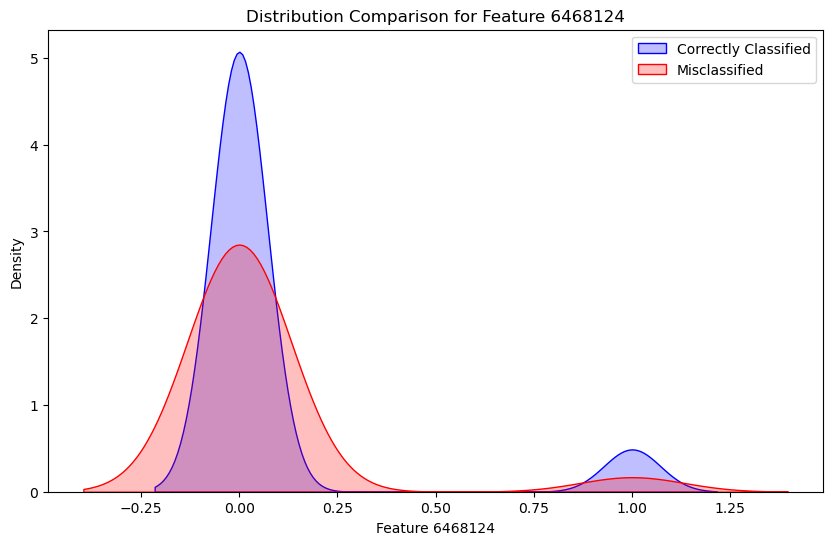

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


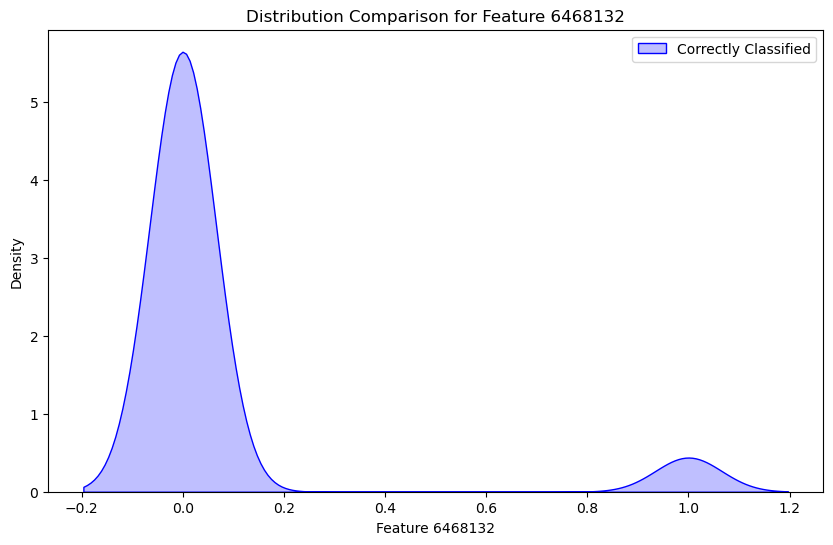

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


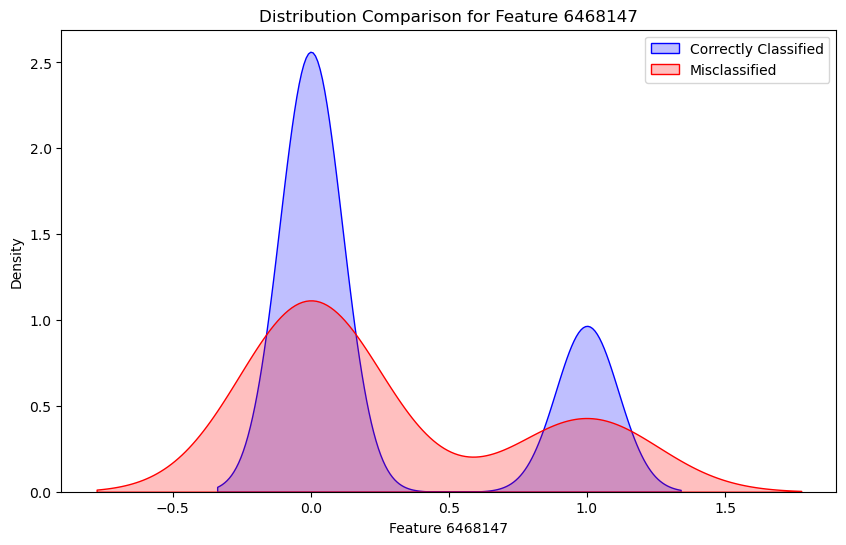

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


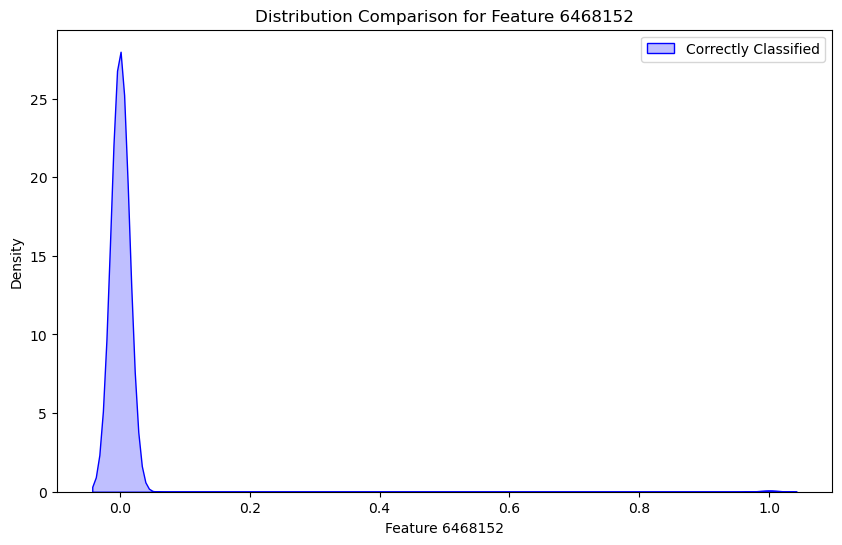

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


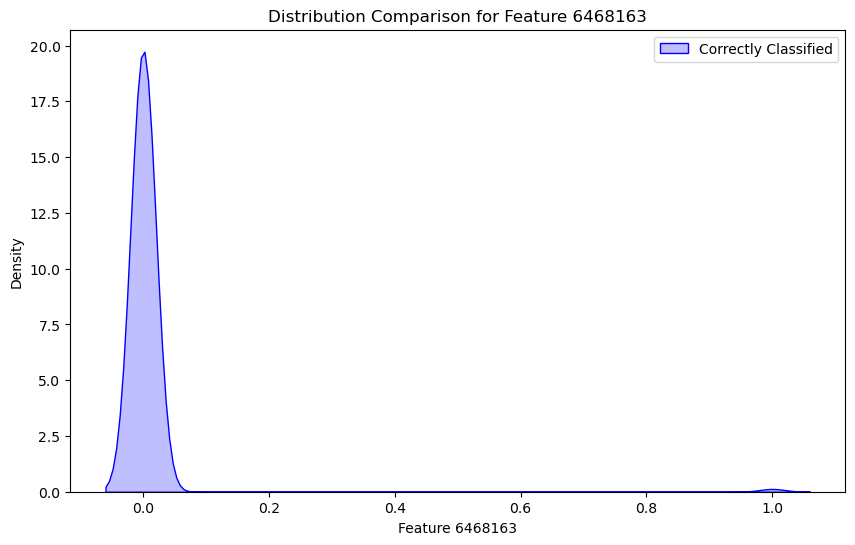

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


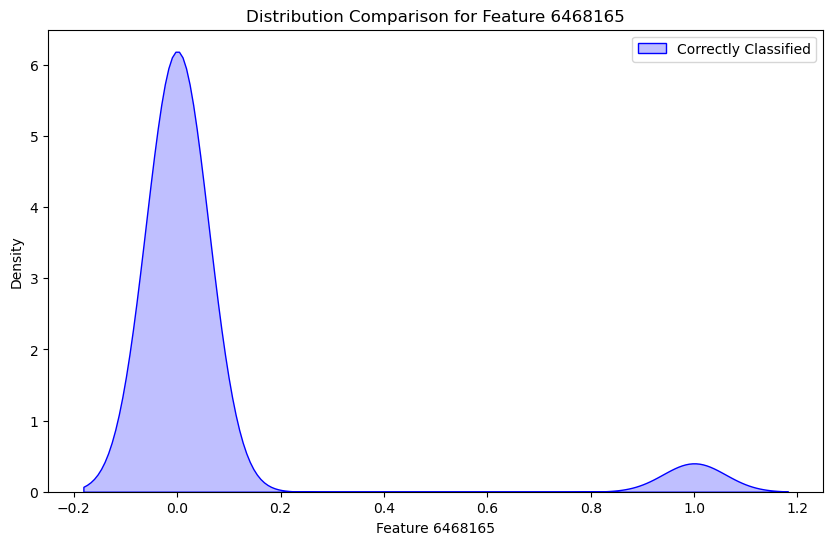

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


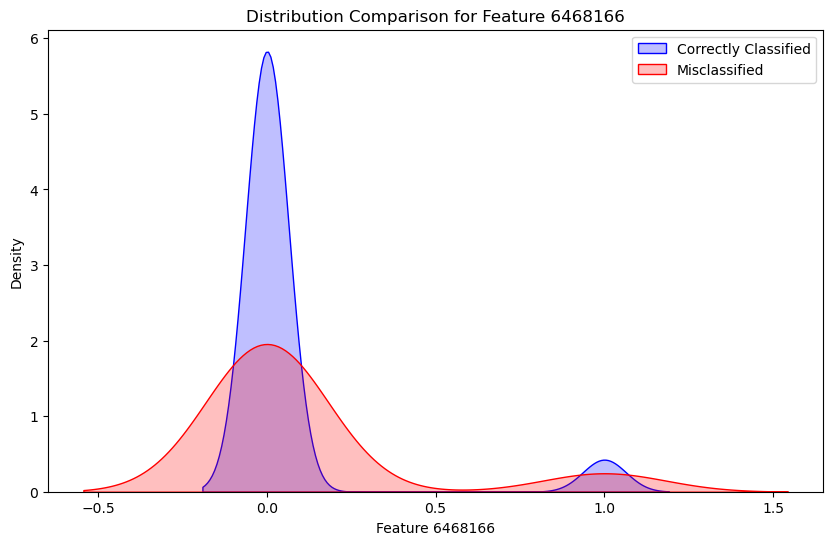

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


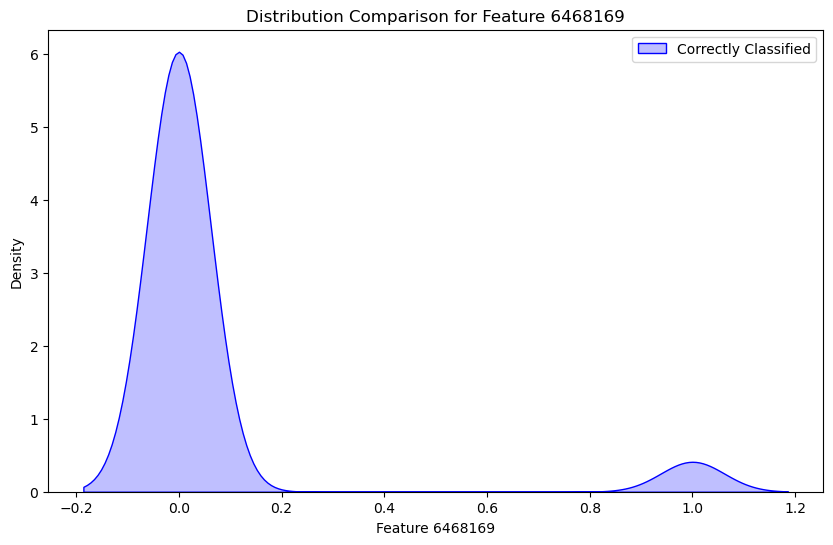

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


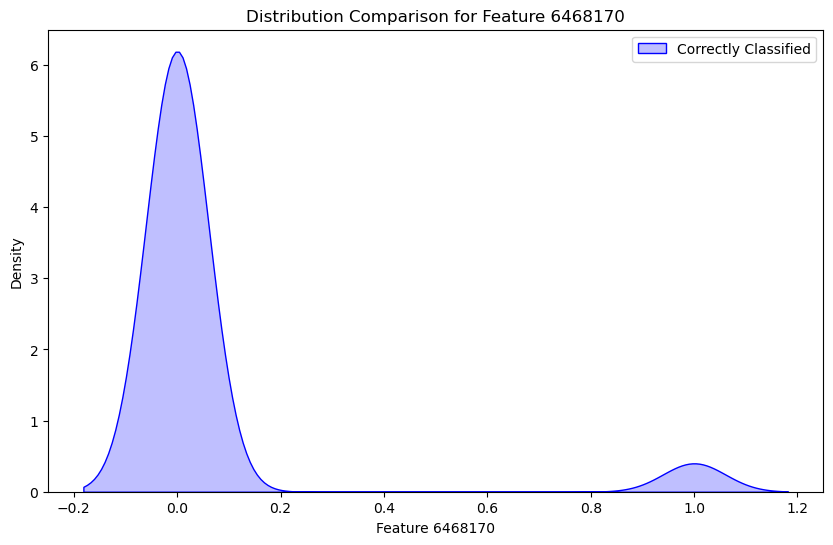

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


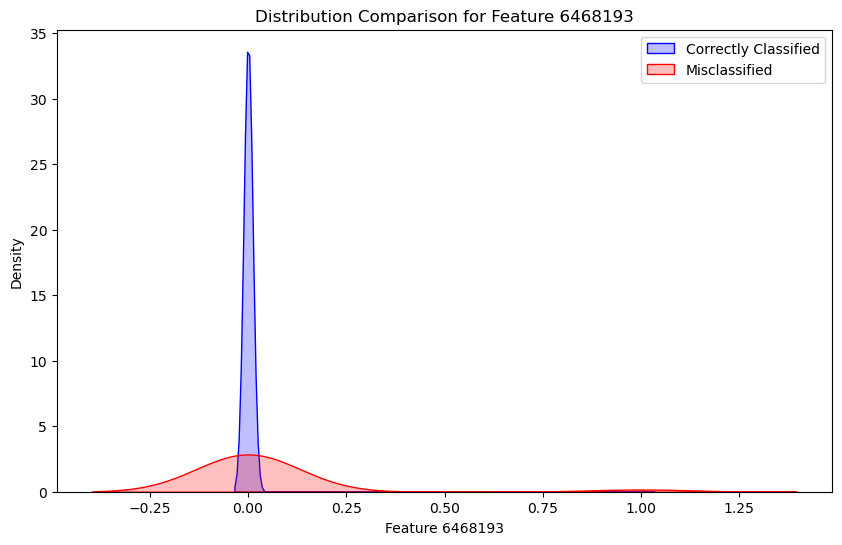

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


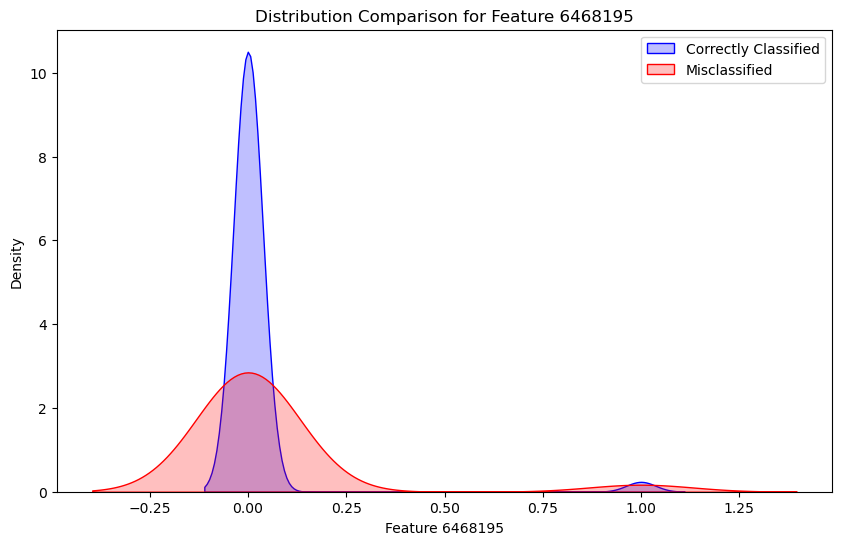

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


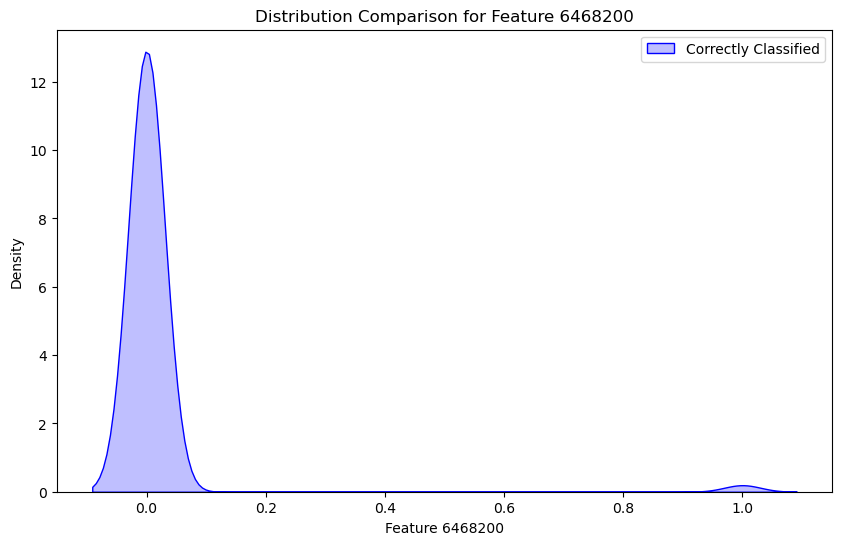

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


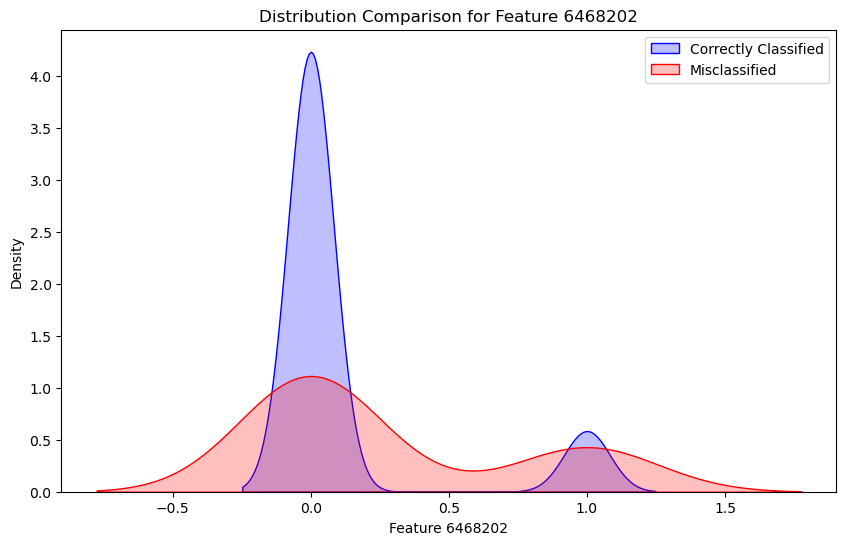

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


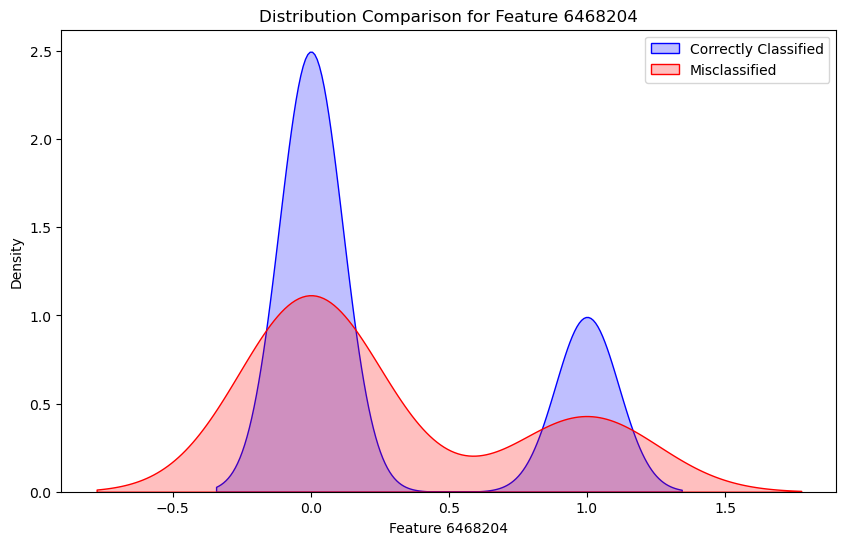

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/var/folders/qk/8nfxnn0s1pg1fwz6lvgvwznr0000gn/T/ipykernel_49647/2504341138.py:18: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


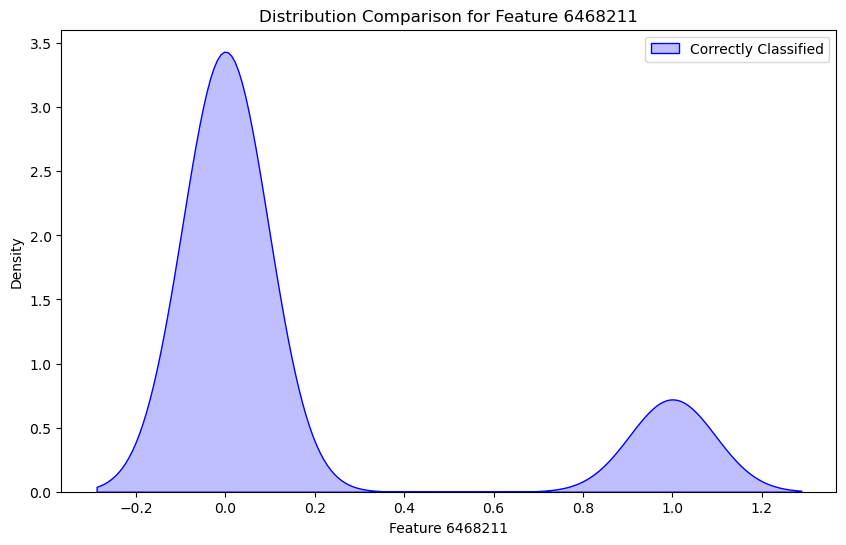

In [98]:
# Separate correctly and incorrectly classified samples
correctly_classified_indices = X_test.index[y_pred == y_test]
misclassified_indices = X_test.index[y_pred != y_test]

# Extract the respective feature sets
correctly_classified_features = X_test.loc[correctly_classified_indices]
misclassified_features = X_test.loc[misclassified_indices]

# Compare distributions for each feature
for feature in X_test.columns:
    plt.figure(figsize=(10, 6))
    sns.kdeplot(
        correctly_classified_features[feature], 
        label='Correctly Classified', 
        fill=True,  # Use fill instead of shade
        color='blue'
    )
    sns.kdeplot(
        misclassified_features[feature], 
        label='Misclassified', 
        fill=True,  # Use fill instead of shade
        color='red'
    )
    plt.title(f'Distribution Comparison for Feature {feature}')
    plt.xlabel(f'Feature {feature}')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

In [99]:
misclassified_indices

Index([ 54,  59,  98, 148, 237, 289, 469, 473, 478, 483, 488, 497, 503, 530,
       563, 572, 911, 934],
      dtype='int64')

## Decision Boundary

To investigate the decision boundary and understand where the misclassified samples fall in feature space, we can use dimensionality reduction techniques like PCA (Principal Component Analysis) or t-SNE to project the high-dimensional data into a 2D or 3D space for visualisation.

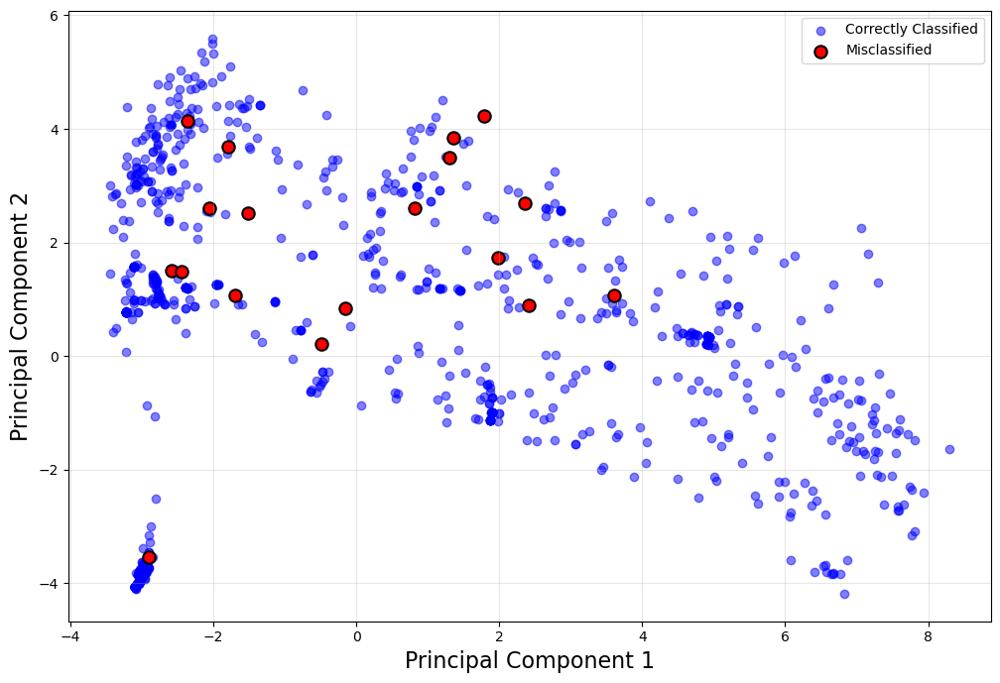

In [102]:
from sklearn.decomposition import PCA

# Perform PCA to reduce dimensionality to 2D
pca = PCA(n_components=2, random_state=42)
X_test_pca = pca.fit_transform(X_test)  # Apply PCA to the test set
X_train_pca = pca.transform(X_train)    # Apply the same transformation to the training set

# Get the PCA coordinates of misclassified samples
misclassified_pca = X_test_pca[y_pred != y_test]

# Create a scatter plot of the decision regions
plt.figure(figsize=(12, 8))

# Plot correctly classified samples
plt.scatter(
    X_test_pca[y_pred == y_test, 0], 
    X_test_pca[y_pred == y_test, 1], 
    c='blue', 
    label='Correctly Classified', 
    alpha=0.5
)

# Plot misclassified samples
plt.scatter(
    misclassified_pca[:, 0], 
    misclassified_pca[:, 1], 
    c='red', 
    label='Misclassified', 
    edgecolor='black', 
    linewidth=1.5, 
    s=80
)

# Add labels and legend
#plt.title('PCA Projection with Misclassified Samples Highlighted', fontsize=14)
plt.xlabel('Principal Component 1', fontsize=16)
plt.ylabel('Principal Component 2', fontsize=16)
plt.legend()
plt.grid(alpha=0.3)
plt.show()


In [104]:
misclassified_pca

array([[ 1.78602969,  4.22517591],
       [ 1.30635777,  3.50299135],
       [ 1.36280875,  3.84577592],
       [ 2.41778313,  0.89541615],
       [-2.9111029 , -3.54291996],
       [ 1.98430921,  1.72875211],
       [-2.06233792,  2.60930413],
       [ 2.35164112,  2.69556314],
       [-2.37020726,  4.13568045],
       [-1.7978318 ,  3.68067725],
       [-1.52026628,  2.52224888],
       [ 3.60230724,  1.0642087 ],
       [-1.69204601,  1.07188818],
       [-0.15035798,  0.83643663],
       [-2.59176449,  1.49797434],
       [ 0.81768058,  2.59795973],
       [-2.44770188,  1.48764103],
       [-0.49093929,  0.20767668]])

**Interpretation:** The PCA plot highlights the distribution of correctly and misclassified samples in the reduced 2D feature space. Correctly classified samples (blue points) are well-distributed across the principal components, while misclassified samples (red points) are scattered among them, with some forming small clusters, such as in the bottom-left region. The presence of misclassified samples overlapping with correctly classified clusters suggests that the model struggles to distinguish certain boundary cases, potentially due to insufficient separability of features or limitations in the model's decision boundary. These observations indicate that further analysis is needed to investigate the specific characteristics of misclassified samples, explore feature engineering opportunities, or consider more complex modelling approaches to improve classification performance.

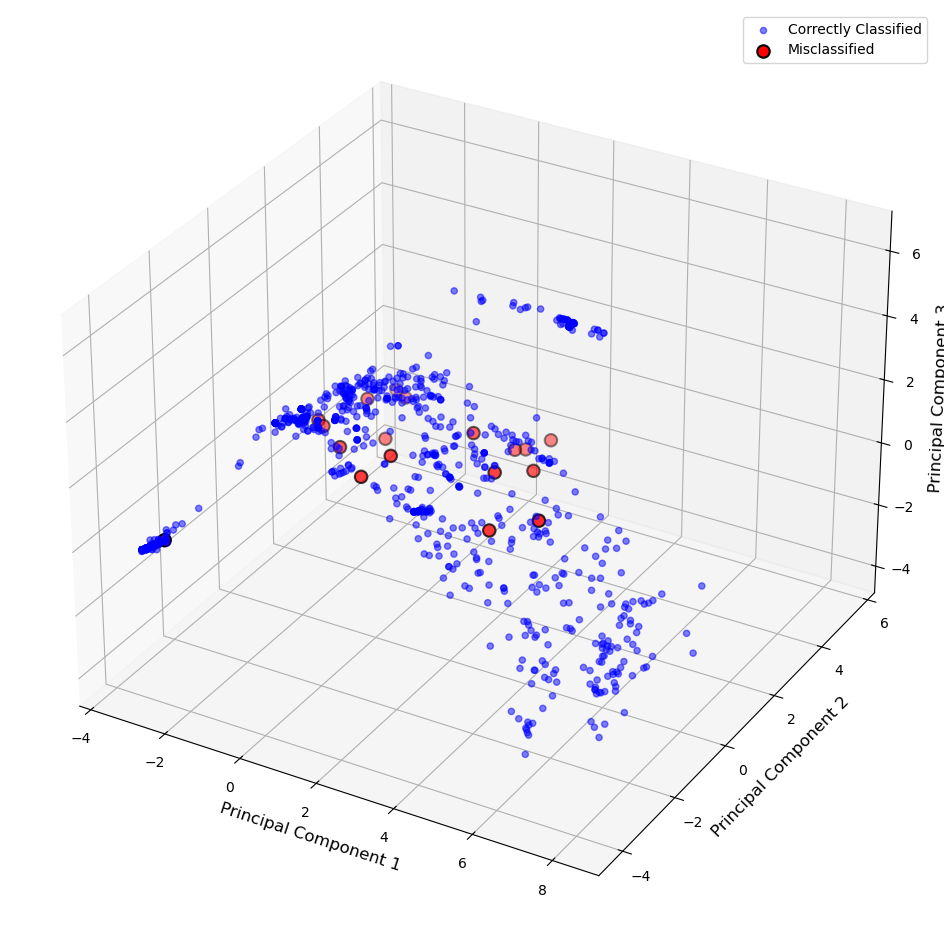

In [106]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # For 3D plotting

# Perform PCA to reduce dimensionality to 3D
pca = PCA(n_components=3)
X_test_pca_3d = pca.fit_transform(X_test)  # Apply PCA to the test set
X_train_pca_3d = pca.transform(X_train)    # Apply PCA to the training set

# Get the PCA coordinates of misclassified samples
misclassified_pca_3d = X_test_pca_3d[y_pred != y_test]

# Plot the 3D PCA results
fig = plt.figure(figsize=(16, 12))
ax = fig.add_subplot(111, projection='3d')

# Plot correctly classified samples
ax.scatter(
    X_test_pca_3d[y_pred == y_test, 0], 
    X_test_pca_3d[y_pred == y_test, 1], 
    X_test_pca_3d[y_pred == y_test, 2], 
    c='blue', 
    label='Correctly Classified', 
    alpha=0.5
)

# Plot misclassified samples
ax.scatter(
    misclassified_pca_3d[:, 0], 
    misclassified_pca_3d[:, 1], 
    misclassified_pca_3d[:, 2], 
    c='red', 
    label='Misclassified', 
    edgecolor='black', 
    linewidth=1.5, 
    s=80
)

# Add labels and legend
#ax.set_title('3D PCA Projection with Misclassified Samples Highlighted', fontsize=14)
ax.set_xlabel('Principal Component 1', fontsize=12)
ax.set_ylabel('Principal Component 2', fontsize=12)
ax.set_zlabel('Principal Component 3', fontsize=12)
ax.legend()
plt.show()


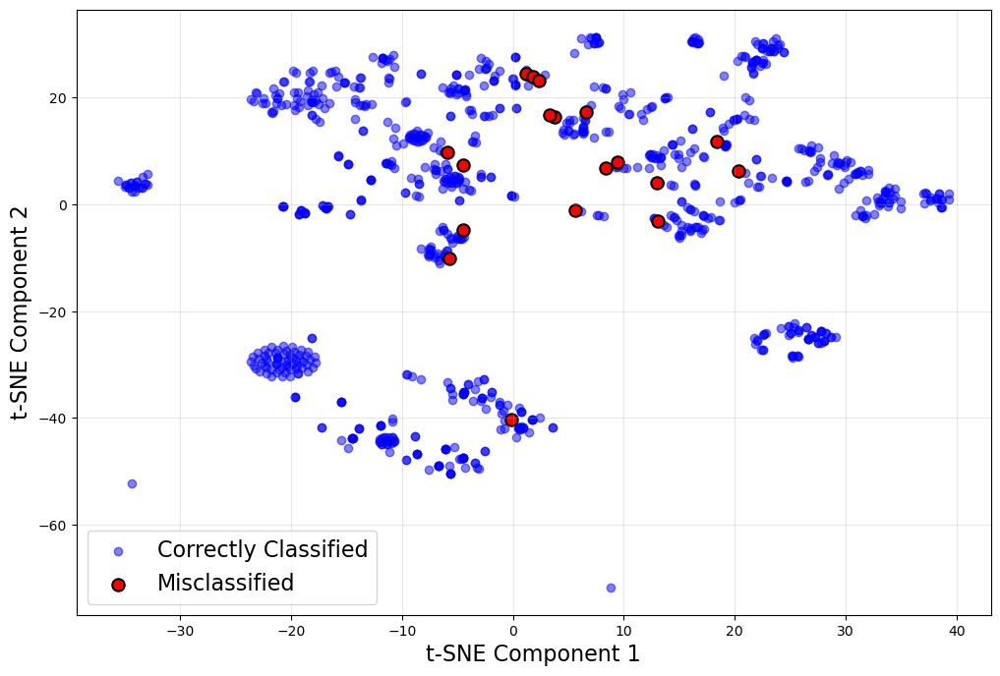

In [108]:
from sklearn.manifold import TSNE

# Perform t-SNE to reduce dimensionality to 2D
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
X_test_tsne = tsne.fit_transform(X_test)

# Get the t-SNE coordinates of misclassified samples
misclassified_tsne = X_test_tsne[y_pred != y_test]

# Plot t-SNE results
plt.figure(figsize=(12, 8))

# Plot correctly classified samples
plt.scatter(
    X_test_tsne[y_pred == y_test, 0], 
    X_test_tsne[y_pred == y_test, 1], 
    c='blue', 
    label='Correctly Classified', 
    alpha=0.5
)

# Plot misclassified samples
plt.scatter(
    misclassified_tsne[:, 0], 
    misclassified_tsne[:, 1], 
    c='red', 
    label='Misclassified', 
    edgecolor='black', 
    linewidth=1.5, 
    s=80
)

# Add labels and legend
#plt.title('t-SNE Projection with Misclassified Samples Highlighted', fontsize=14)
plt.xlabel('t-SNE Component 1', fontsize=16)
plt.ylabel('t-SNE Component 2', fontsize=16)
plt.legend(fontsize=16)
plt.grid(alpha=0.3)

# Save the plot to a PDF file
#plt.savefig('outputs/3_XAI/tsne_plot_misclassified_samples.pdf', format='pdf', bbox_inches='tight')

plt.show()

**Remark:** The t-SNE plot reveals that the majority of the samples are correctly classified, as indicated by the dense clusters of blue points. These clusters represent regions in the feature space where the model has successfully learned patterns to distinguish between classes. In these areas, the features appear to be well-separated, enabling the model to make accurate predictions. Some of these clusters, such as the ones in the bottom-middle and top-middle regions, exhibit a strong separation with no visible misclassifications.

The misclassified samples, shown as red points, are scattered across the t-SNE space and often overlap or are located near the boundaries of correctly classified clusters. This indicates that many misclassifications occur in ambiguous regions where the model's decision boundary struggles to effectively separate the classes. The scattered distribution of misclassified samples suggests that these errors are not due to a specific subset of the data but rather occur across different regions of the feature space.

Interestingly, some misclassified samples appear near sparse or isolated regions of the t-SNE space. These may represent outliers or samples with unique characteristics that the model fails to generalise well to. The presence of misclassifications near cluster boundaries highlights the need for better feature representation or more complex modelling to improve the classification of these boundary cases. Overall, the plot suggests that further exploration of feature engineering, model refinement, and data augmentation could help improve the model's performance in these challenging regions.

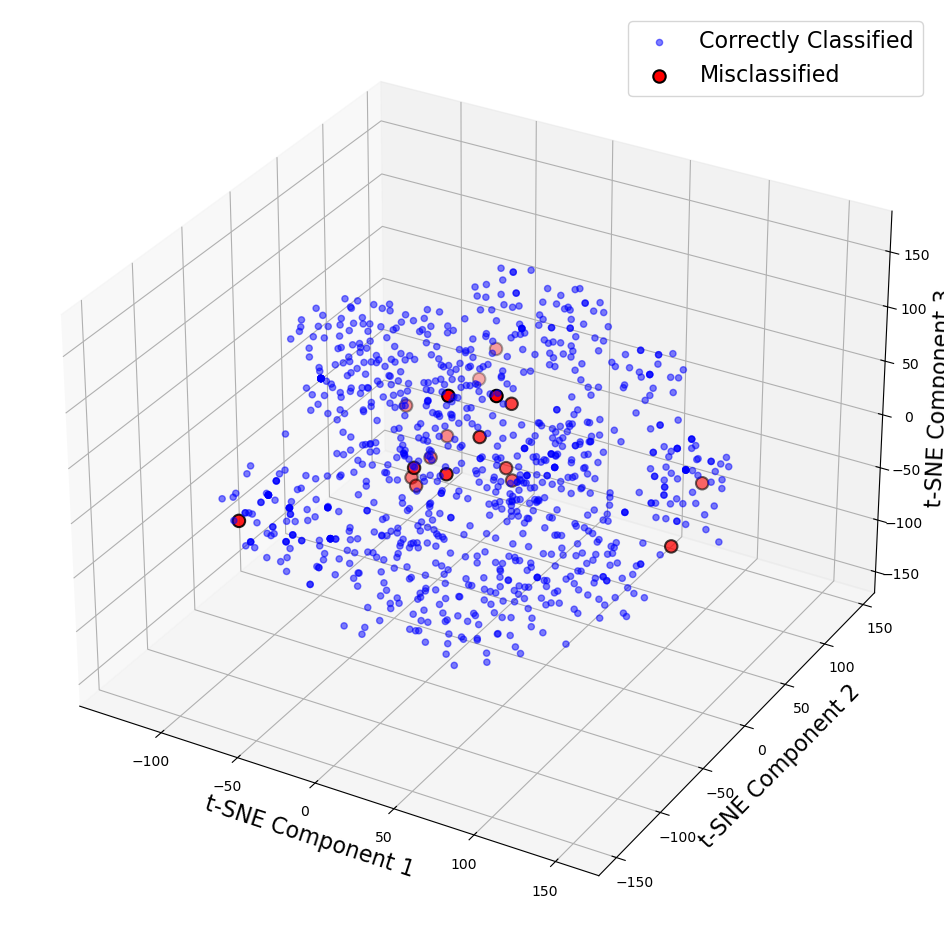

In [110]:
from sklearn.manifold import TSNE
from mpl_toolkits.mplot3d import Axes3D  # For 3D plotting

# Perform t-SNE with 3 components
tsne = TSNE(
    n_components=3,        # 3D projection
    random_state=42,       # Ensure reproducibility
    perplexity=40,         # Balance between local/global structure
    n_iter=2000,           # Increased iterations for convergence
    learning_rate=300,     # Optimised learning rate
    metric='cosine'        # Use cosine distance
)

# Fit and transform the data
X_test_tsne_3d = tsne.fit_transform(X_test)

# Separate the coordinates for misclassified samples
misclassified_tsne_3d = X_test_tsne_3d[y_pred != y_test]

# Plot the 3D t-SNE results
fig = plt.figure(figsize=(16, 12))
ax = fig.add_subplot(111, projection='3d')

# Plot correctly classified samples
ax.scatter(
    X_test_tsne_3d[y_pred == y_test, 0], 
    X_test_tsne_3d[y_pred == y_test, 1], 
    X_test_tsne_3d[y_pred == y_test, 2], 
    c='blue', 
    label='Correctly Classified', 
    alpha=0.5
)

# Plot misclassified samples
ax.scatter(
    misclassified_tsne_3d[:, 0], 
    misclassified_tsne_3d[:, 1], 
    misclassified_tsne_3d[:, 2], 
    c='red', 
    label='Misclassified', 
    edgecolor='black', 
    linewidth=1.5, 
    s=80
)

# Add labels and legend
#ax.set_title('3D t-SNE Projection with Misclassified Samples Highlighted', fontsize=14)
ax.set_xlabel('t-SNE Component 1', fontsize=16)
ax.set_ylabel('t-SNE Component 2', fontsize=16)
ax.set_zlabel('t-SNE Component 3', fontsize=16)
ax.legend(fontsize=16)
# Save the plot to a PDF file
#plt.savefig('outputs/3_XAI/3d_tsne_plot_misclassified_samples.pdf', format='pdf', bbox_inches='tight')

plt.show()


## Analyse the Feature Importance for Misclassified Samples


SHAP Analysis on Misclassified Samples: we can se SHAP values to explore which features influenced the misclassified predictions the most.

In [ ]:
misclassified_shap_values = explainer.shap_values(X_test.loc[misclassified_samples.index])
shap.summary_plot(misclassified_shap_values, X_test.loc[misclassified_samples.index], plot_type='bar')

**Remark:**: The SHAP summary plot reveals that a few features, such as `2944930`, `6468070`, and `6468204`, have the highest influence on the model's misclassifications, as indicated by their large average SHAP values. These features significantly impact the model's incorrect predictions, suggesting they may play a critical role in the model's decision boundary. Meanwhile, lower-ranked features, such as `4540432` and `6413285`, have minimal impact, indicating they contribute less to the model's predictions and may be candidates for removal to simplify the model. The dominance of a few key features highlights opportunities for targeted feature engineering, such as re-scaling, transforming, or creating interaction terms to improve separability in the feature space. This analysis underscores the need to closely examine the value distributions of the most influential features in both correctly and misclassified samples to address potential inconsistencies and reduce misclassification errors.

## Analyse Model Confidence
Probabilities of Misclassification: Examine the model's predicted probabilities for misclassified samples to see if they were low-confidence predictions.

In [112]:
probabilities = model.predict_proba(X_test.loc[misclassified_samples.index])
misclassified_samples['predicted_probabilities'] = probabilities.max(axis=1)
display(misclassified_samples[['sample_id', 'actual_value', 'predicted_value', 'predicted_probabilities']])


,sample_id,actual_value,predicted_value,predicted_probabilities
54,11136,1,0,0.791773
59,11141,1,0,0.901685
98,11304,1,0,0.972238
148,11402,1,0,0.953410
237,11726,1,0,0.996868
289,11907,1,0,0.727641
469,13020,0,1,0.998335
473,13030,0,1,0.944274
478,13046,0,1,0.693972
483,13056,0,1,0.543845


**Remark:** The analysis of misclassified sample probabilities reveals that many errors occur with high confidence, where the model predicts the wrong class with probabilities close to 1.0. This indicates potential systematic issues, such as poor feature representation or overfitting, as the model is overly confident in its incorrect predictions. Some samples, however, show moderate confidence (probabilities near 0.5–0.7), suggesting they are genuinely ambiguous cases where the model struggles due to insufficient feature separability. These findings highlight the need to investigate the features of high-confidence misclassifications, address possible overfitting through regularisation, and improve the representation of ambiguous cases through feature engineering or data augmentation.

## Investigate Specific Misclassified Samples
Outlier Detection: Check if misclassified samples are outliers using statistical methods or clustering.

In [114]:
from sklearn.ensemble import IsolationForest

clf = IsolationForest(random_state=42)
clf.fit(X_train)
outlier_scores = clf.decision_function(X_test.loc[misclassified_samples.index])
misclassified_samples['outlier_score'] = outlier_scores
display(misclassified_samples[['sample_id', 'actual_value', 'predicted_value', 'outlier_score']])


,sample_id,actual_value,predicted_value,outlier_score
54,11136,1,0,-0.024109
59,11141,1,0,-0.024415
98,11304,1,0,-0.037515
148,11402,1,0,0.005131
237,11726,1,0,0.111199
289,11907,1,0,-0.012972
469,13020,0,1,0.076209
473,13030,0,1,0.008424
478,13046,0,1,0.076825
483,13056,0,1,0.096736


**Remark:** The outlier detection results reveal that most misclassified samples have positive outlier scores, indicating they are not extreme outliers but likely fall near decision boundaries where the model struggles. A few samples with negative scores (e.g., `11304`, `11136`) are true outliers, suggesting unusual feature values that deviate significantly from the data distribution, making them inherently harder to classify. Misclassifications for actual value `1` show a mix of boundary cases and true outliers, while misclassifications for actual value `0` mostly arise from boundary ambiguity. This suggests that errors are primarily due to feature overlap and ambiguous boundaries rather than extreme deviations, highlighting the need for improved feature separability, boundary-focused data augmentation, and handling of the few true outliers.

## Model-Specific Adjustments
Hyperparameter Tuning: Explore if the logistic regression model’s hyperparameters (e.g., regularisation strength) could be improved.

Alternative Models: Compare logistic regression to other models like random forests or gradient boosting for better performance.

In [116]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, make_scorer
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

# Compute class weights for cost-sensitive learning
class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weight_dict = {0: class_weights[0], 1: class_weights[1]}

# Define the logistic regression model
model = LogisticRegression(max_iter=5000, solver='liblinear')

param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000], 
    'penalty': ['l1', 'l2'], 
    'solver': ['liblinear', 'saga'], 
    'class_weight': [None, class_weight_dict]
}

# Define a scoring metric (F1-score is useful for imbalanced datasets)
scorer = make_scorer(f1_score, average='weighted')

# Perform grid search with cross-validation
grid_search = GridSearchCV(
    estimator=model, 
    param_grid=param_grid, 
    scoring=scorer, 
    cv=5, 
    n_jobs=-1, 
    verbose=1
)

# Fit the model to the training data
grid_search.fit(X_train, y_train)

# Get the best model and parameters
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

# Evaluate the best model on the test set
y_pred = best_model.predict(X_test)
print("Best Parameters:", best_params)
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred, average='binary')  # For binary classification
precision = precision_score(y_test, y_pred, average='binary')
balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
auc_roc = roc_auc_score(y_test, best_model.predict_proba(X_test)[:, 1])  # AUC-ROC from probabilities

# Display metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Balanced Accuracy: {balanced_accuracy:.4f}")
print(f"AUC-ROC: {auc_roc:.4f}")

Fitting 5 folds for each of 56 candidates, totalling 280 fits
Best Parameters: {'C': 1000, 'class_weight': None, 'penalty': 'l2', 'solver': 'saga'}

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97       510
           1       0.97      0.97      0.97       465

    accuracy                           0.97       975
   macro avg       0.97      0.97      0.97       975
weighted avg       0.97      0.97      0.97       975

Accuracy: 0.9723
Recall: 0.9720
Precision: 0.9700
Balanced Accuracy: 0.9723
AUC-ROC: 0.9957


## Temporal/Sequential Analysis
If your data has a temporal or sequential component (e.g., timestamped logs or events), evaluate whether temporal dependencies play a role in misclassification.

In [118]:
X_test_merge.head()

,sample_id,sample_type,family_label,type_label,5,8,18,32,33,34,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,11027,1,8,1,1,1,1,1,1,1,...,1,0,1,1,0,0,0,0,1,1
1,11030,1,31,2,1,0,1,0,1,1,...,0,1,0,0,0,0,1,0,1,1
2,11033,1,8,1,1,1,1,1,1,1,...,1,0,1,1,0,0,0,0,1,1
3,11035,1,8,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,1,1
4,11036,1,3,2,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,1


In [120]:
X_test_merge_sampleids = list(X_test_merge.sample_id)
X_test_meta = df_mlran_meta[df_mlran_meta["sample_id"].isin(X_test_merge_sampleids)]
print(X_test_meta.shape)
X_test_meta.head()

(975, 19)


,sample_id,sha256,sample_type,ransomware_family,family_label,ransomware_type,type_label,sha1,md5,extension,detections,source,timestamp,new_timestamp,old_timestamp,Year,first_submission_date,first_submission_date_converted,first_submission_date_year
983,11027,602593051e9d2e3d5eb4d0dd7de16ed90381243c3ad80c...,1,mbrlock,8,locker,1,74386a0a8644a842ff76e289c15a6f0ccc55e7d6,5f75d396a5d498ad06f8f55c9c37de82,exe,58/75,marauder,708992537.0,1992-06-19,708992537.0,1992,1635927125,2021-11-03,2021
986,11030,e243173c6ec7bd4a96053d272cadaec5e71dbe38cbbe4a...,1,shade,31,crypto,2,bcbe204e5b178b40b331034d785b280c9bc2aa04,9d070d022920b47cb25082ade9f8fc6e,exe,64/74,marauder,1495875683.0,2017-05-27,1495875683.0,2017,1635924968,2021-11-03,2021
989,11033,08e7cdc1b5e353c1db18eae82c22cbc1dc0df73598793c...,1,mbrlock,8,locker,1,0284ab5b8ac5ba1440b28c5ff586c595e09da118,d2a2a08cc15a19270026379d7361318f,exe,58/75,marauder,708992537.0,1992-06-19,708992537.0,1992,1635926440,2021-11-03,2021
991,11035,3a525872226f78a7c9785ec0827033da1896001614cedb...,1,mbrlock,8,locker,1,5732c9d6a248aac699d8700c71979f2c0d6a1413,2703ec691312c15c64ebf08dcb2be4a8,exe,56/72,marauder,708992537.0,1992-06-19,708992537.0,1992,1635926539,2021-11-03,2021
992,11036,93fe6795e95a921e0a81a1d0bb46daa30d21304240b10a...,1,cryptolocker,3,crypto,2,8c54ca2c71a8387e46c058dce723f27341f23181,3145528681ea02c866d85d7168e31a8c,exe,60/75,marauder,979096914.0,2001-01-10,979096914.0,2001,1635926496,2021-11-03,2021


In [122]:
# Create a DataFrame to combine relevant columns
temporal_df = pd.DataFrame({
    'timestamp': X_test_meta['first_submission_date_converted'].values,  # Replace with the actual timestamp column
    'actual_value': y_test.values,
    'predicted_value': y_pred,
    'is_misclassified': (y_test != y_pred).astype(int)  # 1 if misclassified, 0 otherwise
})
temporal_df

,timestamp,actual_value,predicted_value,is_misclassified
0,2021-11-03,1,1,0
1,2021-11-03,1,1,0
2,2021-11-03,1,1,0
3,2021-11-03,1,1,0
4,2021-11-03,1,1,0
...,...,...,...,...
970,2023-10-02,0,0,0
971,2022-02-06,0,0,0
972,2024-06-13,0,0,0
973,2024-03-26,0,0,0


In [124]:
# Sort by timestamp
temporal_df = temporal_df.sort_values('timestamp')
temporal_df

,timestamp,actual_value,predicted_value,is_misclassified
619,2021-10-29,0,0,0
712,2021-10-30,0,0,0
688,2021-11-02,0,0,0
653,2021-11-02,0,0,0
0,2021-11-03,1,1,0
...,...,...,...,...
869,2024-07-07,0,0,0
768,2024-07-09,0,0,0
903,2024-07-10,0,0,0
313,2024-07-13,1,1,0


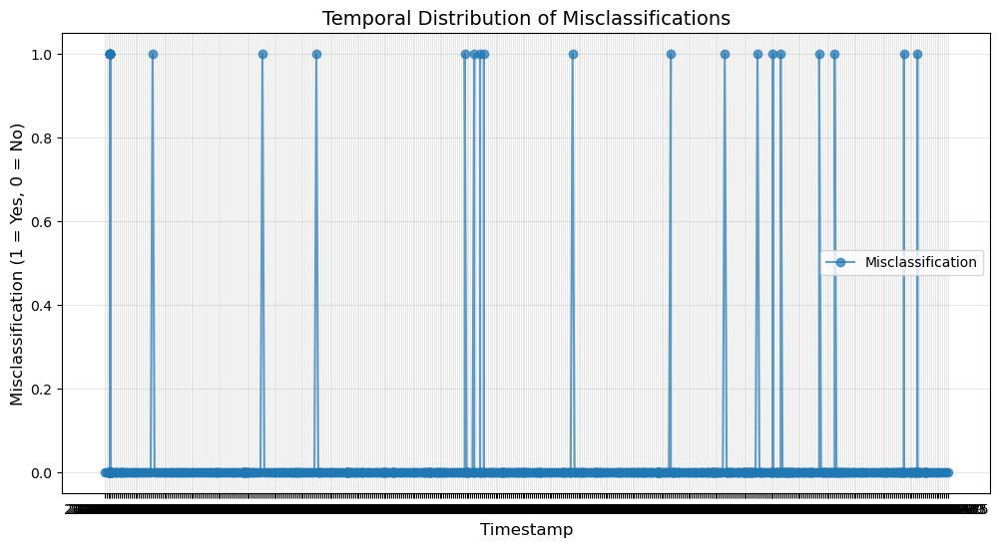

In [126]:

# Plot misclassifications over time
plt.figure(figsize=(12, 6))
plt.plot(temporal_df['timestamp'], temporal_df['is_misclassified'], label='Misclassification', linestyle='-', marker='o', alpha=0.7)
plt.title('Temporal Distribution of Misclassifications', fontsize=14)
plt.xlabel('Timestamp', fontsize=12)
plt.ylabel('Misclassification (1 = Yes, 0 = No)', fontsize=12)
plt.grid(alpha=0.3)
plt.legend()
plt.show()

## Global feature importance

### SHAP

#### Feature names

In [128]:
X_train.head()

,5,8,18,32,33,34,35,37,41,43,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,1,1,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,1,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,1,1,0,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,0
4,1,1,1,1,1,1,1,1,0,1,...,1,1,1,1,0,0,1,0,0,0


In [130]:
X_train_featurenames = list(X_train.columns)
X_train_featurenames

['5',
 '8',
 '18',
 '32',
 '33',
 '34',
 '35',
 '37',
 '41',
 '43',
 '46',
 '47',
 '49',
 '50',
 '59',
 '60',
 '63',
 '64',
 '65',
 '66',
 '69',
 '71',
 '75',
 '87',
 '90',
 '92',
 '94',
 '98',
 '108',
 '109',
 '111',
 '113',
 '114',
 '116',
 '118',
 '119',
 '120',
 '122',
 '124',
 '130',
 '131',
 '133',
 '134',
 '135',
 '136',
 '148',
 '150',
 '155',
 '157',
 '158',
 '159',
 '163',
 '171',
 '178',
 '180',
 '186',
 '193',
 '195',
 '198',
 '203',
 '208',
 '225',
 '227',
 '31844',
 '35566',
 '39482',
 '39484',
 '40471',
 '40473',
 '40475',
 '40479',
 '40480',
 '40481',
 '40676',
 '40714',
 '40716',
 '40753',
 '100647',
 '104290',
 '104300',
 '110219',
 '110220',
 '112411',
 '113636',
 '113637',
 '119780',
 '120873',
 '120874',
 '120875',
 '124264',
 '130140',
 '131181',
 '131375',
 '131394',
 '131400',
 '131425',
 '140099',
 '140100',
 '140101',
 '147738',
 '147744',
 '147745',
 '147746',
 '147747',
 '147748',
 '147762',
 '152555',
 '153169',
 '153296',
 '153297',
 '153298',
 '153299',
 

In [132]:
# load feature names dictionary
file_path = 'data/MLRan_feature_names_dic.json' 
with open(file_path, 'r', encoding='utf-8') as f:
    feature_names_dict = json.load(f)

# Display the loaded dictionary
#print(feature_names_dict)


In [134]:
# Select the corresponding keys and values from the feature_names_dict based on the list
selected_features = {}
for key in X_train_featurenames:
    # Ensure that no conflict happens by using str to convert the key
    selected_features[str(key)] = feature_names_dict[str(key)]

# Display the selected features
display(selected_features)


{'5': 'API:NtProtectVirtualMemory',
 '8': 'API:CreateProcessInternalW',
 '18': 'API:LdrGetProcedureAddress',
 '32': 'API:CreateActCtxW',
 '33': 'API:GetNativeSystemInfo',
 '34': 'API:NtAllocateVirtualMemory',
 '35': 'API:NtQueryInformationFile',
 '37': 'API:NtOpenProcess',
 '41': 'API:CoUninitialize',
 '43': 'API:Process32NextW',
 '46': 'API:CreateToolhelp32Snapshot',
 '47': 'API:RegSetValueExW',
 '49': 'API:GetSystemMetrics',
 '50': 'API:NtDelayExecution',
 '59': 'API:CoCreateInstance',
 '60': 'API:NtWriteFile',
 '63': 'API:NtQueryKey',
 '64': 'API:OpenServiceW',
 '65': 'API:GetComputerNameW',
 '66': 'API:RegCreateKeyExA',
 '69': 'API:SHGetFolderPathW',
 '71': 'API:RegCreateKeyExW',
 '75': 'API:NtSetInformationFile',
 '87': 'API:NtQueryDirectoryFile',
 '90': 'API:OpenSCManagerW',
 '92': 'API:RegSetValueExA',
 '94': 'API:Process32FirstW',
 '98': 'API:UuidCreate',
 '108': 'API:FindResourceExW',
 '109': 'API:RegEnumValueW',
 '111': 'API:GetFileAttributesExW',
 '113': 'API:DrawTextExW',
 

In [136]:
len(selected_features)

483

In [138]:
# Function to shorten the feature names to at most 50 characters
def shorten_feature_name(name, max_length=50):
    if len(name) <= max_length:
        return name
    keep = (max_length - 3) // 2
    return name[:keep] + '...' + name[-keep:]

In [140]:
# Apply shortening... to shorten the feature names to at most 50 characters
shortened_selected_features = {
    k: shorten_feature_name(v, max_length=50)
    for k, v in selected_features.items()
}
shortened_selected_features

{'5': 'API:NtProtectVirtualMemory',
 '8': 'API:CreateProcessInternalW',
 '18': 'API:LdrGetProcedureAddress',
 '32': 'API:CreateActCtxW',
 '33': 'API:GetNativeSystemInfo',
 '34': 'API:NtAllocateVirtualMemory',
 '35': 'API:NtQueryInformationFile',
 '37': 'API:NtOpenProcess',
 '41': 'API:CoUninitialize',
 '43': 'API:Process32NextW',
 '46': 'API:CreateToolhelp32Snapshot',
 '47': 'API:RegSetValueExW',
 '49': 'API:GetSystemMetrics',
 '50': 'API:NtDelayExecution',
 '59': 'API:CoCreateInstance',
 '60': 'API:NtWriteFile',
 '63': 'API:NtQueryKey',
 '64': 'API:OpenServiceW',
 '65': 'API:GetComputerNameW',
 '66': 'API:RegCreateKeyExA',
 '69': 'API:SHGetFolderPathW',
 '71': 'API:RegCreateKeyExW',
 '75': 'API:NtSetInformationFile',
 '87': 'API:NtQueryDirectoryFile',
 '90': 'API:OpenSCManagerW',
 '92': 'API:RegSetValueExA',
 '94': 'API:Process32FirstW',
 '98': 'API:UuidCreate',
 '108': 'API:FindResourceExW',
 '109': 'API:RegEnumValueW',
 '111': 'API:GetFileAttributesExW',
 '113': 'API:DrawTextExW',
 

In [142]:
# Convert dictionary keys to strings (since columns are strings)
dict_str_keys = {str(k): v for k, v in shortened_selected_features.items()}

# Filter the DataFrame using string keys 
X_train_renamed = X_train[list(dict_str_keys.keys())]

# Rename the columns
X_train_renamed = X_train_renamed.rename(columns=dict_str_keys)

display(X_train_renamed.head())


,API:NtProtectVirtualMemory,API:CreateProcessInternalW,API:LdrGetProcedureAddress,API:CreateActCtxW,API:GetNativeSystemInfo,API:NtAllocateVirtualMemory,API:NtQueryInformationFile,API:NtOpenProcess,API:CoUninitialize,API:Process32NextW,...,SIGNATURE:injection_ntsetcontextthread,SIGNATURE:injection_process_search,SIGNATURE:injection_runpe,SIGNATURE:injection_write_memory,SIGNATURE:network_http,SIGNATURE:network_icmp,SIGNATURE:nolookup_communication,SIGNATURE:origin_langid,SIGNATURE:packer_entropy,SIGNATURE:persistence_autorun
0,1,1,1,1,1,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,1,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,1,1,0,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,0
4,1,1,1,1,1,1,1,1,0,1,...,1,1,1,1,0,0,1,0,0,0


In [144]:
X_test.head()

,5,8,18,32,33,34,35,37,41,43,...,6468165,6468166,6468169,6468170,6468193,6468195,6468200,6468202,6468204,6468211
0,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
1,1,0,1,0,1,1,1,0,1,1,...,0,1,0,0,0,0,1,0,1,1
2,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
3,1,1,1,1,1,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,1
4,1,1,1,0,0,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,1


In [146]:
# Filter the DataFrame using string keys
X_test_renamed = X_test[list(dict_str_keys.keys())]

# Rename the columns
X_test_renamed = X_test_renamed.rename(columns=dict_str_keys)
print(X_test_renamed.shape)
display(X_test_renamed.head())


(975, 483)


,API:NtProtectVirtualMemory,API:CreateProcessInternalW,API:LdrGetProcedureAddress,API:CreateActCtxW,API:GetNativeSystemInfo,API:NtAllocateVirtualMemory,API:NtQueryInformationFile,API:NtOpenProcess,API:CoUninitialize,API:Process32NextW,...,SIGNATURE:injection_ntsetcontextthread,SIGNATURE:injection_process_search,SIGNATURE:injection_runpe,SIGNATURE:injection_write_memory,SIGNATURE:network_http,SIGNATURE:network_icmp,SIGNATURE:nolookup_communication,SIGNATURE:origin_langid,SIGNATURE:packer_entropy,SIGNATURE:persistence_autorun
0,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
1,1,0,1,0,1,1,1,0,1,1,...,0,1,0,0,0,0,1,0,1,1
2,1,1,1,1,1,1,0,1,1,0,...,1,0,1,1,0,0,0,0,1,1
3,1,1,1,1,1,1,0,1,1,0,...,0,0,0,0,0,0,0,0,1,1
4,1,1,1,0,0,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,1


- https://shap.readthedocs.io/en/latest/example_notebooks/api_examples/plots/beeswarm.html
- https://towardsdatascience.com/using-shap-values-to-explain-how-your-machine-learning-model-works-732b3f40e137/

In [152]:
# Initialize the SHAP explainer for the Logistic Regression model
explainer = shap.Explainer(model, X_train)

# Calculate SHAP values for the training set
shap_values = explainer(X_test)

(array([50.        , 49.        , 48.        , 47.        , 46.        ,
        45.        , 44.        , 43.        , 42.        , 41.        ,
        40.        , 39.        , 38.        , 37.        , 36.        ,
        35.        , 34.        , 33.        , 32.        , 31.        ,
        30.        , 29.        , 28.        , 27.        , 26.        ,
        25.        , 24.        , 23.        , 22.        , 21.        ,
        20.        , 19.        , 18.        , 17.        , 16.        ,
        15.        , 14.        , 13.        , 12.        , 11.        ,
        10.        ,  9.        ,  8.        ,  7.        ,  6.        ,
         5.        ,  4.        ,  3.        ,  2.        ,  1.        ,
        50.00000001, 49.00000001, 48.00000001, 47.00000001, 46.00000001,
        45.00000001, 44.00000001, 43.00000001, 42.00000001, 41.00000001,
        40.00000001, 39.00000001, 38.00000001, 37.00000001, 36.00000001,
        35.00000001, 34.00000001, 33.00000001, 32.0

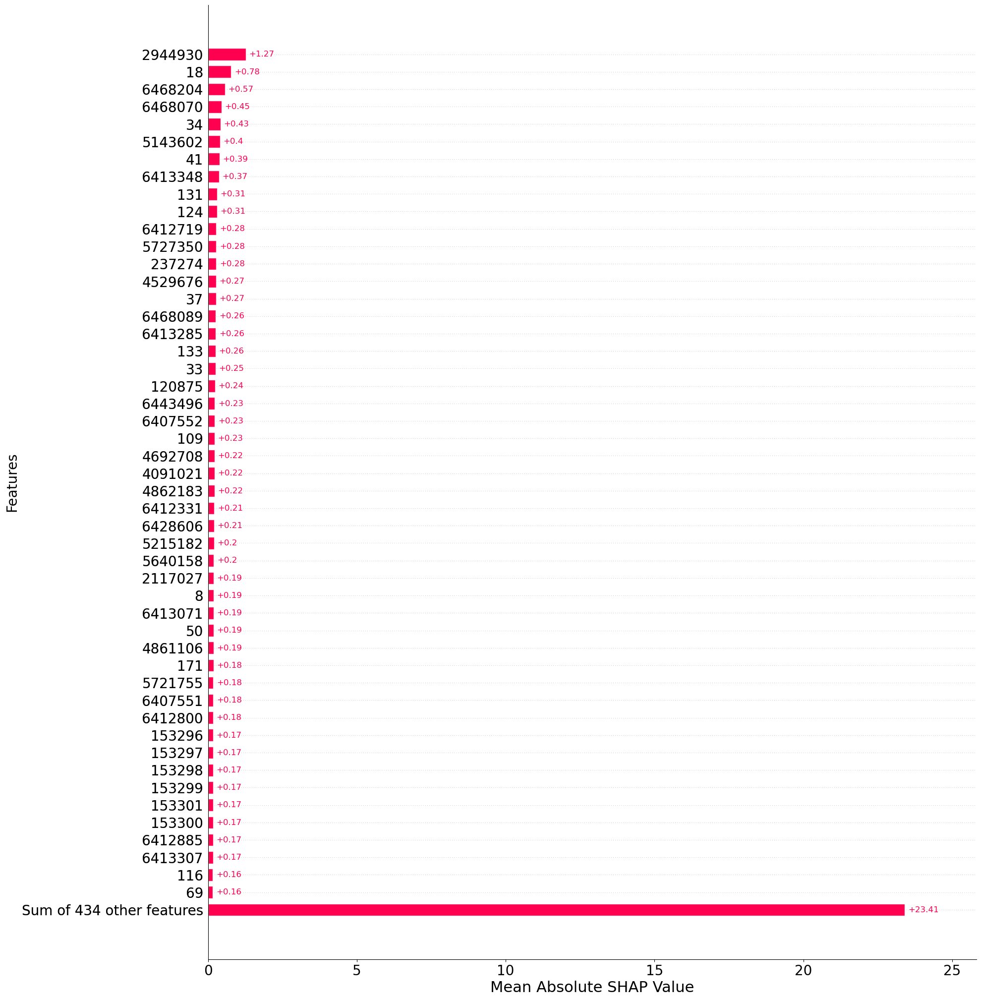

In [154]:
# Create a larger figure and axis for the plot
fig, ax = plt.subplots(figsize=(20, 25))

# Generate the SHAP bar plot and pass the axis
shap.plots.bar(shap_values, max_display=50, show=False, ax=ax)

# Adjust font size for the title, axes, and ticks
#plt.title('Top 50 Features by SHAP Value', fontsize=25)
plt.xlabel('Mean Absolute SHAP Value', fontsize=22)
plt.ylabel('Features', fontsize=20)

# Increase font size for ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Save the plot to a PDF file
#plt.savefig('outputs/3_XAI/shap_bar.pdf', format='pdf', bbox_inches='tight')

# Close the plot to free up memory
#plt.close()


In [156]:
# Initialize the SHAP explainer for the Logistic Regression model
explainer_renamed = shap.Explainer(model, X_train_renamed)

# Calculate SHAP values for the training set
shap_values_renamed = explainer_renamed(X_test_renamed)

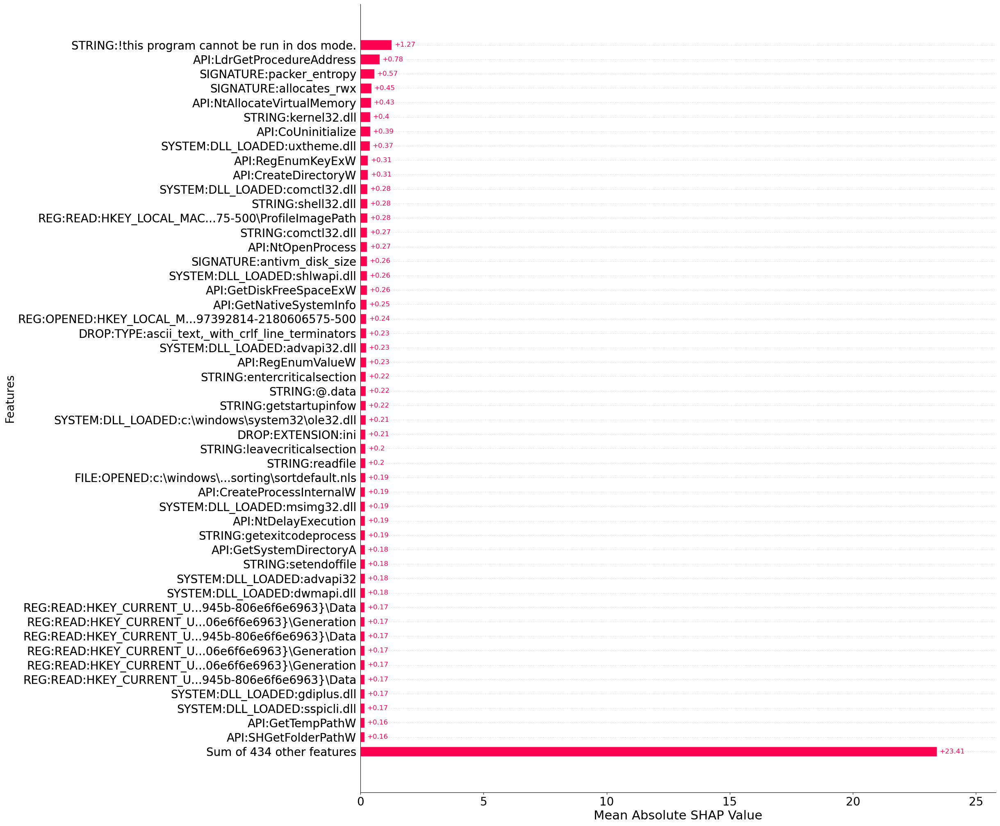

In [164]:
# Create a larger figure and axis for the plot
fig, ax = plt.subplots(figsize=(20, 25))

# Generate the SHAP bar plot and pass the axis
shap.plots.bar(shap_values_renamed, max_display=50, show=False, ax=ax)

# Adjust font size for the title, axes, and ticks
#plt.title('Top 50 Features by SHAP Value', fontsize=25)
plt.xlabel('Mean Absolute SHAP Value', fontsize=22)
plt.ylabel('Features', fontsize=20)

# Increase font size for ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Save the plot to a PDF file
plt.savefig('outputs/3_XAI/shap_bar.pdf', format='pdf', bbox_inches='tight')

# Close the plot to free up memory
#plt.close()


In [166]:
shap_values

.values =
array([[ 0.10251742,  0.16372987,  0.40974897, ..., -0.00766867,
         0.80422191,  0.32356881],
       [ 0.10251742, -0.23561127,  0.40974897, ..., -0.00766867,
         0.80422191,  0.32356881],
       [ 0.10251742,  0.16372987,  0.40974897, ..., -0.00766867,
         0.80422191,  0.32356881],
       ...,
       [ 0.10251742, -0.23561127,  0.40974897, ..., -0.00766867,
         0.80422191, -0.06627313],
       [ 0.10251742,  0.16372987, -1.29753839, ..., -0.00766867,
        -0.4723208 , -0.06627313],
       [-0.26361622, -0.23561127, -1.29753839, ..., -0.00766867,
        -0.4723208 , -0.06627313]])

.base_values =
array([0.15384961, 0.15384961, 0.15384961, 0.15384961, 0.15384961,
       0.15384961, 0.15384961, 0.15384961, 0.15384961, 0.15384961,
       0.15384961, 0.15384961, 0.15384961, 0.15384961, 0.15384961,
       0.15384961, 0.15384961, 0.15384961, 0.15384961, 0.15384961,
       0.15384961, 0.15384961, 0.15384961, 0.15384961, 0.15384961,
       0.15384961, 0.15384

In [174]:
shap_values.values

array([[ 0.10251742,  0.16372987,  0.40974897, ..., -0.00766867,
         0.80422191,  0.32356881],
       [ 0.10251742, -0.23561127,  0.40974897, ..., -0.00766867,
         0.80422191,  0.32356881],
       [ 0.10251742,  0.16372987,  0.40974897, ..., -0.00766867,
         0.80422191,  0.32356881],
       ...,
       [ 0.10251742, -0.23561127,  0.40974897, ..., -0.00766867,
         0.80422191, -0.06627313],
       [ 0.10251742,  0.16372987, -1.29753839, ..., -0.00766867,
        -0.4723208 , -0.06627313],
       [-0.26361622, -0.23561127, -1.29753839, ..., -0.00766867,
        -0.4723208 , -0.06627313]])

In [176]:
# Convert the dictionary to a DataFrame
df_top50 = pd.DataFrame(list(selected_features_top50.items()), columns=['Feature Name Number', 'Feature Name Description'])

# Add a rank column as the first column with numbers starting from 1
df_top50.insert(0, 'Rank', range(1, len(df_top50) + 1))
# Display the dataframe
display(df_top50)

,Rank,Feature Name Number,Feature Name Description


In [ ]:
#df_top50.to_csv("data/top_50_features.csv", index=False)

In [ ]:
#features_df.to_csv("data/top50_featuregroup.csv")

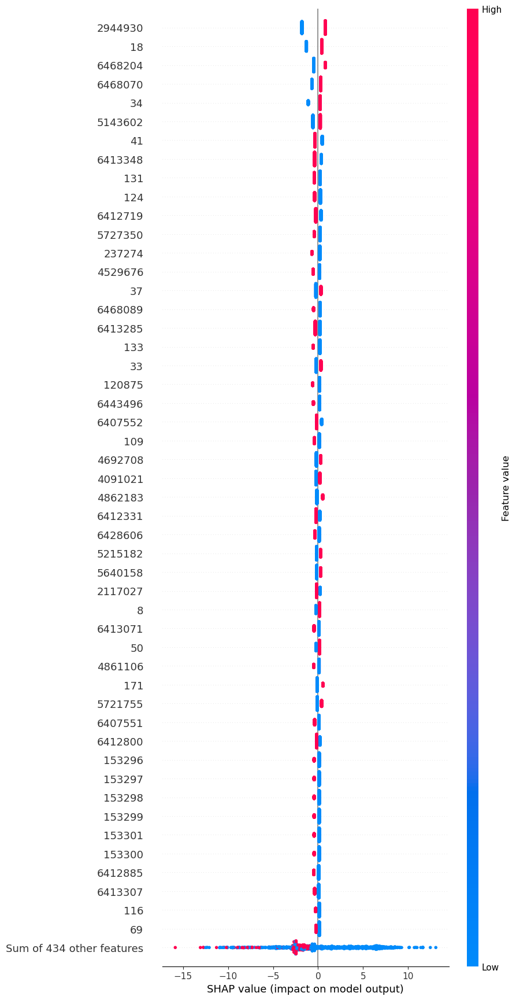

In [180]:
shap.plots.beeswarm(shap_values, max_display=50)

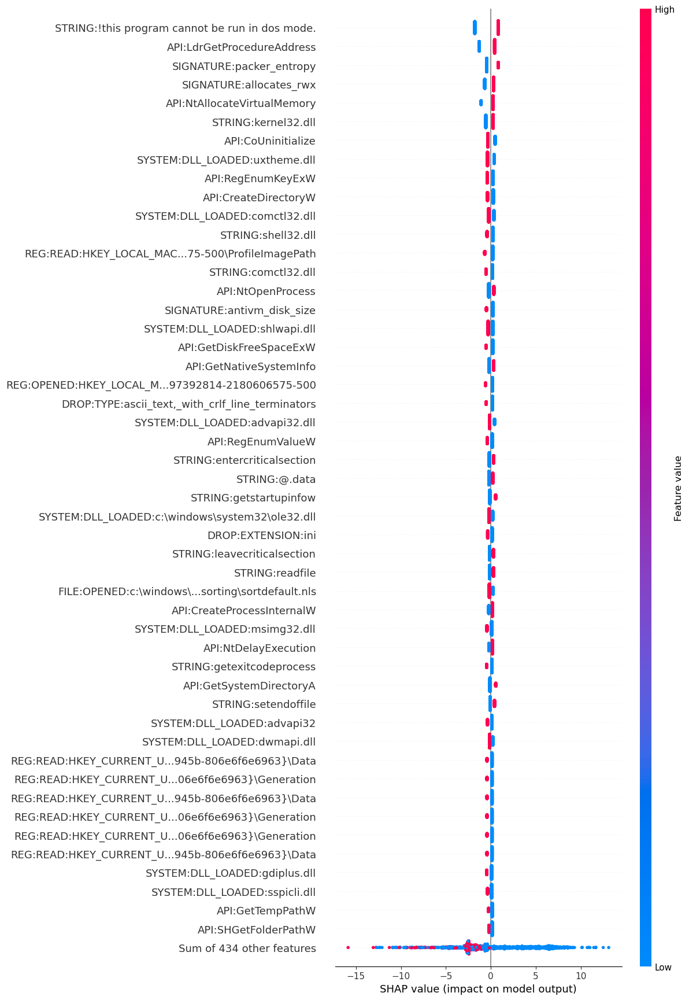

In [182]:
shap.plots.beeswarm(shap_values_renamed, max_display=50)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]),
 [Text(0, 0, 'Sum of 434 other features'),
  Text(0, 1, '69'),
  Text(0, 2, '116'),
  Text(0, 3, '6413307'),
  Text(0, 4, '6412885'),
  Text(0, 5, '153300'),
  Text(0, 6, '153301'),
  Text(0, 7, '153299'),
  Text(0, 8, '153298'),
  Text(0, 9, '153297'),
  Text(0, 10, '153296'),
  Text(0, 11, '6412800'),
  Text(0, 12, '6407551'),
  Text(0, 13, '5721755'),
  Text(0, 14, '171'),
  Text(0, 15, '4861106'),
  Text(0, 16, '50'),
  Text(0, 17, '6413071'),
  Text(0, 18, '8'),
  Text(0, 19, '2117027'),
  Text(0, 20, '5640158'),
  Text(0, 21, '5215182'),
  Text(0, 22, '6428606'),
  Text(0, 23, '6412331'),
  Text(0, 24, '4862183'),
  Text(0, 25, '4091021'),
  Text(0, 26, '4692708'),
  Text(0, 27, '109'),
  Text(0, 28, '6407552'),
  Text(0, 29, '6443496'),
  Text(0, 30, '12087

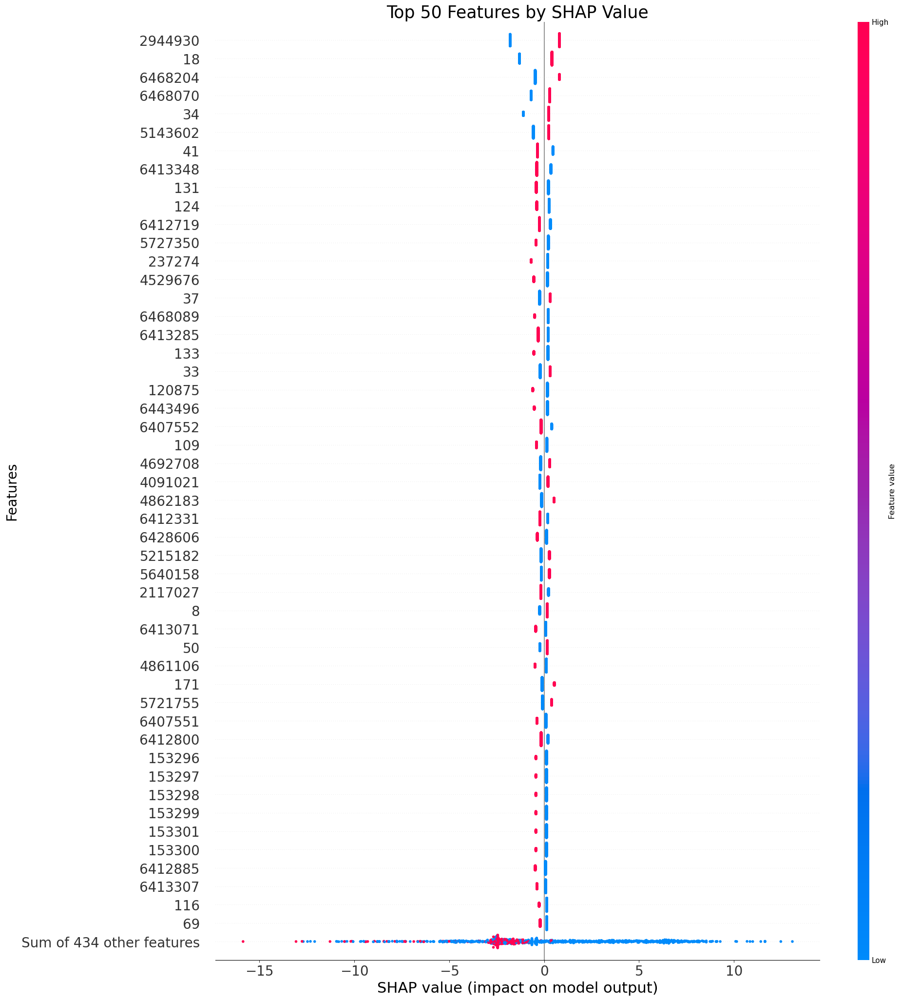

In [184]:

# Create the SHAP beeswarm plot
shap.plots.beeswarm(shap_values, max_display=50, show=False)

# Adjust the figure size (for the whole plot)
plt.gcf().set_size_inches(20, 25)

# Adjust font size for the title, axes, and ticks
plt.title('Top 50 Features by SHAP Value', fontsize=25)
plt.xlabel('SHAP value (impact on model output)', fontsize=22)
plt.ylabel('Features', fontsize=20)

# Increase font size for ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Save the plot to a PDF file
#plt.savefig('outputs/3_XAI/shap_beswarm.pdf', format='pdf', bbox_inches='tight')

# Close the plot to free up memory
#plt.close()


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]),
 [Text(0, 0, 'Sum of 434 other features'),
  Text(0, 1, 'API:SHGetFolderPathW'),
  Text(0, 2, 'API:GetTempPathW'),
  Text(0, 3, 'SYSTEM:DLL_LOADED:sspicli.dll'),
  Text(0, 4, 'SYSTEM:DLL_LOADED:gdiplus.dll'),
  Text(0, 5, 'REG:READ:HKEY_CURRENT_U...945b-806e6f6e6963}\\Data'),
  Text(0, 6, 'REG:READ:HKEY_CURRENT_U...06e6f6e6963}\\Generation'),
  Text(0, 7, 'REG:READ:HKEY_CURRENT_U...06e6f6e6963}\\Generation'),
  Text(0, 8, 'REG:READ:HKEY_CURRENT_U...945b-806e6f6e6963}\\Data'),
  Text(0, 9, 'REG:READ:HKEY_CURRENT_U...06e6f6e6963}\\Generation'),
  Text(0, 10, 'REG:READ:HKEY_CURRENT_U...945b-806e6f6e6963}\\Data'),
  Text(0, 11, 'SYSTEM:DLL_LOADED:dwmapi.dll'),
  Text(0, 12, 'SYSTEM:DLL_LOADED:advapi32'),
  Text(0, 13, 'STRING:setendoffile'),
  Text(0, 14, 'API:GetSyst

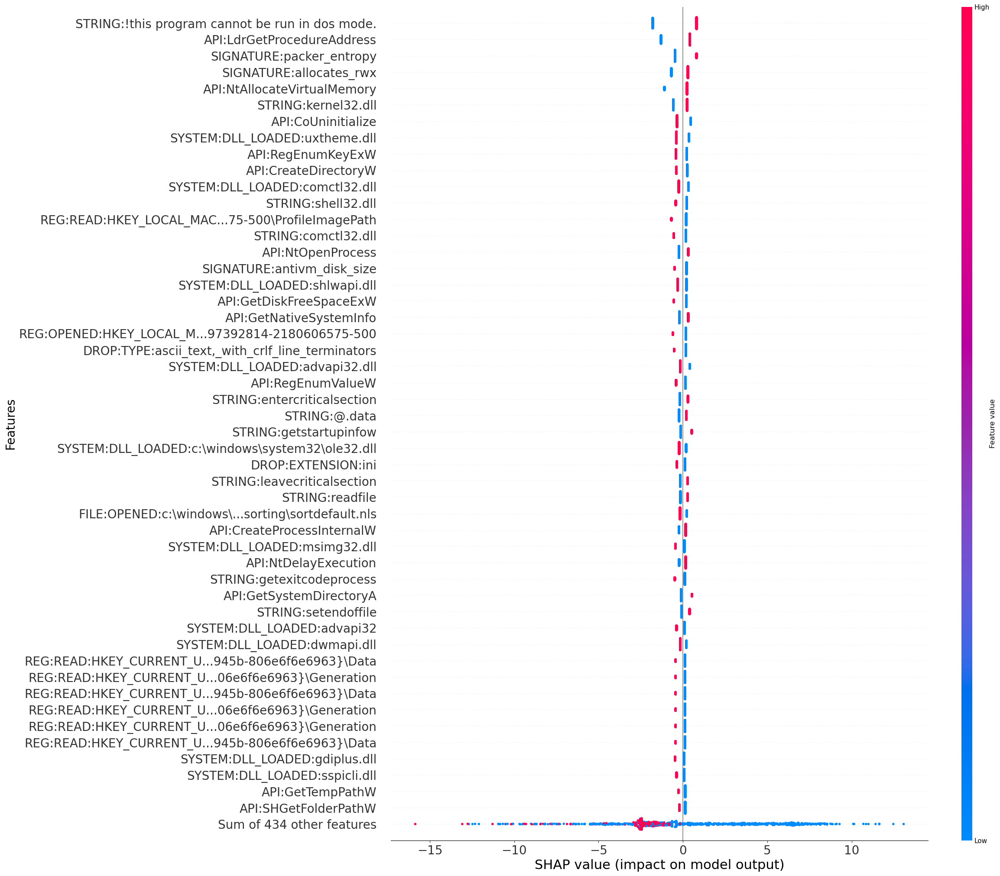

In [186]:
# To save
# Create the SHAP beeswarm plot
shap.plots.beeswarm(shap_values_renamed, max_display=50, show=False)

# Adjust the figure size (for the whole plot)
plt.gcf().set_size_inches(20, 25)

# Adjust font size for the title, axes, and ticks
#plt.title('Top 50 Features by SHAP Value', fontsize=25)
plt.xlabel('SHAP value (impact on model output)', fontsize=22)
plt.ylabel('Features', fontsize=20)

# Increase font size for ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Save the plot to a PDF file
#plt.savefig('outputs/3_XAI/shap_beswarm.pdf', format='pdf', bbox_inches='tight')

# Close the plot to free up memory
#plt.close()


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]),
 [Text(0, 0, '6412497'),
  Text(0, 1, '69'),
  Text(0, 2, '116'),
  Text(0, 3, '6413307'),
  Text(0, 4, '6412885'),
  Text(0, 5, '153300'),
  Text(0, 6, '153301'),
  Text(0, 7, '153299'),
  Text(0, 8, '153298'),
  Text(0, 9, '153297'),
  Text(0, 10, '153296'),
  Text(0, 11, '6412800'),
  Text(0, 12, '6407551'),
  Text(0, 13, '5721755'),
  Text(0, 14, '171'),
  Text(0, 15, '4861106'),
  Text(0, 16, '50'),
  Text(0, 17, '6413071'),
  Text(0, 18, '8'),
  Text(0, 19, '2117027'),
  Text(0, 20, '5640158'),
  Text(0, 21, '5215182'),
  Text(0, 22, '6428606'),
  Text(0, 23, '6412331'),
  Text(0, 24, '4862183'),
  Text(0, 25, '4091021'),
  Text(0, 26, '4692708'),
  Text(0, 27, '109'),
  Text(0, 28, '6407552'),
  Text(0, 29, '6443496'),
  Text(0, 30, '120875'),
  Text(0, 31,

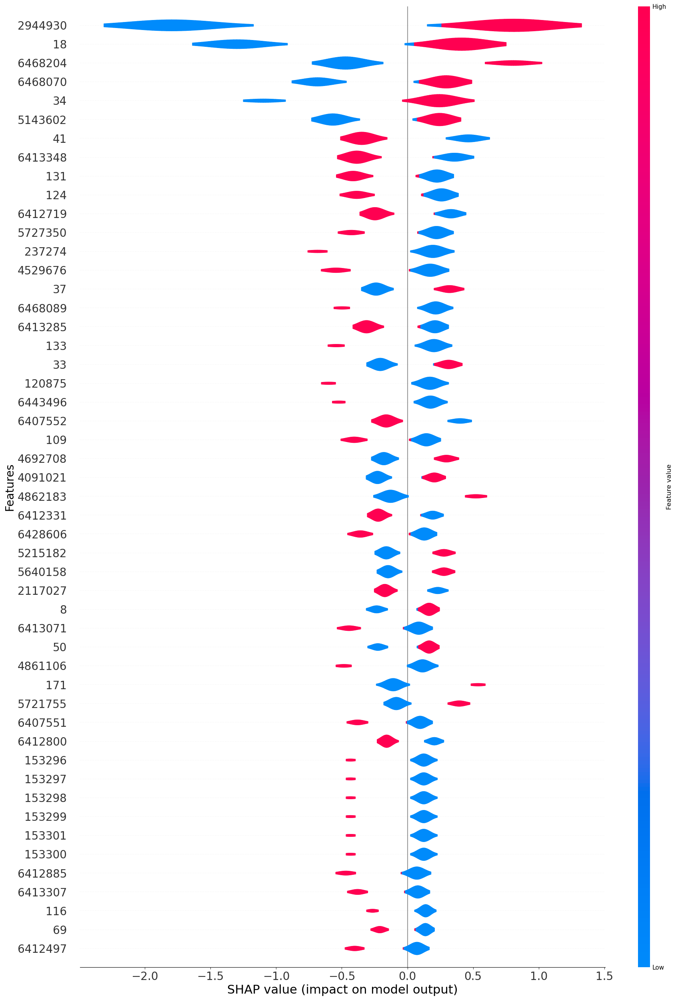

In [188]:

# Create the SHAP beeswarm plot
shap.summary_plot(shap_values, plot_type='violin',max_display=50, show=False)
#shap.plots.beeswarm(shap_values, max_display=50, show=False)

# Adjust the figure size (for the whole plot)
plt.gcf().set_size_inches(20, 25)

# Adjust font size for the title, axes, and ticks
#plt.title('Top 50 Features by SHAP Value', fontsize=25)
plt.xlabel('SHAP value (impact on model output)', fontsize=22)
plt.ylabel('Features', fontsize=20)

# Increase font size for ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Save the plot to a PDF file
#plt.savefig('outputs/3_XAI/shap_voilin.pdf', format='pdf', bbox_inches='tight')

# Close the plot to free up memory
#plt.close()


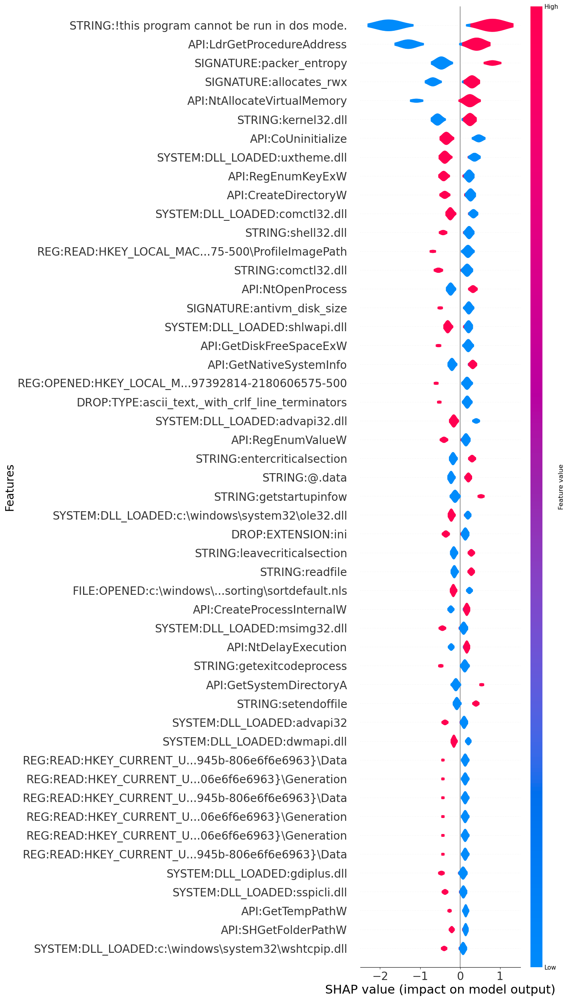

In [192]:

# Create the SHAP beeswarm plot
shap.summary_plot(shap_values_renamed, plot_type='violin',max_display=50, show=False)
#shap.plots.beeswarm(shap_values, max_display=50, show=False)

# Adjust the figure size (for the whole plot)
plt.gcf().set_size_inches(20, 25)

# Adjust font size for the title, axes, and ticks
#plt.title('Top 50 Features by SHAP Value', fontsize=25)
plt.xlabel('SHAP value (impact on model output)', fontsize=22)
plt.ylabel('Features', fontsize=20)

# Increase font size for ticks
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

# Save the plot to a PDF file
plt.savefig('outputs/3_XAI/shap_voilin.pdf', format='pdf', bbox_inches='tight')

# Close the plot to free up memory
#plt.close()


Waterfall plot

The waterfall plot has the same information, represented in a different manner. Here we can see how the sum of all the SHAP values equals the difference between the prediction f(x) and the expected value E[f(x)].

Local bar plot

This plot shows us what are the main features affecting the prediction of a single observation, and the magnitude of the SHAP value for each feature.

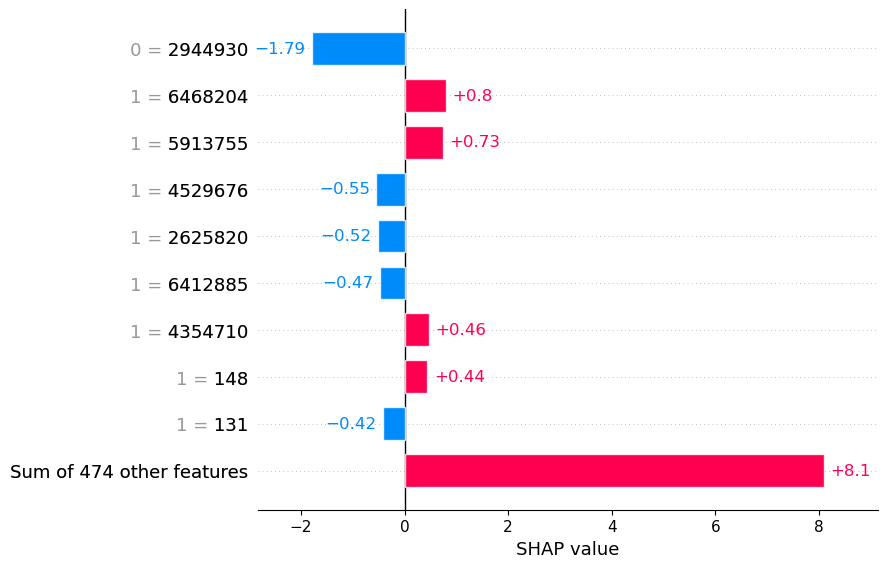

In [194]:
shap.plots.bar(shap_values[0])

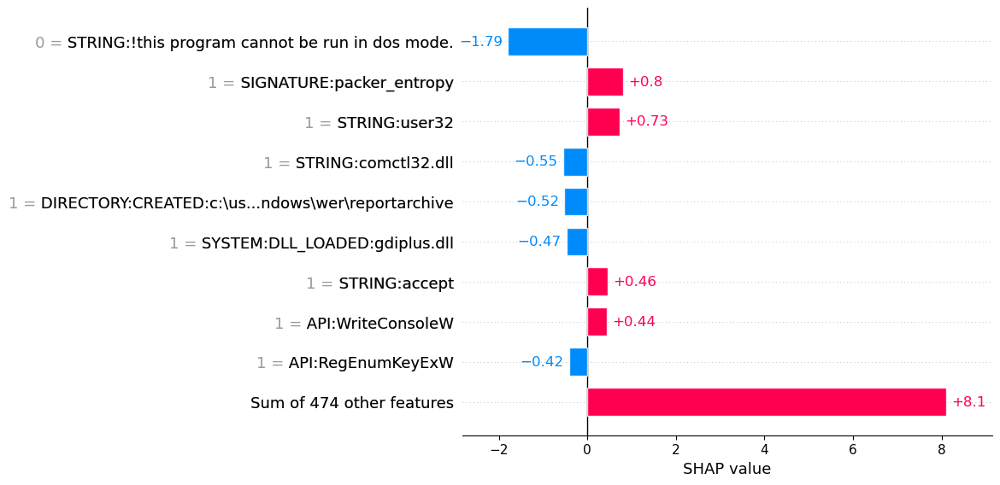

In [196]:
shap.plots.bar(shap_values_renamed[0])

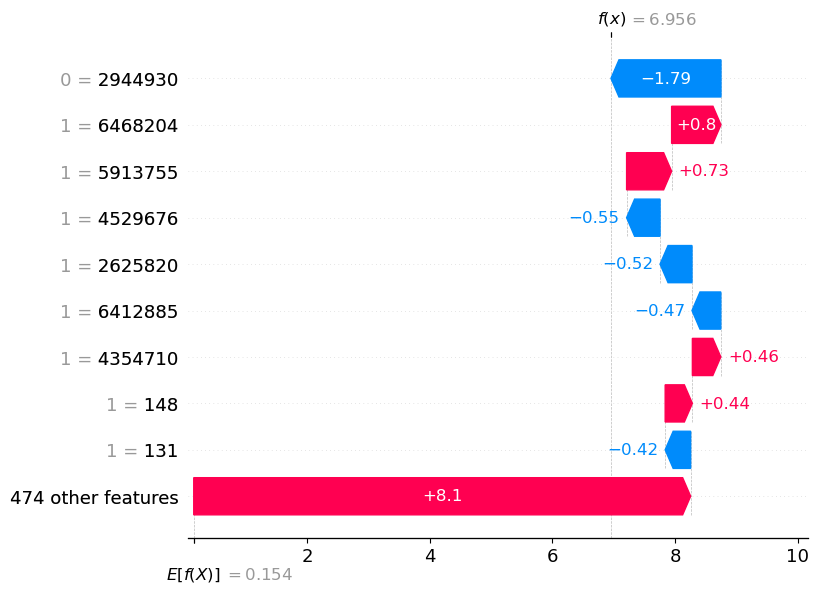

In [198]:
shap.plots.waterfall(shap_values[0])

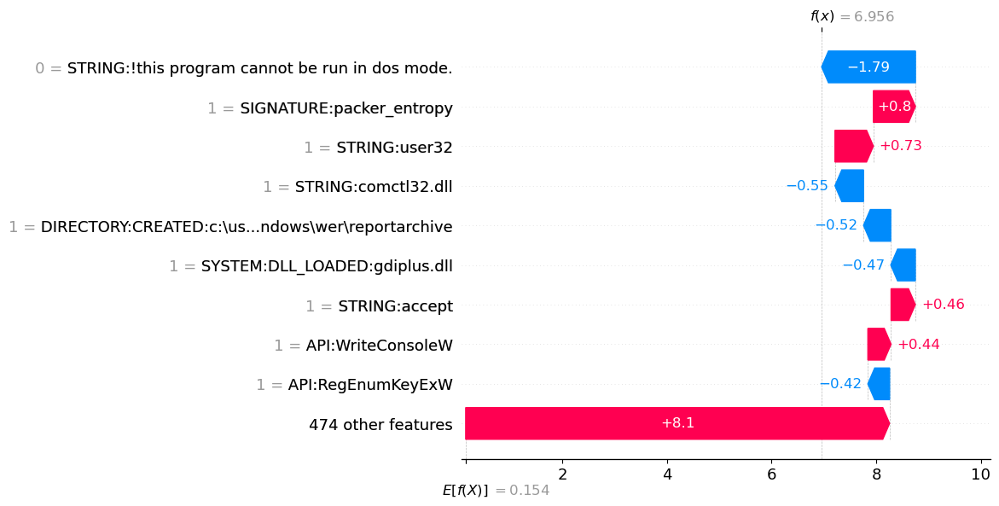

In [200]:
shap.plots.waterfall(shap_values_renamed[0])

In [202]:
# Optionally, save the plot as a file
plt.savefig('shap_beeswarm_top_50_features.pdf', format='pdf')


<Figure size 640x480 with 0 Axes>

## LIME

To use LIME (Local Interpretable Model-Agnostic Explanations) for identifying the most predictive features for ransomware detection, we can follow the steps below. LIME provides explanations for individual predictions by approximating the model locally with an interpretable surrogate model.

LIME Explainer:

LimeTabularExplainer creates a model-agnostic explainer that approximates the global model locally around a specific instance.
Explain a Prediction:

explain_instance generates explanations for a single sample, identifying the top contributing features and their direction of impact (positive or negative).


In [204]:
misclassified_samples

,Index,actual_value,predicted_value,X_test_Index,X_test_merge_Index,sample_id,predicted_probabilities,outlier_score
54,54,1,0,54,54,11136,0.791773,-0.024109
59,59,1,0,59,59,11141,0.901685,-0.024415
98,98,1,0,98,98,11304,0.972238,-0.037515
148,148,1,0,148,148,11402,0.953410,0.005131
237,237,1,0,237,237,11726,0.996868,0.111199
289,289,1,0,289,289,11907,0.727641,-0.012972
469,469,0,1,469,469,13020,0.998335,0.076209
473,473,0,1,473,473,13030,0.944274,0.008424
478,478,0,1,478,478,13046,0.693972,0.076825
483,483,0,1,483,483,13056,0.543845,0.096736


In [206]:
# Create a LimeTabularExplainer object for the model
explainer_lime = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,  # Use the training data as the background data
    mode="classification",  # Since it's a classification model
    feature_names=X_train.columns,  # Feature names from the training data
    class_names=['Goodware', 'Ransomware']#,
    #class_names=[str(cls) for cls in model.classes_],  # Class names for the classifier
   # discretize_continuous=True  # Whether to discretize continuous features
)

In [208]:
# Create a LimeTabularExplainer object for the model
explainer_lime_renamed = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_renamed.values,  # Use the training data as the background data
    mode="classification",  # Since it's a classification model
    feature_names=X_train_renamed.columns,  # Feature names from the training data
    class_names=['Goodware', 'Ransomware']#,
    #class_names=[str(cls) for cls in model.classes_],  # Class names for the classifier
   # discretize_continuous=True  # Whether to discretize continuous features
)

### ransomware but misclassified as goodware

In [210]:
# Choose a sample from the test set to explain
sample_idx = 54  # You can change this index to any sample you want
sample = X_test.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime = explainer_lime.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [212]:
# Choose a sample from the test set to explain
sample_idx = 54  # You can change this index to any sample you want
sample = X_test_renamed.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime_renamed = explainer_lime_renamed.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime_renamed.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [214]:
# Choose a sample from the test set to explain
sample_idx = 289  # You can change this index to any sample you want
sample = X_test.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime = explainer_lime.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [216]:
# Choose a sample from the test set to explain
sample_idx = 289  # You can change this index to any sample you want
sample = X_test_renamed.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime_renamed = explainer_lime_renamed.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime_renamed.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


### goodware misclassified as ransomware 

In [218]:
# Choose a sample from the test set to explain
sample_idx = 488  # You can change this index to any sample you want
sample = X_test.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime = explainer_lime.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [220]:
# Choose a sample from the test set to explain
sample_idx = 488  # You can change this index to any sample you want
sample = X_test_renamed.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime_renamed = explainer_lime_renamed.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime_renamed.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [222]:
# Choose a sample from the test set to explain
sample_idx = 469  # You can change this index to any sample you want
sample = X_test.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime = explainer_lime.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


In [224]:
# Choose a sample from the test set to explain
sample_idx = 469  # You can change this index to any sample you want
sample = X_test_renamed.iloc[sample_idx]

# Explain the model's prediction for the selected sample
explanation_lime_renamed = explainer_lime_renamed.explain_instance(
    sample.values,  # Values of the sample to explain
    model.predict_proba,  # Model's probability predictions function
    num_features=5  # Number of features to display in the explanation
)

# Display the explanation
explanation_lime_renamed.show_in_notebook()

/Users/faithfulonwuegbuche/anaconda3/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
